In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ttest_ind
from scipy.stats import chi2_contingency

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
diabetic_df = pd.read_csv('/content/drive/MyDrive/AIDA/CDBM_602_Data_Engineering/Project/diabetic_data.csv')

In [ ]:
diabetic_df

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,payer_code,medical_specialty,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,diag_1,diag_2,diag_3,number_diagnoses,max_glu_serum,A1Cresult,metformin,repaglinide,nateglinide,chlorpropamide,glimepiride,acetohexamide,glipizide,glyburide,tolbutamide,pioglitazone,rosiglitazone,acarbose,miglitol,troglitazone,tolazamide,examide,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,?,Pediatrics-Endocrinology,41.0,0.0,1,0.0,0,0,250.83,?,?,1,NaN,NaN,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,?,?,59.0,0.0,18,0.0,0,0,276,250.01,255,9,NaN,NaN,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,?,?,11.0,5.0,13,2.0,0,1,648,250,V27,6,NaN,NaN,No,No,No,No,No,No,Steady,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,?,?,44.0,1.0,16,0.0,0,0,8,250.43,403,7,NaN,NaN,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,?,?,51.0,0.0,8,0.0,0,0,197,157,250,5,NaN,NaN,No,No,No,No,No,No,Steady,No,No,No,No,No,No,No,No,No,No,NaN,No,No,No,No,No,Ch,Yes,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101761,443847548,100162476,AfricanAmerican,Male,[70-80),?,1,3,7,3,MC,?,51.0,0.0,16,0.0,0,0,250.13,291,458,9,NaN,>8,Steady,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,Down,No,No,No,No,No,Ch,Yes,>30
101762,443847782,74694222,AfricanAmerican,Female,[80-90),?,1,4,5,5,MC,?,33.0,3.0,18,0.0,0,1,560,276,787,9,NaN,NaN,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,NaN,No,No,No,No,No,No,Yes,NO
101763,443854148,41088789,Caucasian,Male,[70-80),?,1,1,7,1,MC,?,53.0,0.0,9,1.0,0,0,38,590,296,13,NaN,NaN,Steady,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,No,Down,No,No,No,No,No,Ch,Yes,NO
101764,443857166,31693671,Caucasian,Female,[80-90),?,2,3,7,10,MC,Surgery-General,NaN,NaN,21,NaN,0,1,996,285,998,9,NaN,NaN,No,No,No,No,No,No,Steady,No,No,Steady,No,No,No,No,No,No,No,Up,No,No,No,No,No,Ch,Yes,NO


In [ ]:
diabetic_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 50 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   encounter_id              101766 non-null  int64  
 1   patient_nbr               101766 non-null  int64  
 2   race                      101766 non-null  object 
 3   gender                    96678 non-null   object 
 4   age                       96678 non-null   object 
 5   weight                    101766 non-null  object 
 6   admission_type_id         101766 non-null  int64  
 7   discharge_disposition_id  101766 non-null  int64  
 8   admission_source_id       101766 non-null  int64  
 9   time_in_hospital          101766 non-null  int64  
 10  payer_code                101766 non-null  object 
 11  medical_specialty         101766 non-null  object 
 12  num_lab_procedures        73078 non-null   float64
 13  num_procedures            73078 non-null   f

# Missing Value Analysis

## Getting Count For Missing Values

In [ ]:
diabetic_df.replace('?', pd.NA, inplace=True)
print("Number of Missing Vlaue")
missing_value_list = []
for col in diabetic_df.columns:
  n_MV = diabetic_df[col].isna().sum()
  if(n_MV > 0):
    missing_value_list.append(col)
  print(f"{col} : {n_MV}")

Number of Missing Vlaue
encounter_id : 0
patient_nbr : 0
race : 2273
gender : 5088
age : 5088
weight : 98569
admission_type_id : 0
discharge_disposition_id : 0
admission_source_id : 0
time_in_hospital : 0
payer_code : 40256
medical_specialty : 49949
num_lab_procedures : 28688
num_procedures : 28688
num_medications : 0
number_outpatient : 28688
number_emergency : 0
number_inpatient : 0
diag_1 : 21
diag_2 : 358
diag_3 : 1423
number_diagnoses : 0
max_glu_serum : 96420
A1Cresult : 84748
metformin : 0
repaglinide : 0
nateglinide : 0
chlorpropamide : 0
glimepiride : 0
acetohexamide : 0
glipizide : 0
glyburide : 0
tolbutamide : 0
pioglitazone : 0
rosiglitazone : 0
acarbose : 0
miglitol : 0
troglitazone : 0
tolazamide : 0
examide : 0
citoglipton : 0
insulin : 50883
glyburide-metformin : 0
glipizide-metformin : 0
glimepiride-pioglitazone : 0
metformin-rosiglitazone : 0
metformin-pioglitazone : 0
change : 0
diabetesMed : 0
readmitted : 0


In [ ]:
missing_value_list

['race',
 'gender',
 'age',
 'weight',
 'payer_code',
 'medical_specialty',
 'num_lab_procedures',
 'num_procedures',
 'number_outpatient',
 'diag_1',
 'diag_2',
 'diag_3',
 'max_glu_serum',
 'A1Cresult',
 'insulin']

In this missing value list their is no analysis required for following list becuase they have a huge amount of missing value so remiving from wieght list
- weight
- max_glu_serum
- A1Cresult
- medical_specialty
- payer_code

In [ ]:
missing_value_list.pop(missing_value_list.index('weight'))
missing_value_list.pop(missing_value_list.index('max_glu_serum'))
missing_value_list.pop(missing_value_list.index('A1Cresult'))
missing_value_list.pop(missing_value_list.index('medical_specialty'))
missing_value_list.pop(missing_value_list.index('payer_code'))

'payer_code'

In [ ]:
missing_value_list

['race',
 'gender',
 'age',
 'num_lab_procedures',
 'num_procedures',
 'number_outpatient',
 'diag_1',
 'diag_2',
 'diag_3',
 'insulin']

## List of Numerical and Categorical Attributes for Analysis

Below is the comprehensive list of numerical and categorical attributes that will be analyzed in this project. Each attribute will undergo detailed examination to ensure a thorough understanding and meaningful insights are derived from the data.


In [ ]:
numerical_attributes = [
   'time_in_hospital', 'num_lab_procedures','num_medications', 'number_diagnoses','num_procedures', 'number_outpatient', 'number_emergency', 'number_inpatient'
]

In [ ]:
categorical_attributes = [
    'race','gender', 'age', 'weight', 'admission_type_id', 'diag_1', 'diag_2', 'diag_3',
    'discharge_disposition_id', 'admission_source_id', 'payer_code',
    'medical_specialty', 'max_glu_serum', 'A1Cresult', 'metformin',
    'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride',
    'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
    'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol',
    'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin',
    'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone',
    'metformin-pioglitazone', 'metformin-rosiglitazone', 'change',
    'diabetesMed', 'readmitted'
]

In [ ]:
def Diagnose_MV_Numerical(df,str_att_name,BM_MV):
    MV_labels = {True:'With Missing Values',False:'Without Missing Values'}

    labels=[]
    box_sr = pd.Series('',index = BM_MV.unique())
    for poss in BM_MV.unique():
        BM = BM_MV == poss
        box_sr[poss] = df[BM][str_att_name].dropna()
        labels.append(MV_labels[poss])

    plt.boxplot(box_sr,vert=False)
    plt.yticks([1,2],labels)
    plt.xlabel(str_att_name)
    plt.show()

    plt.figure(figsize=(10,4))

    att_range = (df[str_att_name].min(),df[str_att_name].max())

    for i,poss in enumerate(BM_MV.unique()):
        plt.subplot(1,2,i+1)
        BM = BM_MV == poss
        df[BM][str_att_name].hist()
        plt.xlim = att_range
        plt.xlabel(str_att_name)
        plt.title(MV_labels[poss])

    plt.show()

    group_1_data = df[BM_MV][str_att_name].dropna()
    group_2_data = df[~BM_MV][str_att_name].dropna()

    p_value = ttest_ind(group_1_data,group_2_data).pvalue

    print('p-value of t-test: {}'.format(p_value))

    if p_value < 0.05:
      print("The groups are significantly different. Missing values are not random.")
    else:
      print("No significant difference between groups. Missing values might be random.")


In [ ]:
def Diagnose_MV_Categorical(df, str_att_name, BM_MV):
    MV_labels = {True: 'With Missing Values', False: 'Without Missing Values'}
    plt.figure(figsize=(10, 4))

    # Plot bar graphs for both groups
    for i, poss in enumerate(BM_MV.unique()):
        BM = BM_MV == poss
        group_data = df[BM][str_att_name].value_counts()

        if group_data.empty:  # Check if the group has no data
            print(f"No data for group: {MV_labels[poss]}")
            continue

        plt.subplot(1, 2, i + 1)
        group_data.plot.bar()
        plt.title(MV_labels[poss])

    plt.show()

    # Perform chi-squared test only if both groups have data
    if df[BM_MV].shape[0] > 0 and df[~BM_MV].shape[0] > 0:
        contigency_table = pd.crosstab(BM_MV, df[str_att_name])
        p_value = chi2_contingency(contigency_table)[1]
        print('p-value of Chi-squared test: {}'.format(p_value))

        # Interpretation of the p-value
        if p_value < 0.05:
            print(
                f"The missingness in '{str_att_name}' is likely **not completely at random** (p < 0.05).\n"
                "This suggests a significant relationship between missingness and the attribute values."
            )
        else:
            print(
                f"The missingness in '{str_att_name}' appears to be **completely at random** (p >= 0.05).\n"
                "No significant relationship was detected between missingness and the attribute values."
            )
    else:
        print("Insufficient data for chi-squared test.")

## Detecting Missing type for Race

Diagnosis Analysis of Missing Values for time_in_hospital:


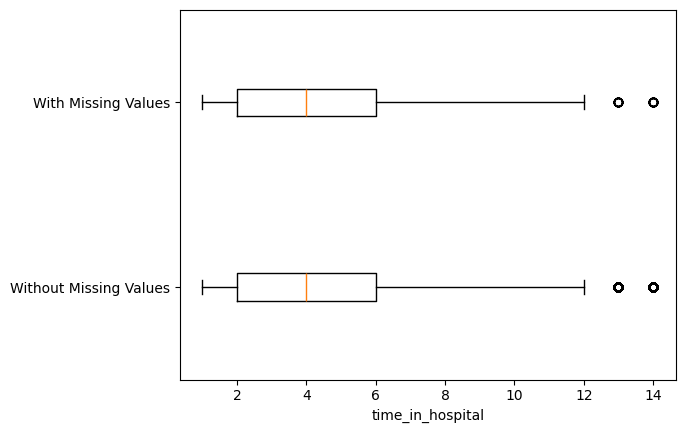

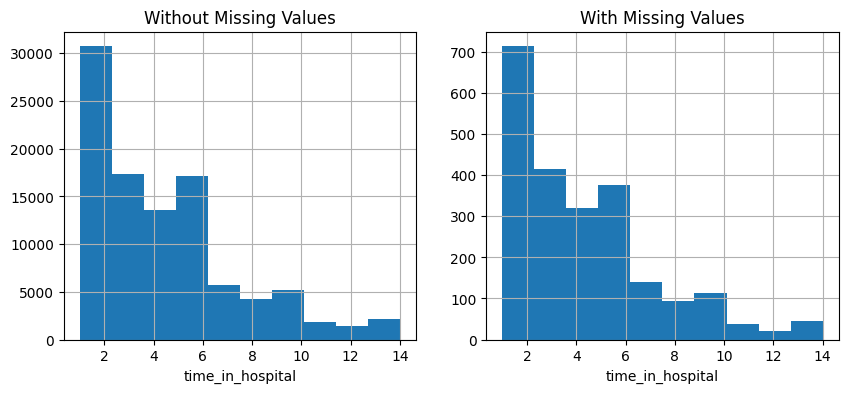

p-value of t-test: 0.08538027443853351
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


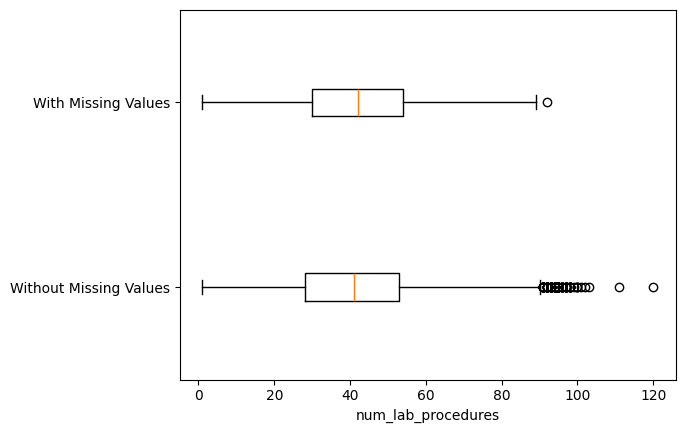

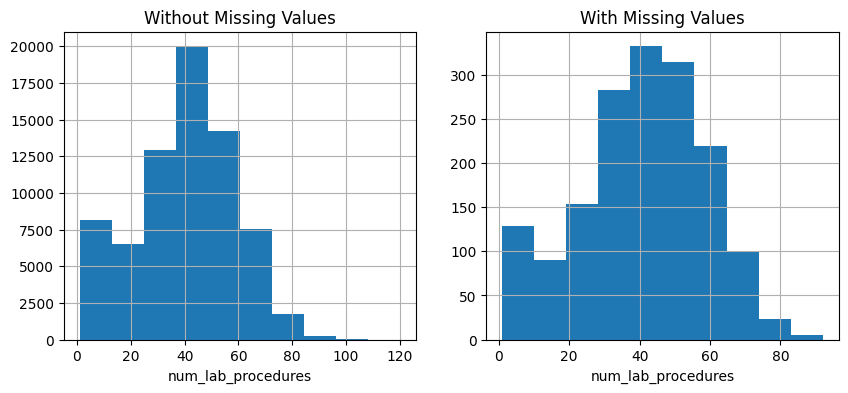

p-value of t-test: 0.057737345955306454
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


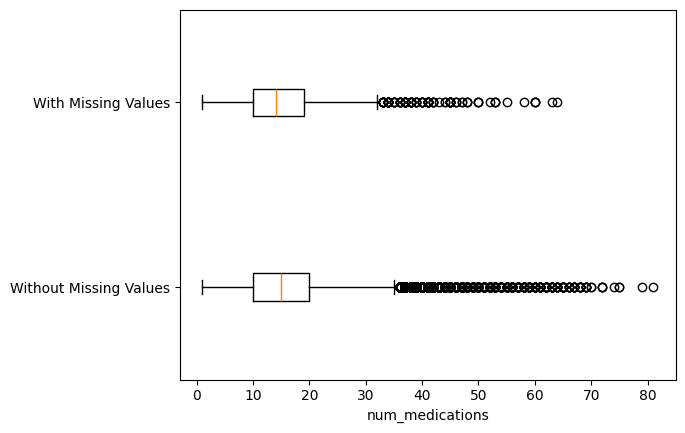

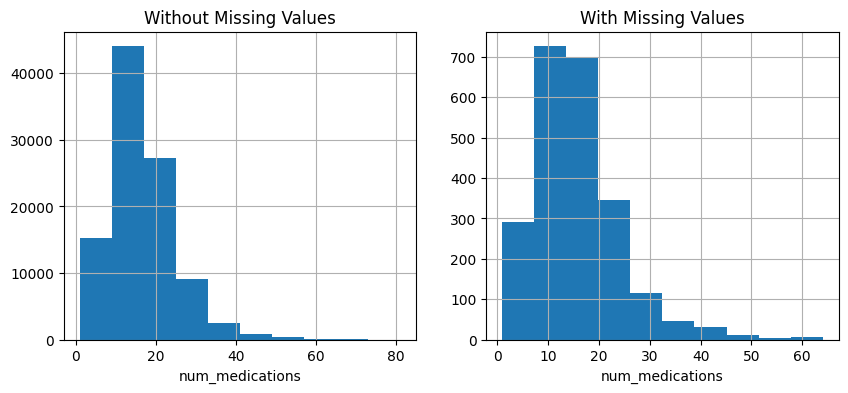

p-value of t-test: 0.21636956630183637
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


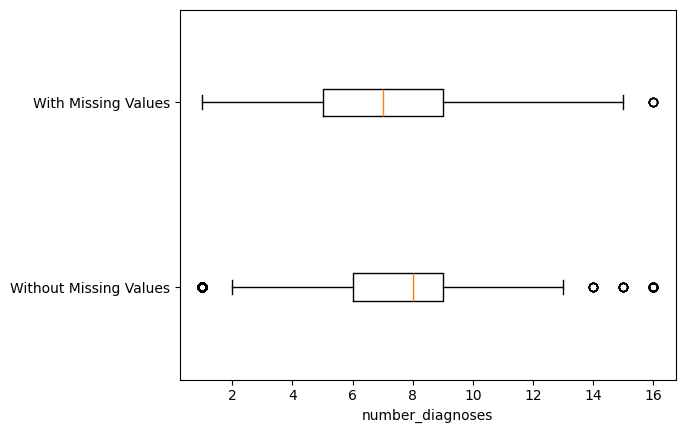

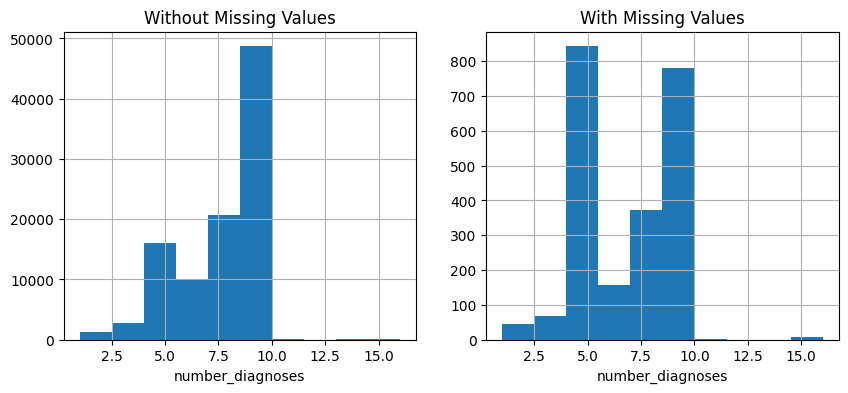

p-value of t-test: 1.4132652072041669e-73
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


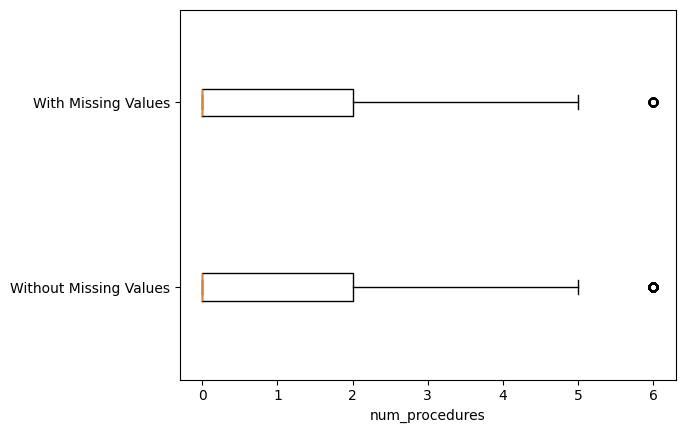

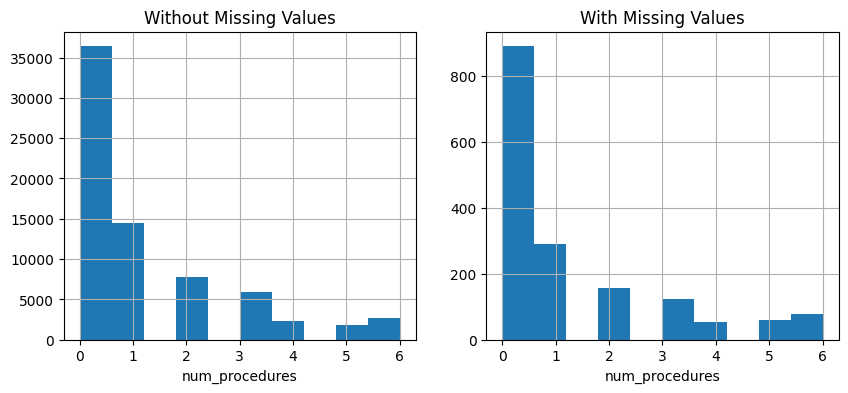

p-value of t-test: 0.4940032402840375
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


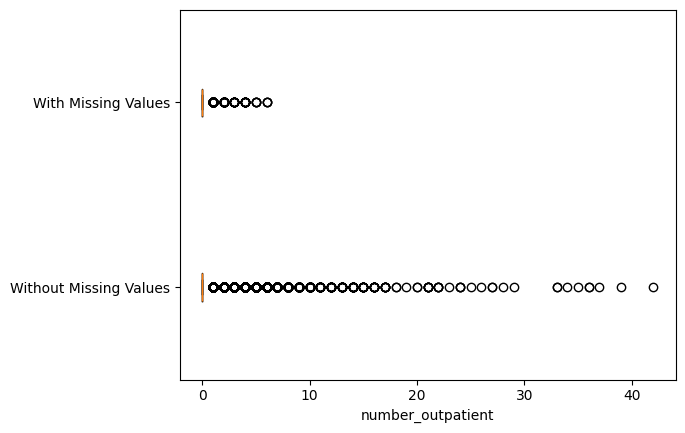

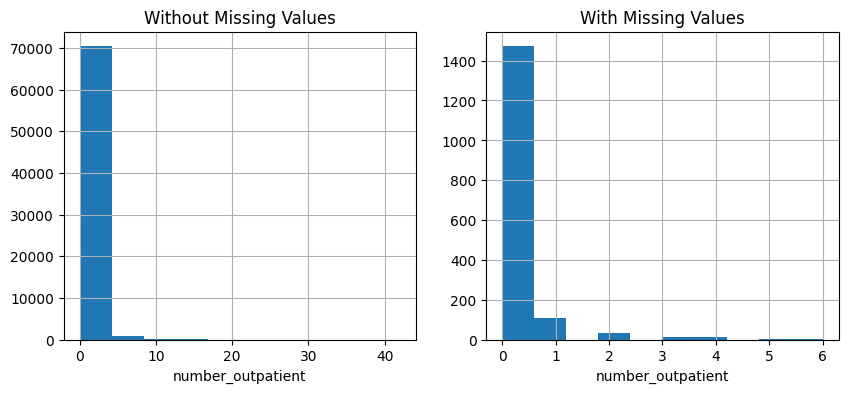

p-value of t-test: 8.794335868969285e-10
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


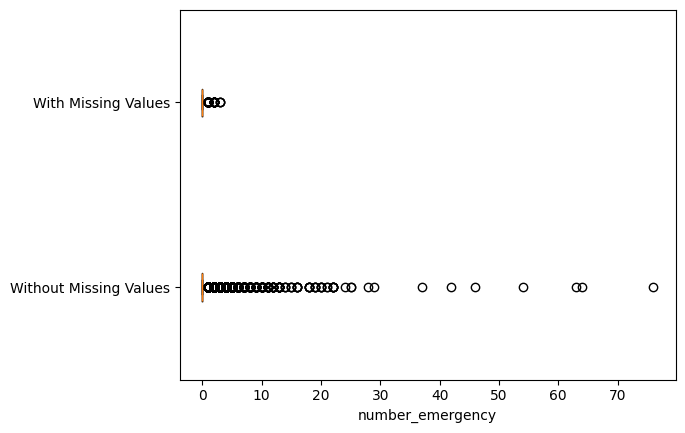

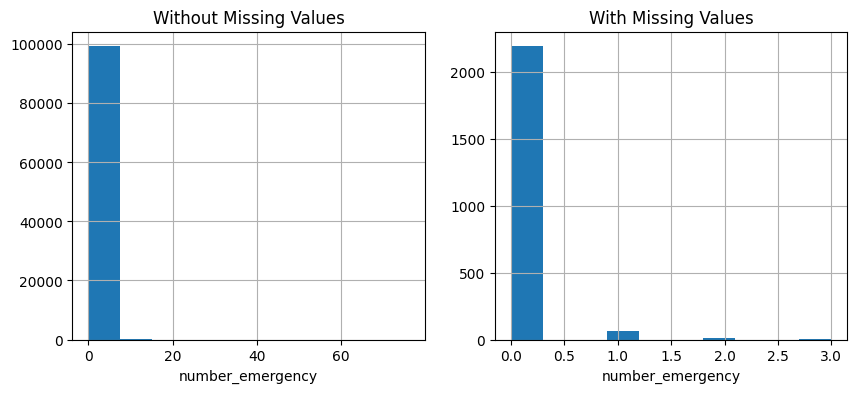

p-value of t-test: 1.857355254996733e-15
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


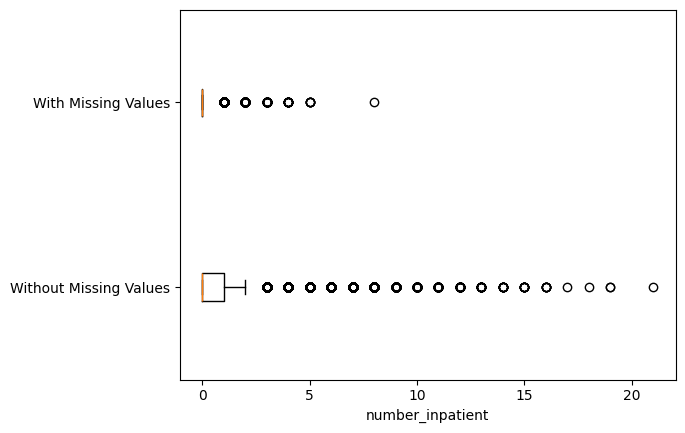

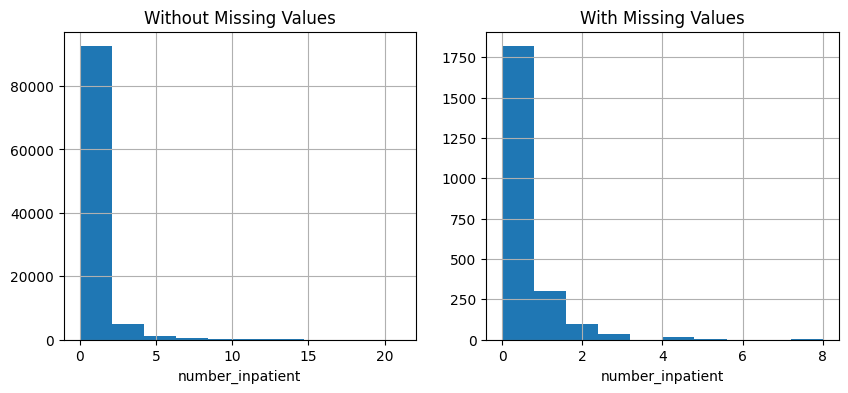

p-value of t-test: 2.1920877809287272e-36
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.race.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:
No data for group: With Missing Values


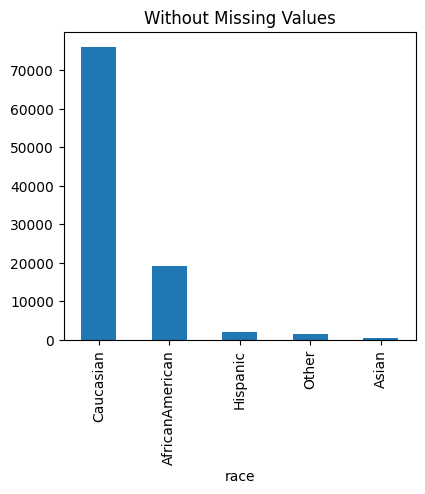

p-value of Chi-squared test: 1.0
The missingness in 'race' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


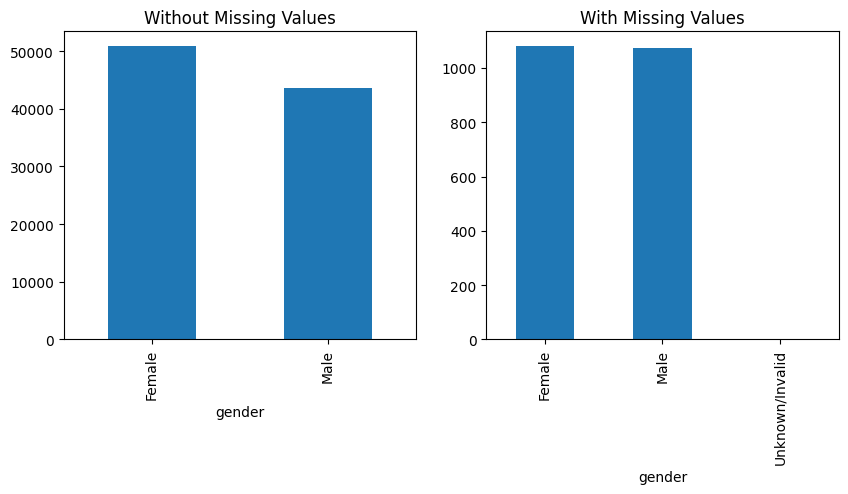

p-value of Chi-squared test: 3.2284780002100417e-22
The missingness in 'gender' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


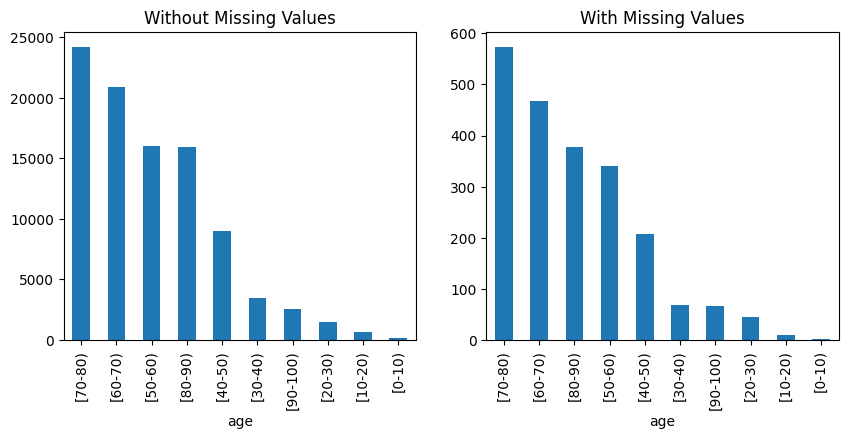

p-value of Chi-squared test: 0.22214144159527896
The missingness in 'age' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


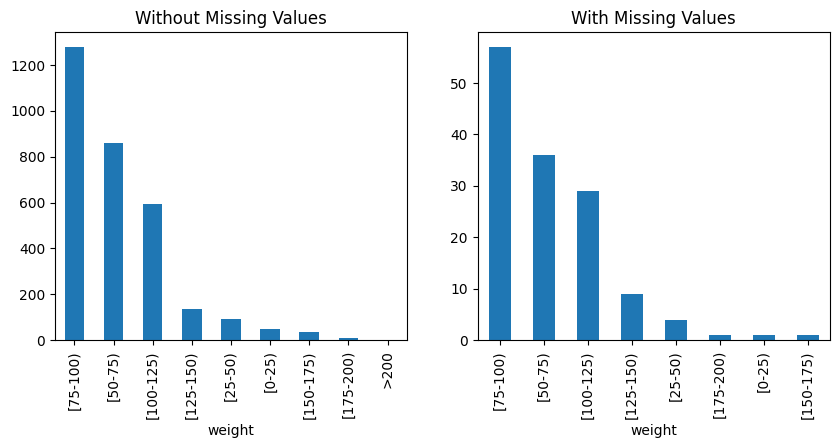

p-value of Chi-squared test: 0.9258151862582038
The missingness in 'weight' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


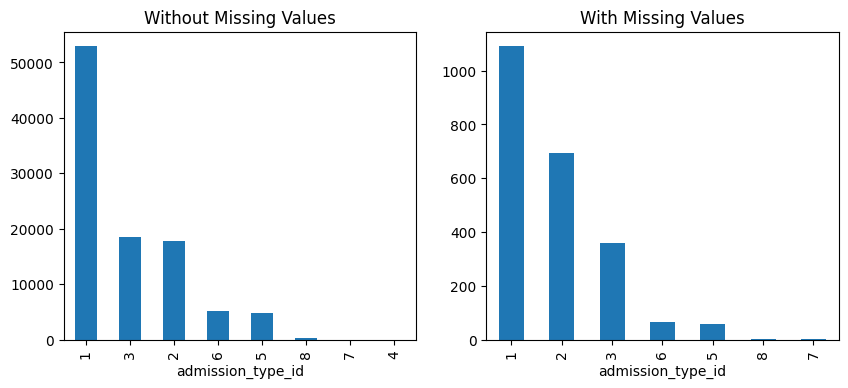

p-value of Chi-squared test: 1.0867965270778647e-53
The missingness in 'admission_type_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


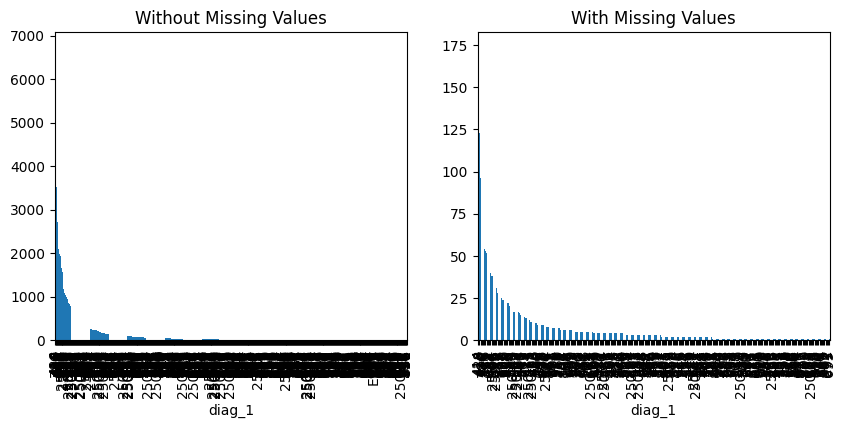

p-value of Chi-squared test: 5.540327866573476e-20
The missingness in 'diag_1' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


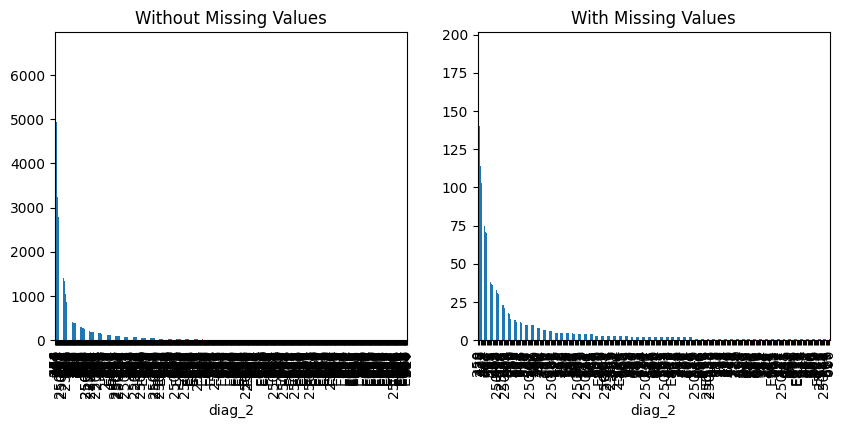

p-value of Chi-squared test: 2.5216687073195255e-13
The missingness in 'diag_2' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


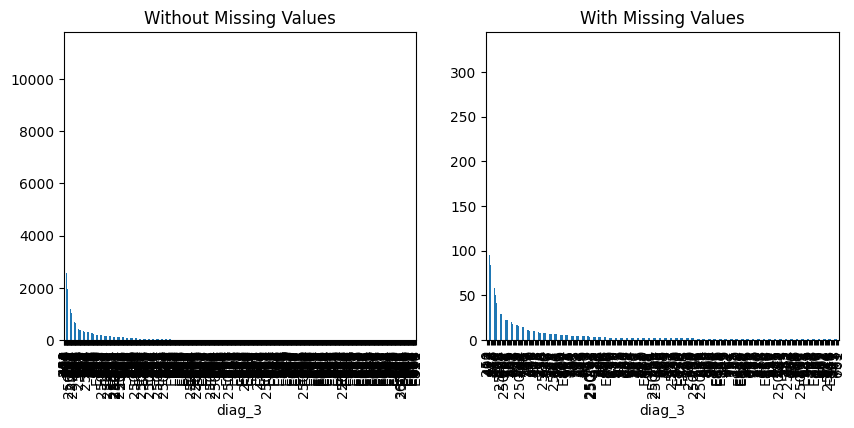

p-value of Chi-squared test: 8.392775470362984e-12
The missingness in 'diag_3' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


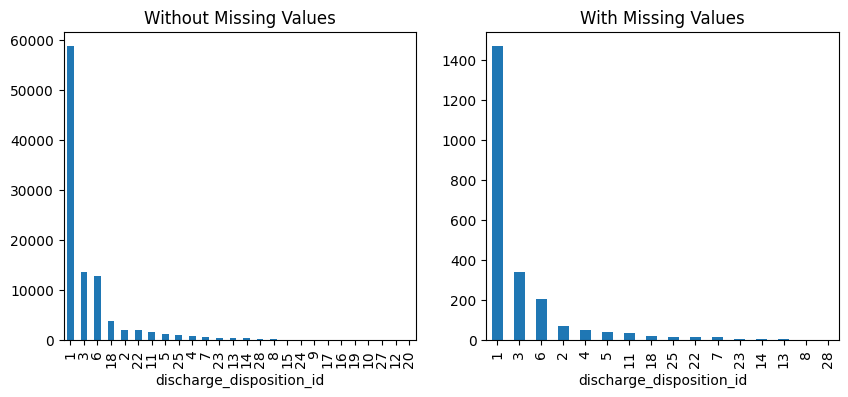

p-value of Chi-squared test: 1.6812781426619382e-30
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


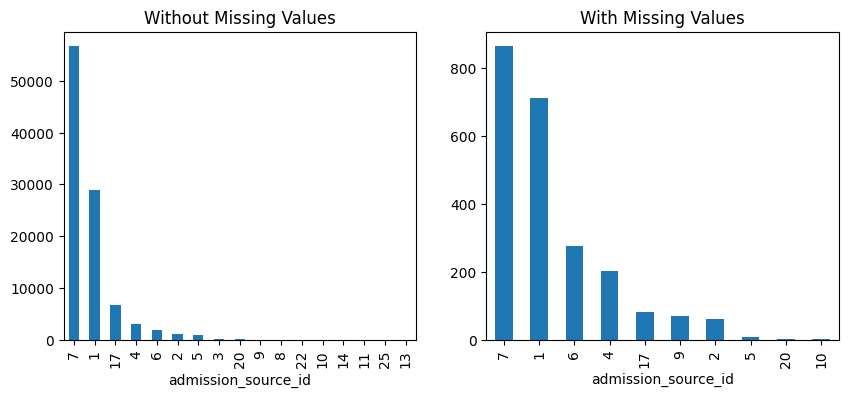

p-value of Chi-squared test: 0.0
The missingness in 'admission_source_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


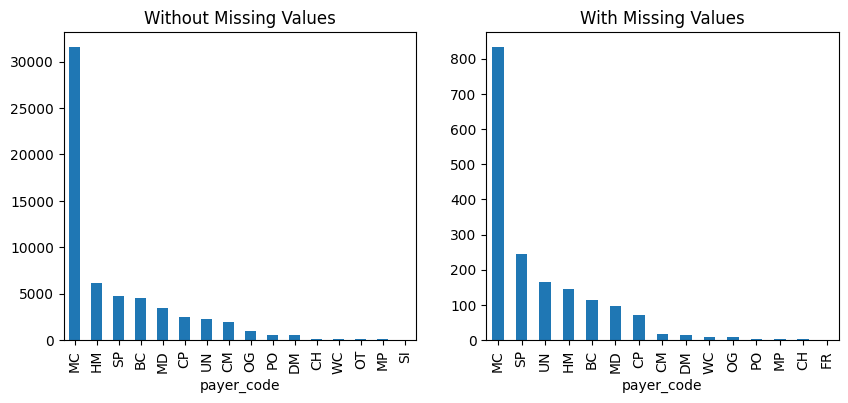

p-value of Chi-squared test: 1.0805114923265649e-60
The missingness in 'payer_code' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


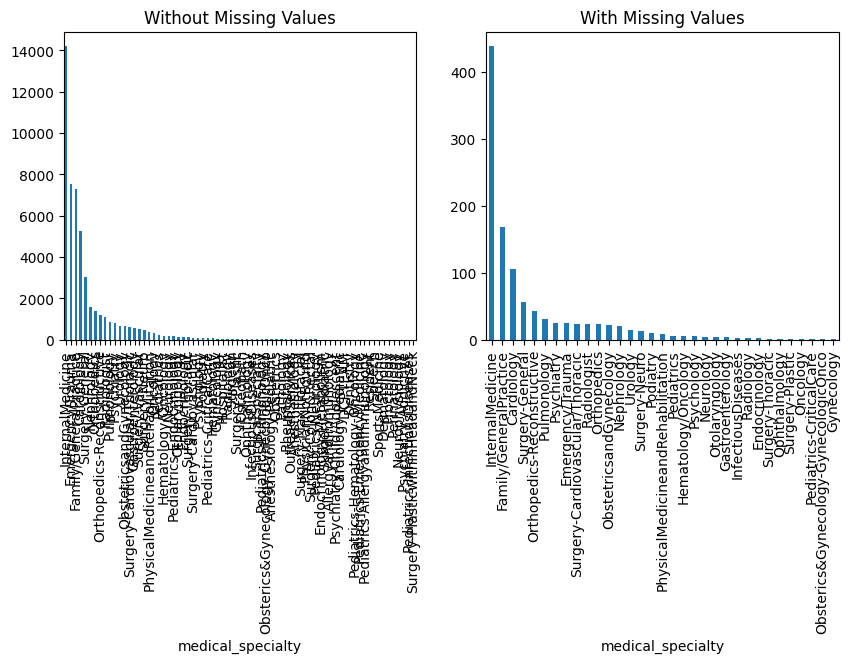

p-value of Chi-squared test: 4.1476884493576953e-29
The missingness in 'medical_specialty' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


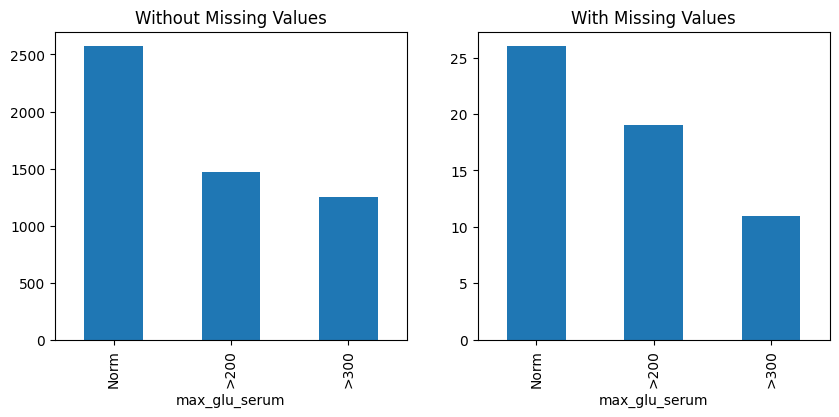

p-value of Chi-squared test: 0.5466831719116029
The missingness in 'max_glu_serum' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


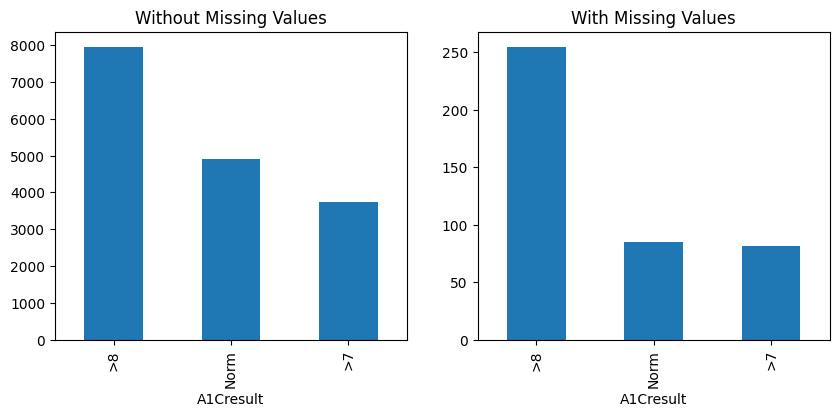

p-value of Chi-squared test: 1.1414457327513323e-06
The missingness in 'A1Cresult' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


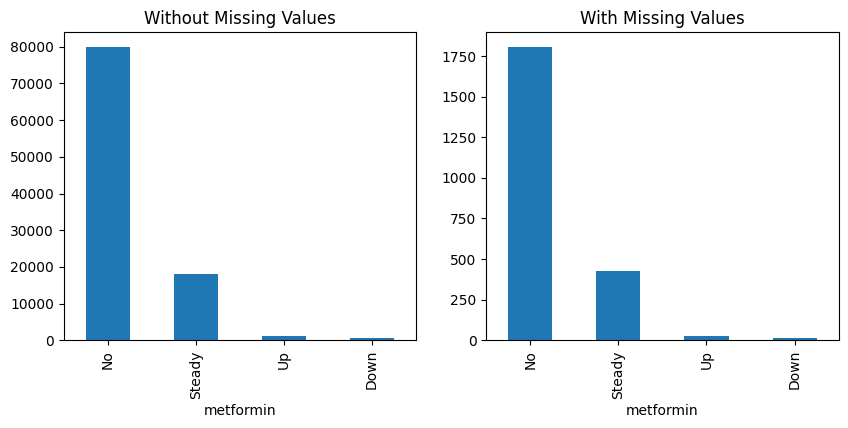

p-value of Chi-squared test: 0.6499341353375192
The missingness in 'metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


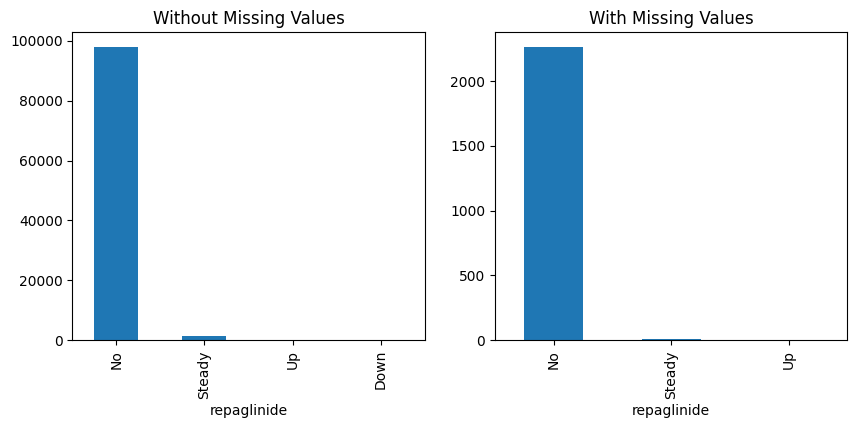

p-value of Chi-squared test: 0.0004253152117678112
The missingness in 'repaglinide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


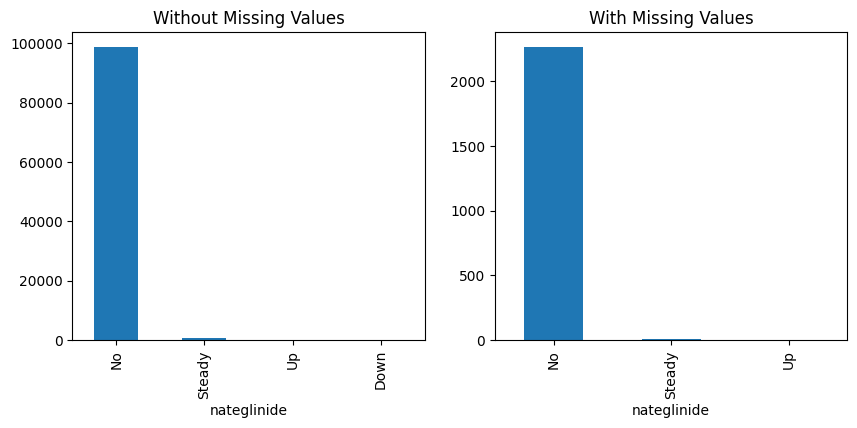

p-value of Chi-squared test: 0.10448311954279982
The missingness in 'nateglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


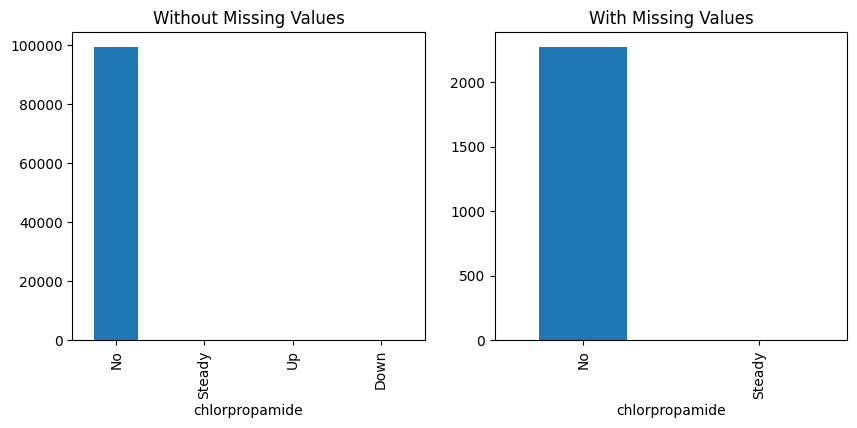

p-value of Chi-squared test: 0.9190871441282457
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


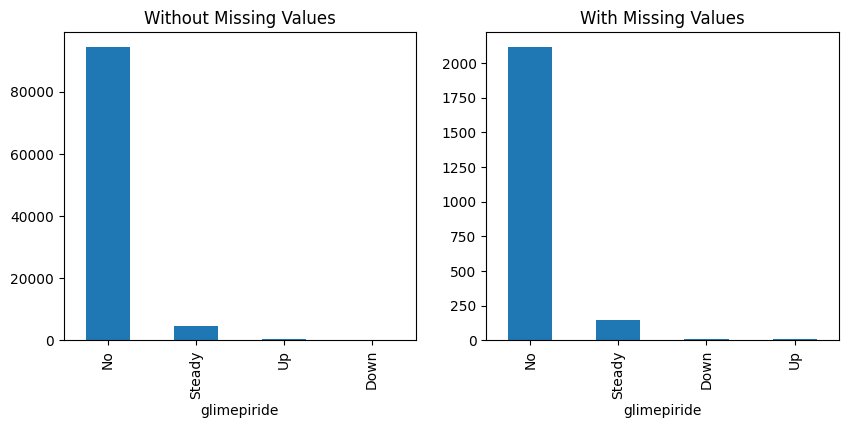

p-value of Chi-squared test: 0.00028775166078655795
The missingness in 'glimepiride' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


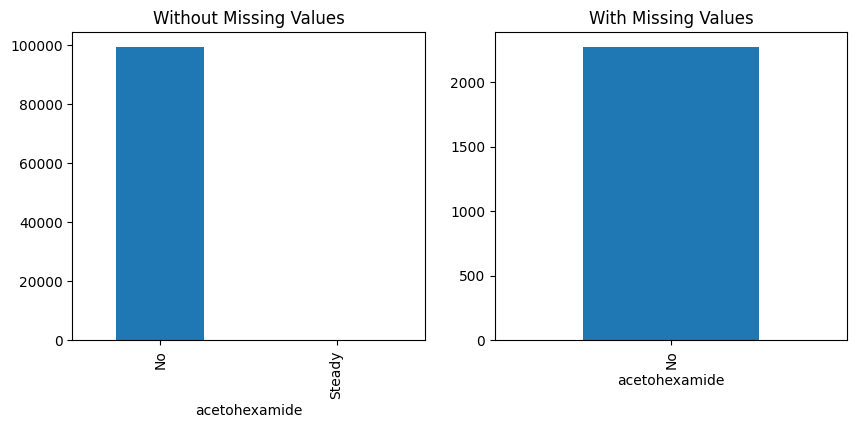

p-value of Chi-squared test: 1.0
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


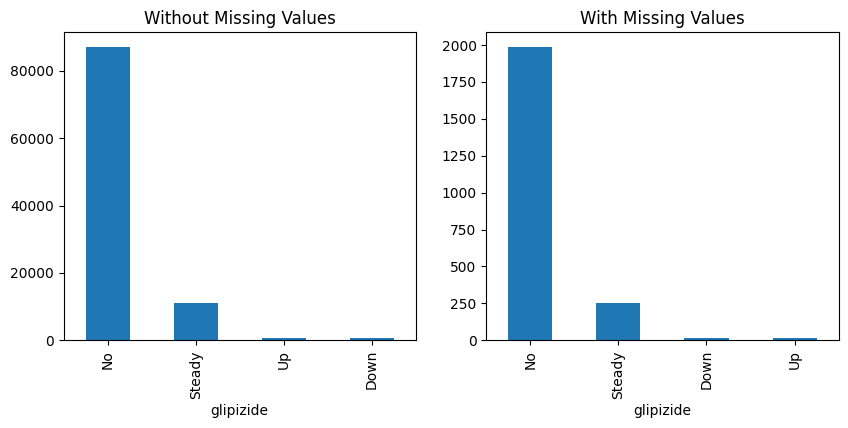

p-value of Chi-squared test: 0.7802686166386354
The missingness in 'glipizide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


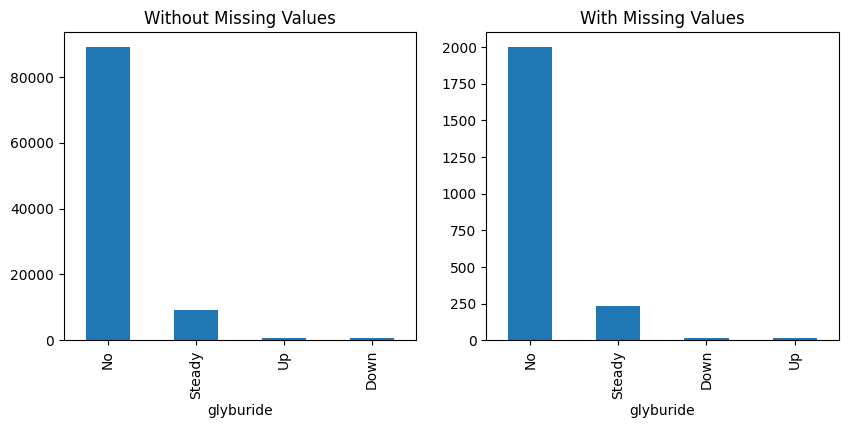

p-value of Chi-squared test: 0.08011597953449229
The missingness in 'glyburide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


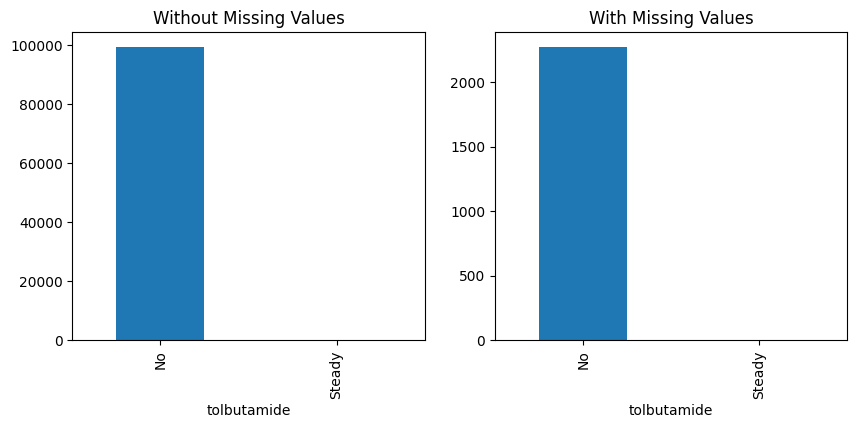

p-value of Chi-squared test: 1.0
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


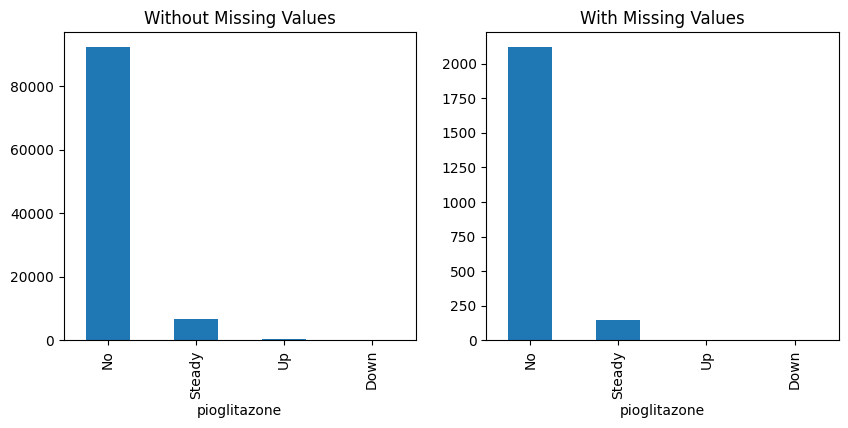

p-value of Chi-squared test: 0.5636063011438386
The missingness in 'pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


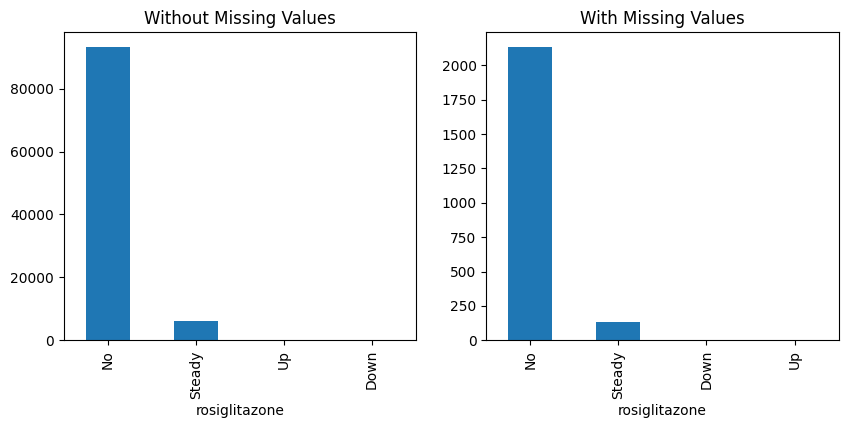

p-value of Chi-squared test: 0.8069276703027801
The missingness in 'rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


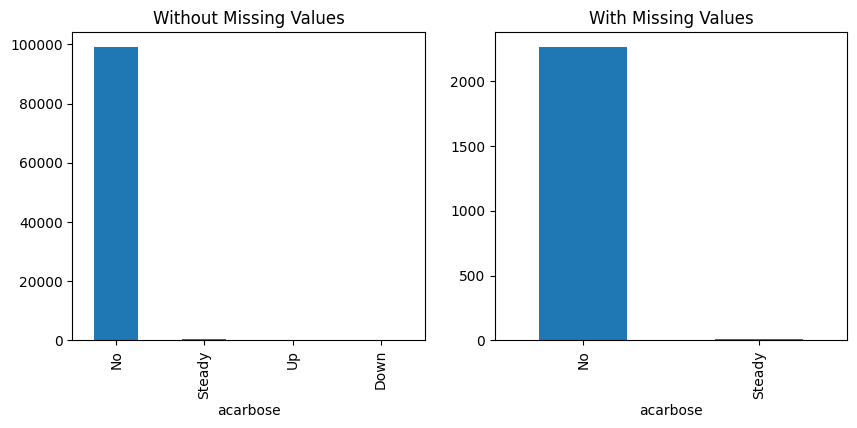

p-value of Chi-squared test: 0.9501287921238003
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


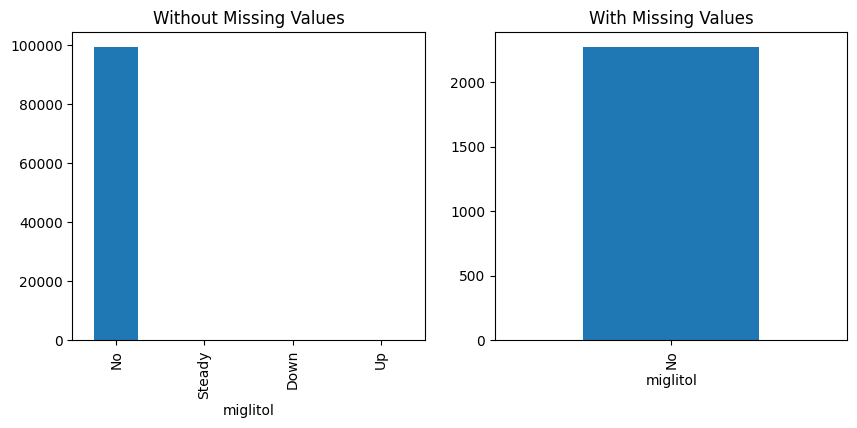

p-value of Chi-squared test: 0.8330302928241631
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


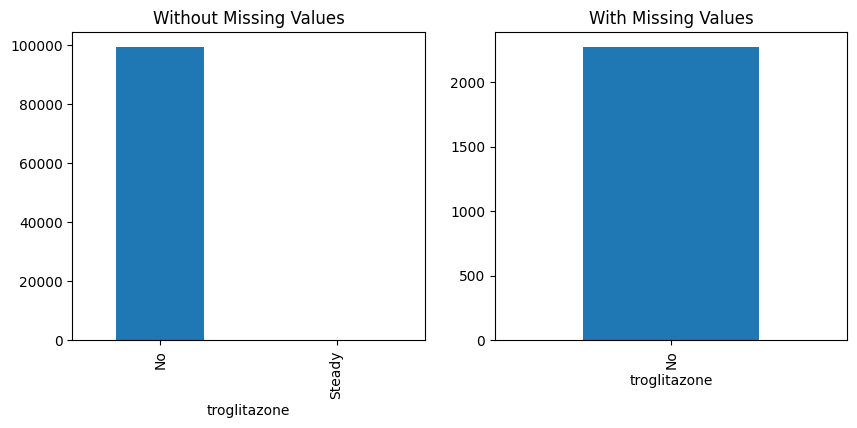

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


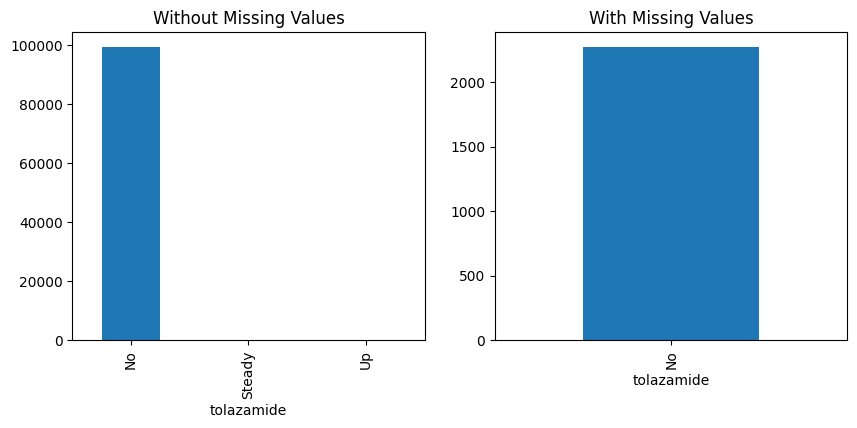

p-value of Chi-squared test: 0.6403986244921414
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


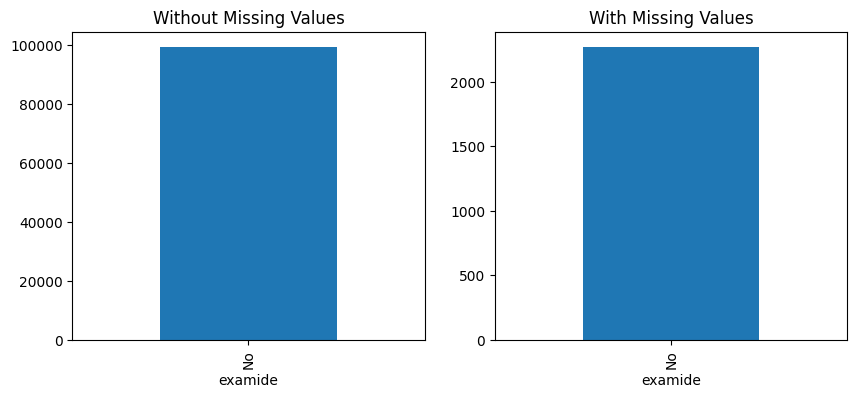

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


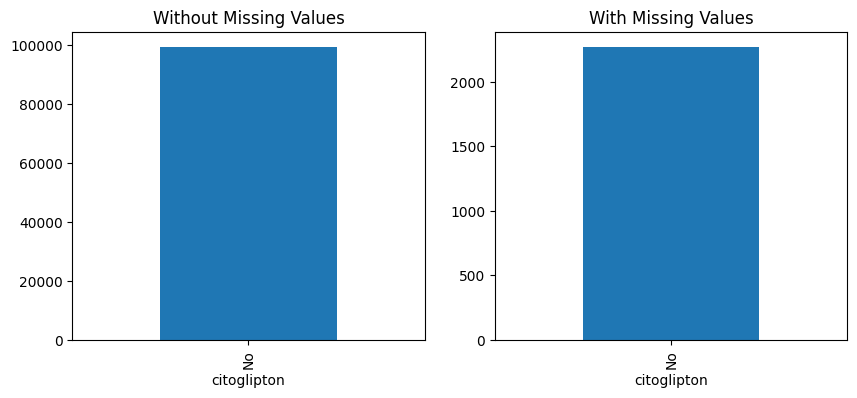

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:


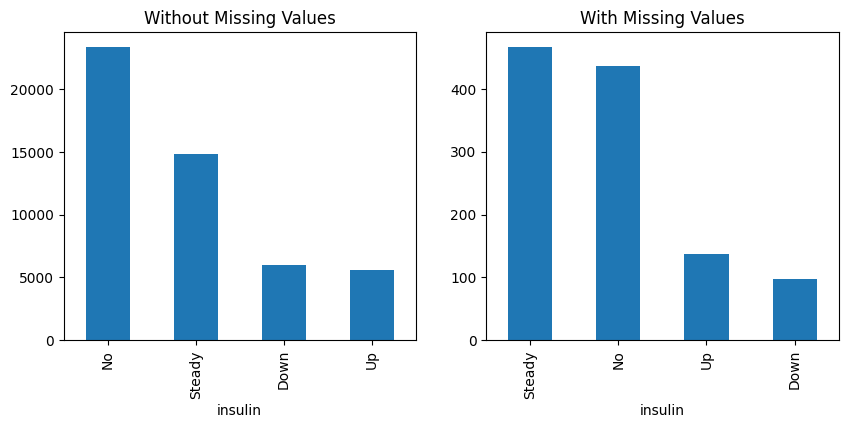

p-value of Chi-squared test: 1.6746245480910396e-16
The missingness in 'insulin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


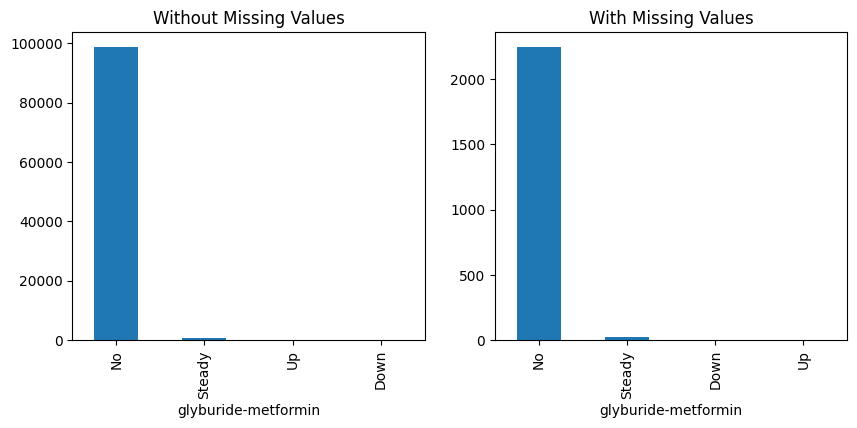

p-value of Chi-squared test: 4.785578025138868e-18
The missingness in 'glyburide-metformin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


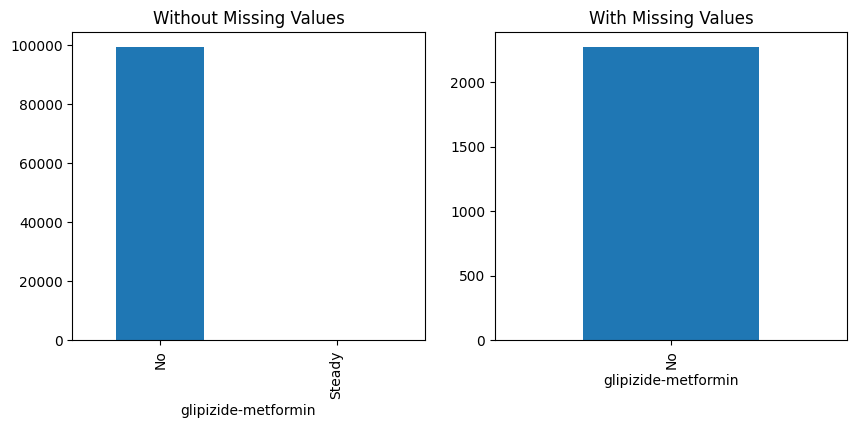

p-value of Chi-squared test: 1.0
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


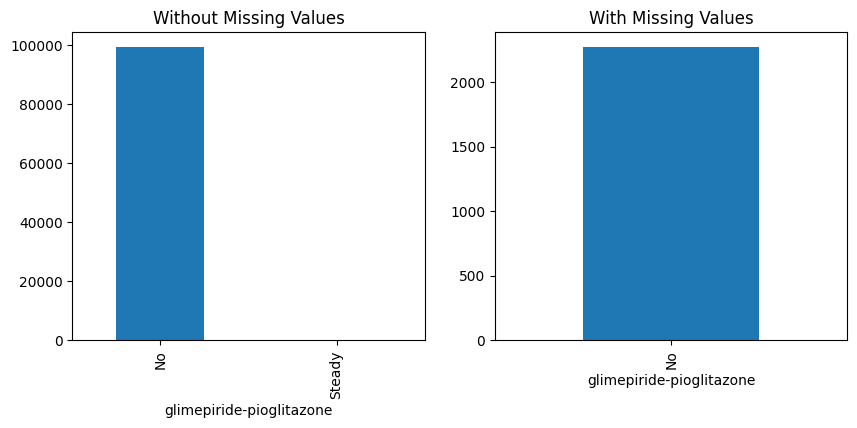

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


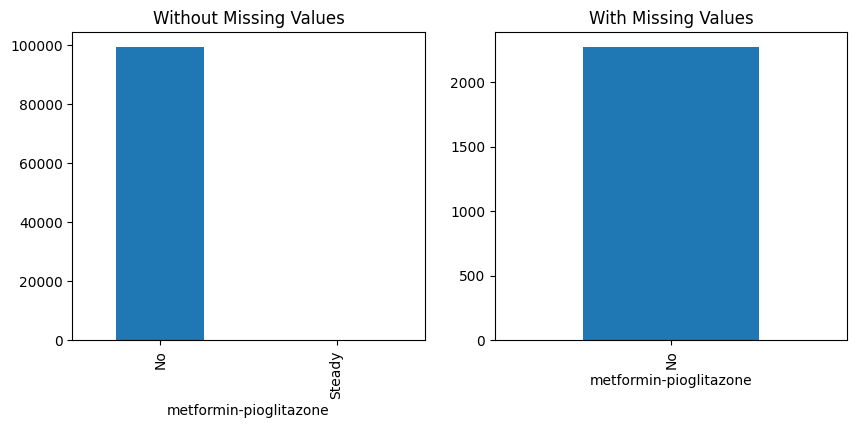

p-value of Chi-squared test: 1.0
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


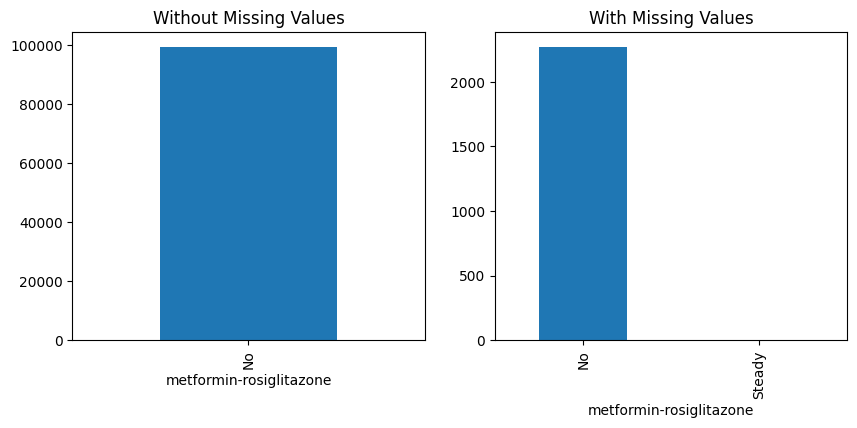

p-value of Chi-squared test: 3.308055536180435e-12
The missingness in 'metformin-rosiglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


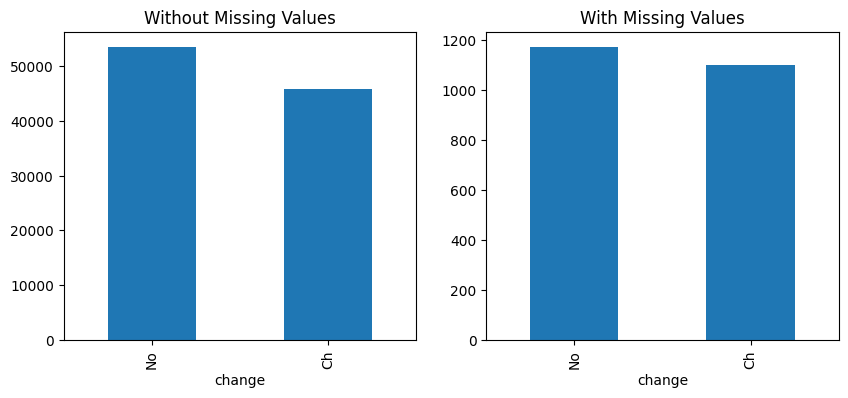

p-value of Chi-squared test: 0.03524799879235772
The missingness in 'change' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


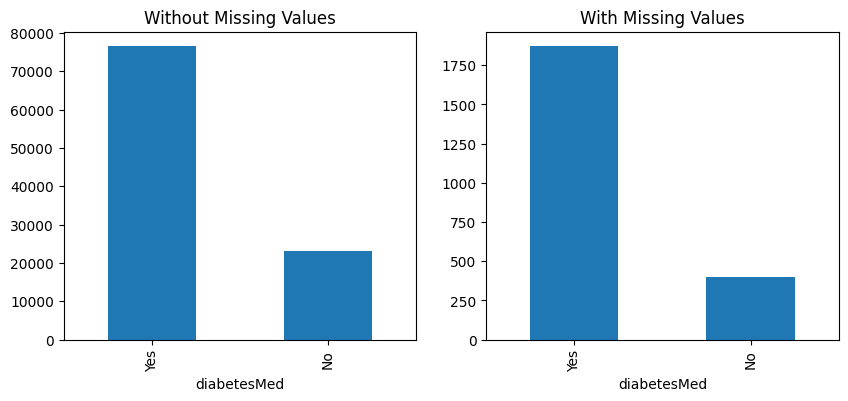

p-value of Chi-squared test: 1.3591891696396656e-09
The missingness in 'diabetesMed' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


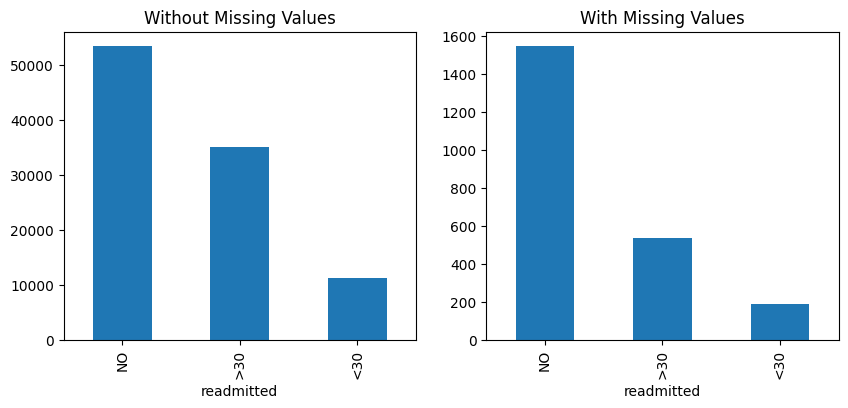

p-value of Chi-squared test: 1.4381202280492468e-41
The missingness in 'readmitted' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.race.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### After going through the analysis we can say `race` is of `MCAR`

## Missing Values analysis for gender

Diagnosis Analysis of Missing Values for time_in_hospital:


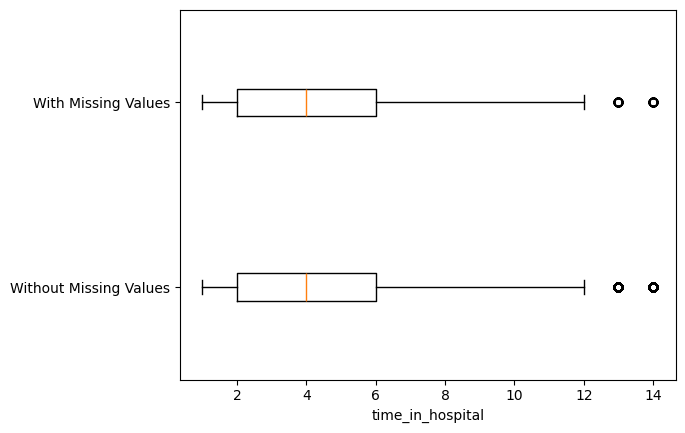

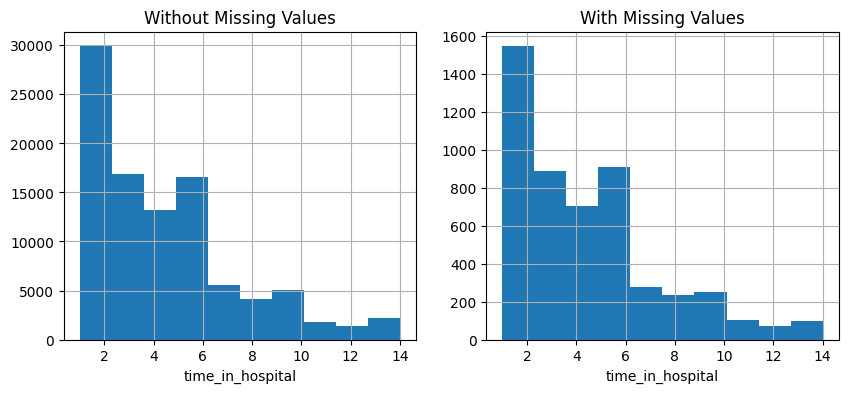

p-value of t-test: 0.6899881209632889
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


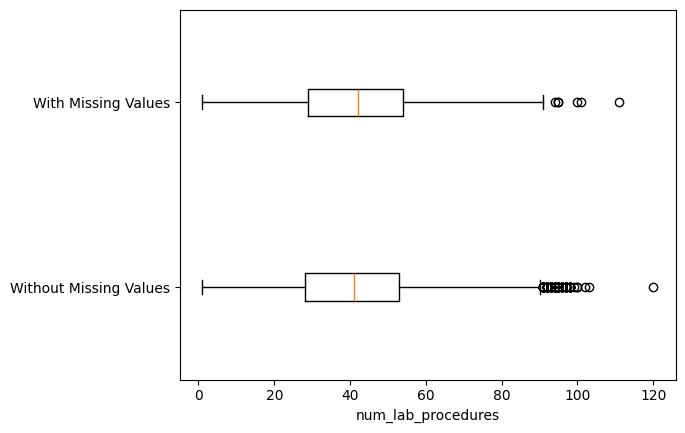

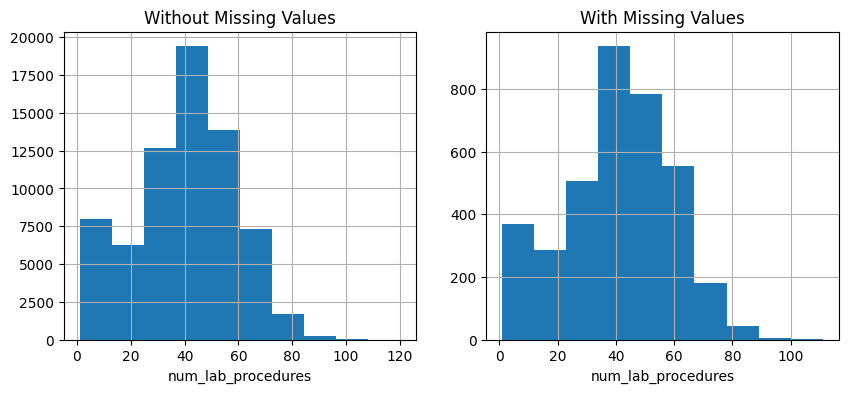

p-value of t-test: 0.14088463070319285
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


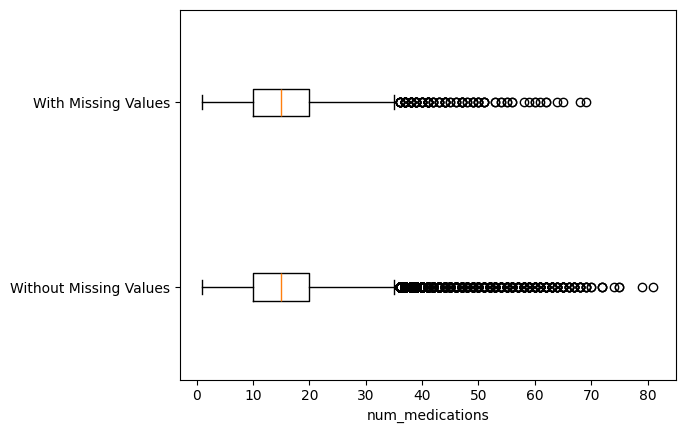

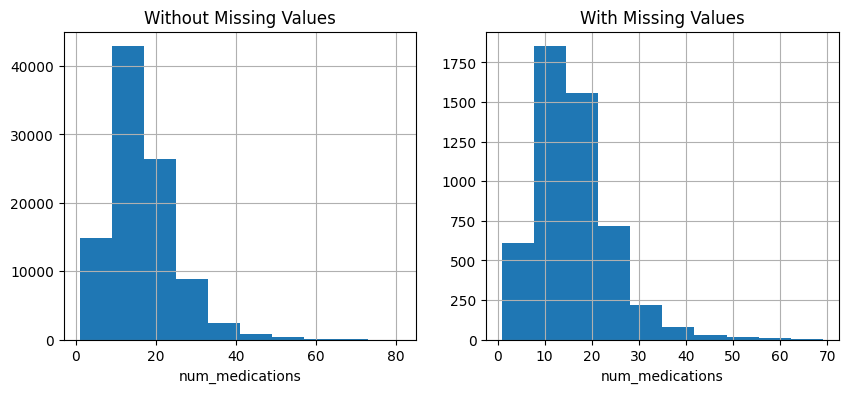

p-value of t-test: 0.8361650003025749
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


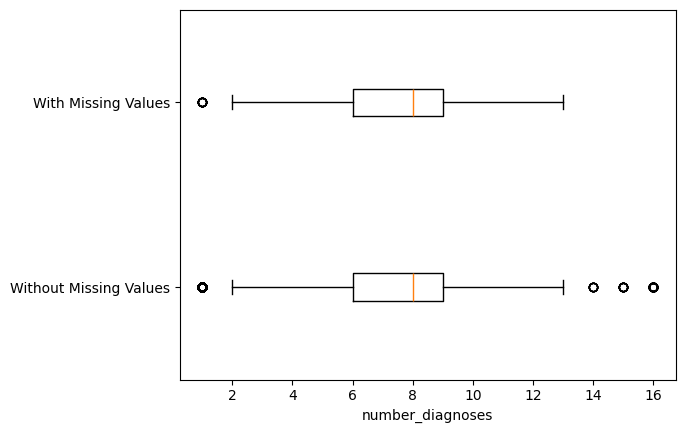

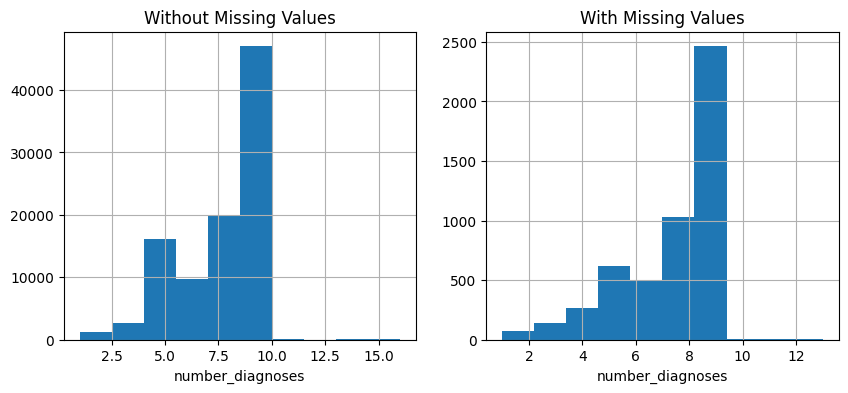

p-value of t-test: 0.27672472247421437
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


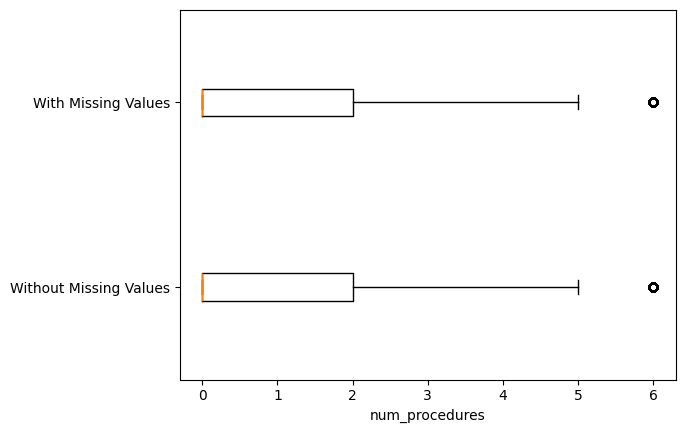

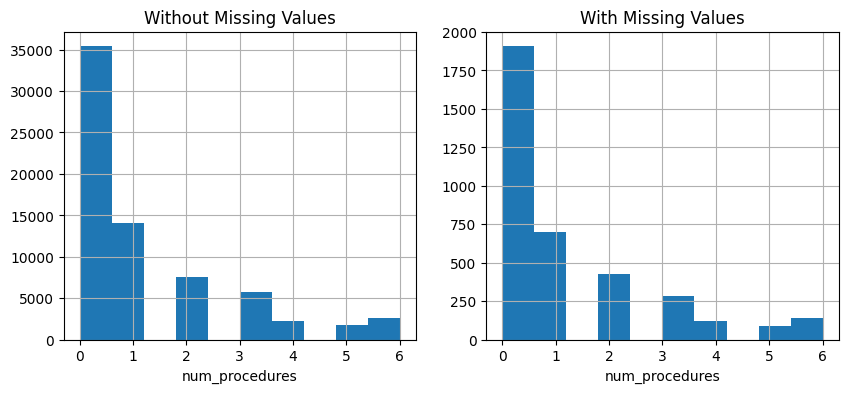

p-value of t-test: 0.6731250690214036
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


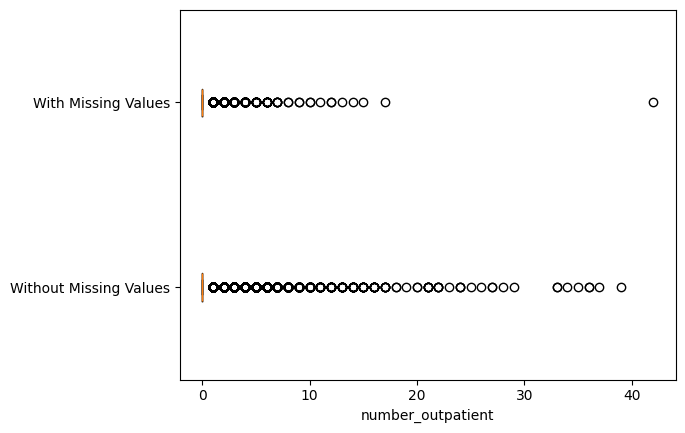

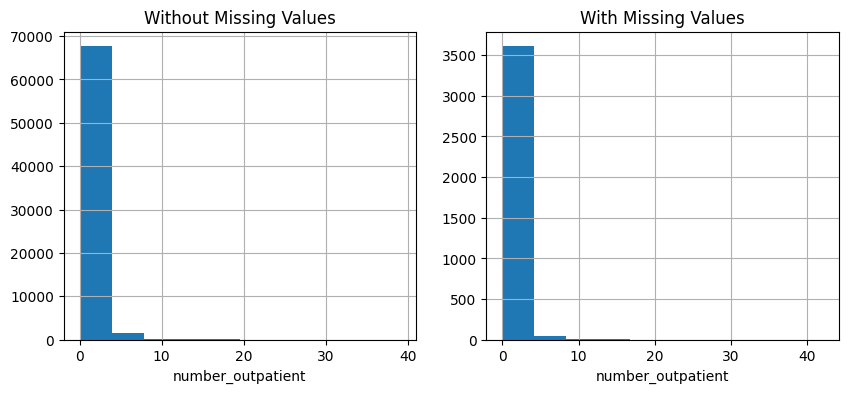

p-value of t-test: 0.683998338393405
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


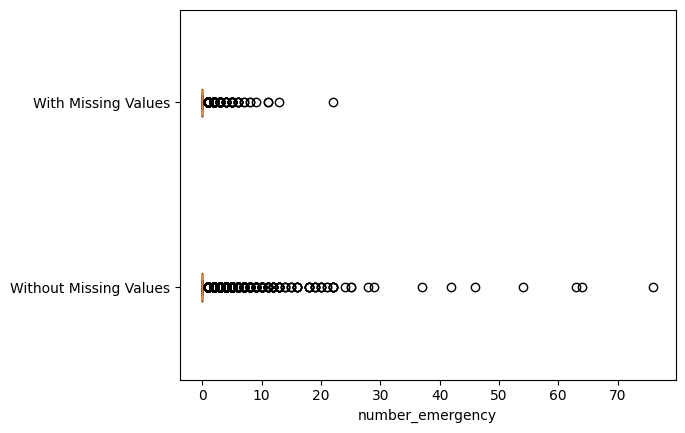

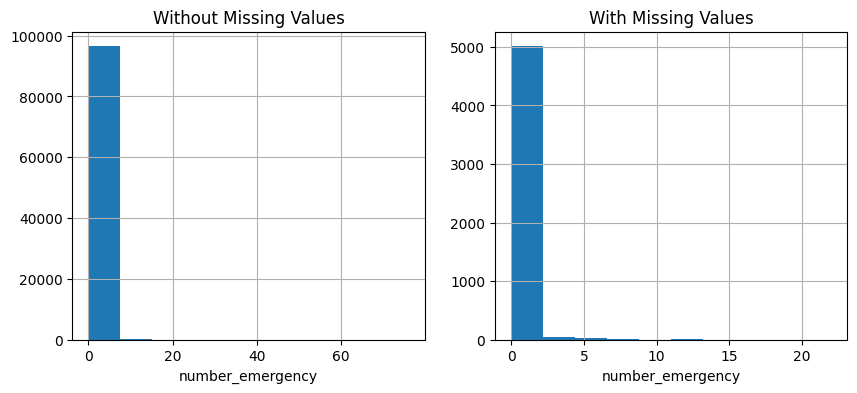

p-value of t-test: 0.44333098355917255
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


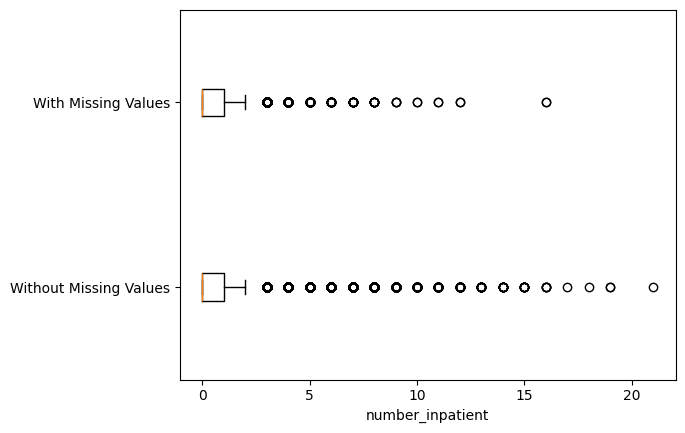

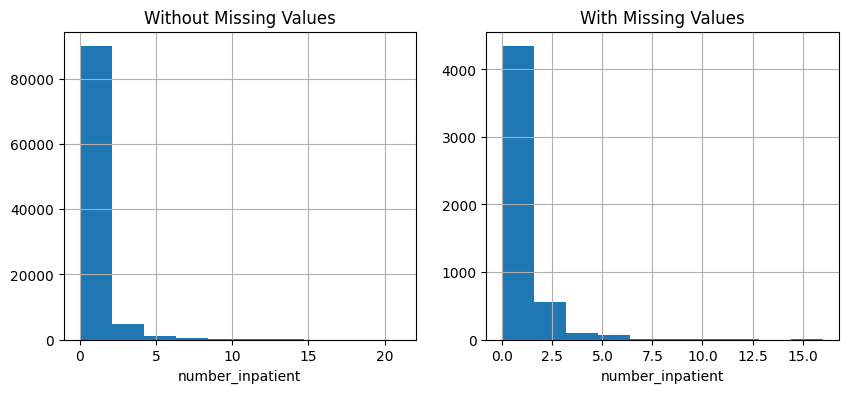

p-value of t-test: 0.8443264262777567
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.gender.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:


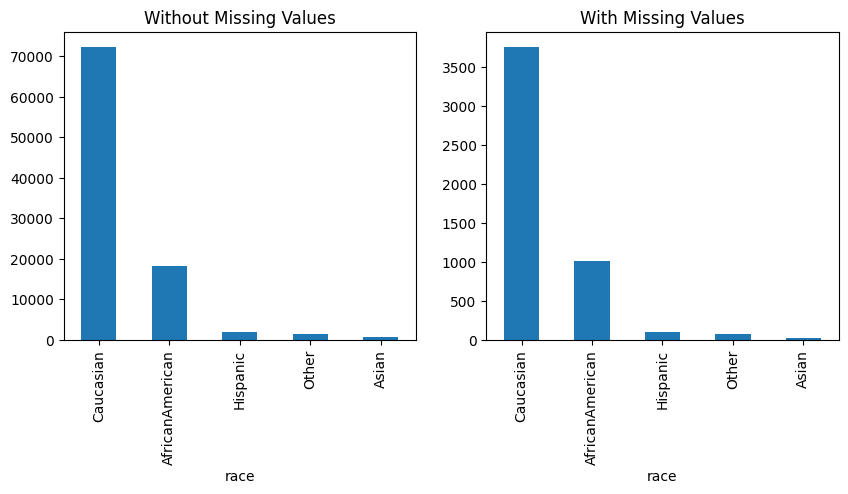

p-value of Chi-squared test: 0.2647842276006342
The missingness in 'race' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:
No data for group: With Missing Values


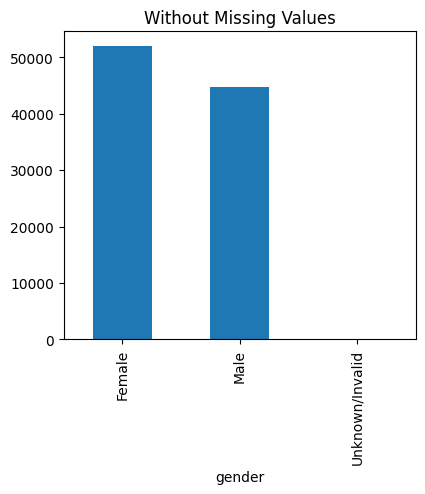

p-value of Chi-squared test: 1.0
The missingness in 'gender' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:
No data for group: With Missing Values


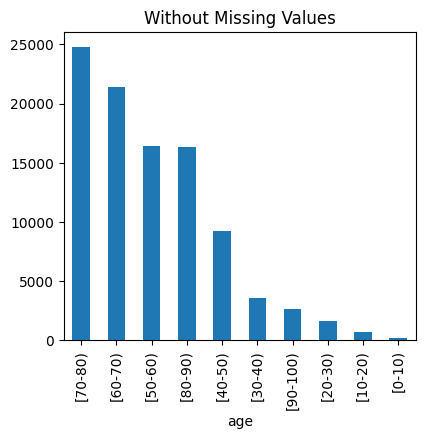

p-value of Chi-squared test: 1.0
The missingness in 'age' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


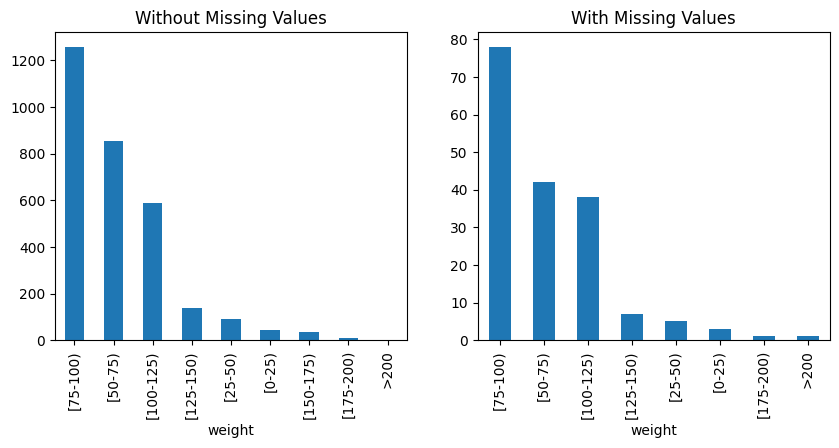

p-value of Chi-squared test: 0.35337455867954026
The missingness in 'weight' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


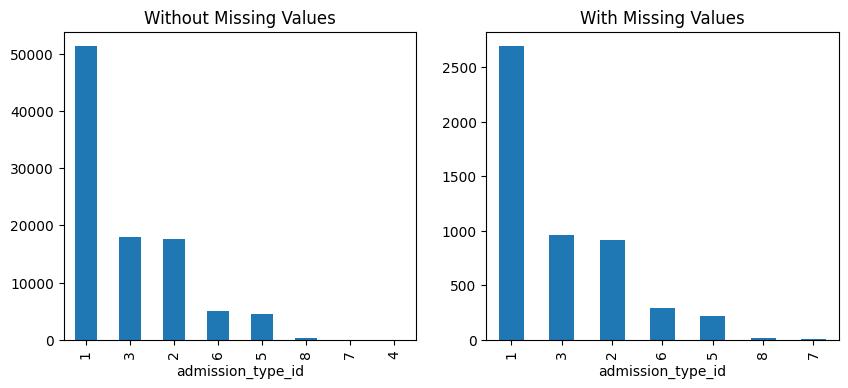

p-value of Chi-squared test: 0.2156296463897584
The missingness in 'admission_type_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


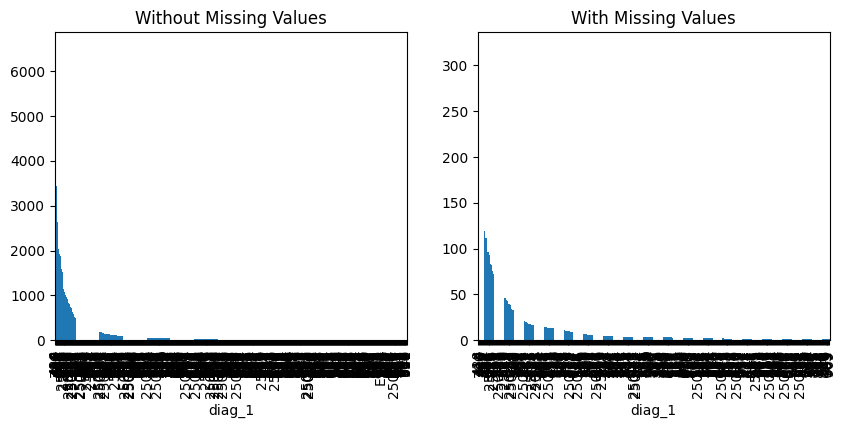

p-value of Chi-squared test: 0.7168806994090389
The missingness in 'diag_1' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


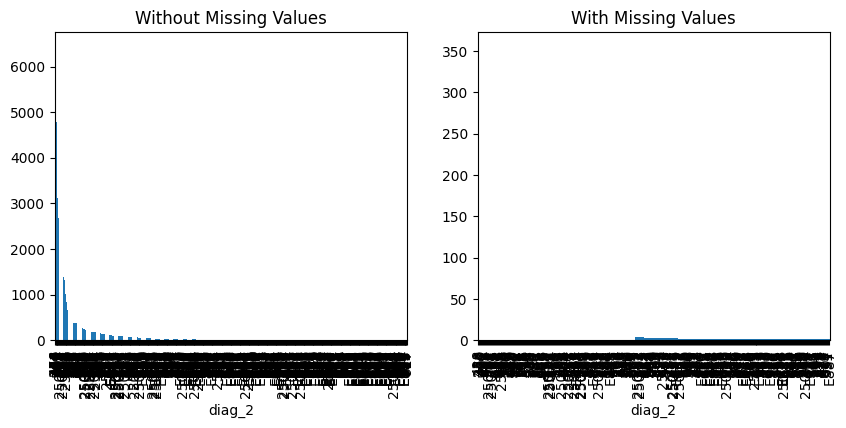

p-value of Chi-squared test: 0.6809790904762887
The missingness in 'diag_2' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


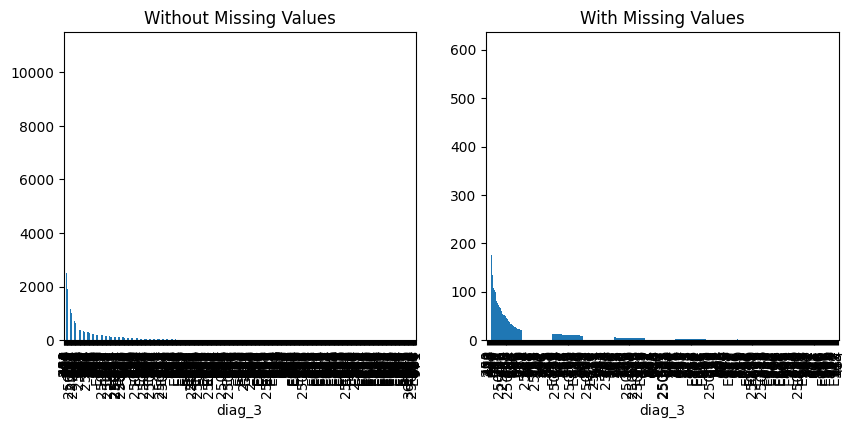

p-value of Chi-squared test: 0.9948366086876607
The missingness in 'diag_3' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


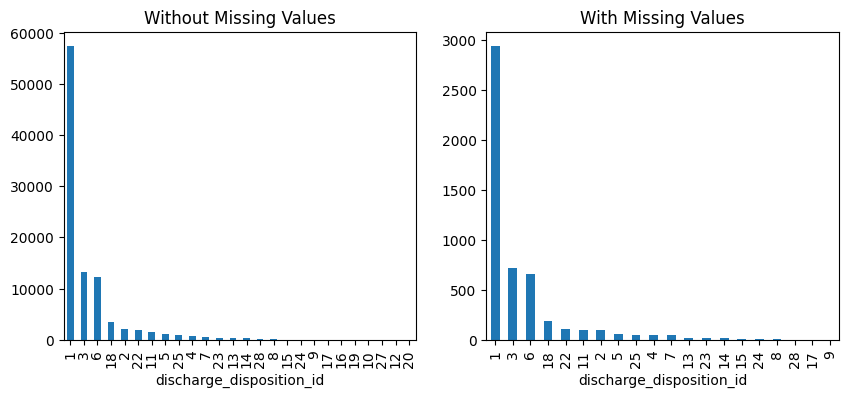

p-value of Chi-squared test: 0.042667990409398525
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


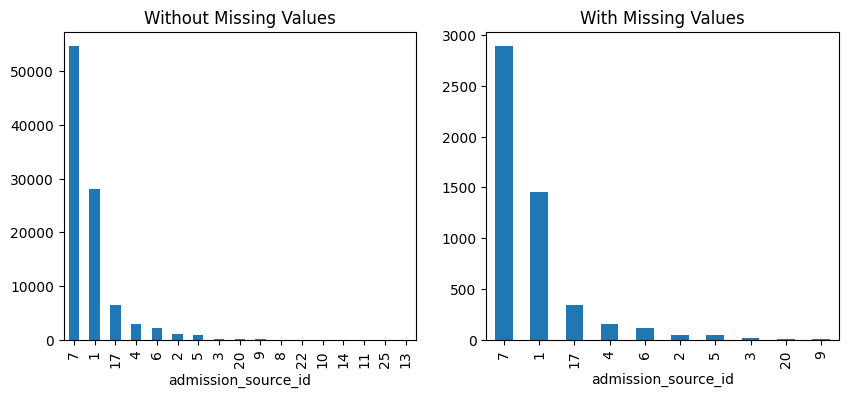

p-value of Chi-squared test: 0.8847789040376904
The missingness in 'admission_source_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


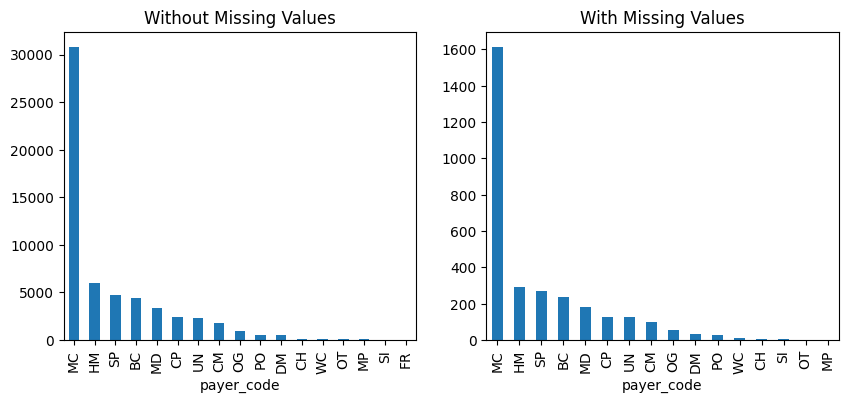

p-value of Chi-squared test: 0.9224445795791779
The missingness in 'payer_code' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


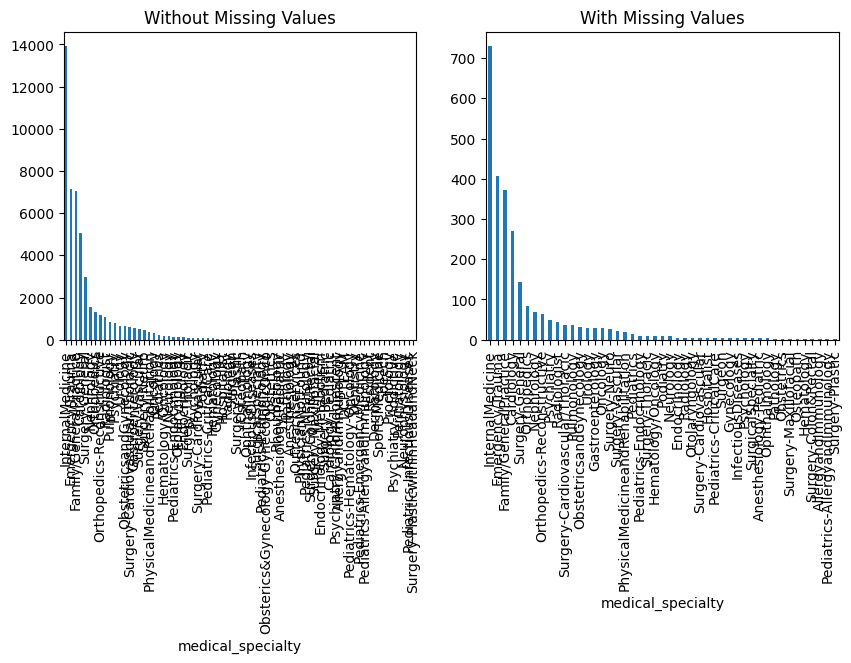

p-value of Chi-squared test: 0.6261592891994615
The missingness in 'medical_specialty' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


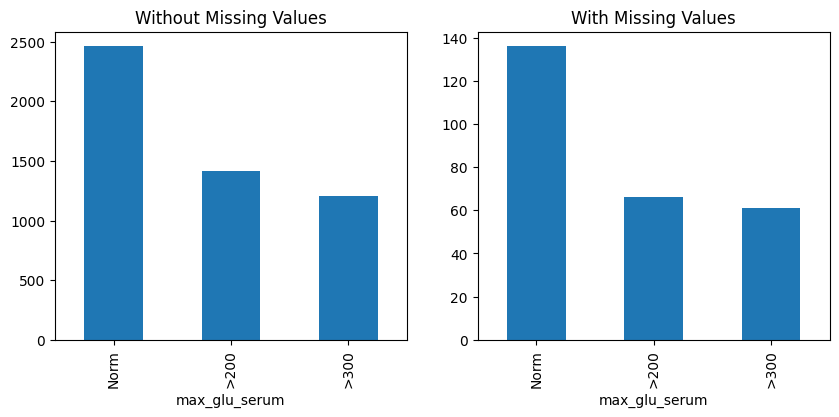

p-value of Chi-squared test: 0.5222711317377877
The missingness in 'max_glu_serum' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


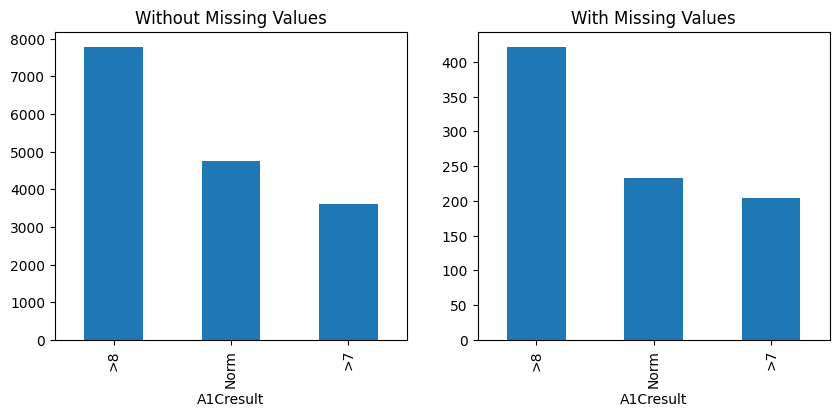

p-value of Chi-squared test: 0.3073908826312302
The missingness in 'A1Cresult' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


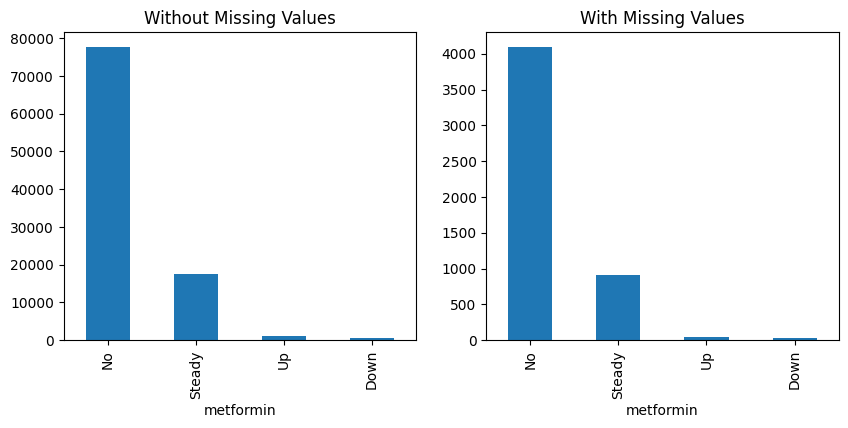

p-value of Chi-squared test: 0.9675107613938304
The missingness in 'metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


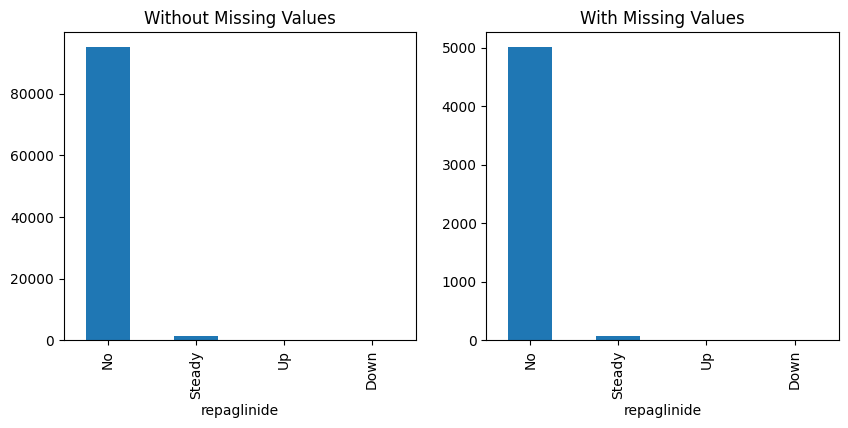

p-value of Chi-squared test: 0.7464056275781121
The missingness in 'repaglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


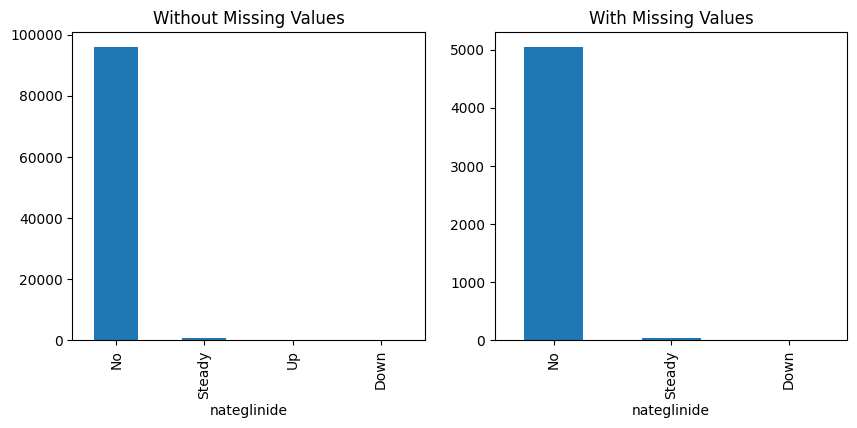

p-value of Chi-squared test: 0.5084539790802478
The missingness in 'nateglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


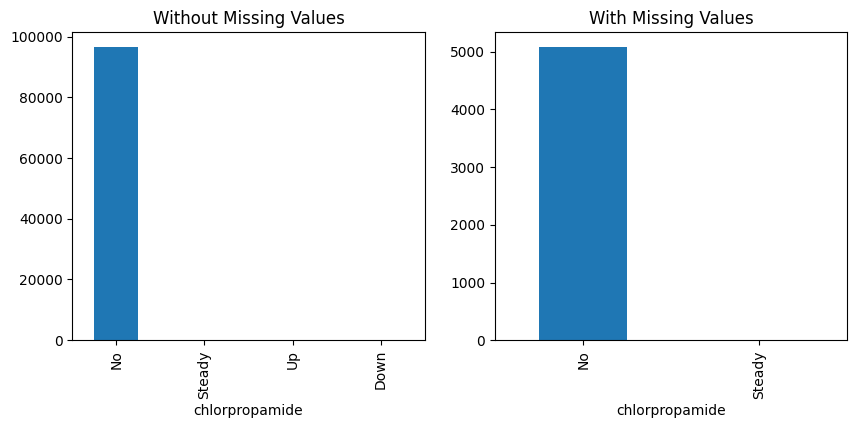

p-value of Chi-squared test: 0.9465512324112891
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


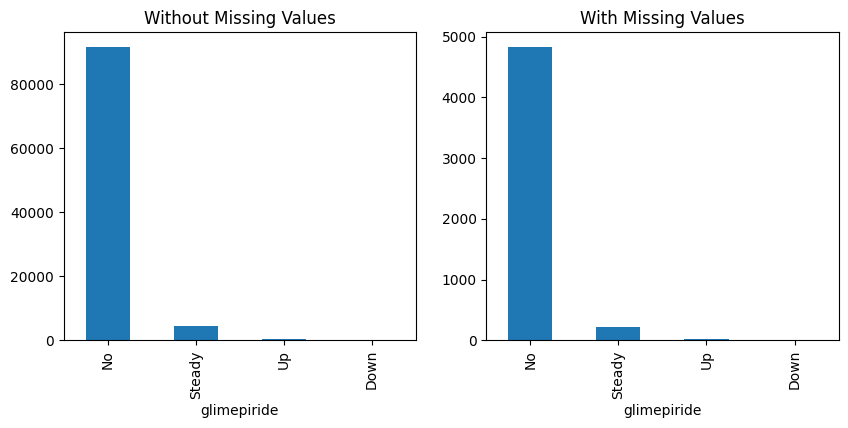

p-value of Chi-squared test: 0.23776525134460813
The missingness in 'glimepiride' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


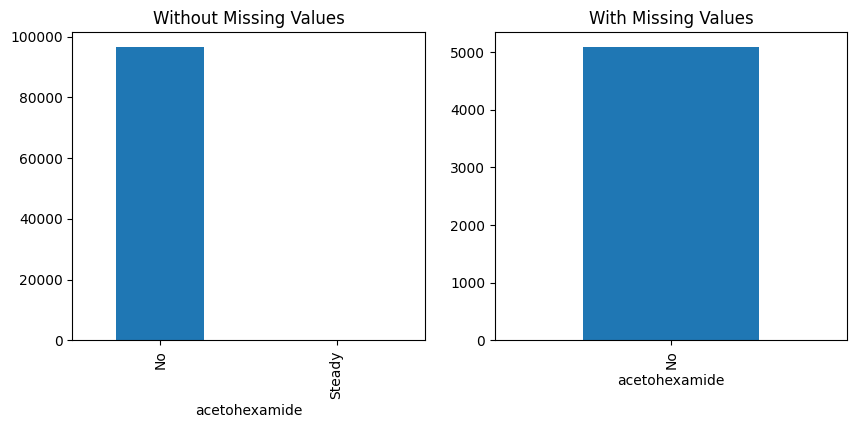

p-value of Chi-squared test: 1.0
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


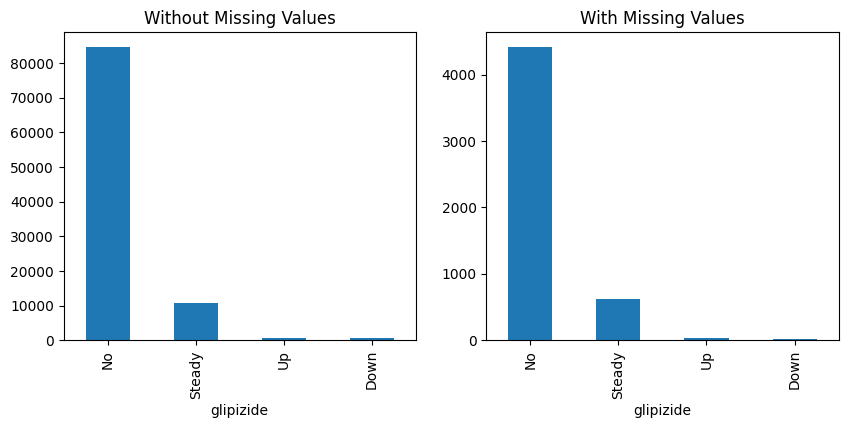

p-value of Chi-squared test: 0.09530596538291047
The missingness in 'glipizide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


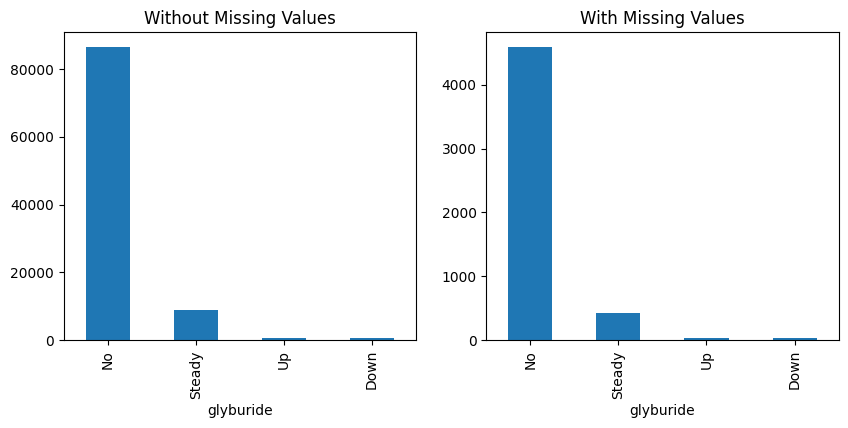

p-value of Chi-squared test: 0.43543731515767126
The missingness in 'glyburide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


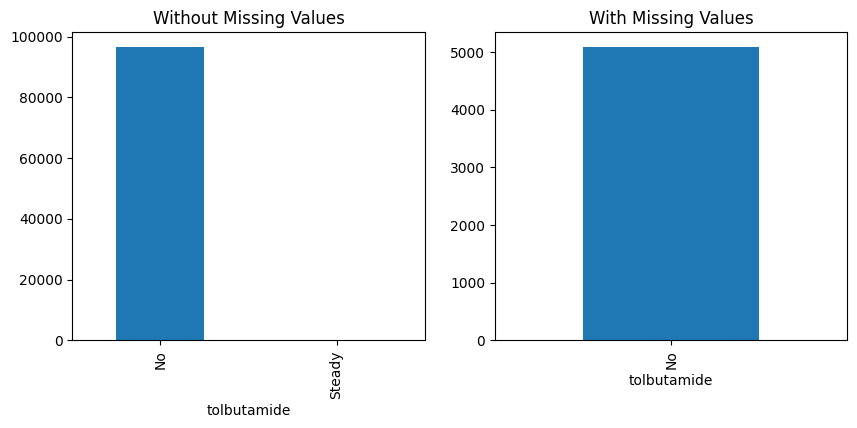

p-value of Chi-squared test: 0.5340095228973467
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


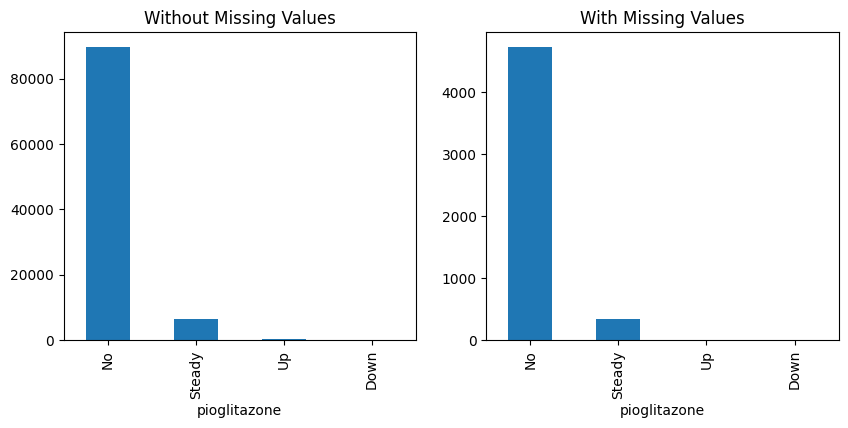

p-value of Chi-squared test: 0.8457110896342045
The missingness in 'pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


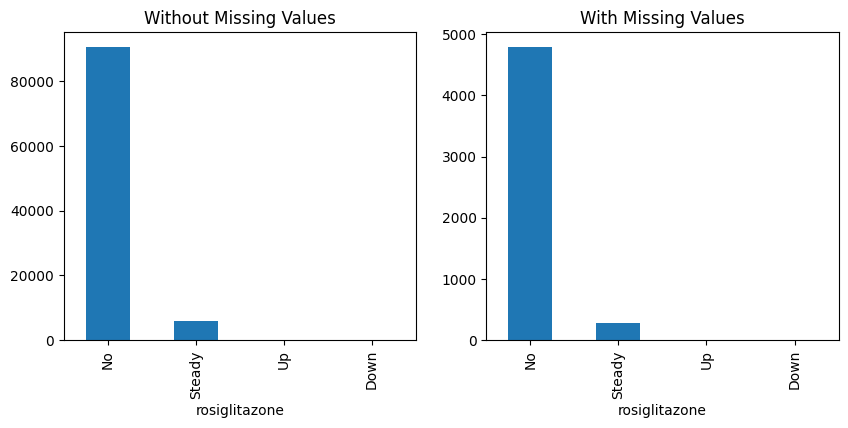

p-value of Chi-squared test: 0.47147669425103156
The missingness in 'rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


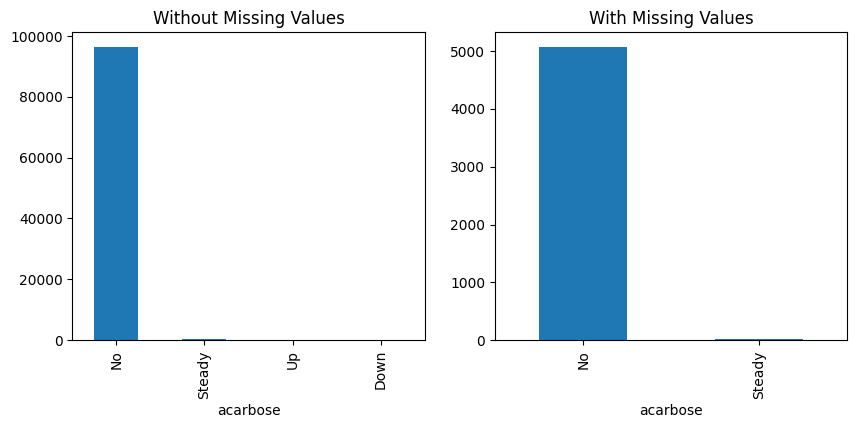

p-value of Chi-squared test: 0.7900545391384801
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


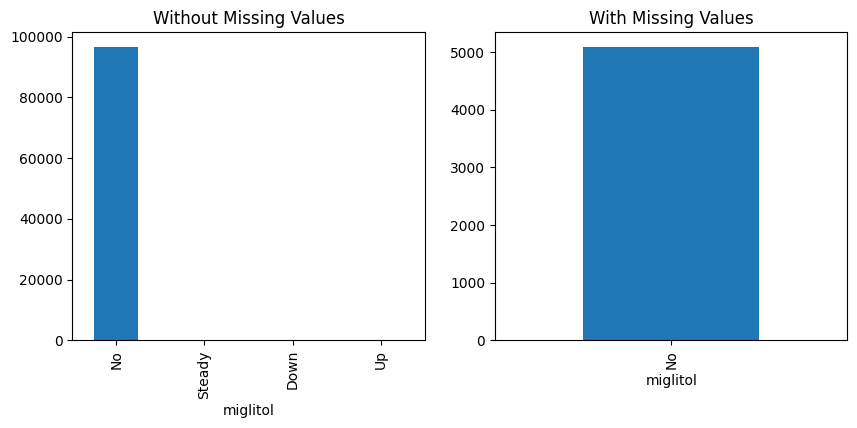

p-value of Chi-squared test: 0.5722774250462166
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


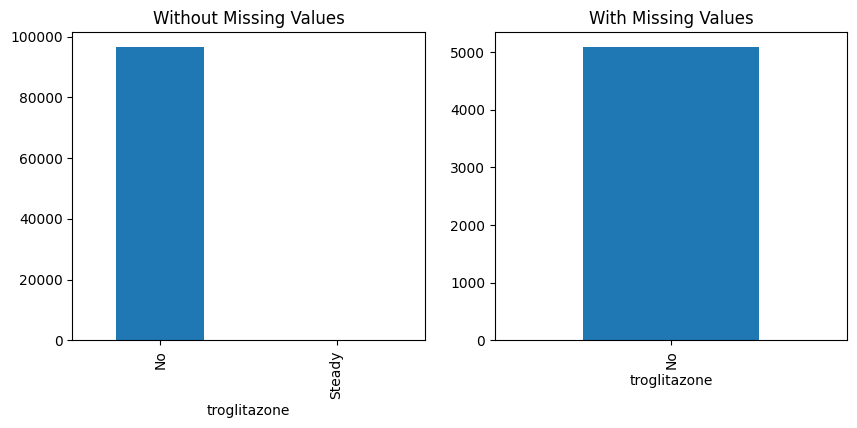

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


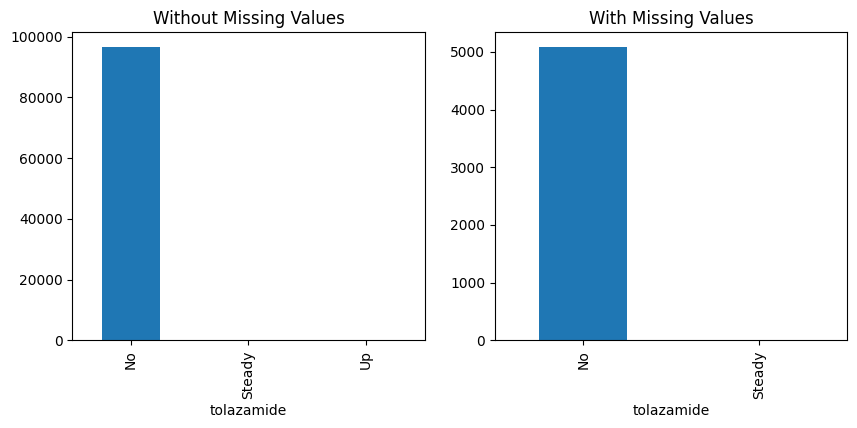

p-value of Chi-squared test: 0.9713282016764782
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


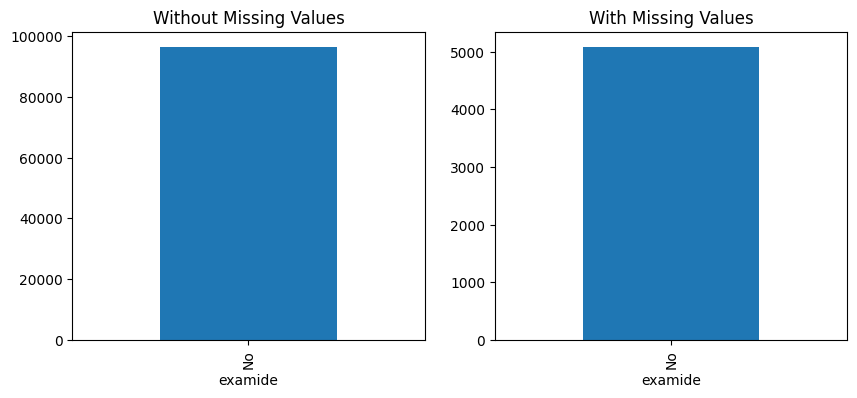

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


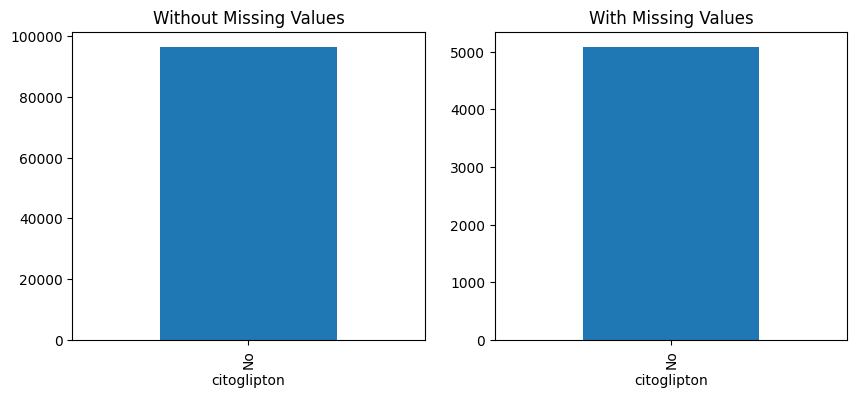

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:
No data for group: With Missing Values


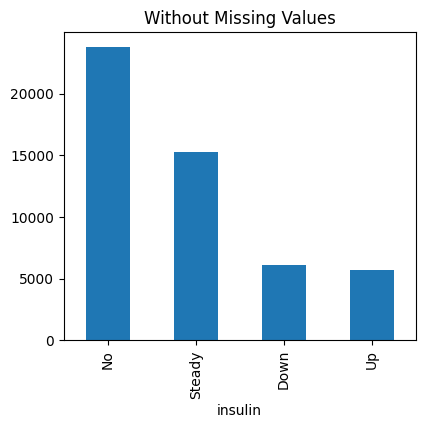

p-value of Chi-squared test: 1.0
The missingness in 'insulin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


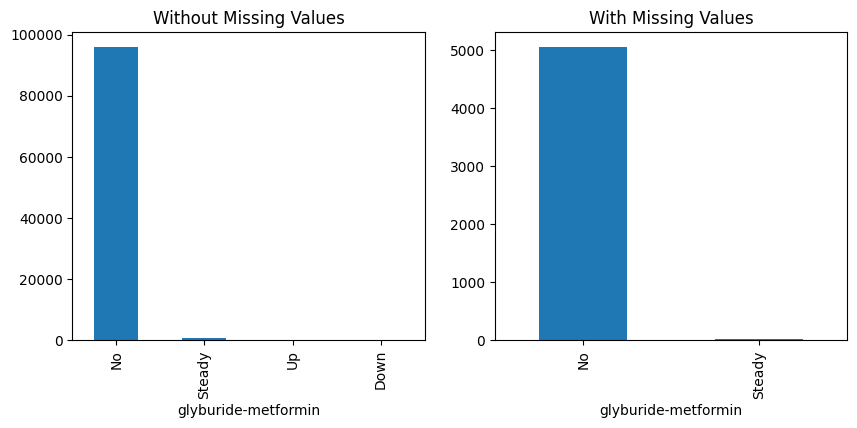

p-value of Chi-squared test: 0.6372719429870362
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


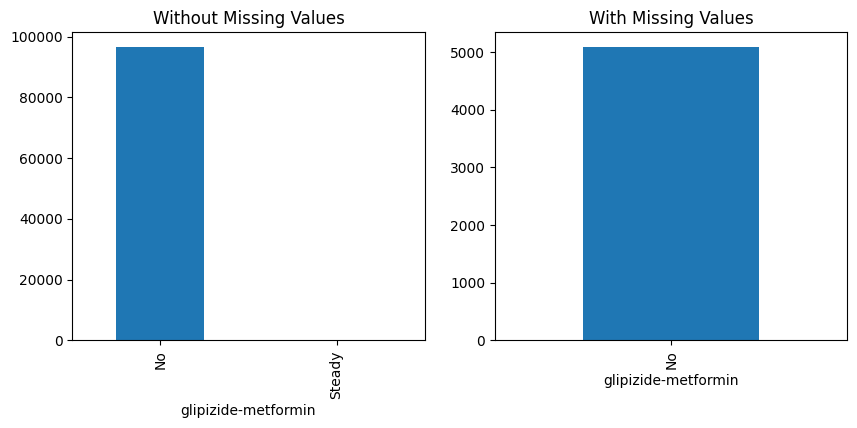

p-value of Chi-squared test: 0.8486398389071088
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


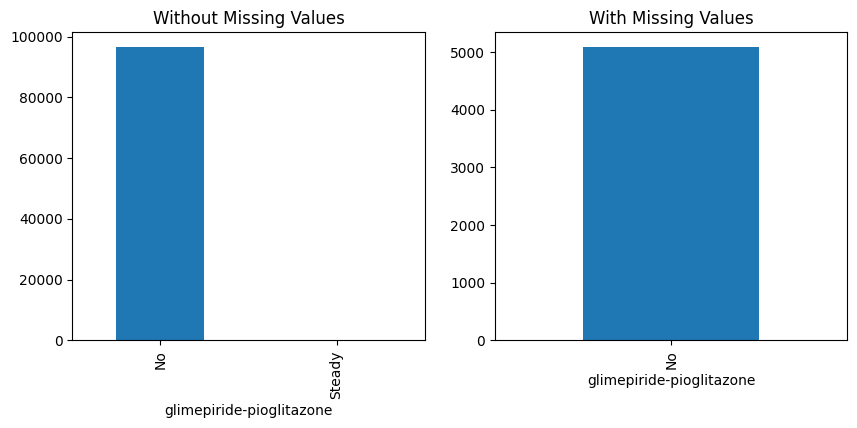

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


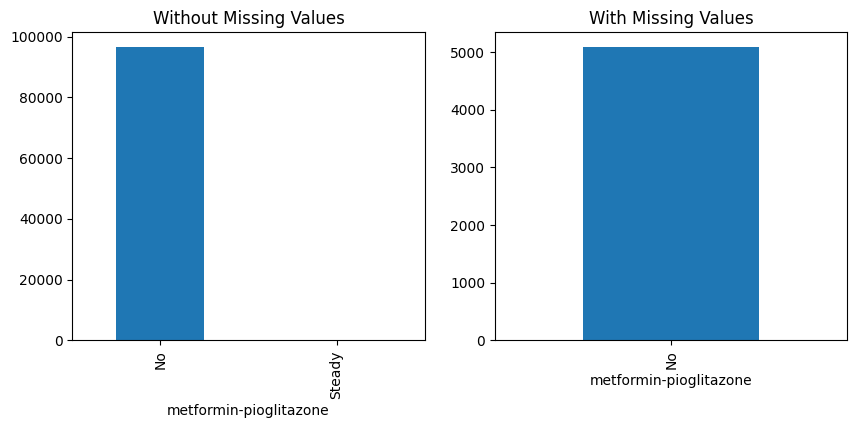

p-value of Chi-squared test: 1.0
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


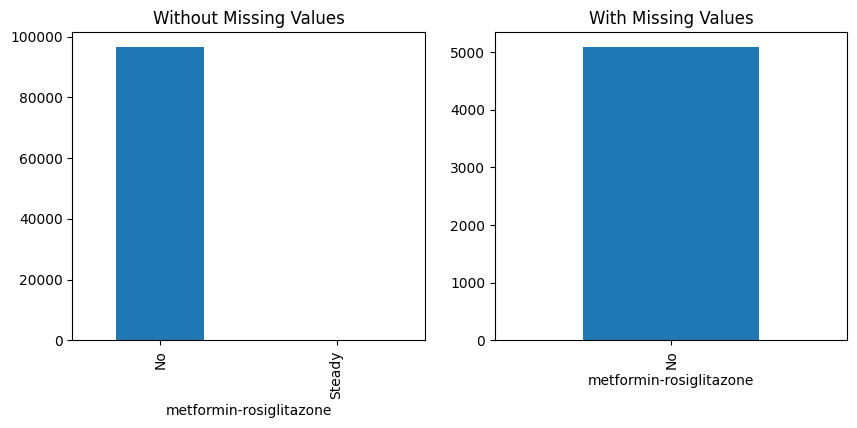

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


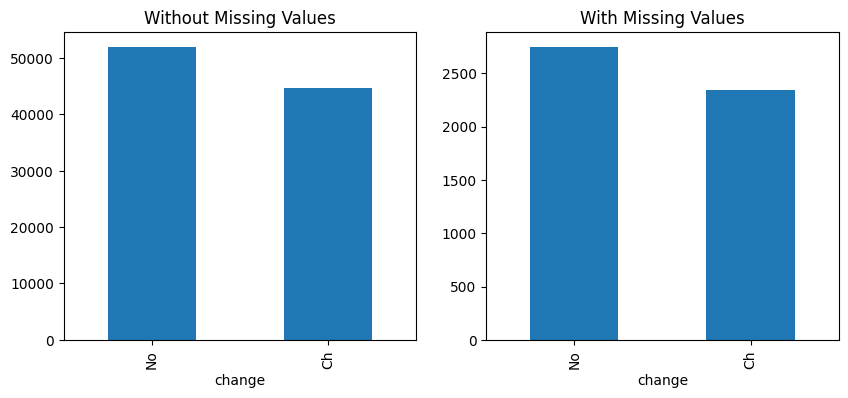

p-value of Chi-squared test: 0.7311083112495051
The missingness in 'change' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


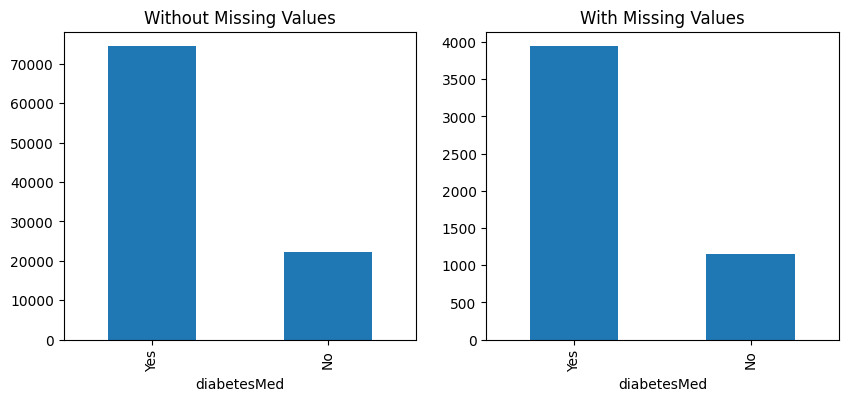

p-value of Chi-squared test: 0.4402181954189268
The missingness in 'diabetesMed' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


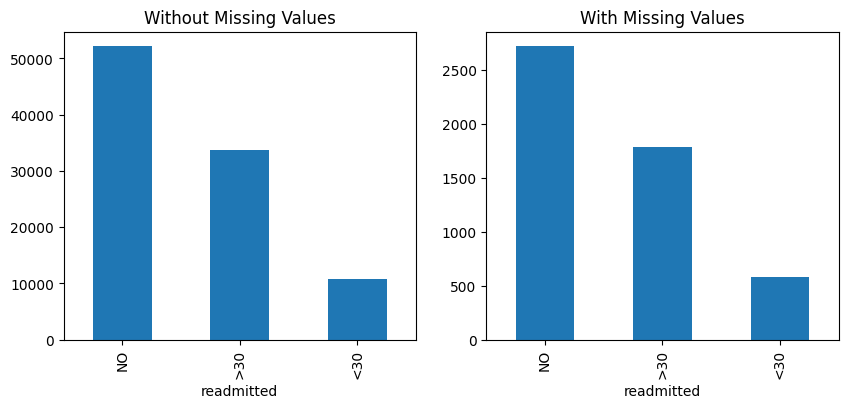

p-value of Chi-squared test: 0.7062542484705228
The missingness in 'readmitted' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.gender.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### After going through the analysis we can say `gender` is of MCAR

## Detecting Missing Type for age

Diagnosis Analysis of Missing Values for time_in_hospital:


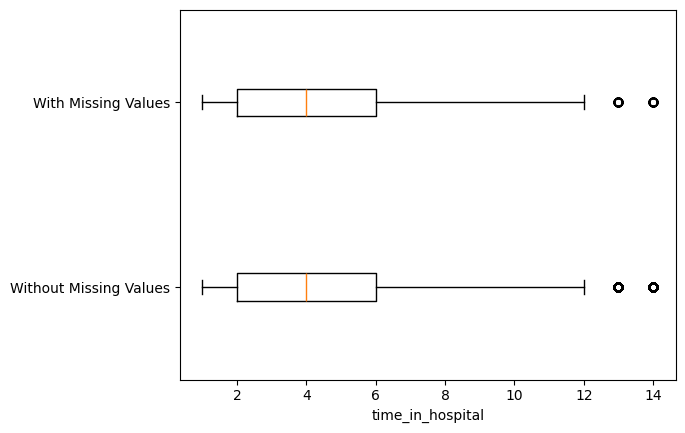

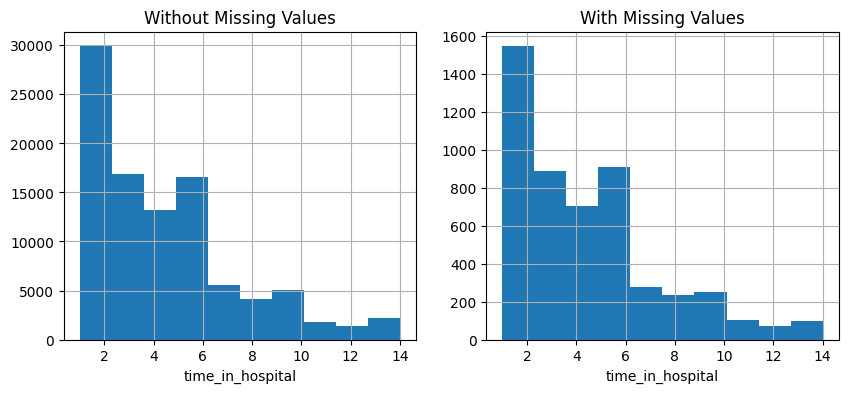

p-value of t-test: 0.6899881209632889
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


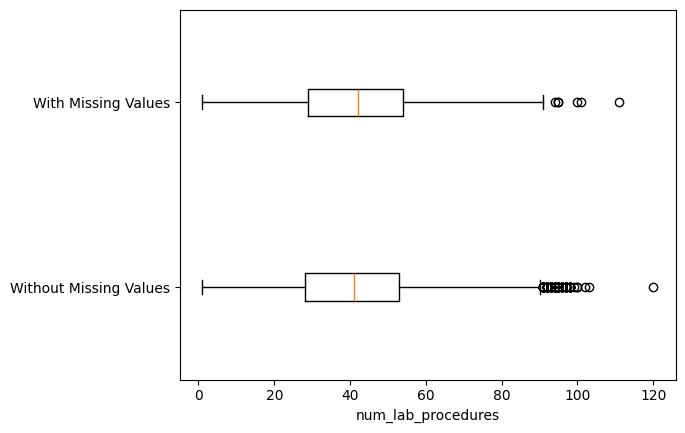

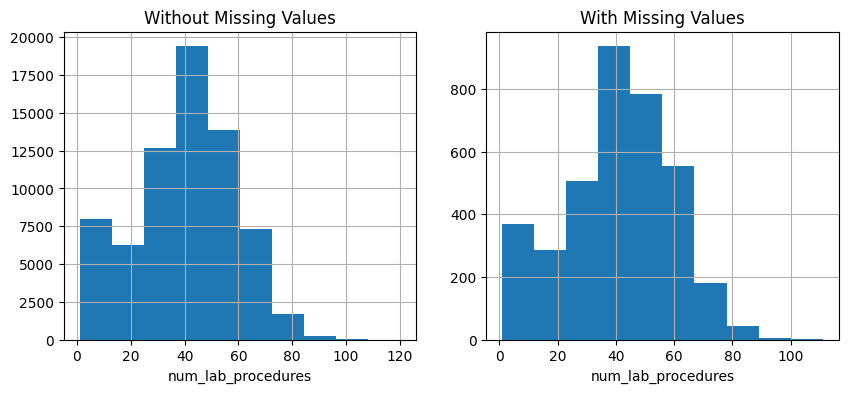

p-value of t-test: 0.14088463070319285
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


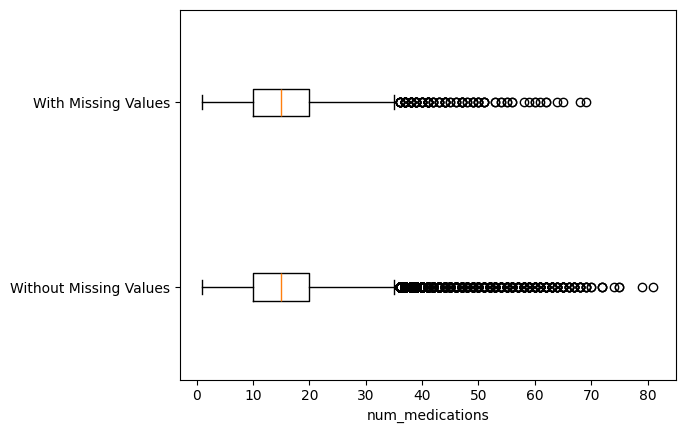

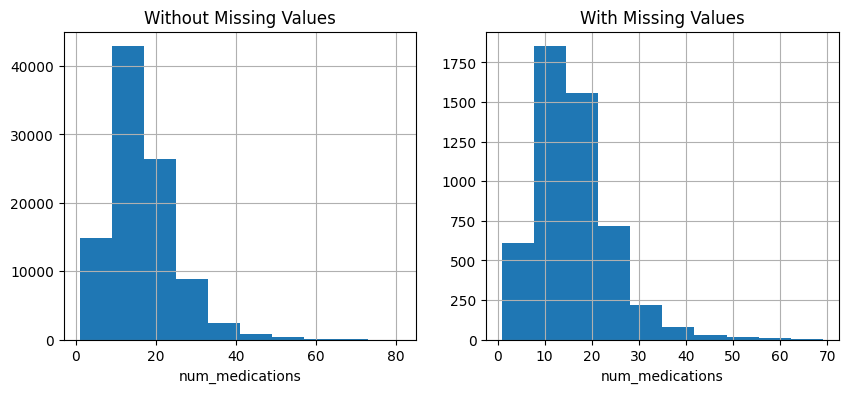

p-value of t-test: 0.8361650003025749
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


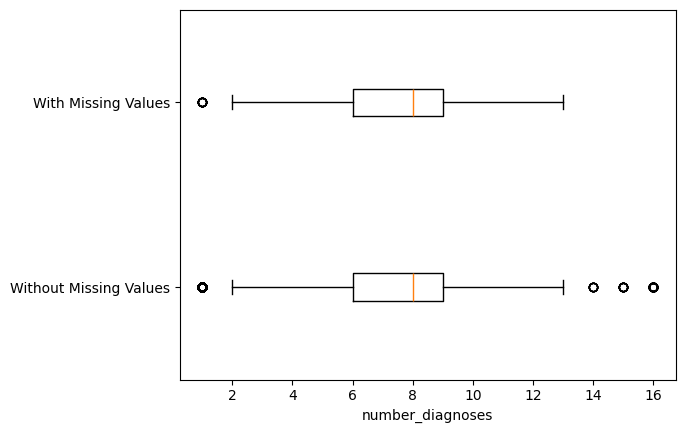

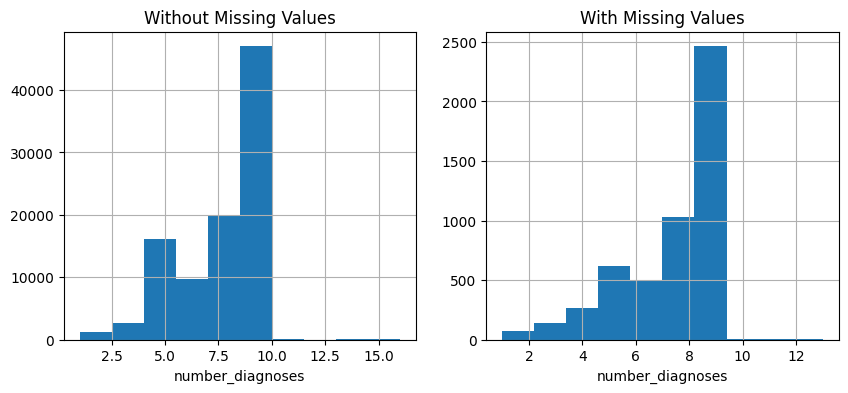

p-value of t-test: 0.27672472247421437
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


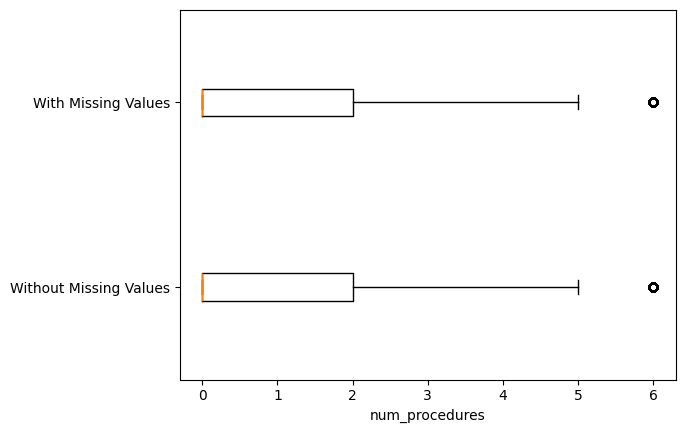

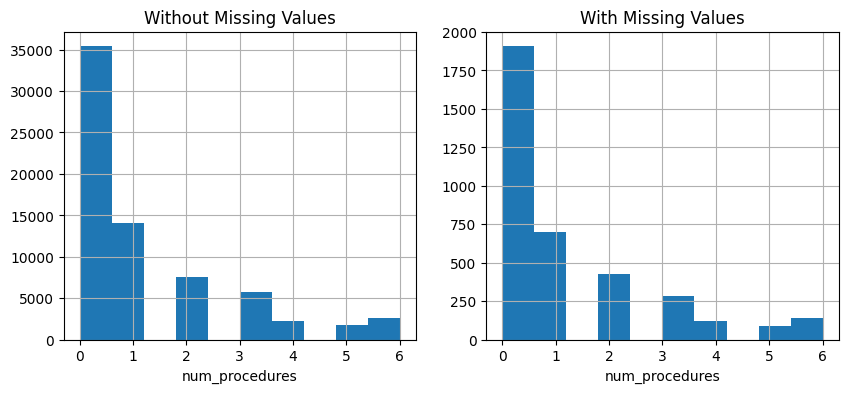

p-value of t-test: 0.6731250690214036
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


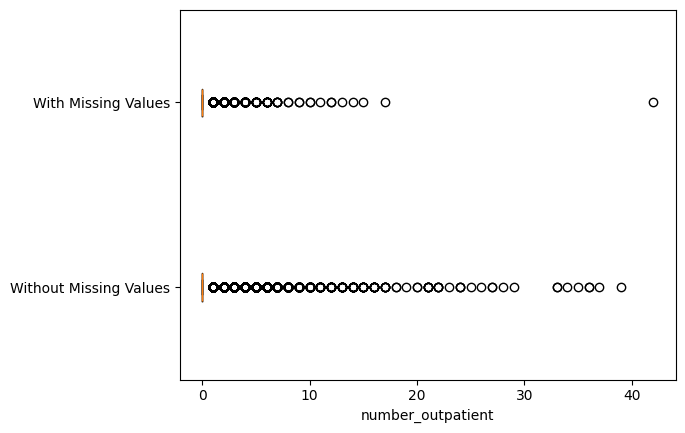

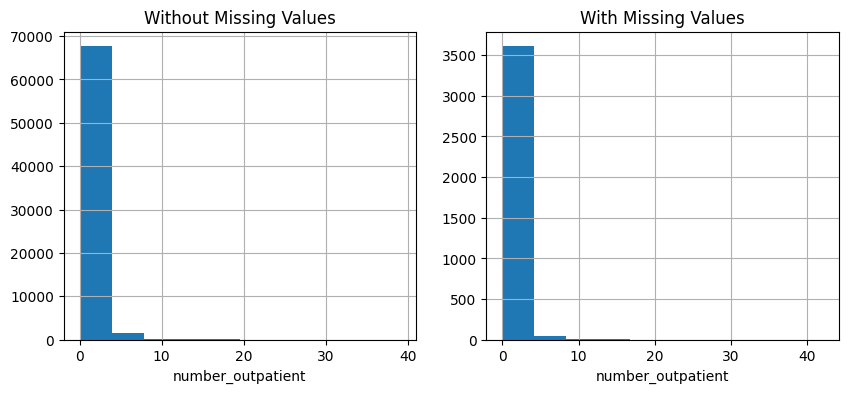

p-value of t-test: 0.683998338393405
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


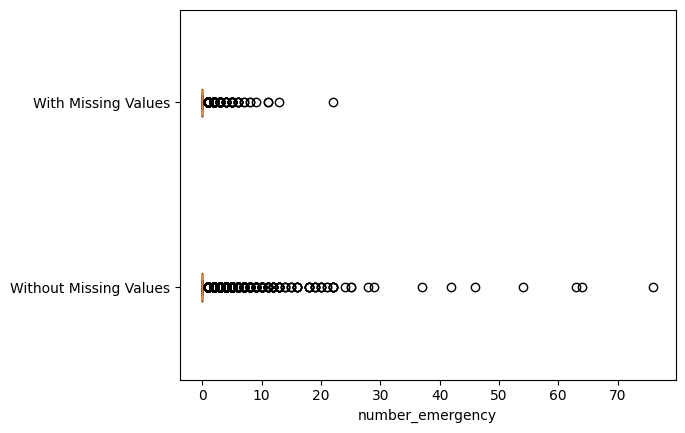

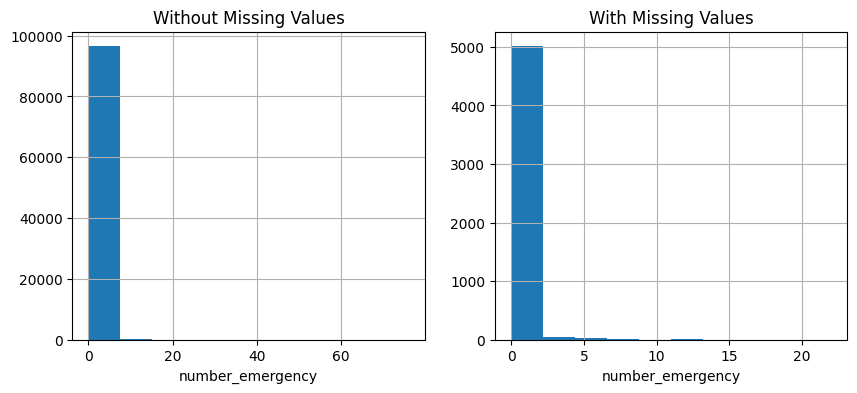

p-value of t-test: 0.44333098355917255
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


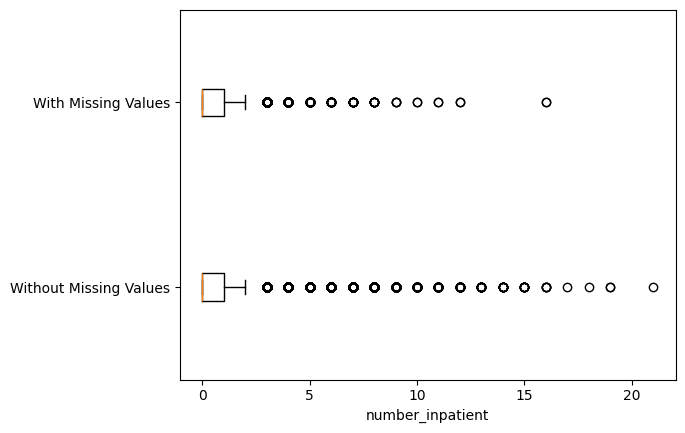

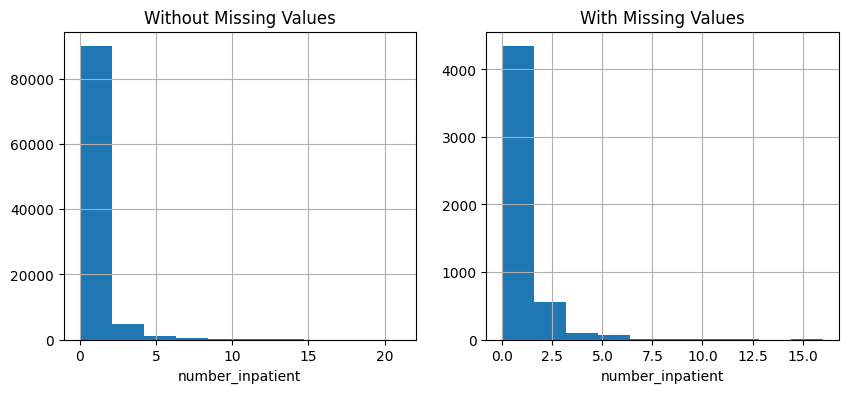

p-value of t-test: 0.8443264262777567
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.age.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:


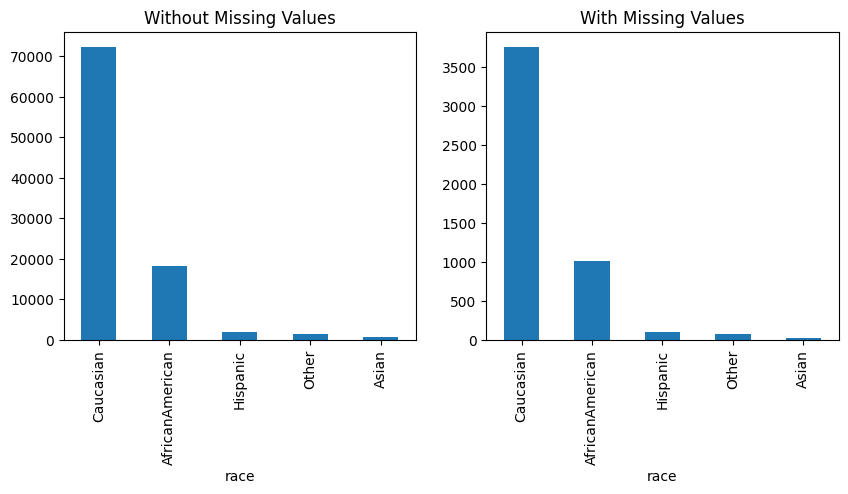

p-value of Chi-squared test: 0.2647842276006342
The missingness in 'race' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:
No data for group: With Missing Values


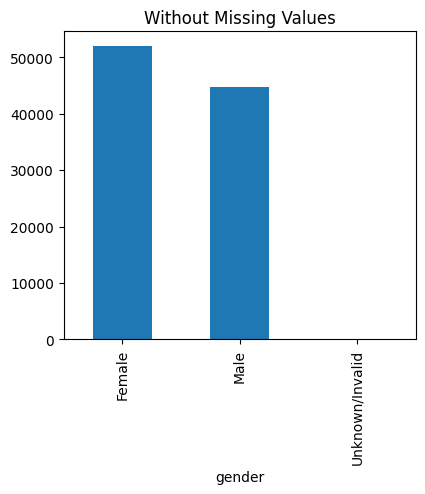

p-value of Chi-squared test: 1.0
The missingness in 'gender' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:
No data for group: With Missing Values


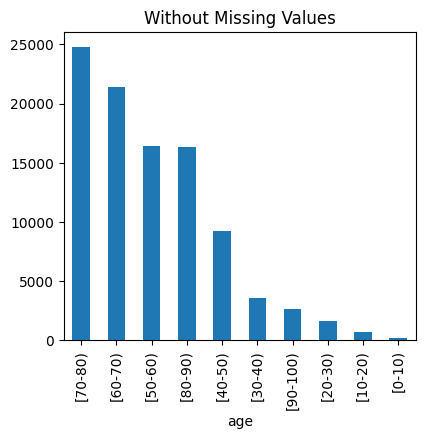

p-value of Chi-squared test: 1.0
The missingness in 'age' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


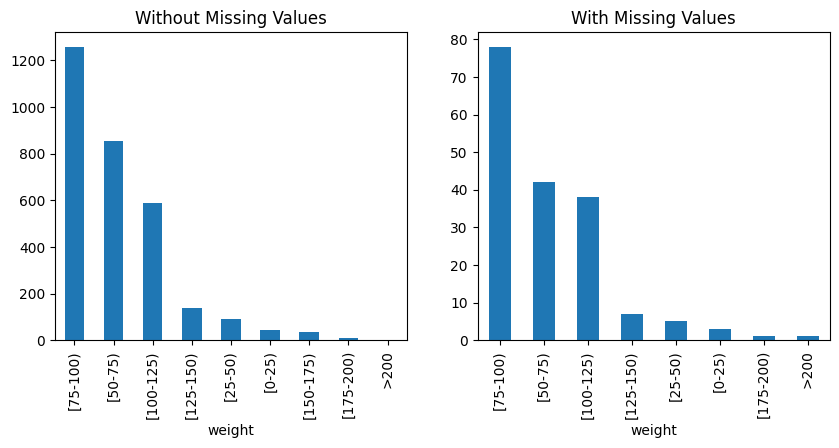

p-value of Chi-squared test: 0.35337455867954026
The missingness in 'weight' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


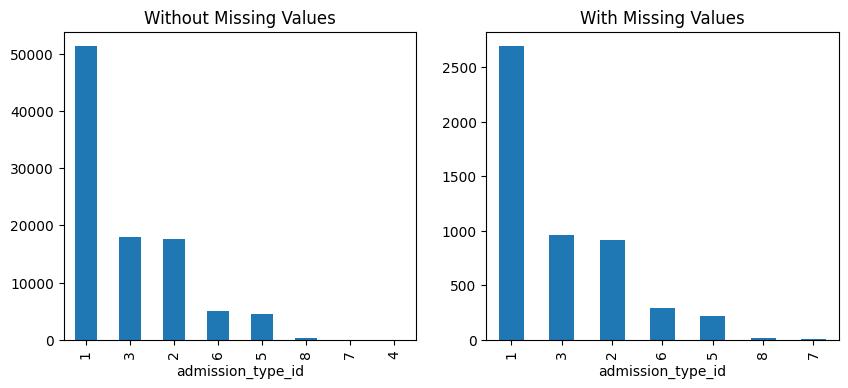

p-value of Chi-squared test: 0.2156296463897584
The missingness in 'admission_type_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


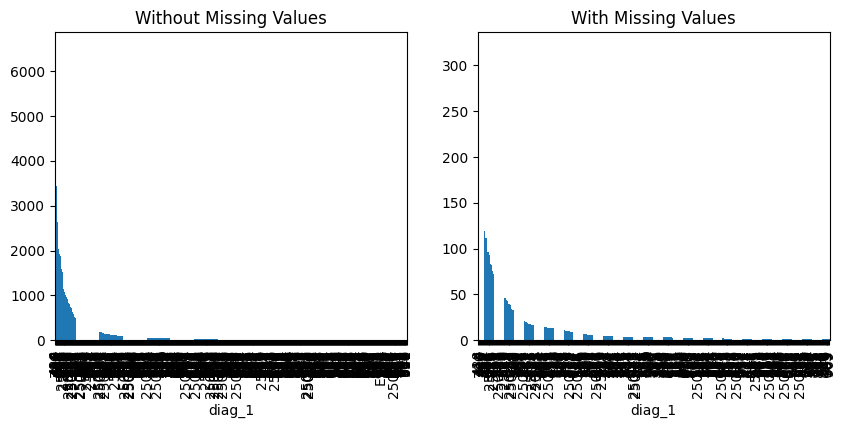

p-value of Chi-squared test: 0.7168806994090389
The missingness in 'diag_1' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


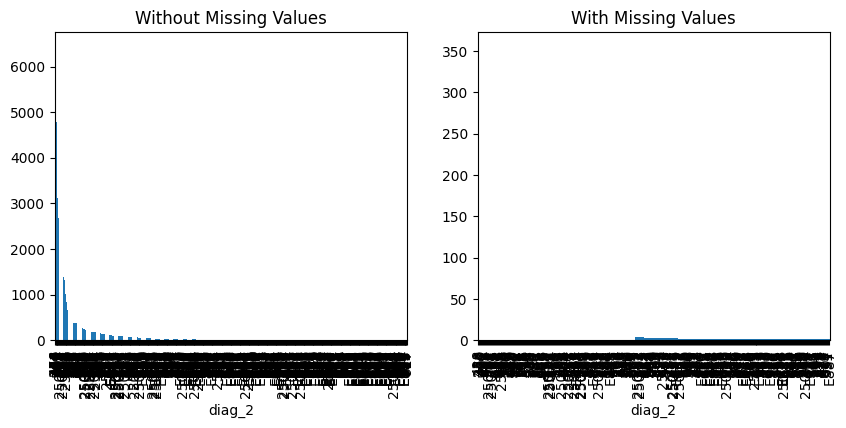

p-value of Chi-squared test: 0.6809790904762887
The missingness in 'diag_2' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


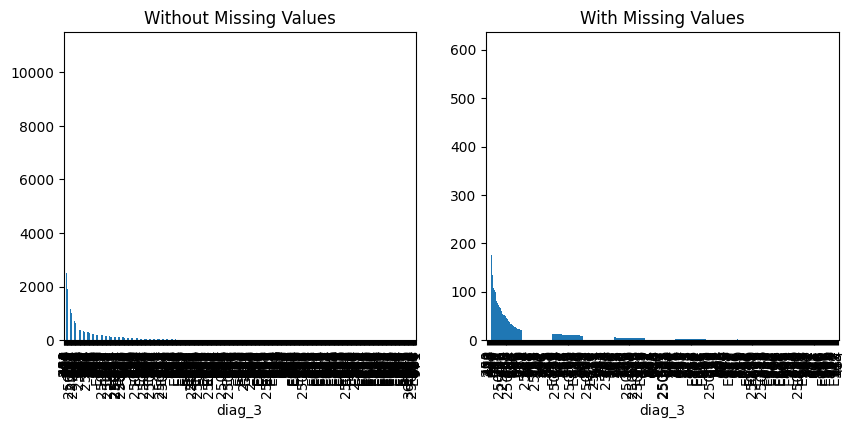

p-value of Chi-squared test: 0.9948366086876607
The missingness in 'diag_3' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


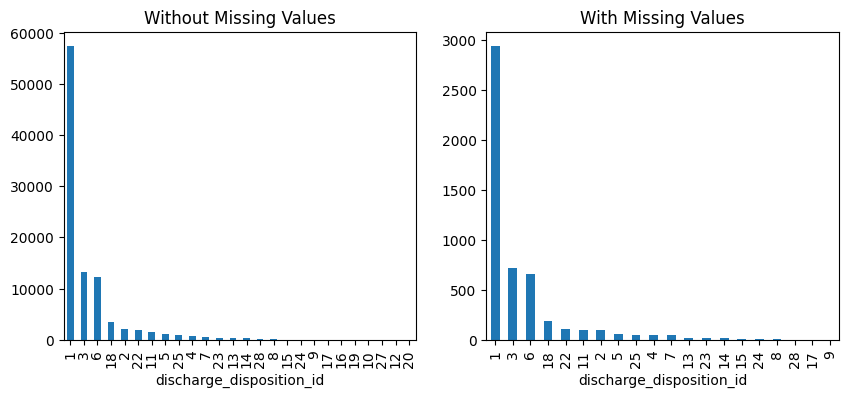

p-value of Chi-squared test: 0.042667990409398525
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


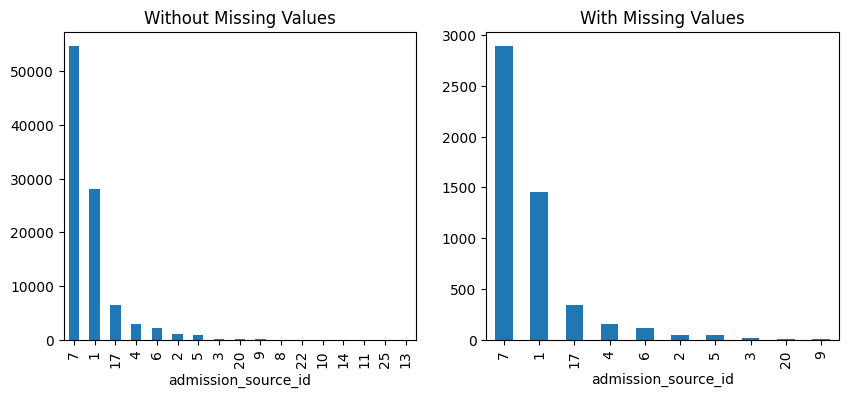

p-value of Chi-squared test: 0.8847789040376904
The missingness in 'admission_source_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


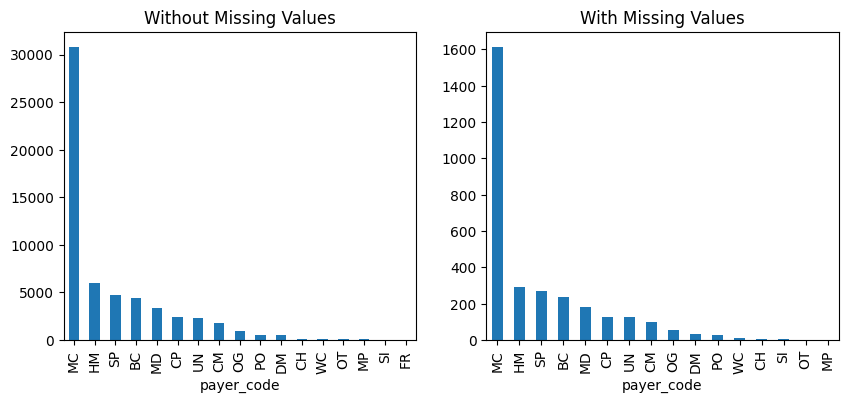

p-value of Chi-squared test: 0.9224445795791779
The missingness in 'payer_code' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


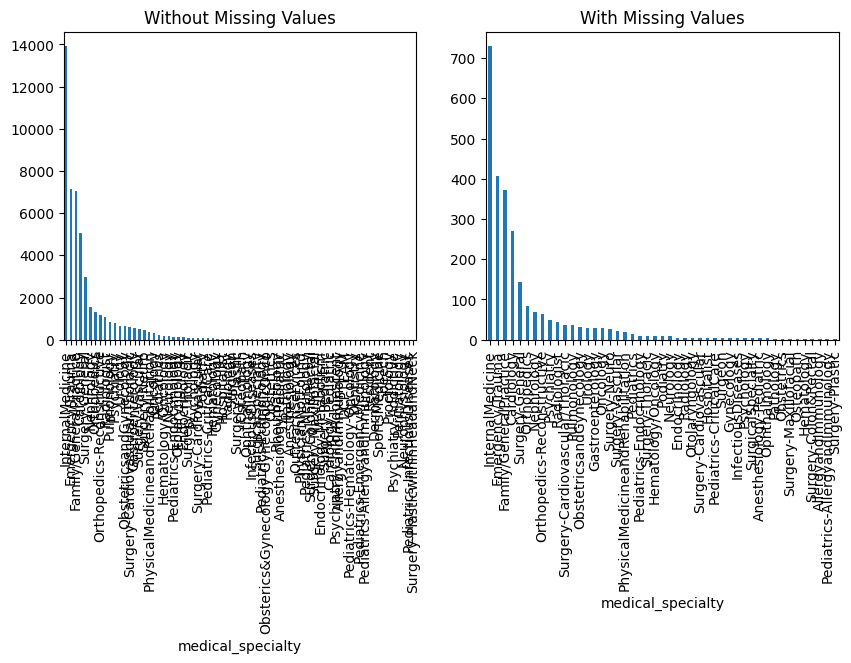

p-value of Chi-squared test: 0.6261592891994615
The missingness in 'medical_specialty' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


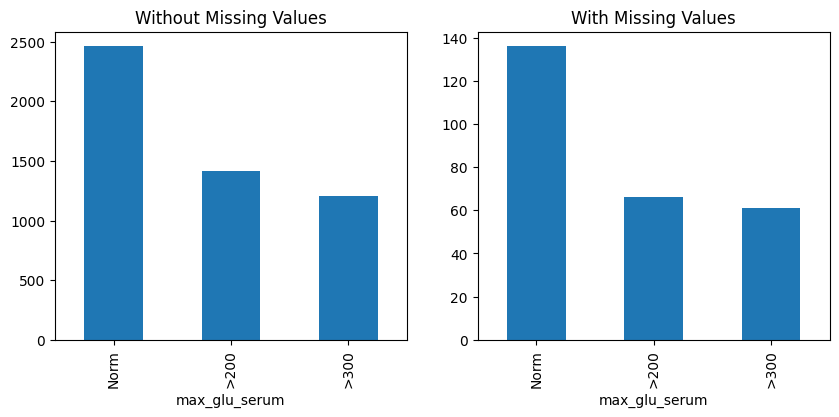

p-value of Chi-squared test: 0.5222711317377877
The missingness in 'max_glu_serum' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


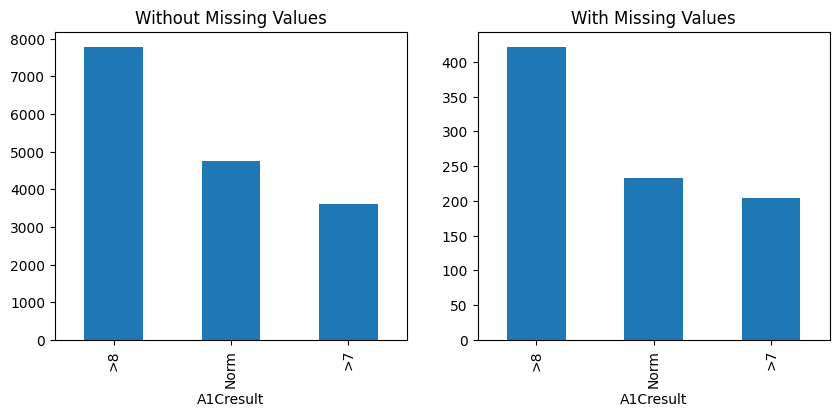

p-value of Chi-squared test: 0.3073908826312302
The missingness in 'A1Cresult' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


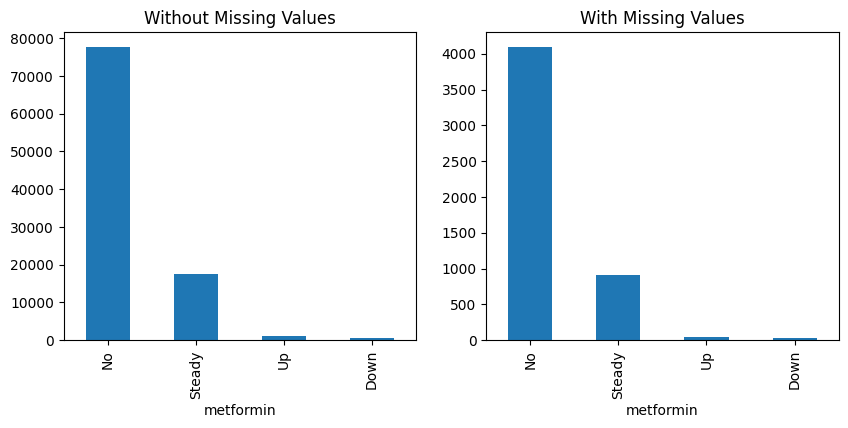

p-value of Chi-squared test: 0.9675107613938304
The missingness in 'metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


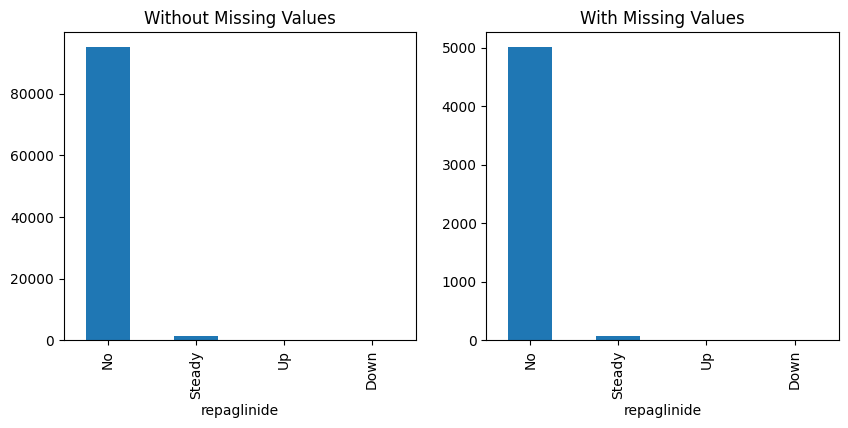

p-value of Chi-squared test: 0.7464056275781121
The missingness in 'repaglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


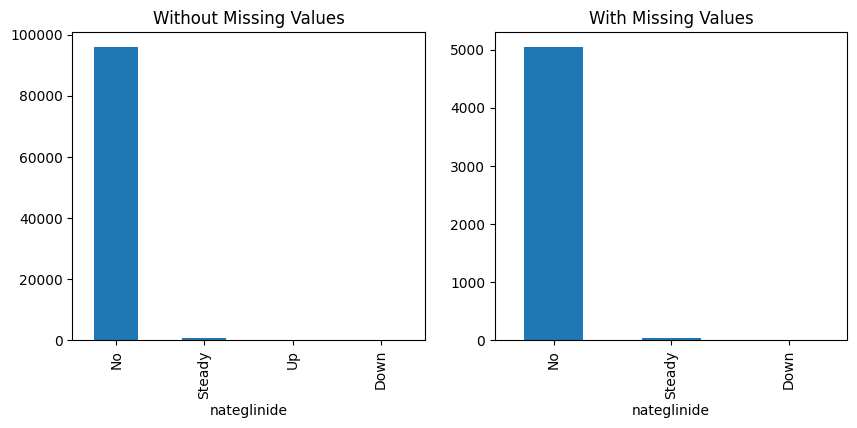

p-value of Chi-squared test: 0.5084539790802478
The missingness in 'nateglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


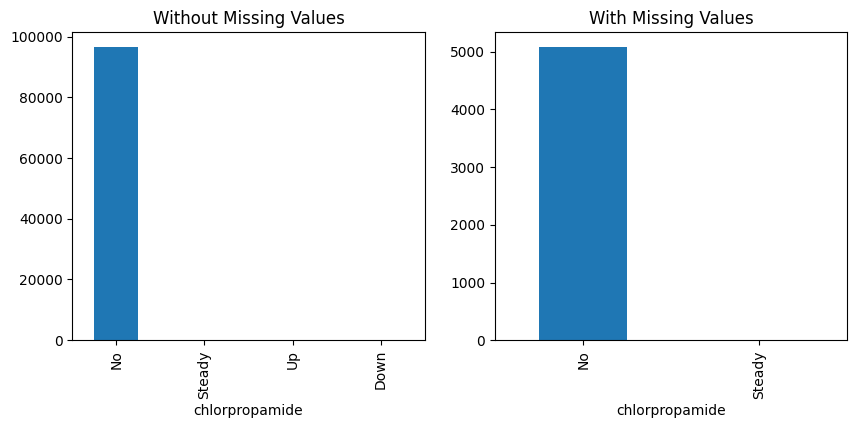

p-value of Chi-squared test: 0.9465512324112891
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


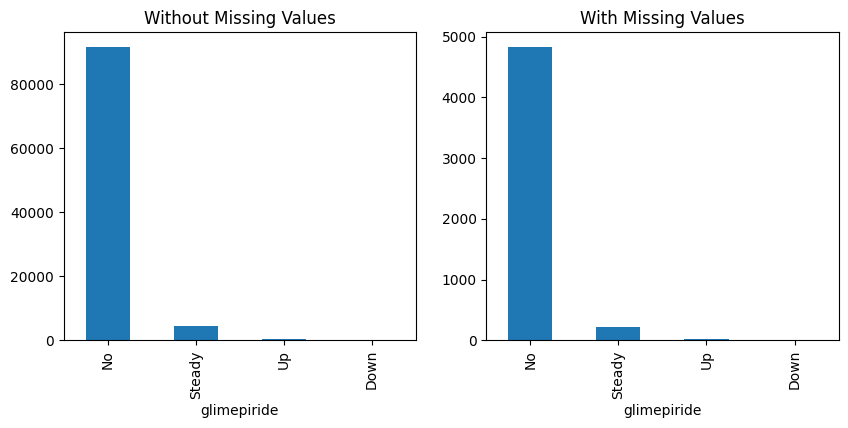

p-value of Chi-squared test: 0.23776525134460813
The missingness in 'glimepiride' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


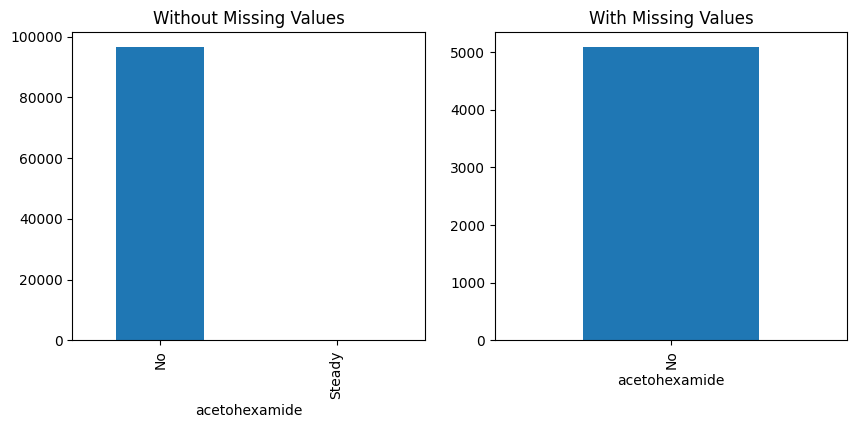

p-value of Chi-squared test: 1.0
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


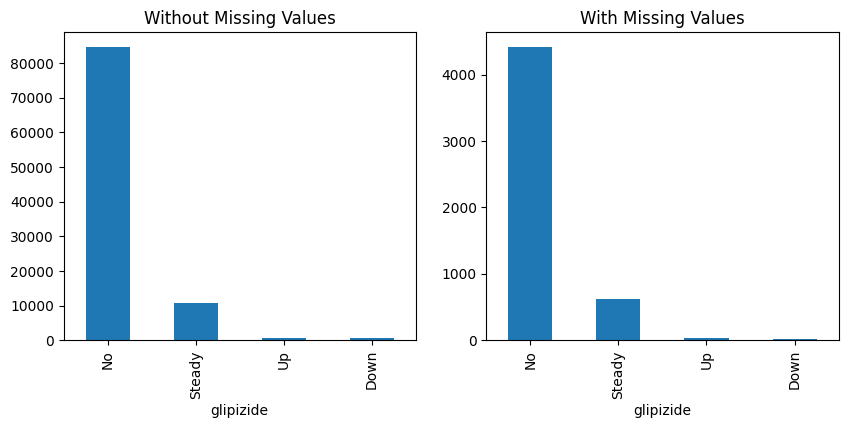

p-value of Chi-squared test: 0.09530596538291047
The missingness in 'glipizide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


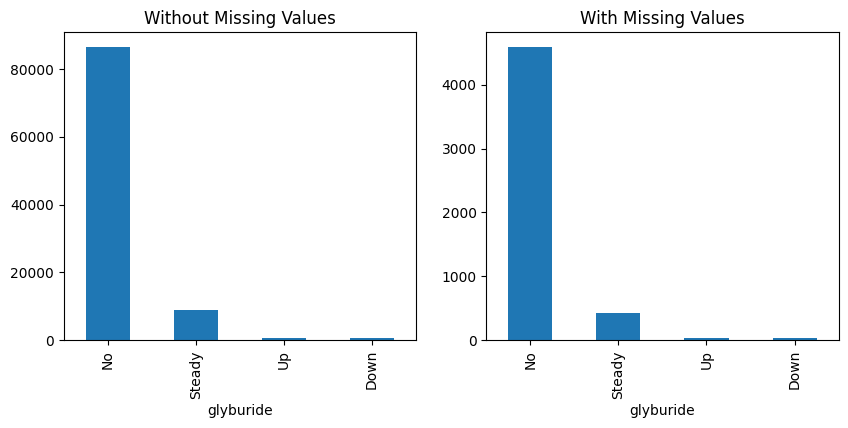

p-value of Chi-squared test: 0.43543731515767126
The missingness in 'glyburide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


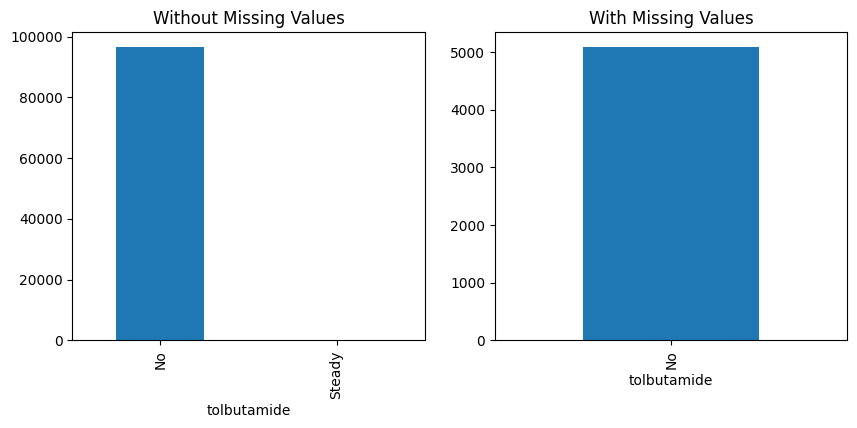

p-value of Chi-squared test: 0.5340095228973467
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


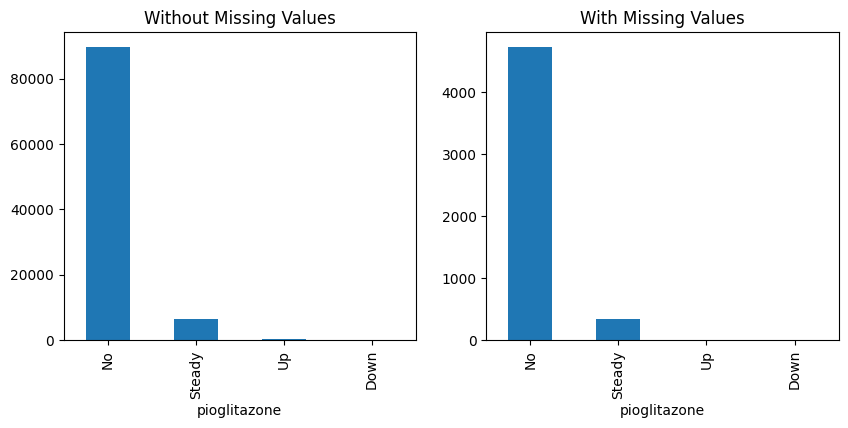

p-value of Chi-squared test: 0.8457110896342045
The missingness in 'pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


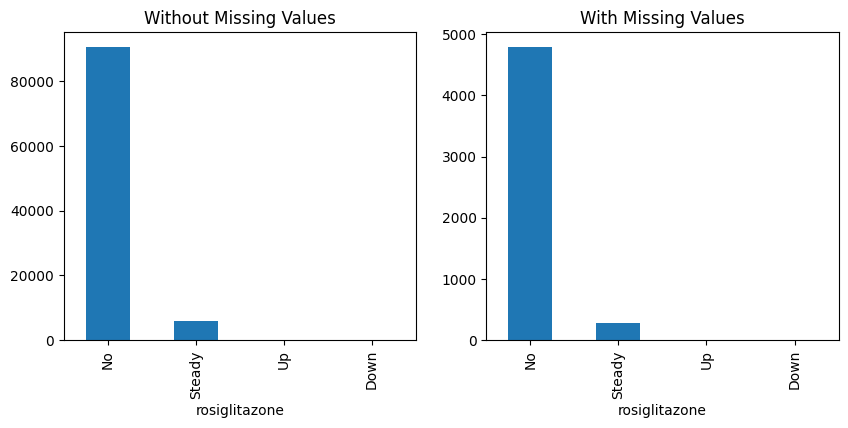

p-value of Chi-squared test: 0.47147669425103156
The missingness in 'rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


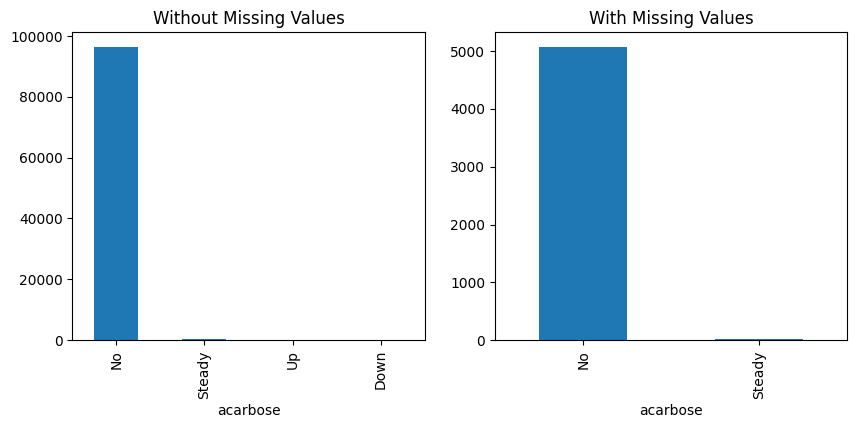

p-value of Chi-squared test: 0.7900545391384801
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


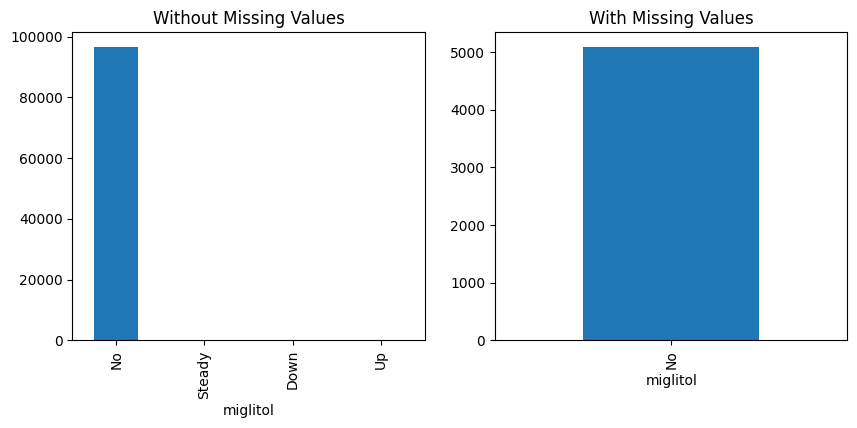

p-value of Chi-squared test: 0.5722774250462166
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


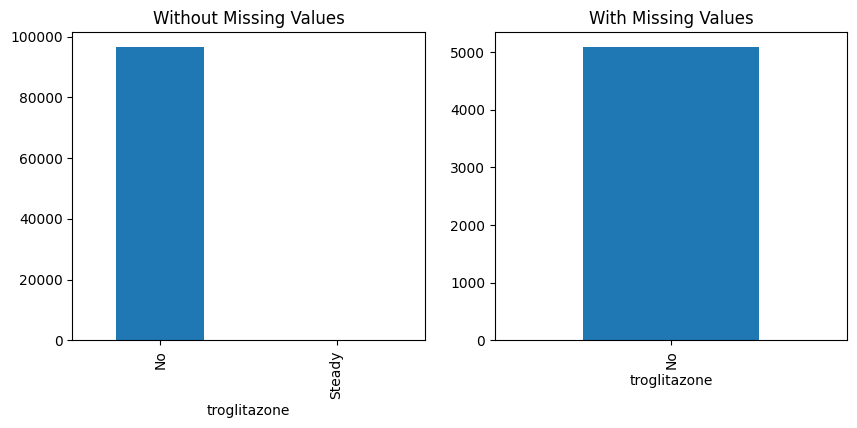

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


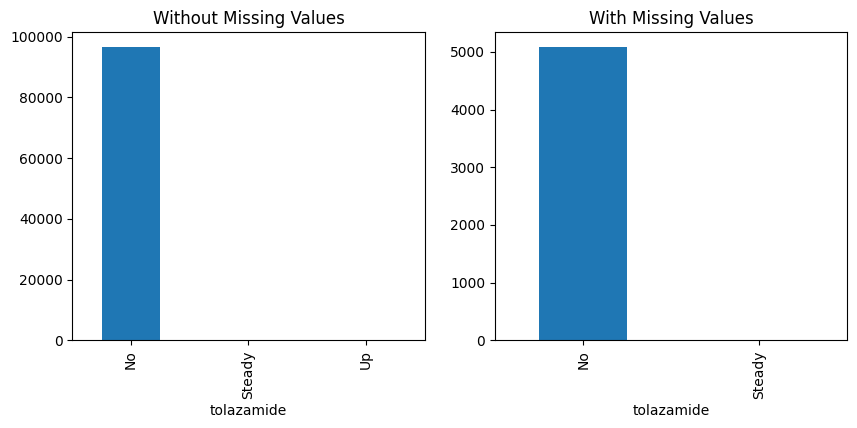

p-value of Chi-squared test: 0.9713282016764782
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


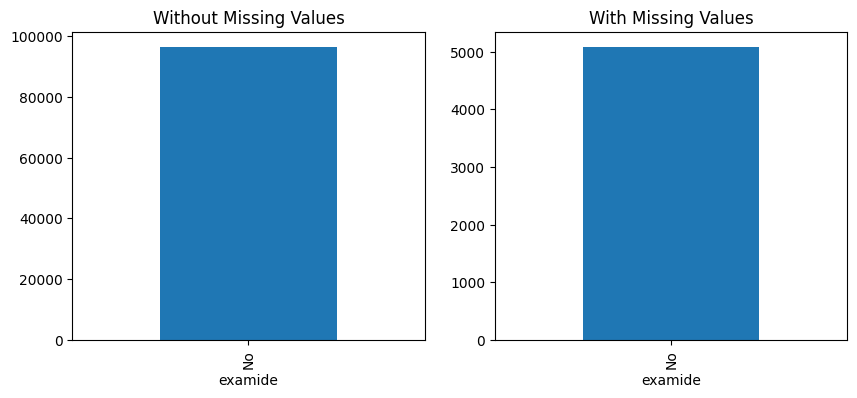

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


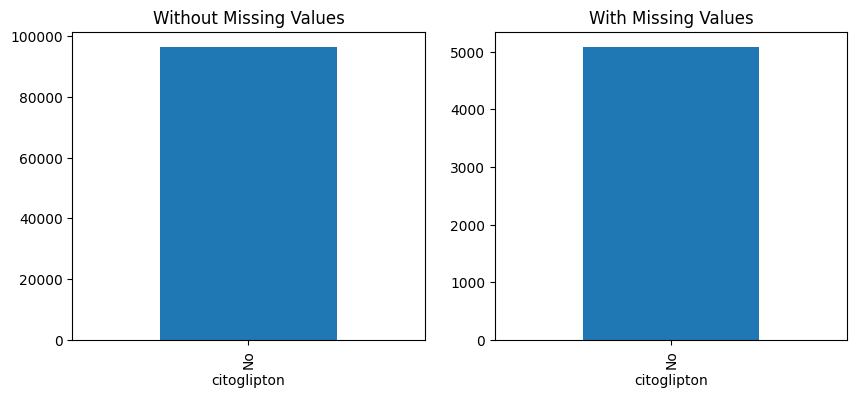

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:
No data for group: With Missing Values


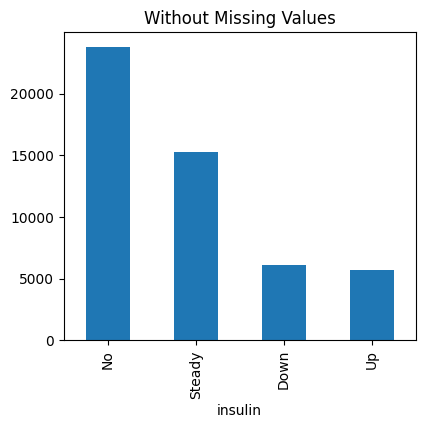

p-value of Chi-squared test: 1.0
The missingness in 'insulin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


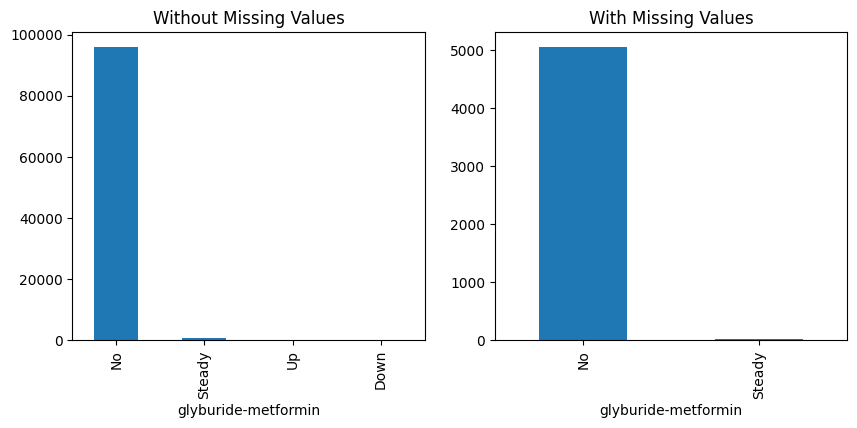

p-value of Chi-squared test: 0.6372719429870362
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


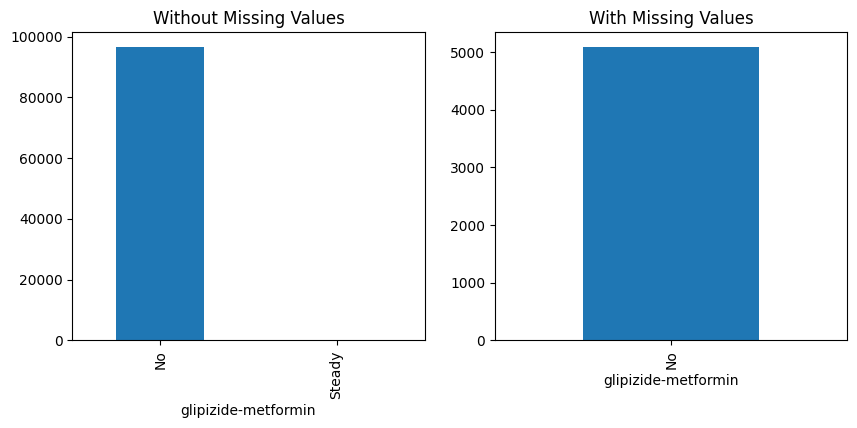

p-value of Chi-squared test: 0.8486398389071088
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


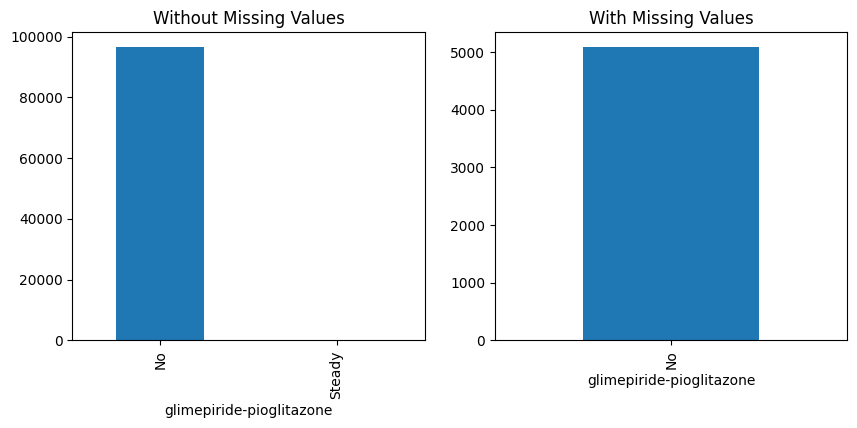

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


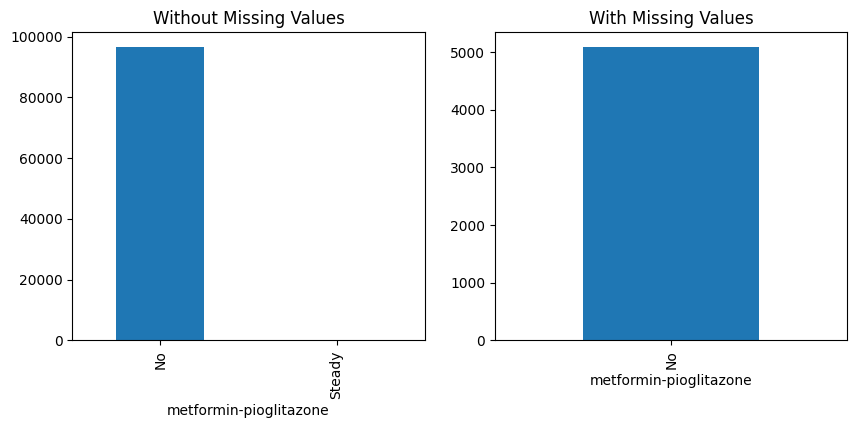

p-value of Chi-squared test: 1.0
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


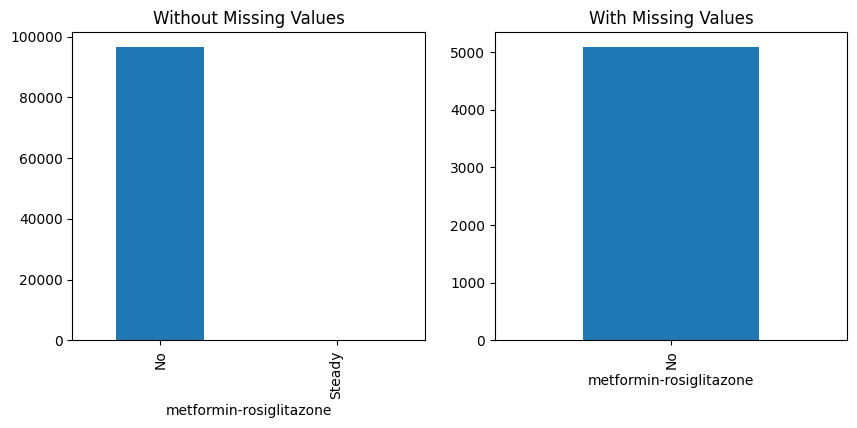

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


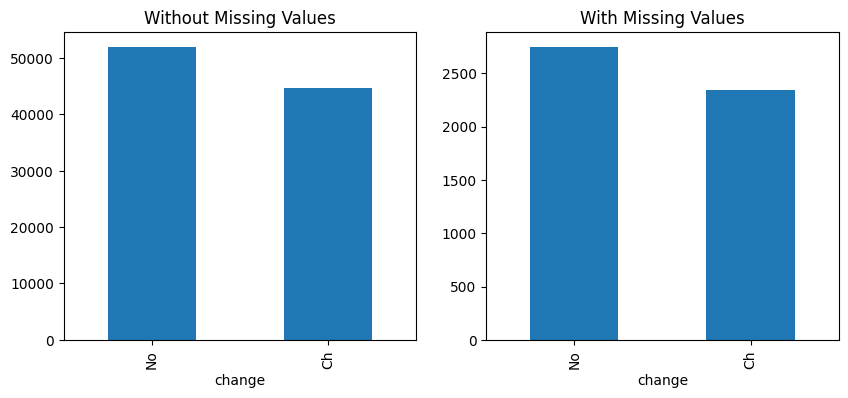

p-value of Chi-squared test: 0.7311083112495051
The missingness in 'change' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


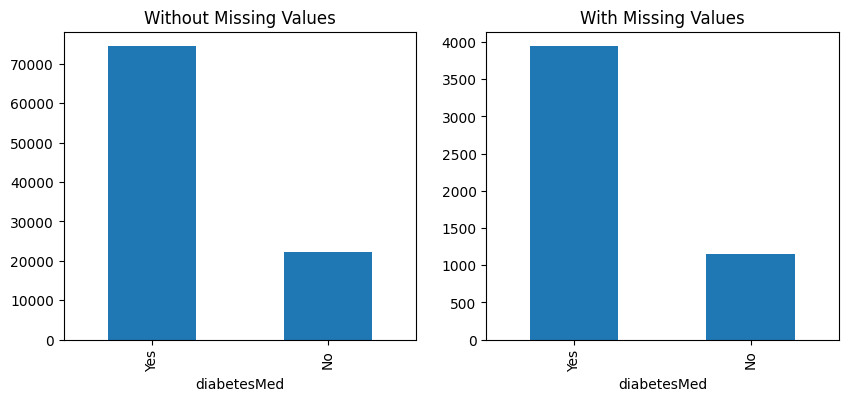

p-value of Chi-squared test: 0.4402181954189268
The missingness in 'diabetesMed' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


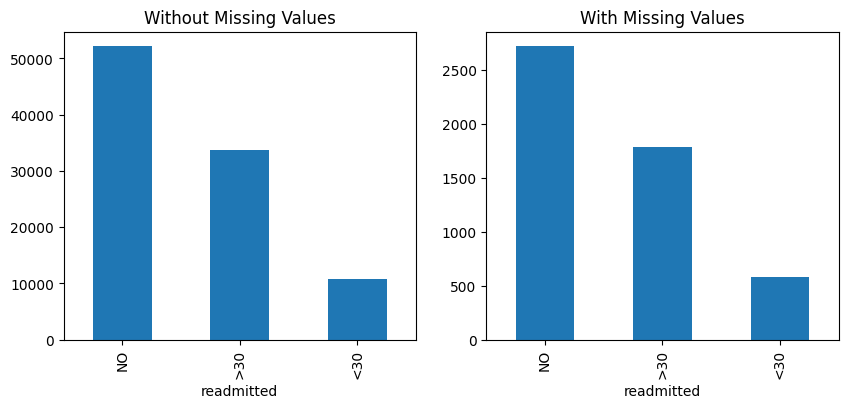

p-value of Chi-squared test: 0.7062542484705228
The missingness in 'readmitted' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.age.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### **After** going through the analysis we can say `gender` is of `MCAR`

## Detecting Missing type for num_lab_procedures

Diagnosis Analysis of Missing Values for time_in_hospital:


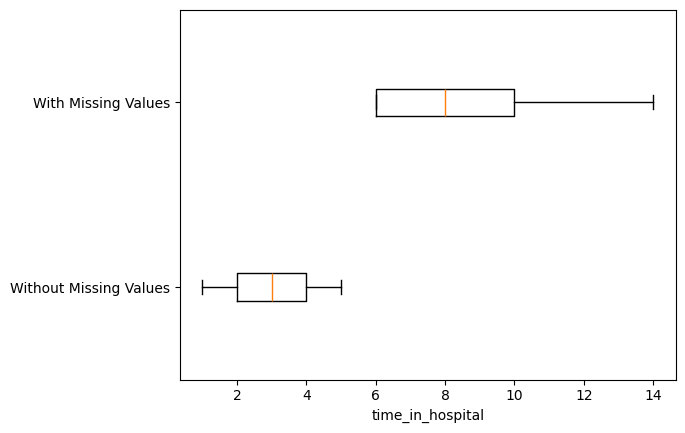

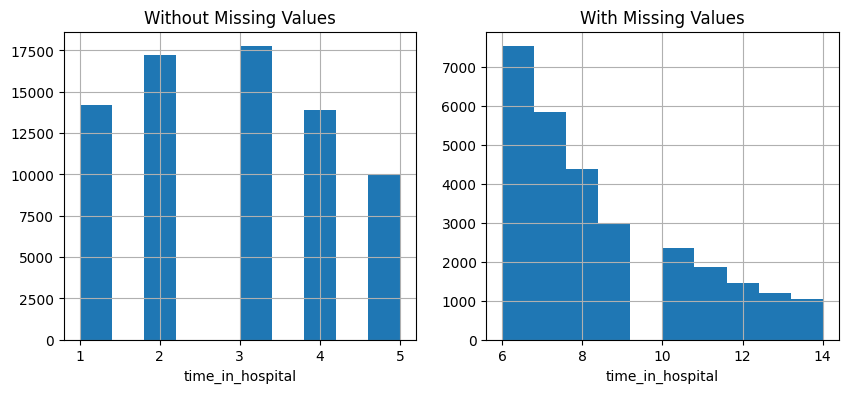

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


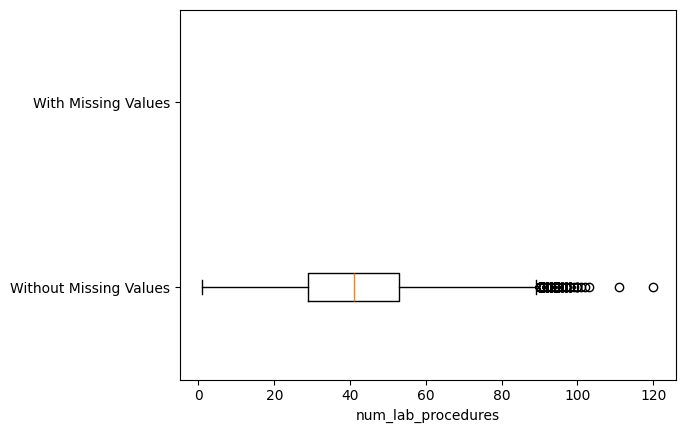

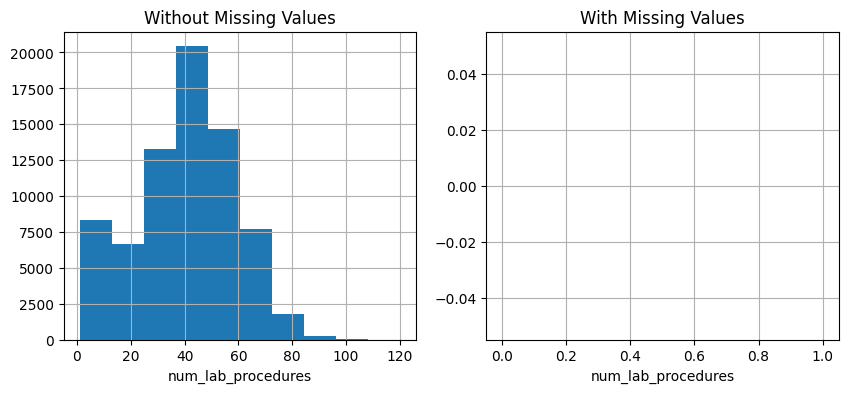

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


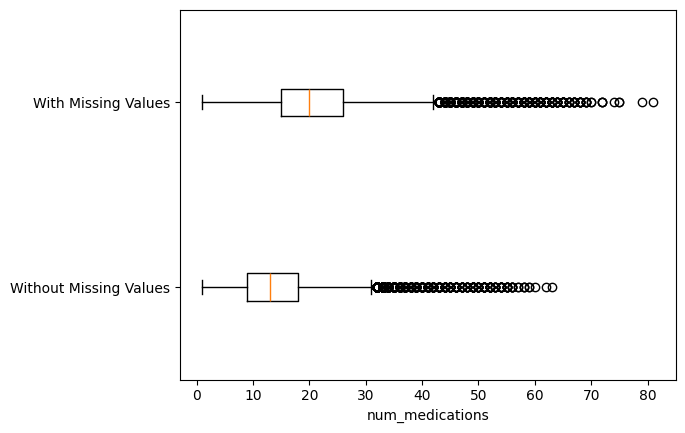

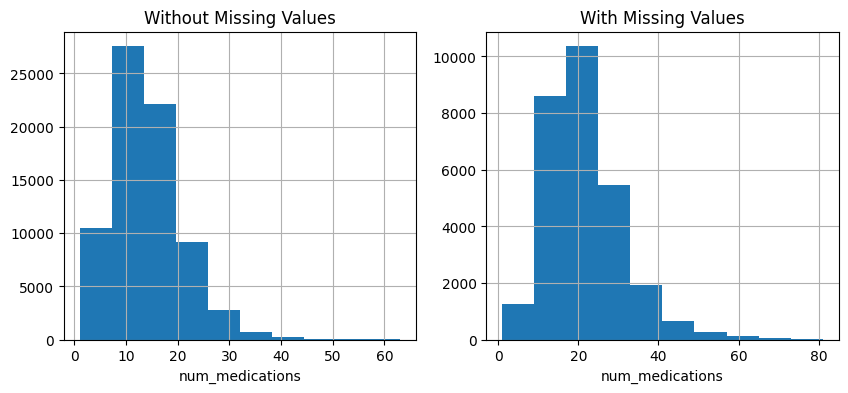

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


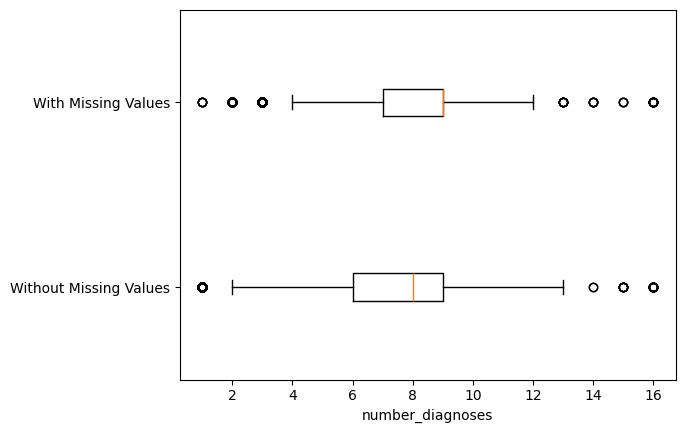

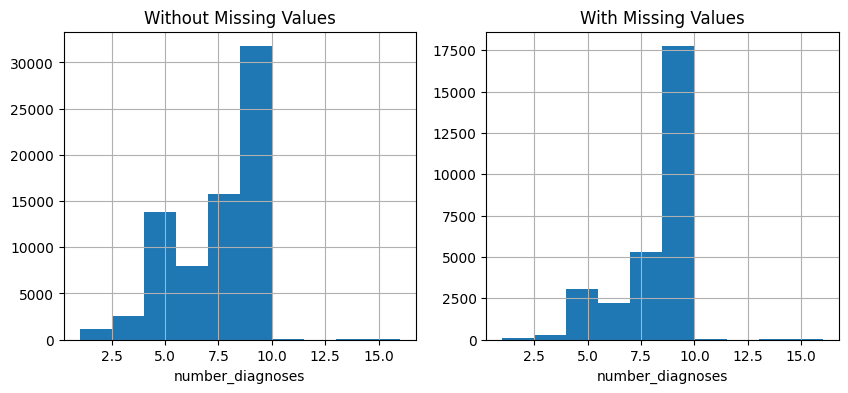

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


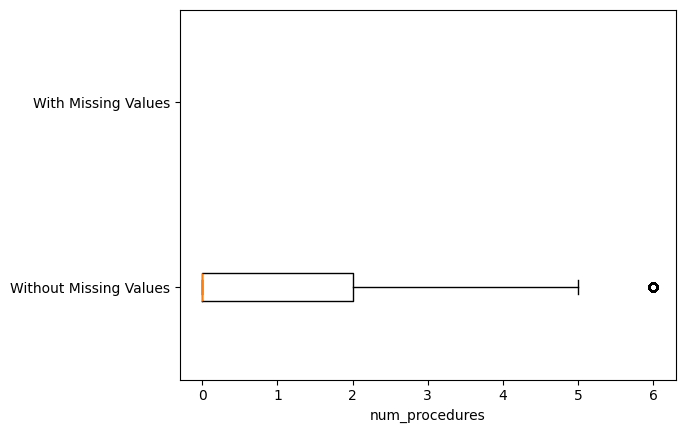

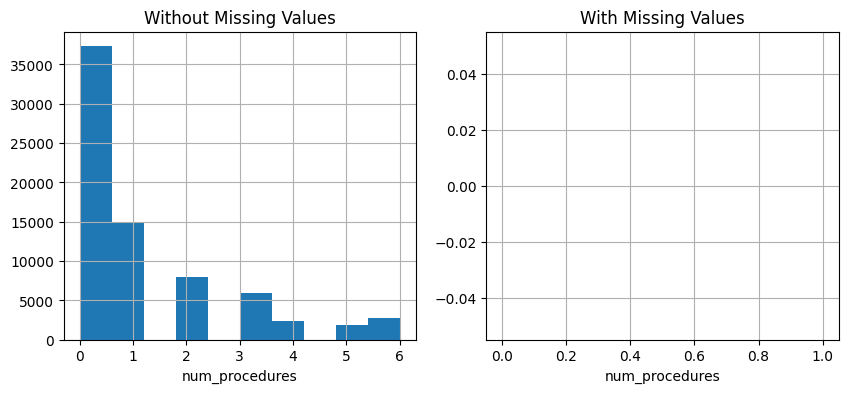

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


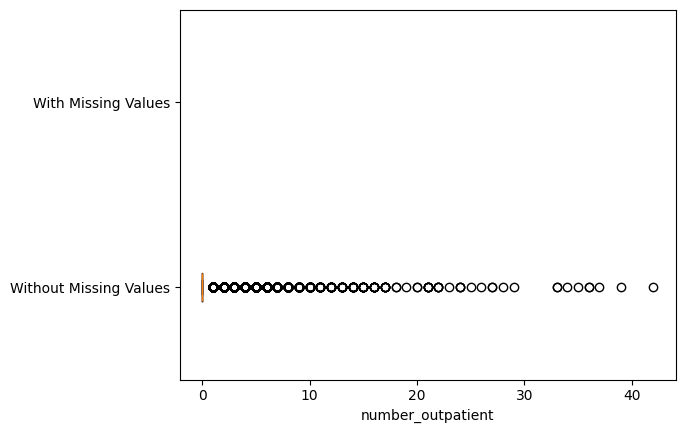

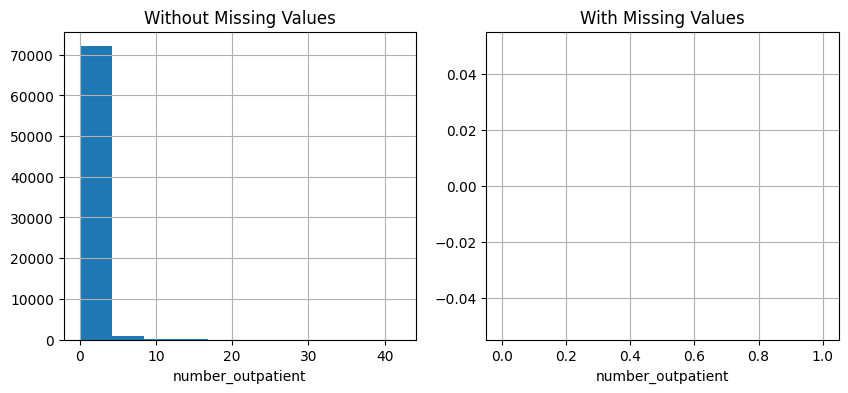

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


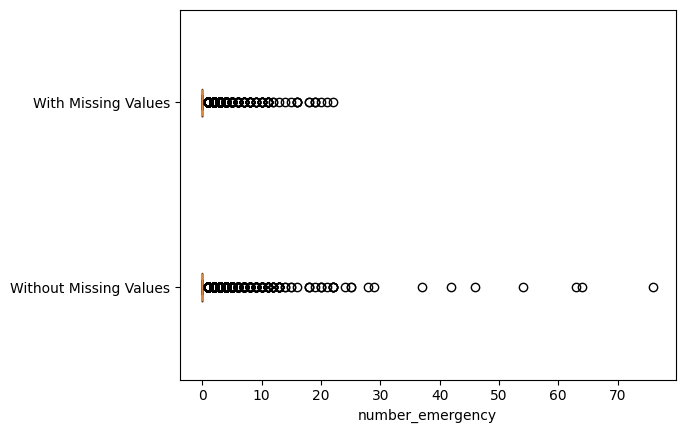

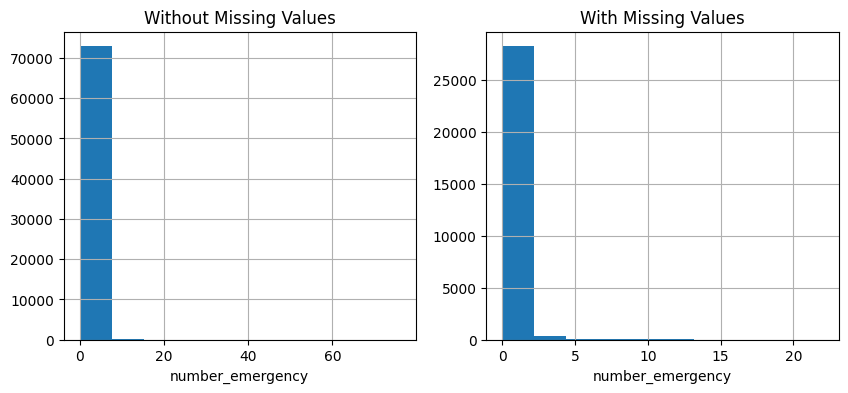

p-value of t-test: 0.026396136088154807
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


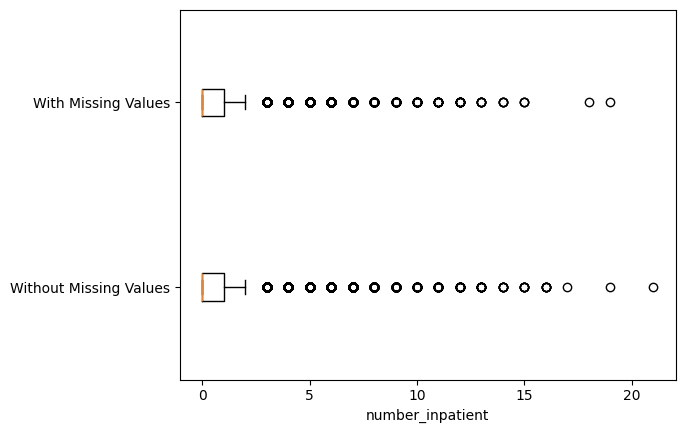

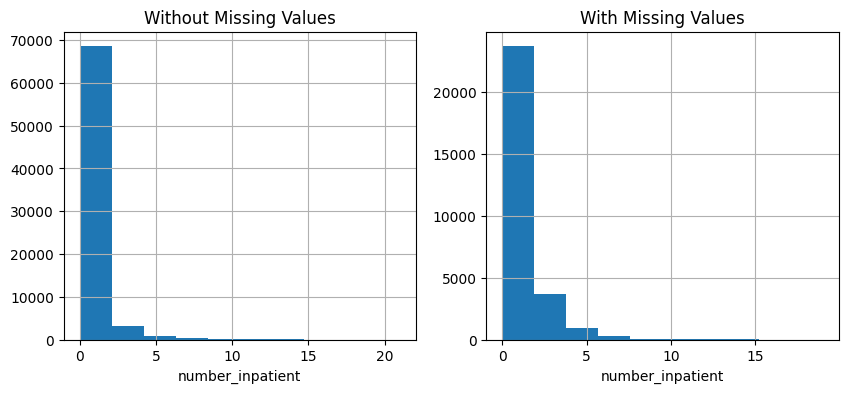

p-value of t-test: 3.94486455109948e-86
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.num_lab_procedures.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:


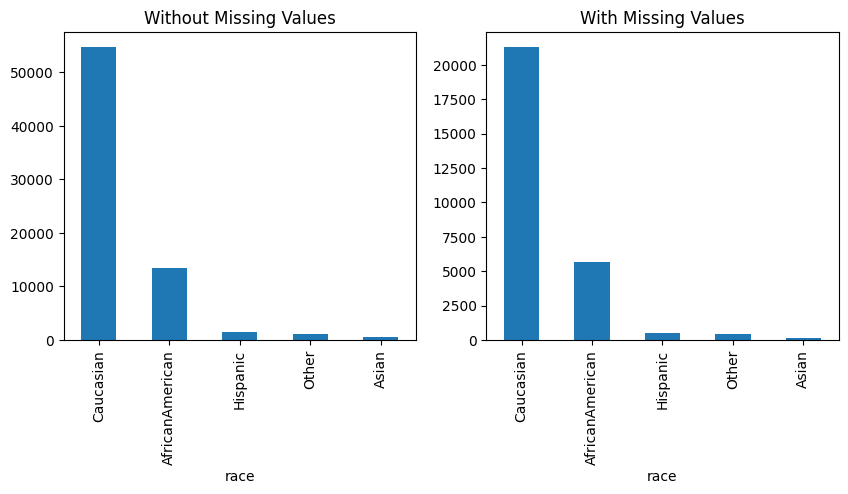

p-value of Chi-squared test: 1.347356777820178e-09
The missingness in 'race' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


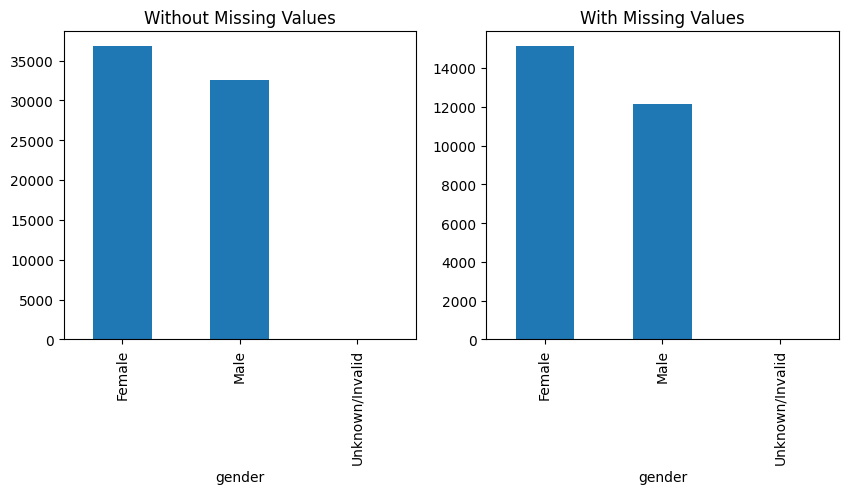

p-value of Chi-squared test: 2.694590452829927e-11
The missingness in 'gender' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


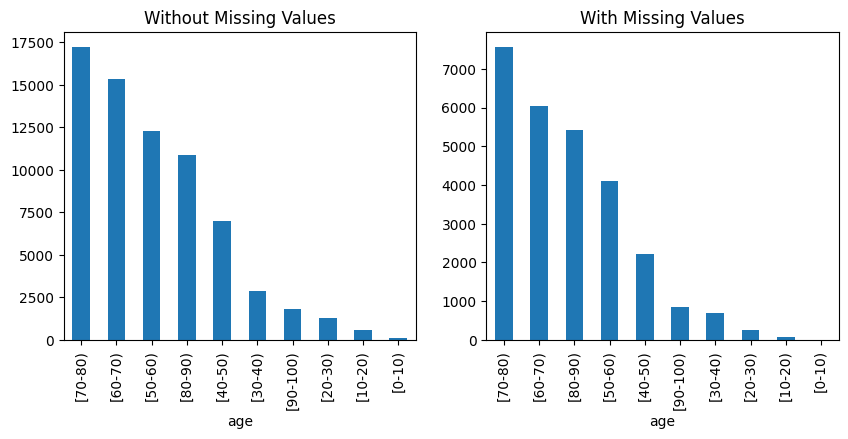

p-value of Chi-squared test: 7.447681731818582e-167
The missingness in 'age' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


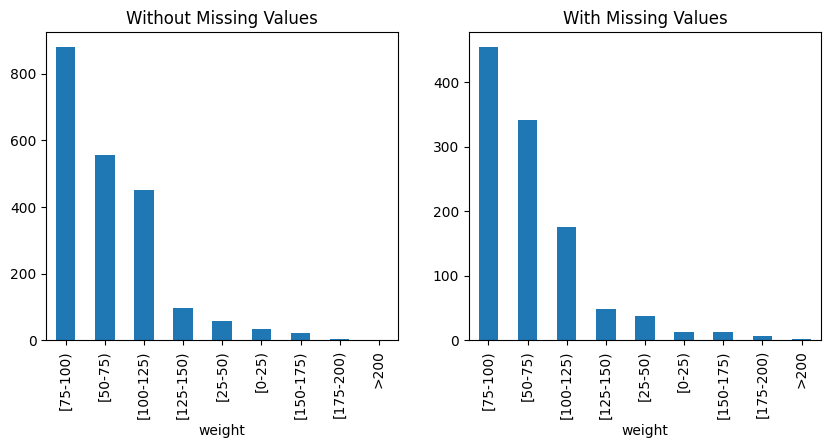

p-value of Chi-squared test: 0.004745880705158979
The missingness in 'weight' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


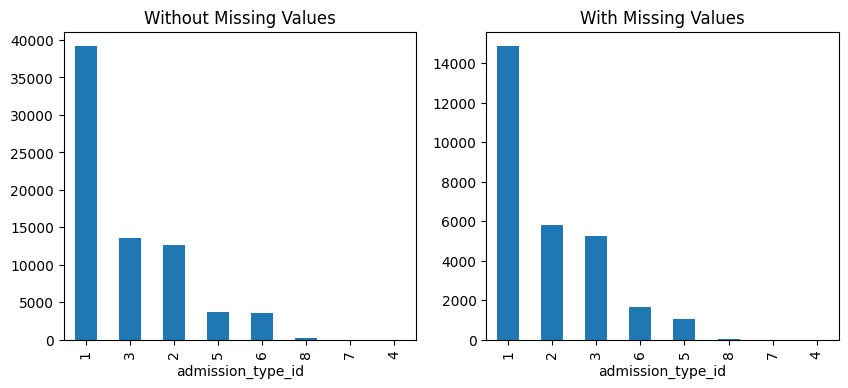

p-value of Chi-squared test: 1.112365208697738e-52
The missingness in 'admission_type_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


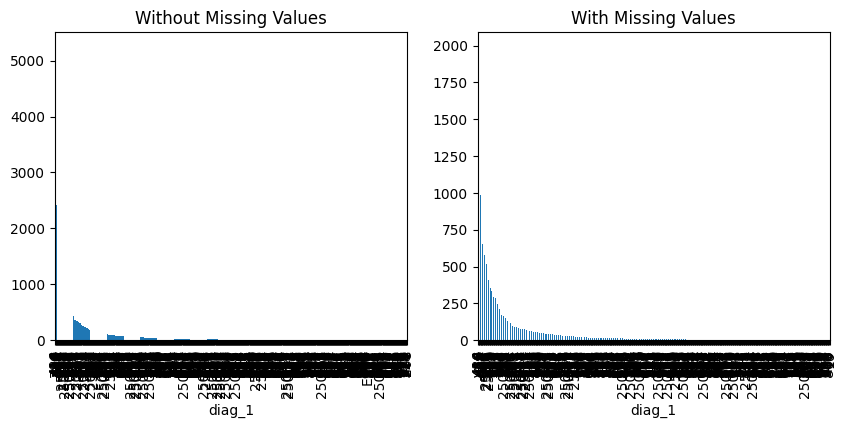

p-value of Chi-squared test: 0.0
The missingness in 'diag_1' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


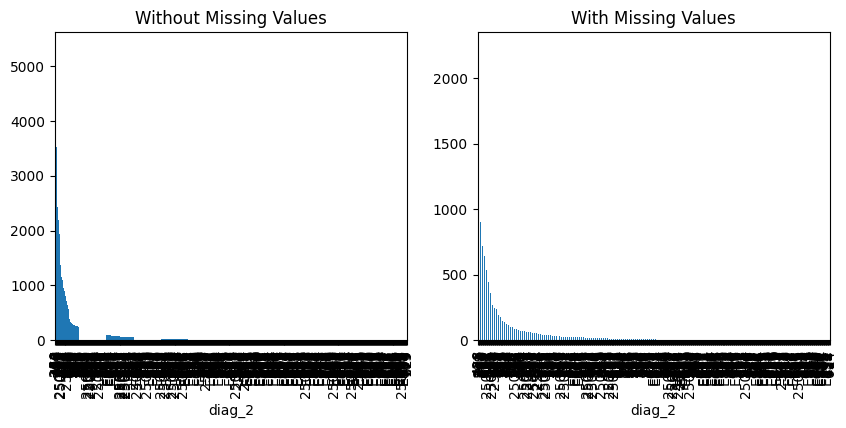

p-value of Chi-squared test: 0.0
The missingness in 'diag_2' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


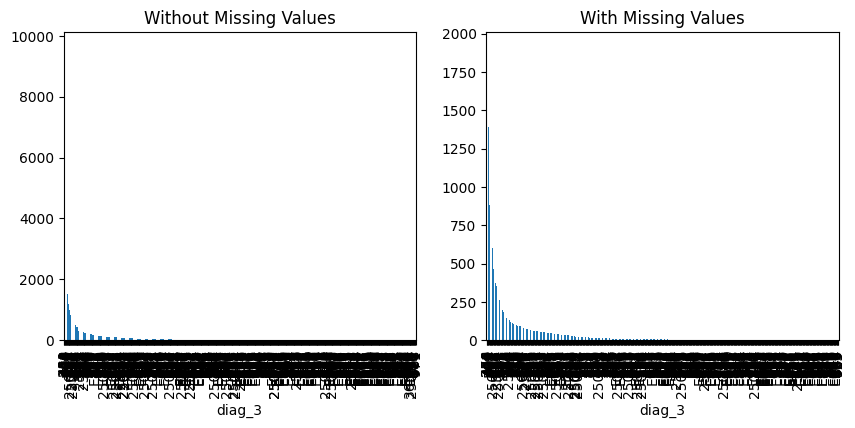

p-value of Chi-squared test: 0.0
The missingness in 'diag_3' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


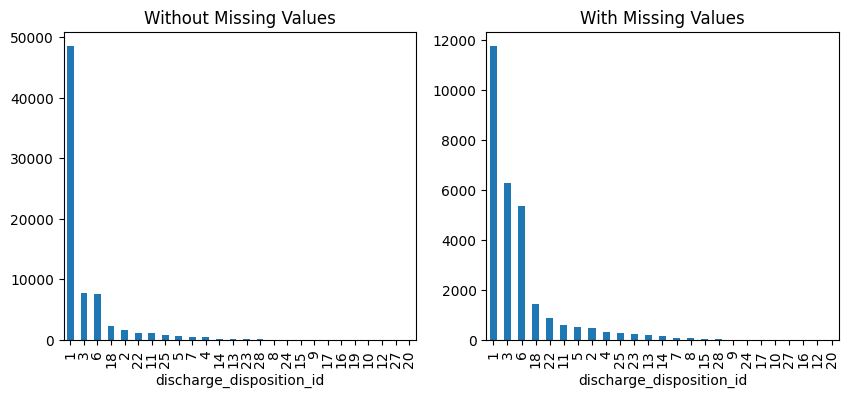

p-value of Chi-squared test: 0.0
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


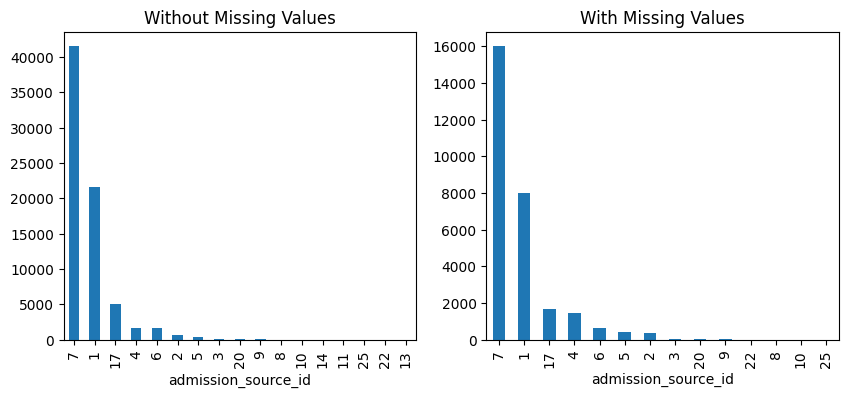

p-value of Chi-squared test: 4.6328354250575384e-160
The missingness in 'admission_source_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


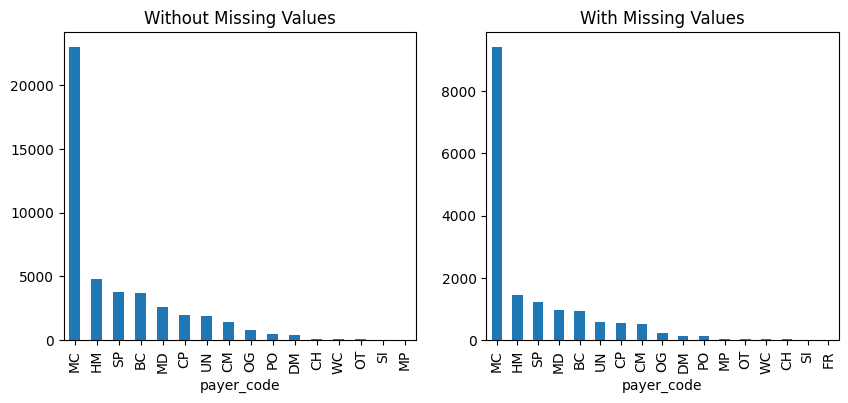

p-value of Chi-squared test: 3.137901603820795e-74
The missingness in 'payer_code' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


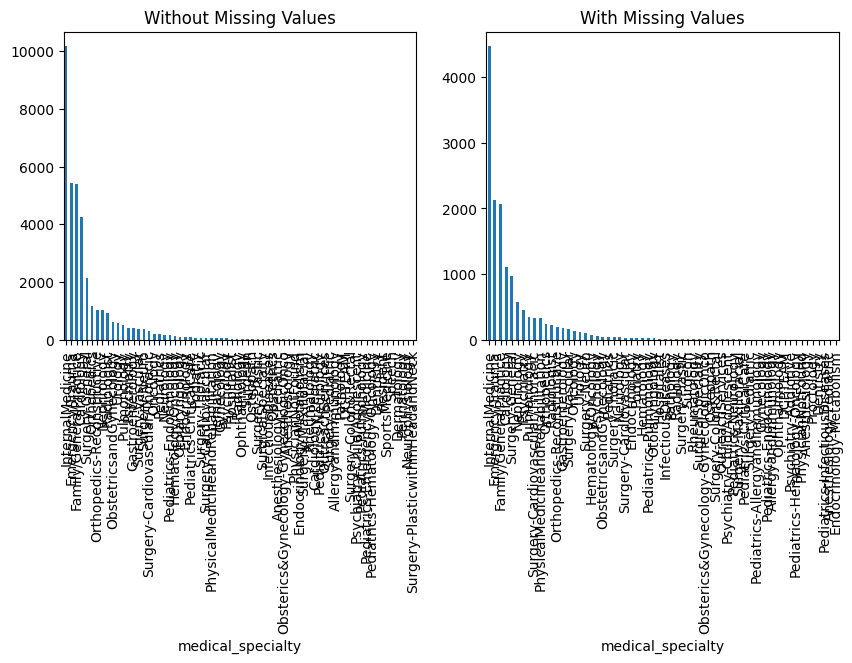

p-value of Chi-squared test: 0.0
The missingness in 'medical_specialty' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


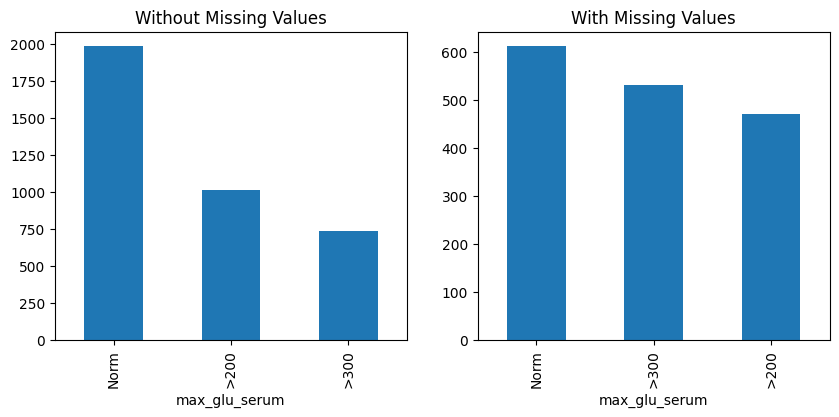

p-value of Chi-squared test: 3.815098758839264e-31
The missingness in 'max_glu_serum' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


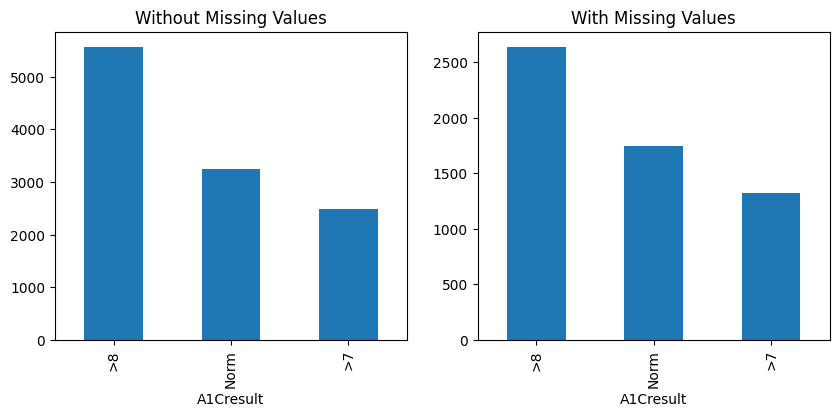

p-value of Chi-squared test: 0.001000733114747327
The missingness in 'A1Cresult' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


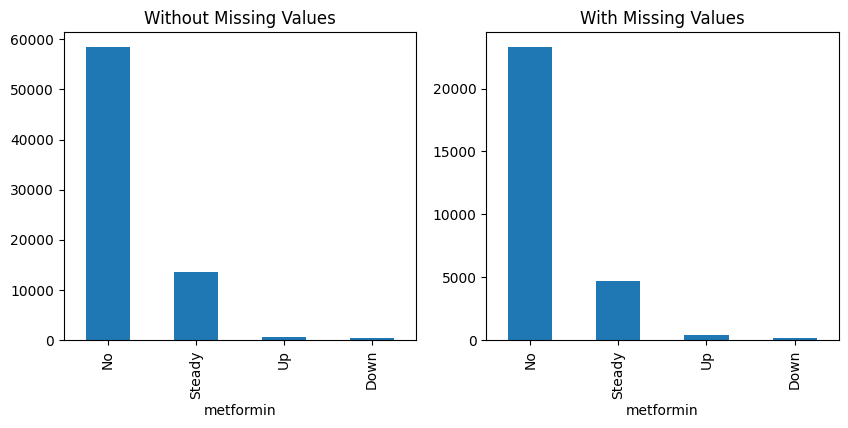

p-value of Chi-squared test: 3.243439275198125e-32
The missingness in 'metformin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


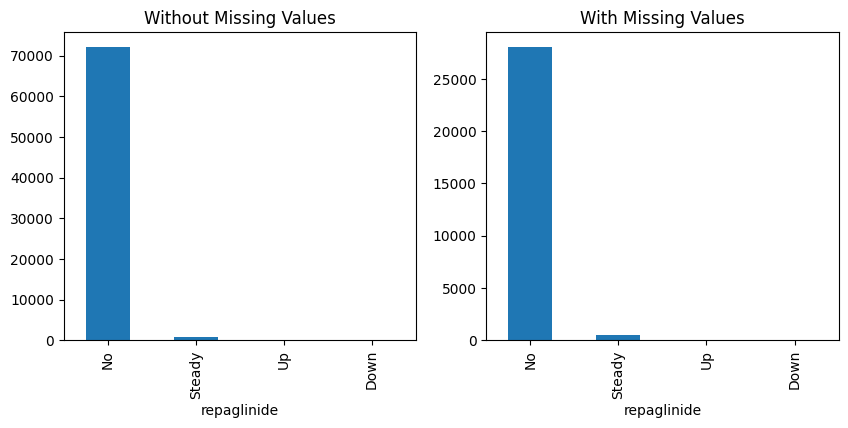

p-value of Chi-squared test: 1.651323670819997e-29
The missingness in 'repaglinide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


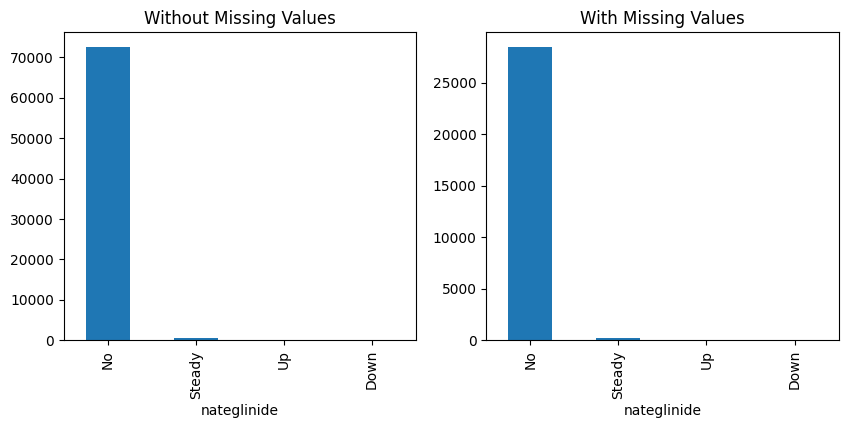

p-value of Chi-squared test: 0.028157193795197332
The missingness in 'nateglinide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


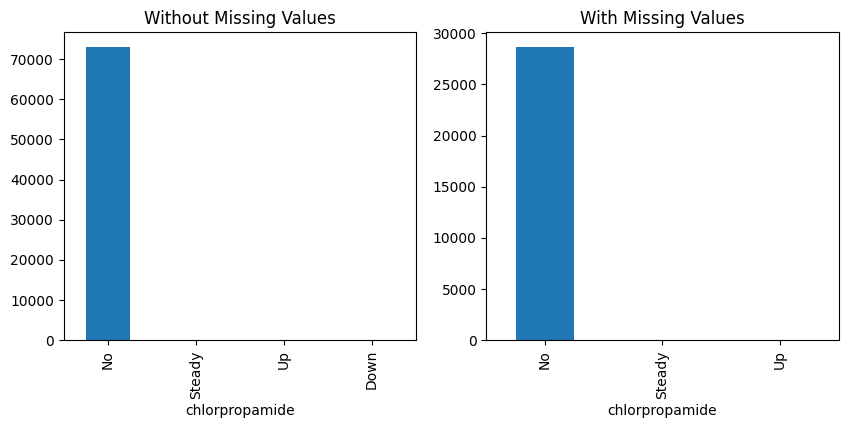

p-value of Chi-squared test: 0.7192961195043427
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


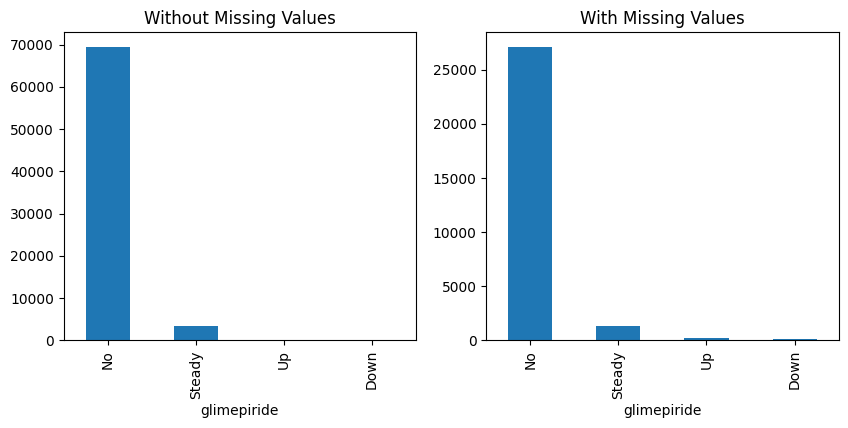

p-value of Chi-squared test: 2.3700169115332424e-29
The missingness in 'glimepiride' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


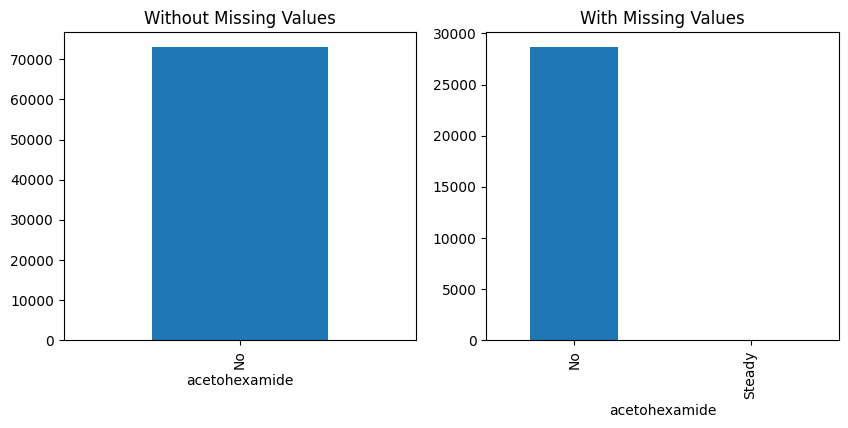

p-value of Chi-squared test: 0.6278568594144229
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


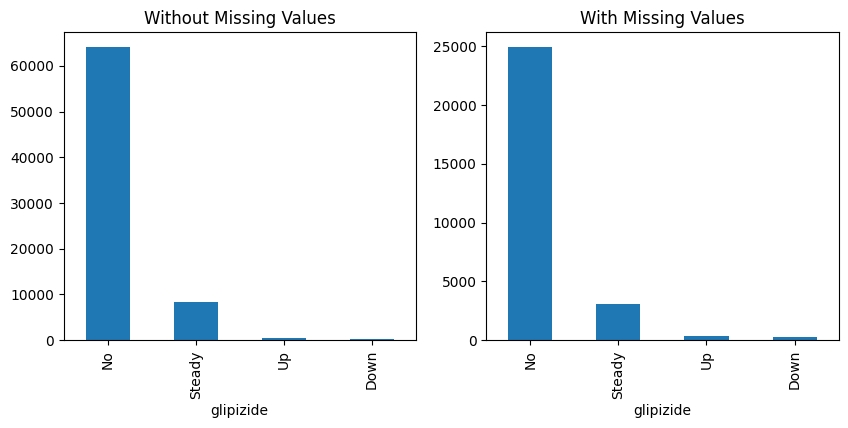

p-value of Chi-squared test: 1.0925807043701735e-57
The missingness in 'glipizide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


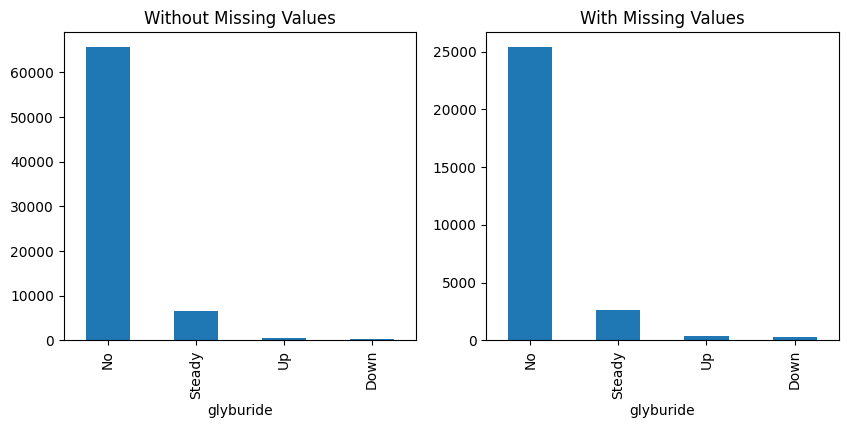

p-value of Chi-squared test: 1.0222288875746806e-49
The missingness in 'glyburide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


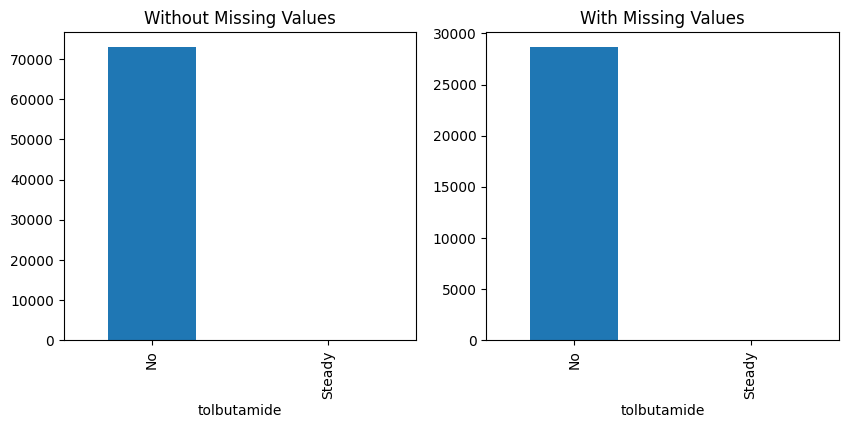

p-value of Chi-squared test: 0.350032458529108
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


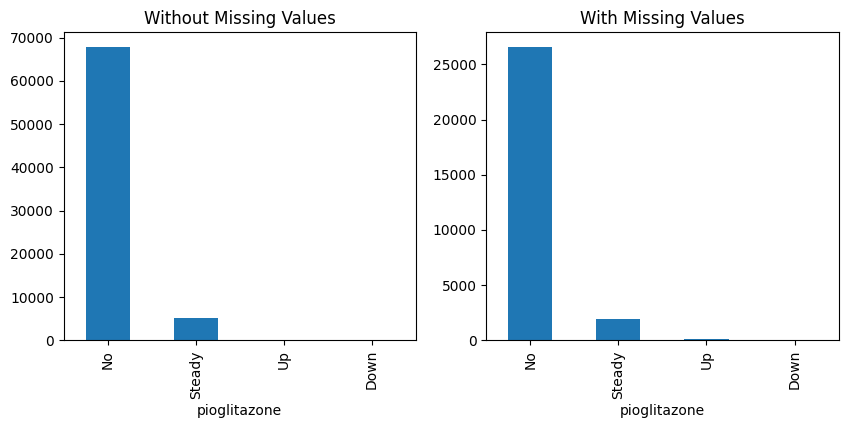

p-value of Chi-squared test: 5.983303582437579e-27
The missingness in 'pioglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


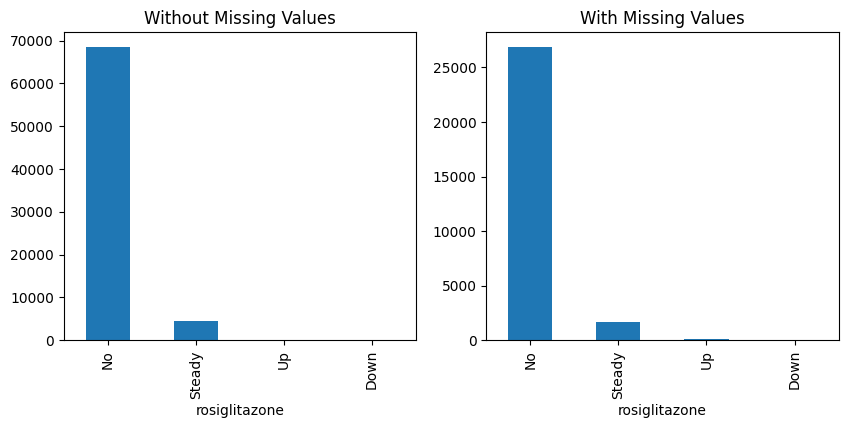

p-value of Chi-squared test: 1.450208159959678e-13
The missingness in 'rosiglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


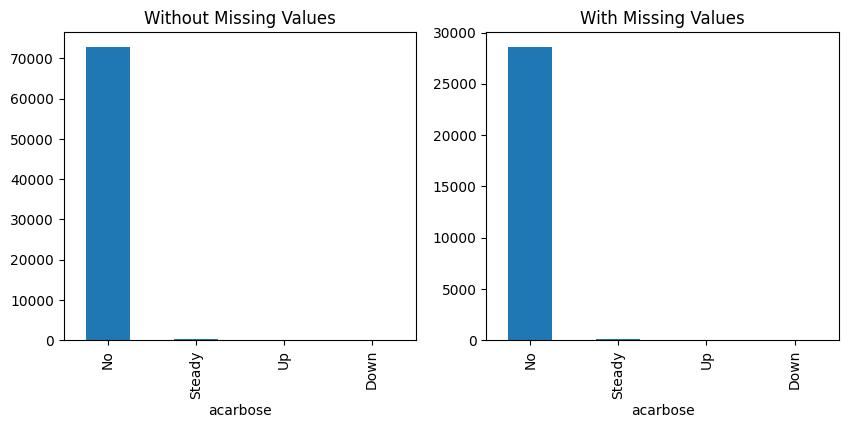

p-value of Chi-squared test: 0.157384302452171
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


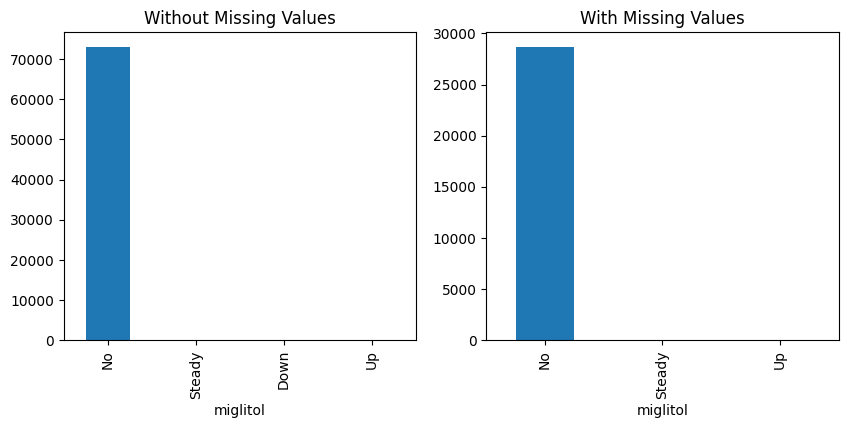

p-value of Chi-squared test: 0.4855572249166583
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


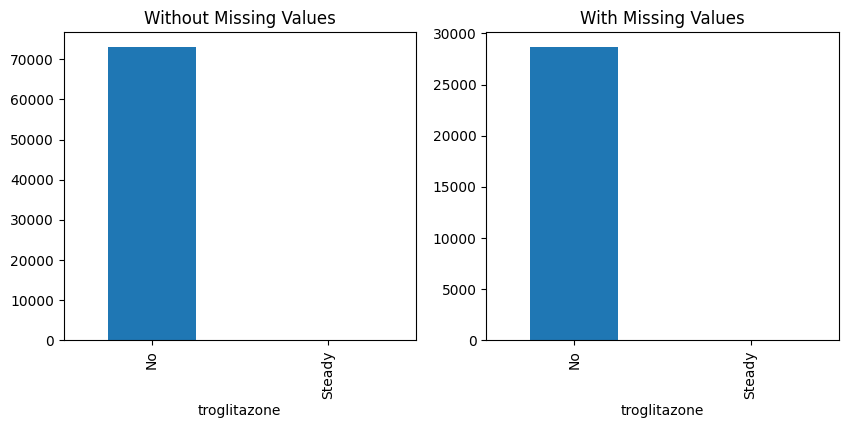

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


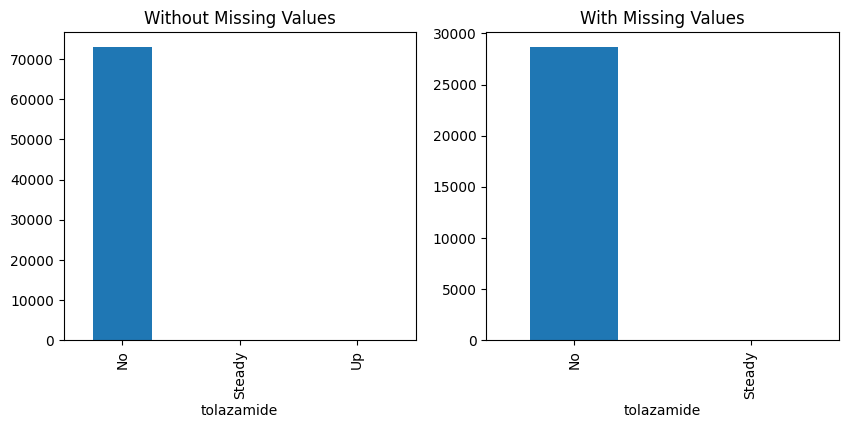

p-value of Chi-squared test: 0.8173687869044056
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


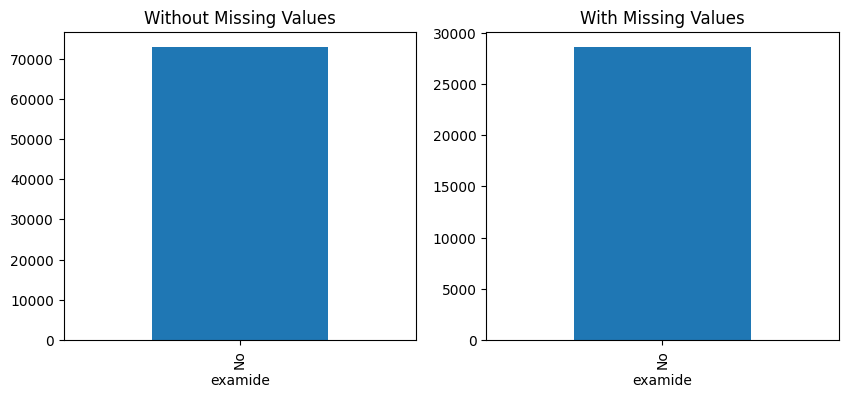

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


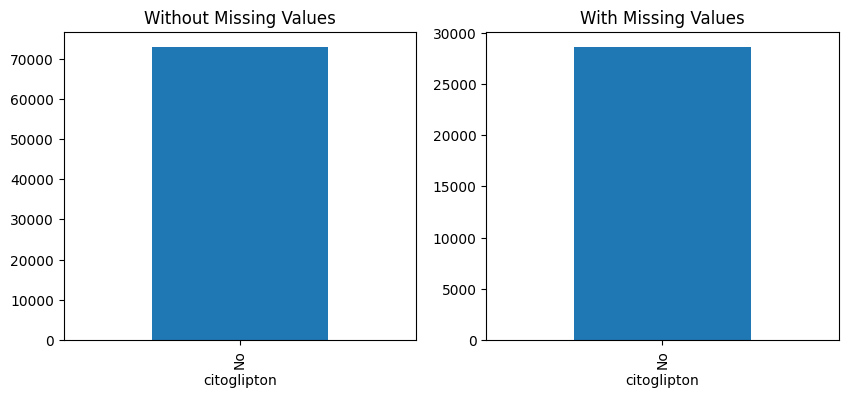

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:


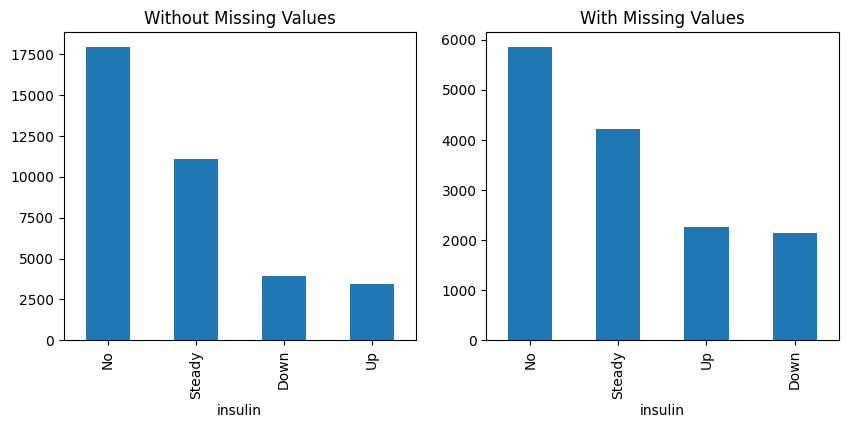

p-value of Chi-squared test: 1.9799957810181318e-144
The missingness in 'insulin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


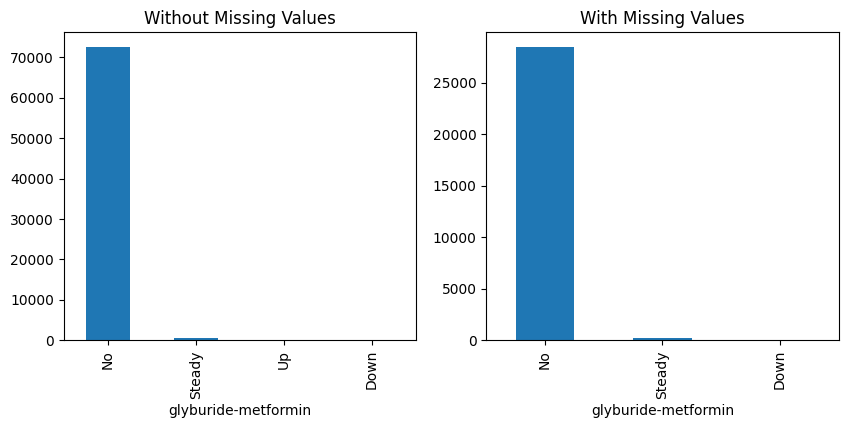

p-value of Chi-squared test: 0.18575072674402496
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


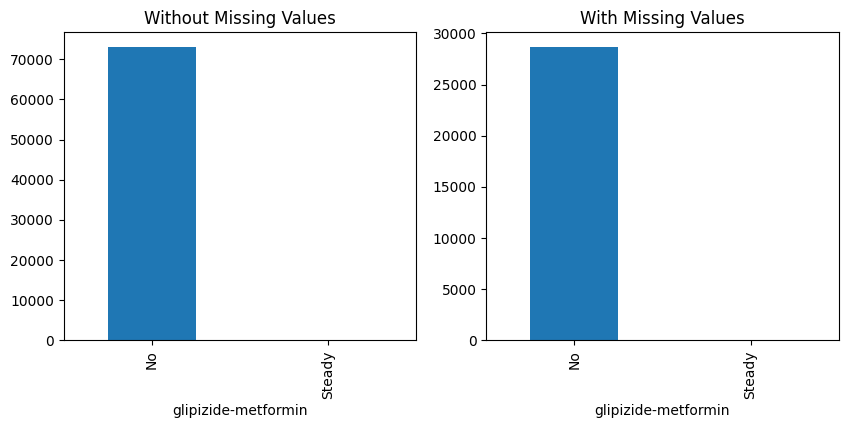

p-value of Chi-squared test: 0.6066030456765656
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


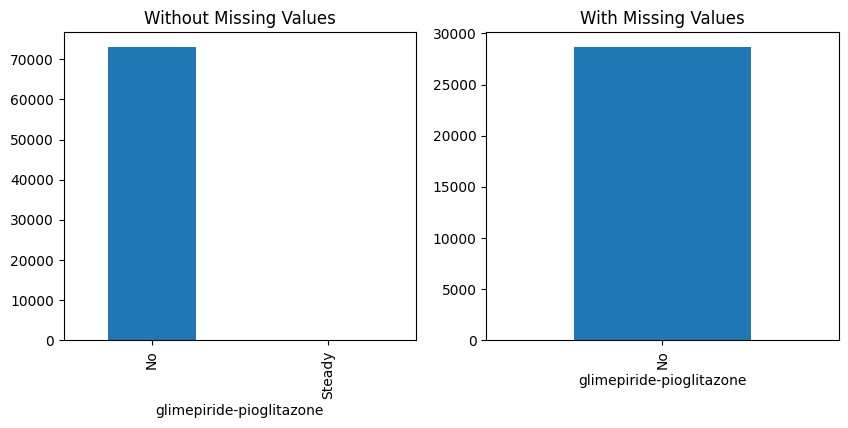

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


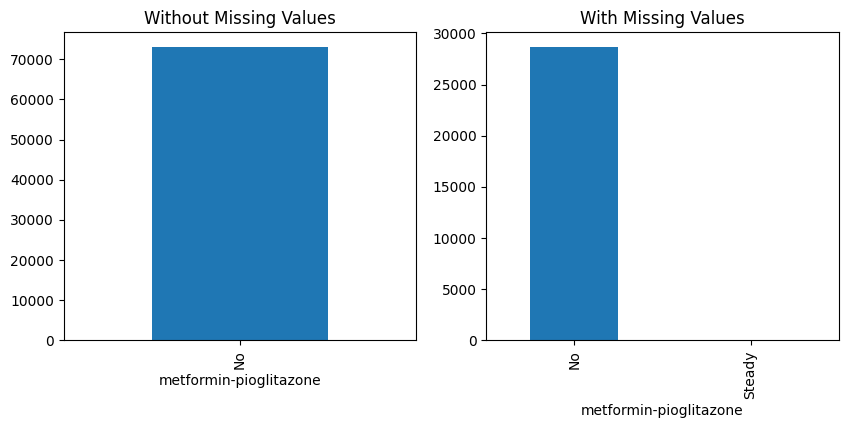

p-value of Chi-squared test: 0.6278568594144229
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


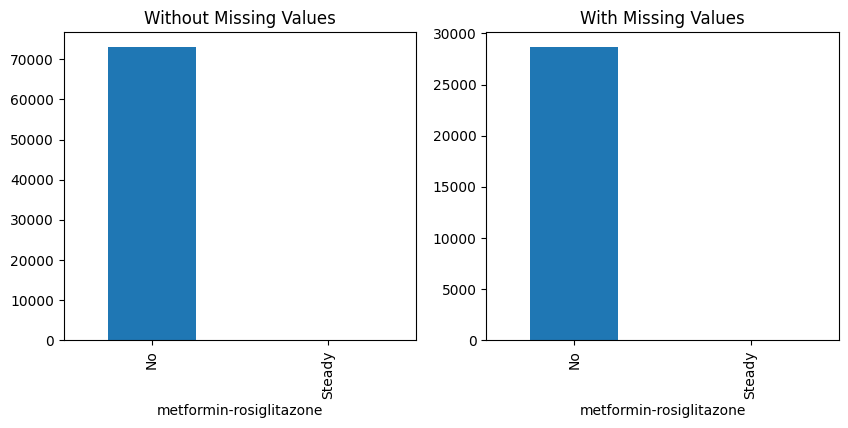

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


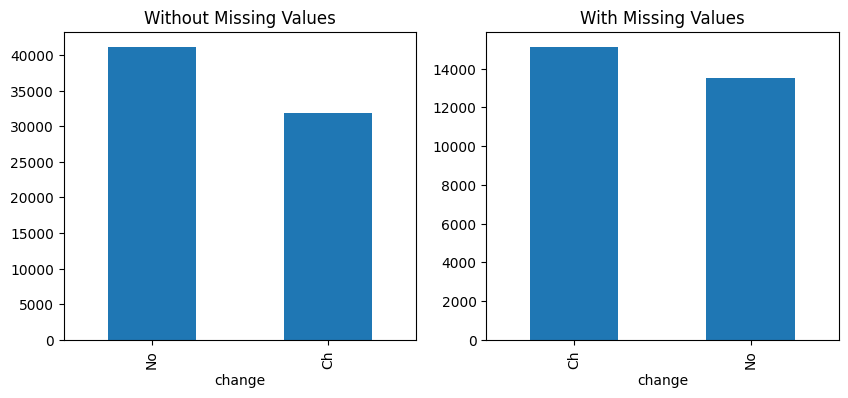

p-value of Chi-squared test: 6.730755246288683e-154
The missingness in 'change' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


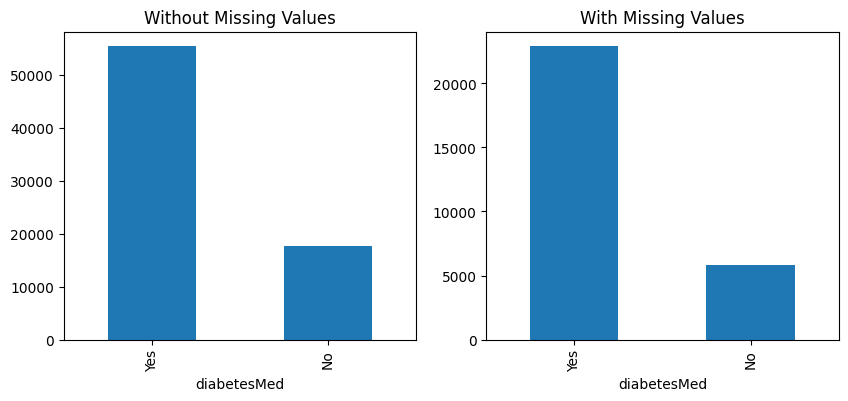

p-value of Chi-squared test: 4.9772668151369515e-40
The missingness in 'diabetesMed' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


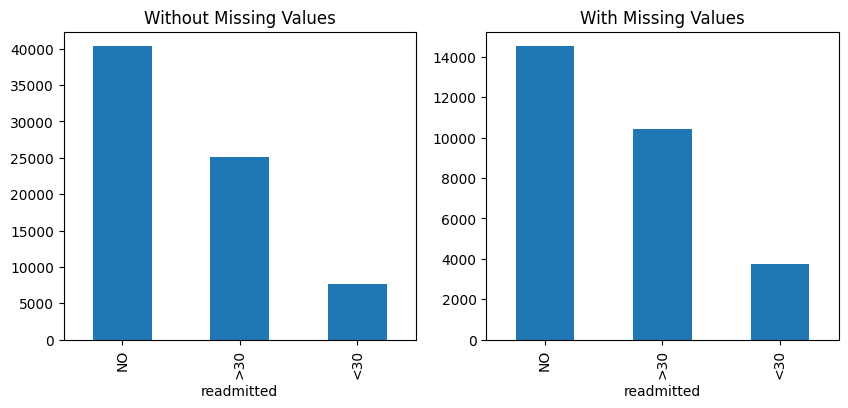

p-value of Chi-squared test: 5.577522994239756e-51
The missingness in 'readmitted' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.num_lab_procedures.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### After going through this we can say the missing value for `num_lab_procedures` is MAR type because if the time in hospital is greater than 5 we see more missing values

## Detecting Missing type for num_procedures

Diagnosis Analysis of Missing Values for time_in_hospital:


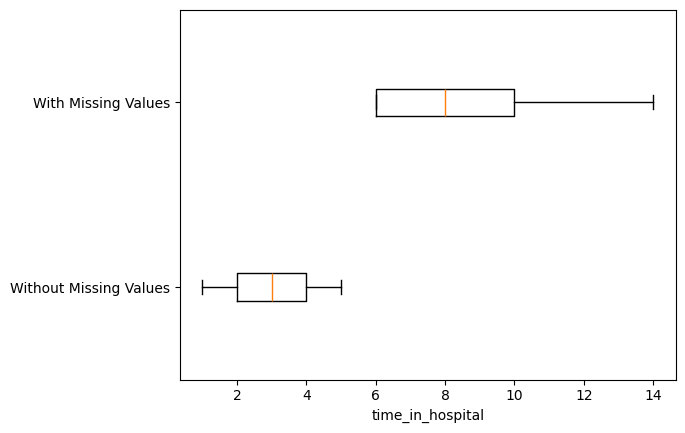

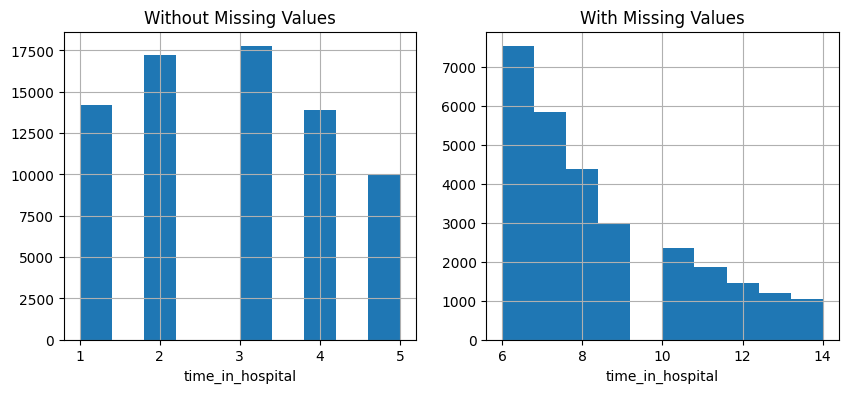

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


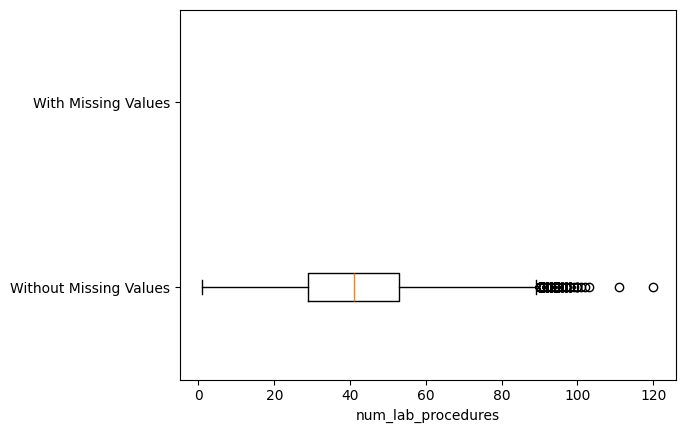

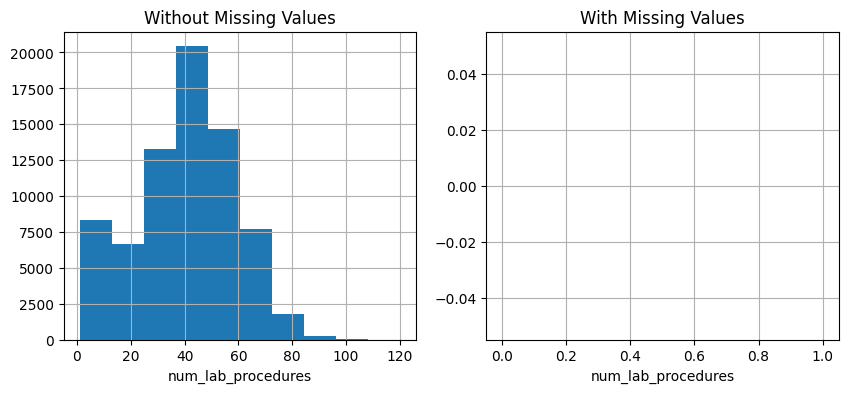

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


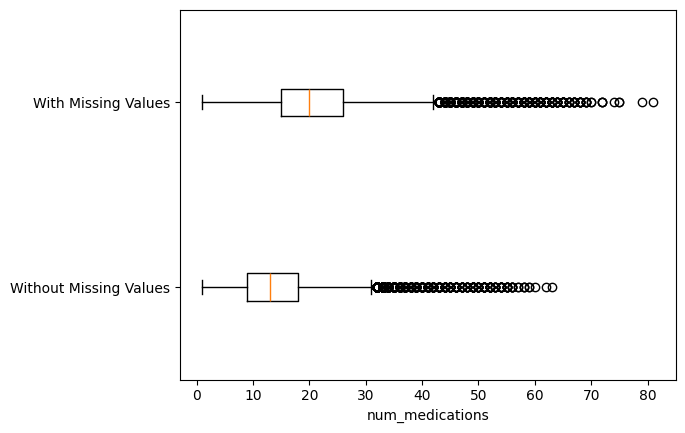

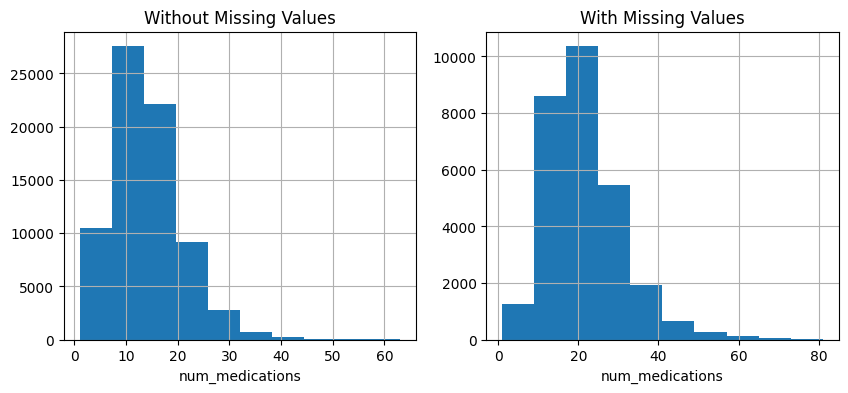

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


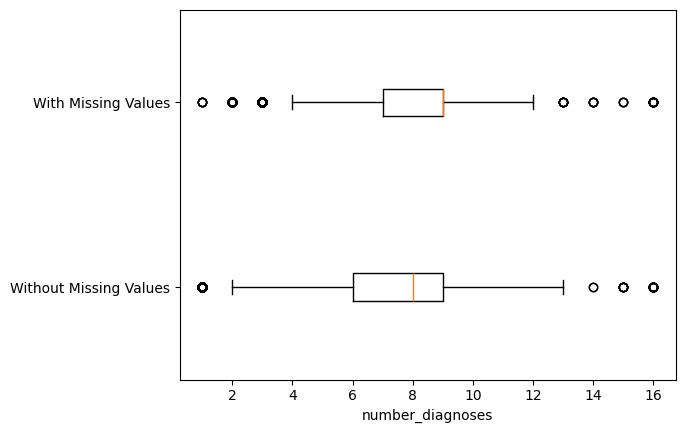

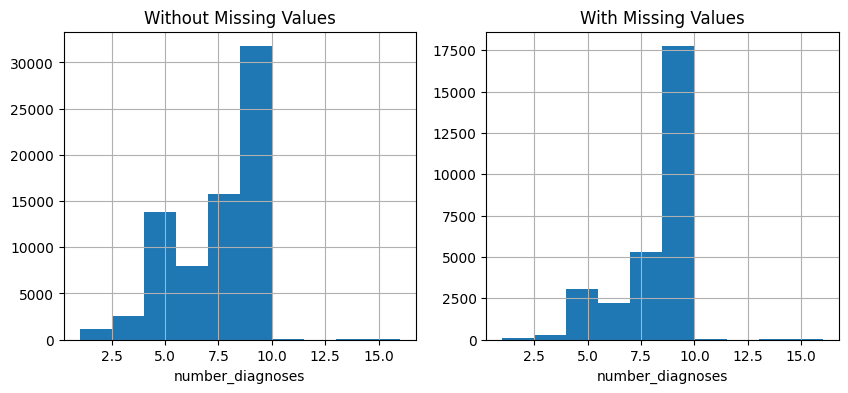

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


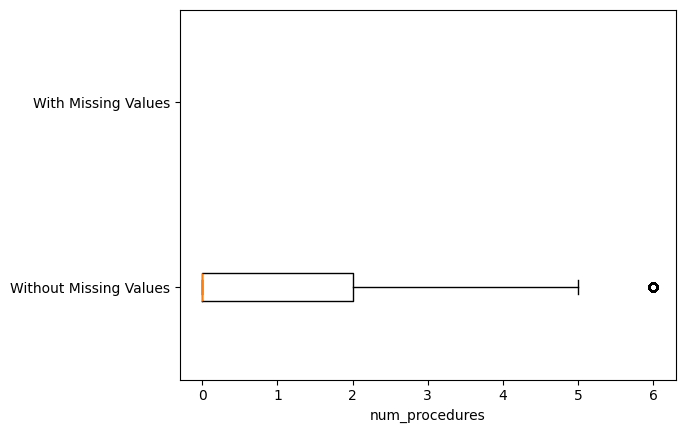

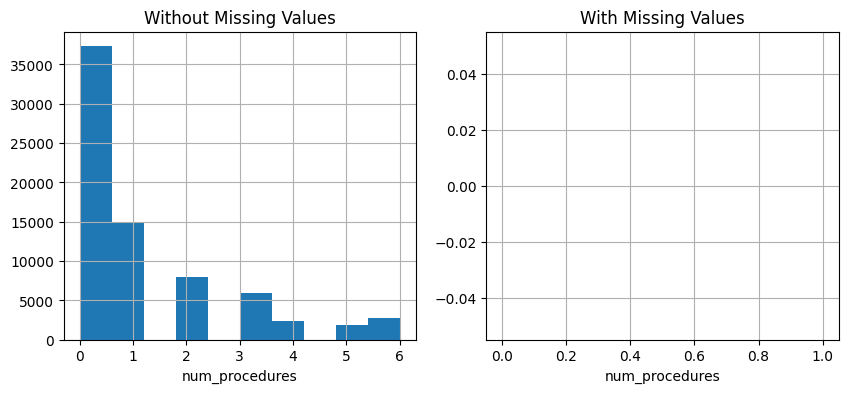

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


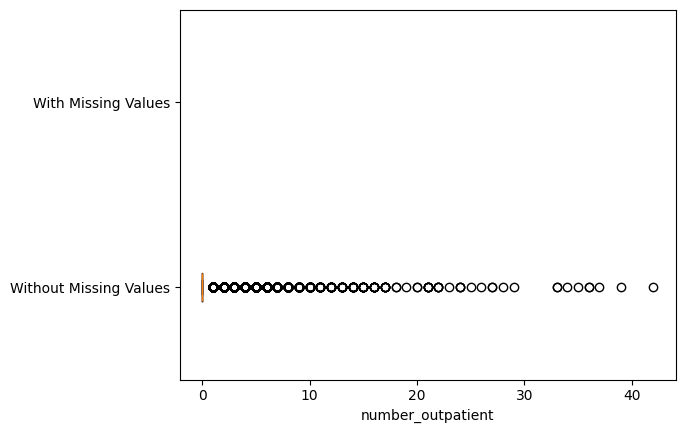

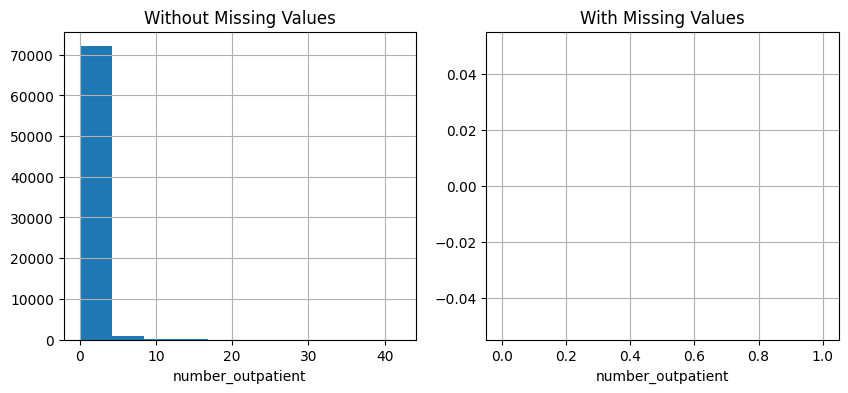

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


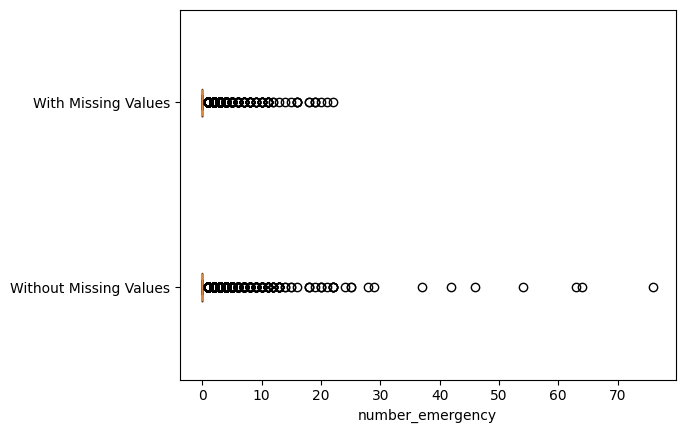

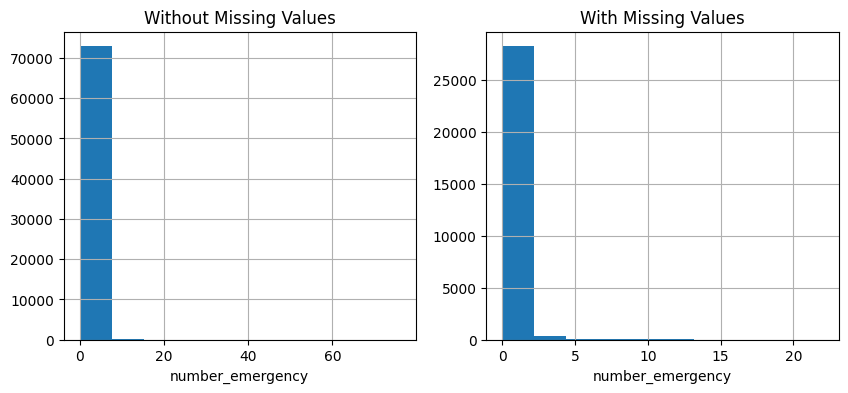

p-value of t-test: 0.026396136088154807
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


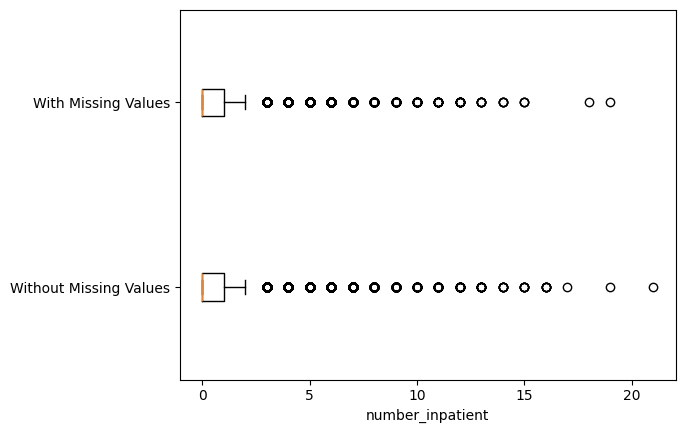

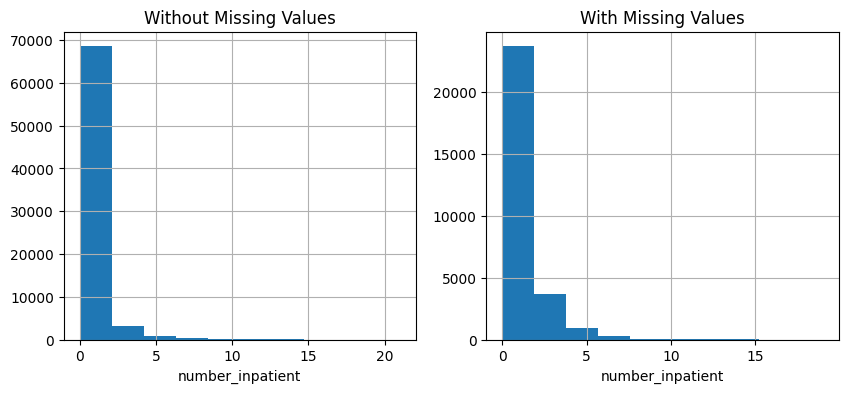

p-value of t-test: 3.94486455109948e-86
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.num_procedures.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:


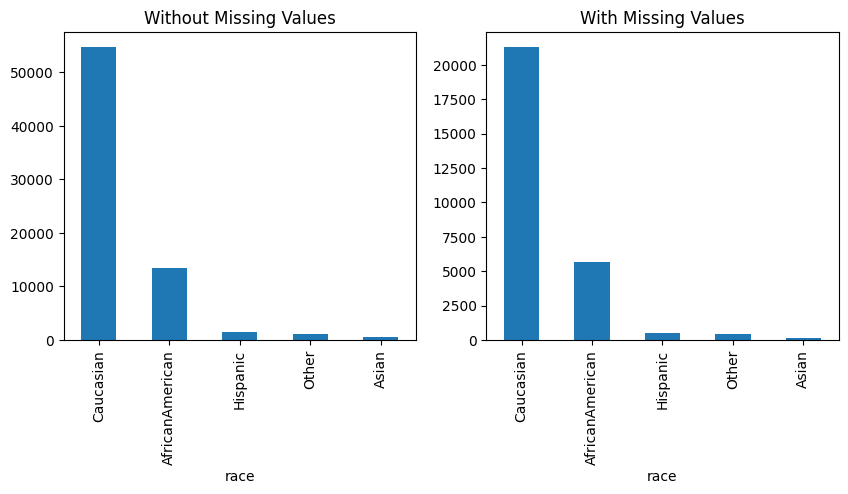

p-value of Chi-squared test: 1.347356777820178e-09
The missingness in 'race' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


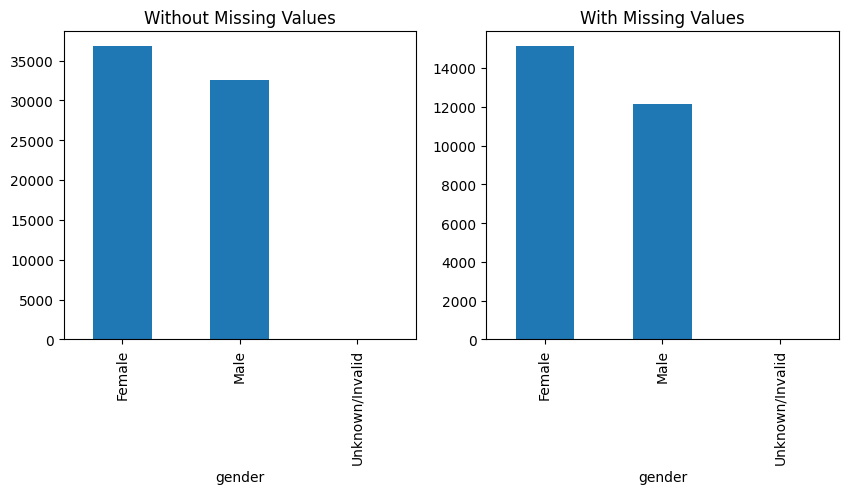

p-value of Chi-squared test: 2.694590452829927e-11
The missingness in 'gender' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


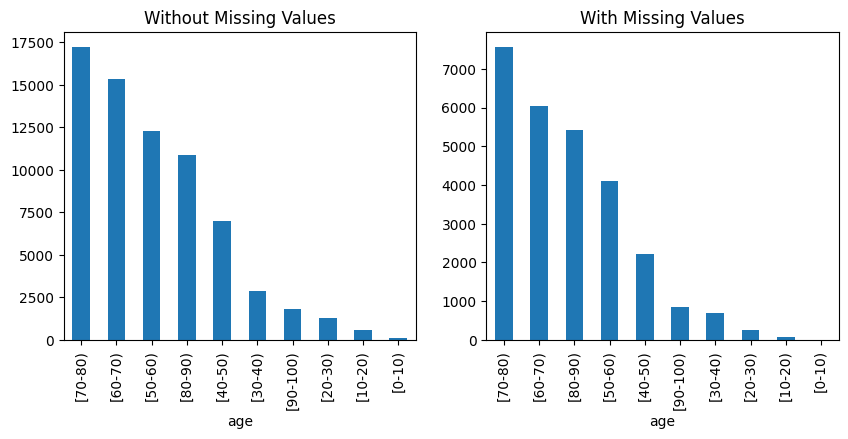

p-value of Chi-squared test: 7.447681731818582e-167
The missingness in 'age' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


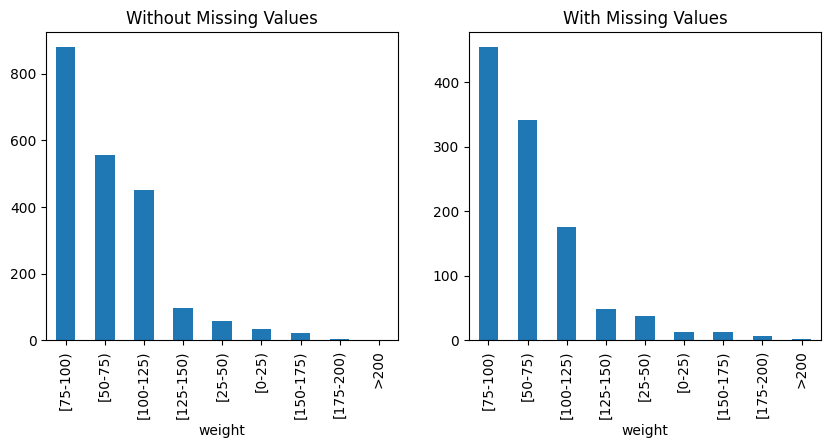

p-value of Chi-squared test: 0.004745880705158979
The missingness in 'weight' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


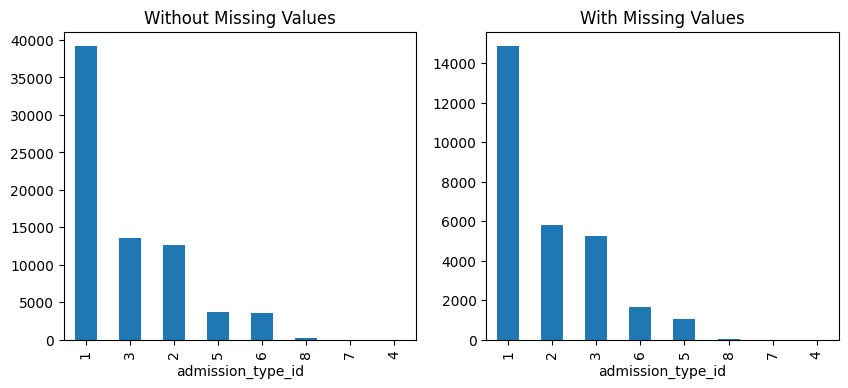

p-value of Chi-squared test: 1.112365208697738e-52
The missingness in 'admission_type_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


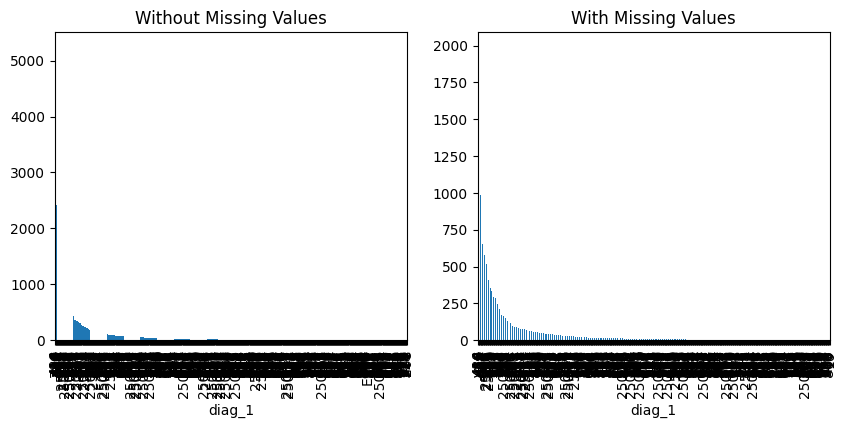

p-value of Chi-squared test: 0.0
The missingness in 'diag_1' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


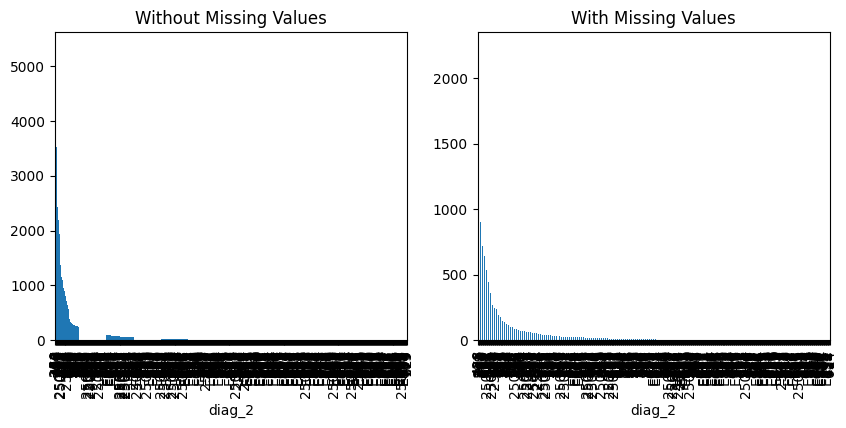

p-value of Chi-squared test: 0.0
The missingness in 'diag_2' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


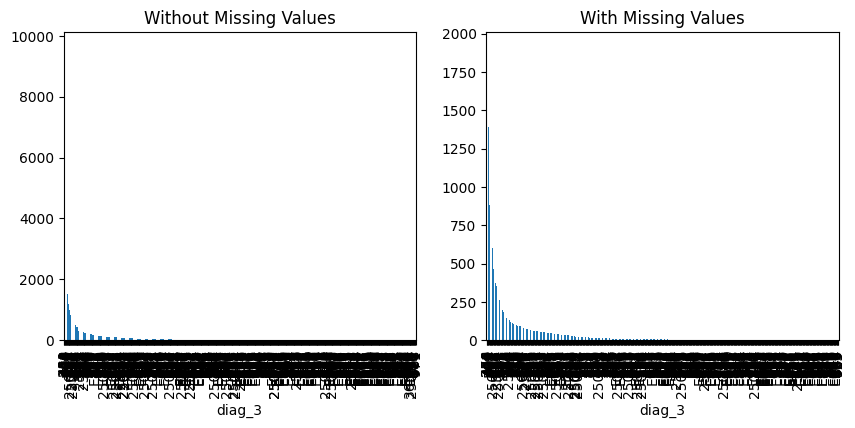

p-value of Chi-squared test: 0.0
The missingness in 'diag_3' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


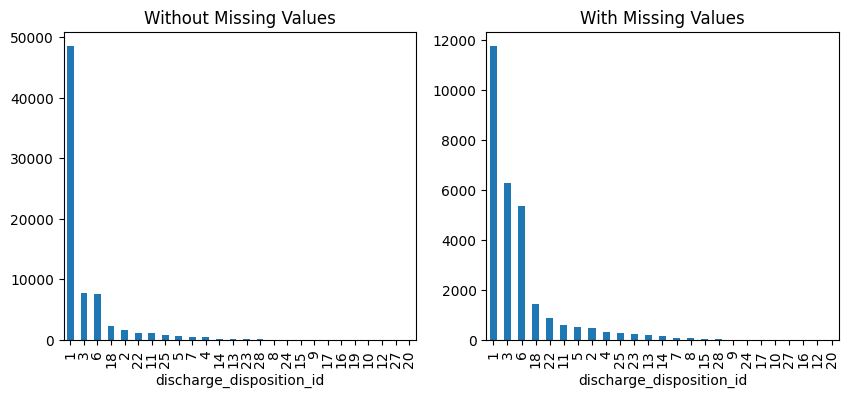

p-value of Chi-squared test: 0.0
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


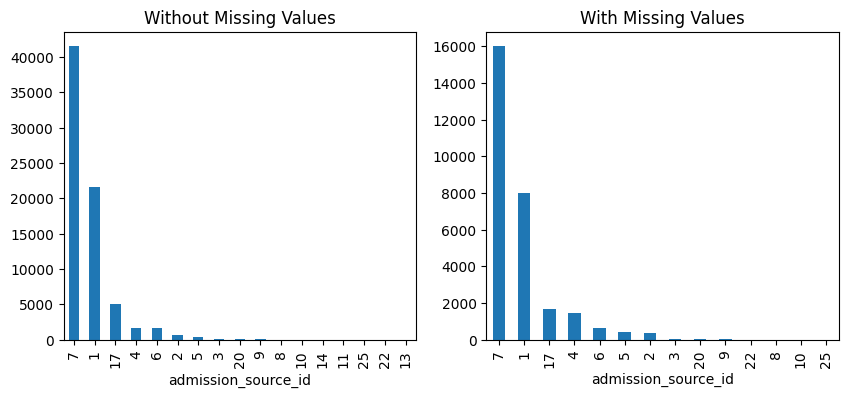

p-value of Chi-squared test: 4.6328354250575384e-160
The missingness in 'admission_source_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


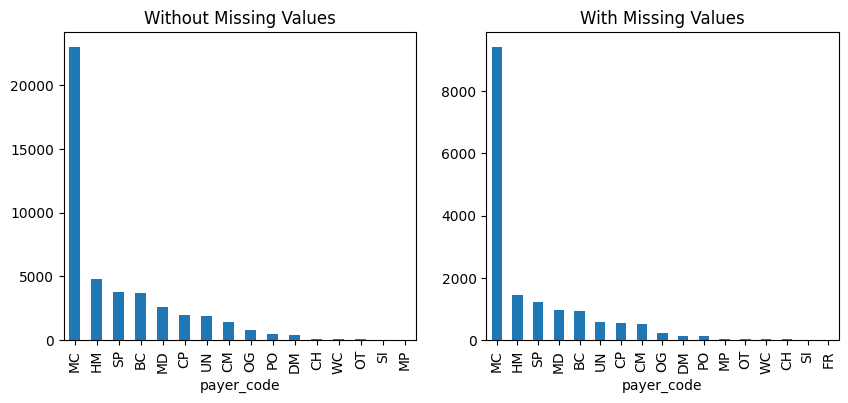

p-value of Chi-squared test: 3.137901603820795e-74
The missingness in 'payer_code' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


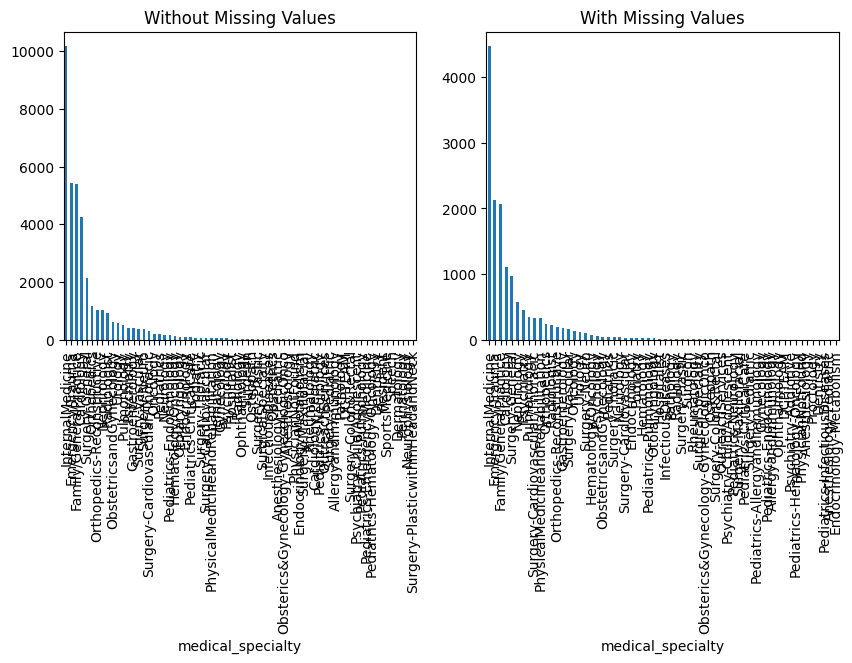

p-value of Chi-squared test: 0.0
The missingness in 'medical_specialty' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


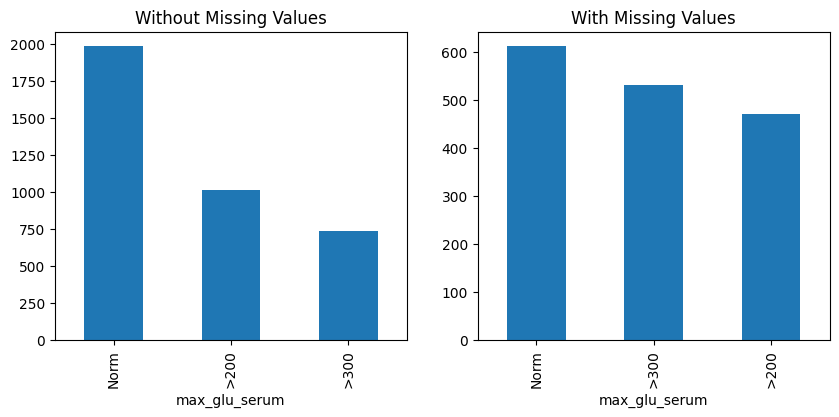

p-value of Chi-squared test: 3.815098758839264e-31
The missingness in 'max_glu_serum' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


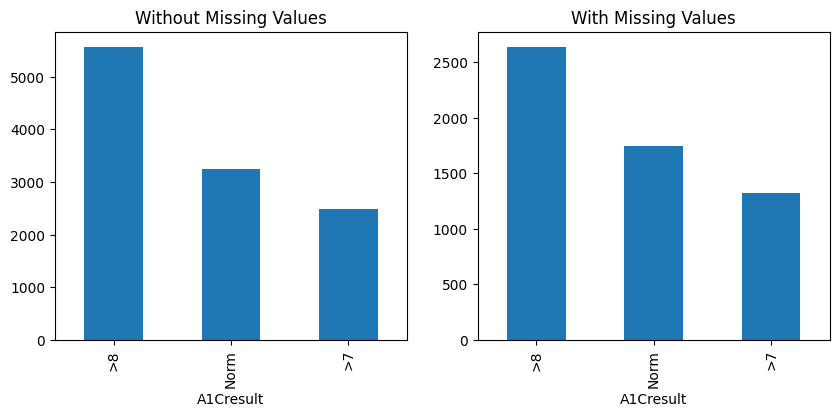

p-value of Chi-squared test: 0.001000733114747327
The missingness in 'A1Cresult' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


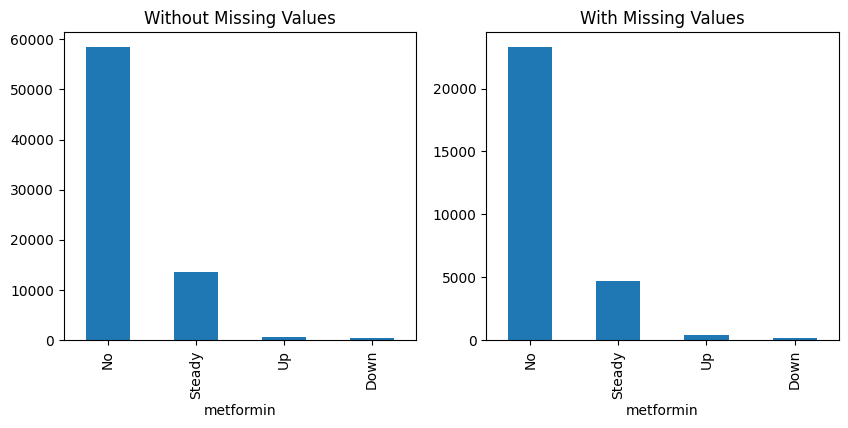

p-value of Chi-squared test: 3.243439275198125e-32
The missingness in 'metformin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


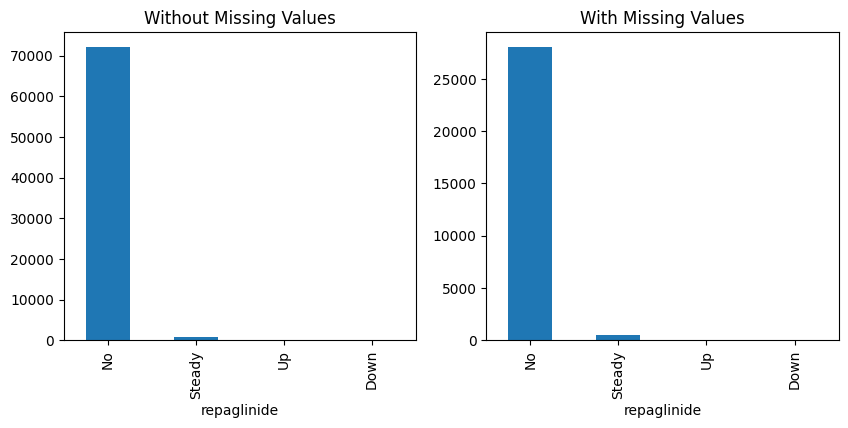

p-value of Chi-squared test: 1.651323670819997e-29
The missingness in 'repaglinide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


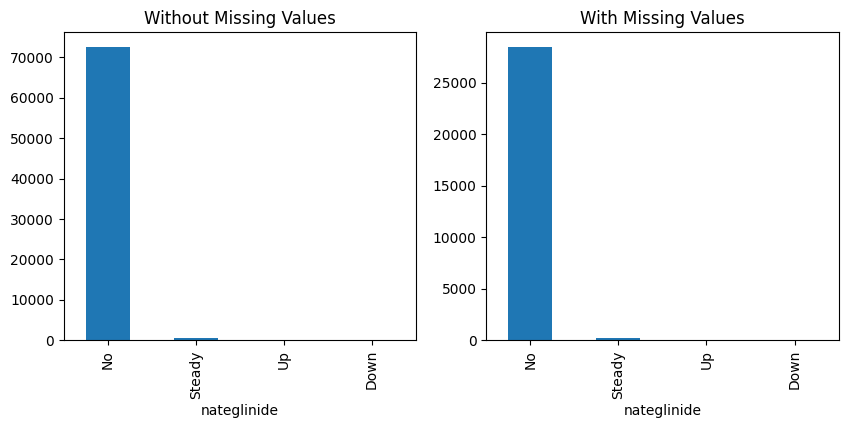

p-value of Chi-squared test: 0.028157193795197332
The missingness in 'nateglinide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


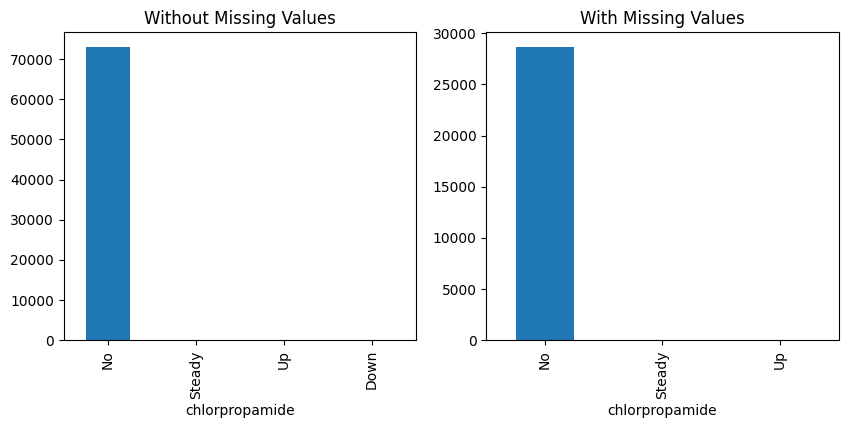

p-value of Chi-squared test: 0.7192961195043427
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


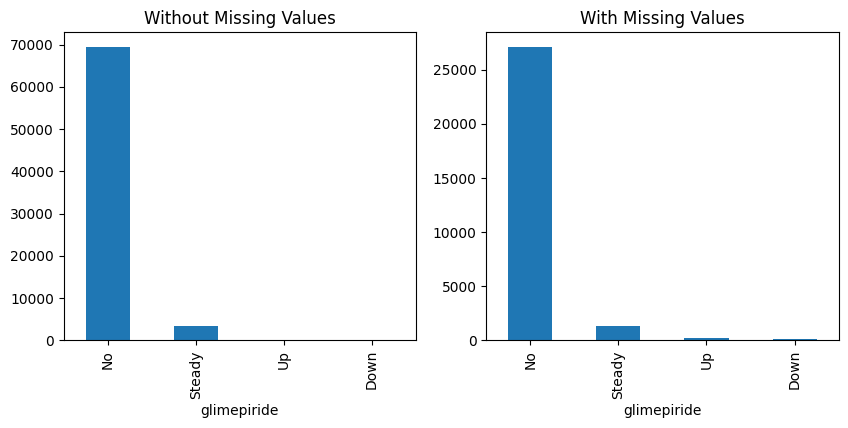

p-value of Chi-squared test: 2.3700169115332424e-29
The missingness in 'glimepiride' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


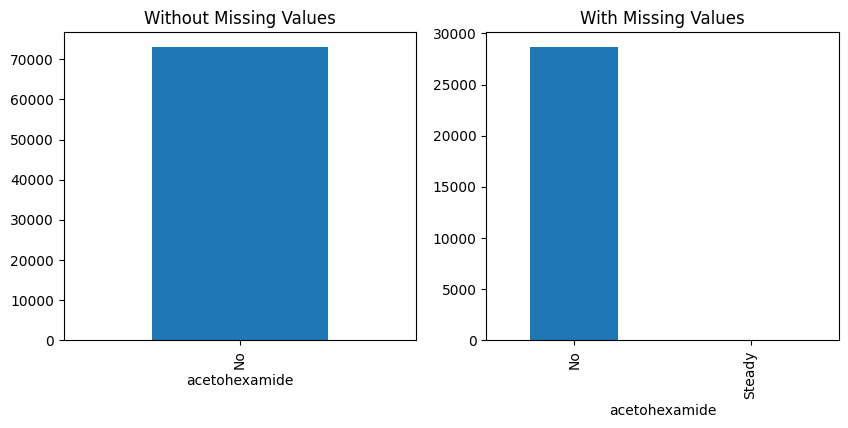

p-value of Chi-squared test: 0.6278568594144229
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


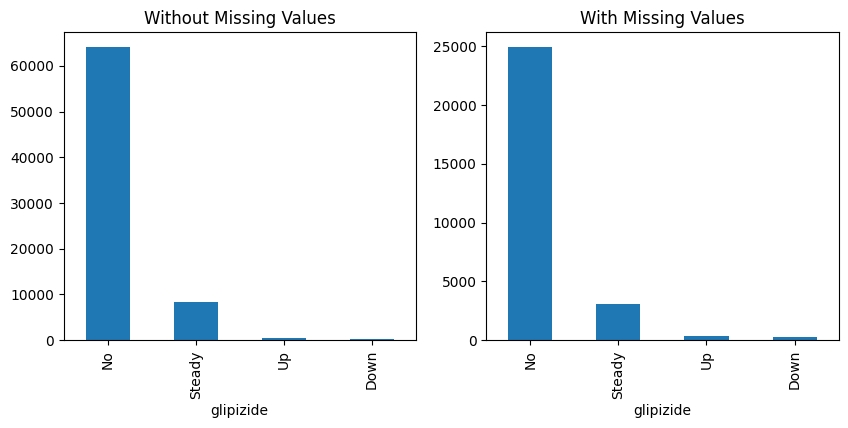

p-value of Chi-squared test: 1.0925807043701735e-57
The missingness in 'glipizide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


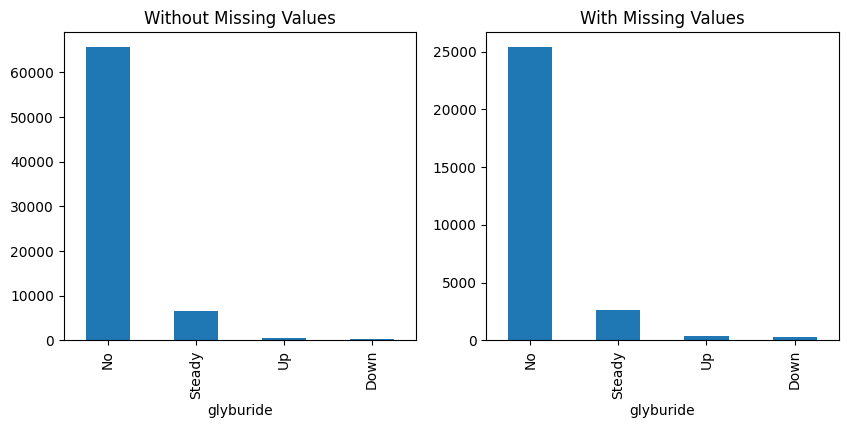

p-value of Chi-squared test: 1.0222288875746806e-49
The missingness in 'glyburide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


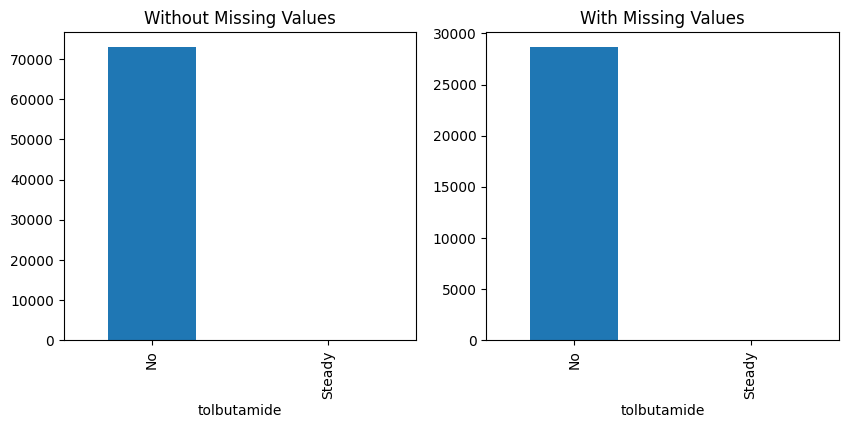

p-value of Chi-squared test: 0.350032458529108
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


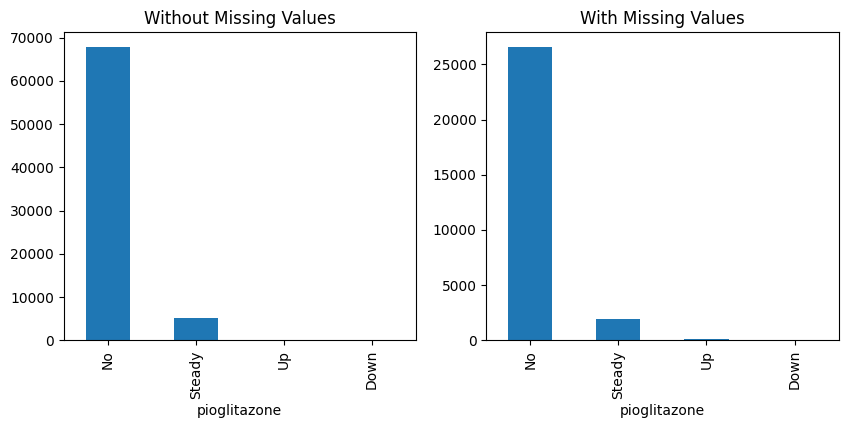

p-value of Chi-squared test: 5.983303582437579e-27
The missingness in 'pioglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


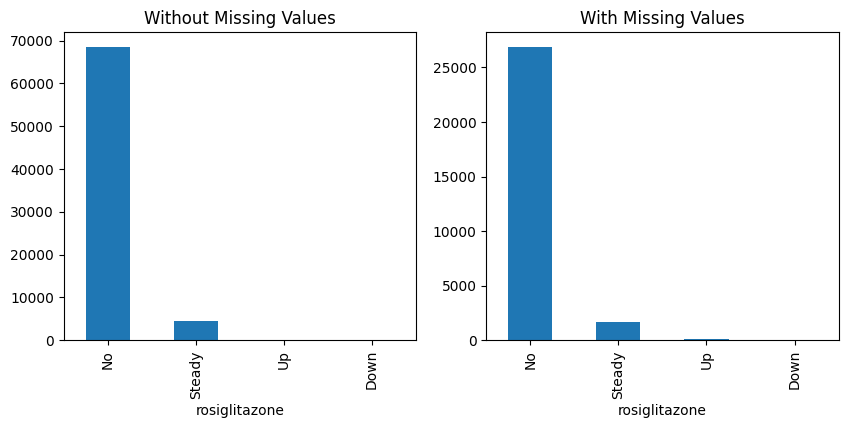

p-value of Chi-squared test: 1.450208159959678e-13
The missingness in 'rosiglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


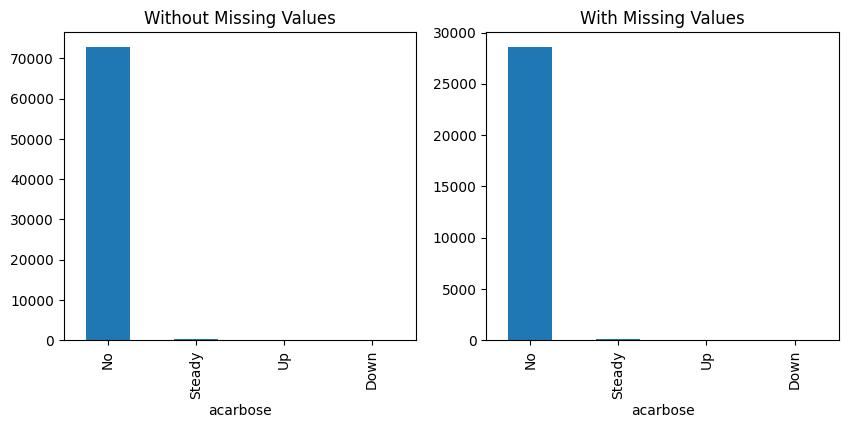

p-value of Chi-squared test: 0.157384302452171
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


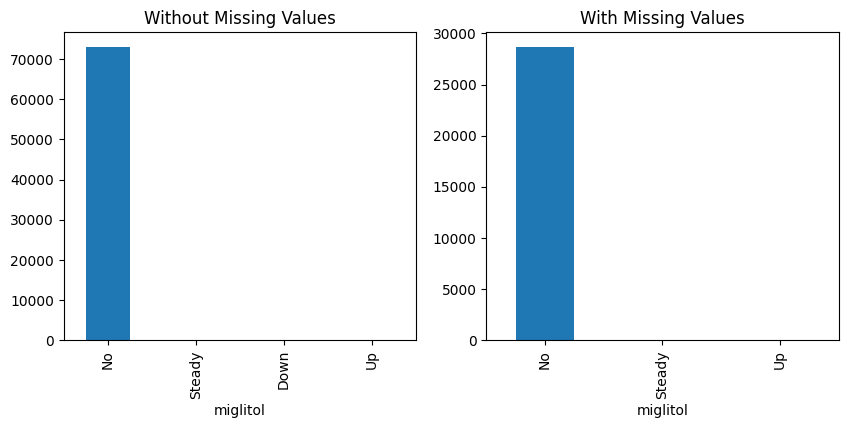

p-value of Chi-squared test: 0.4855572249166583
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


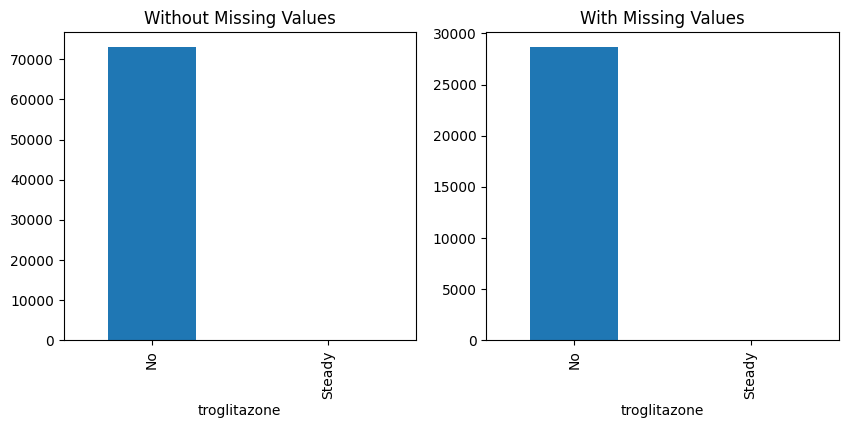

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


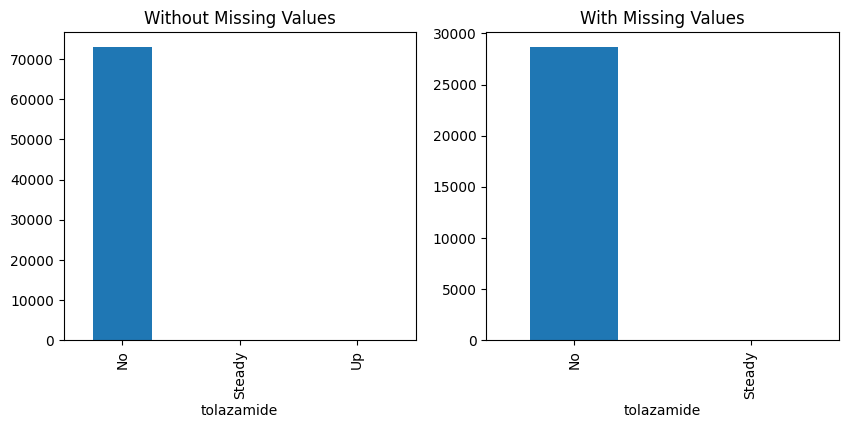

p-value of Chi-squared test: 0.8173687869044056
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


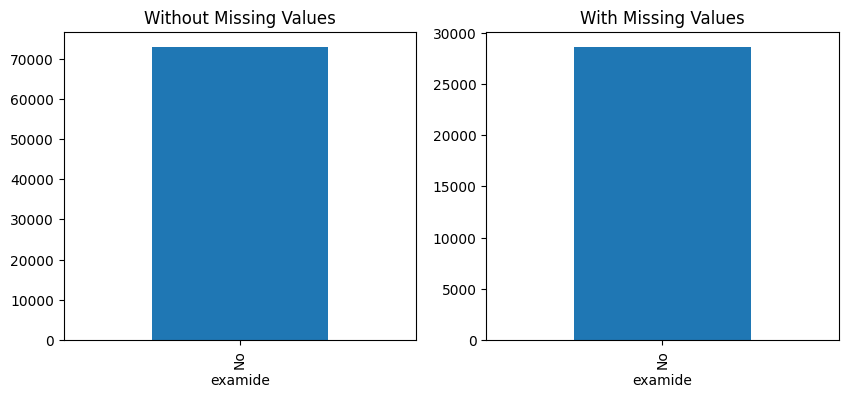

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


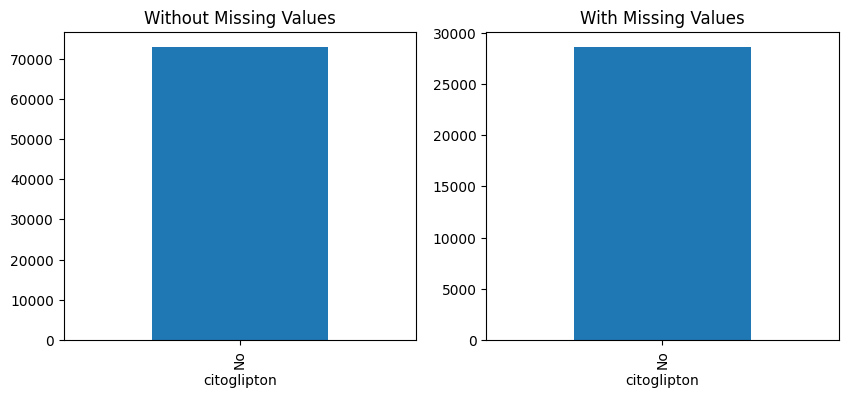

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:


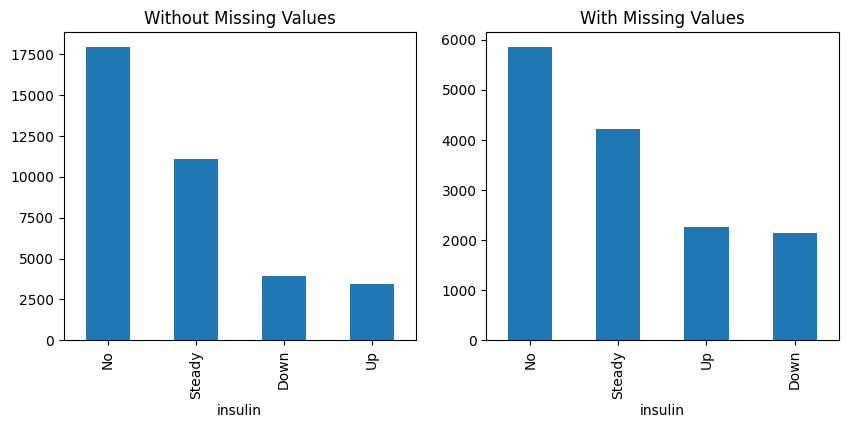

p-value of Chi-squared test: 1.9799957810181318e-144
The missingness in 'insulin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


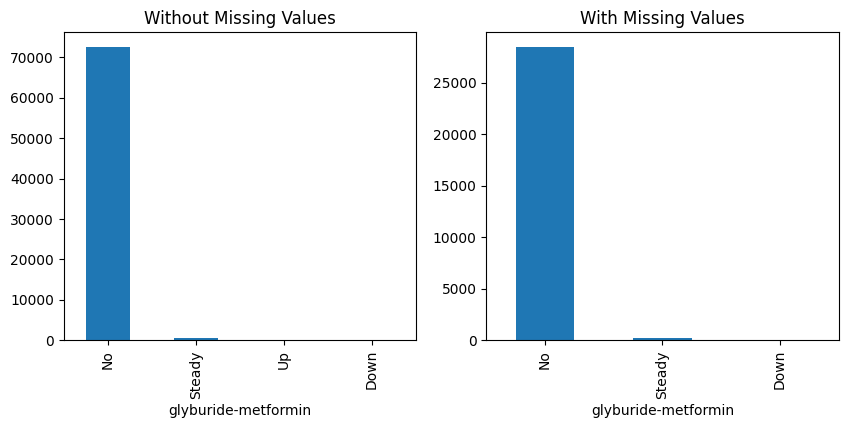

p-value of Chi-squared test: 0.18575072674402496
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


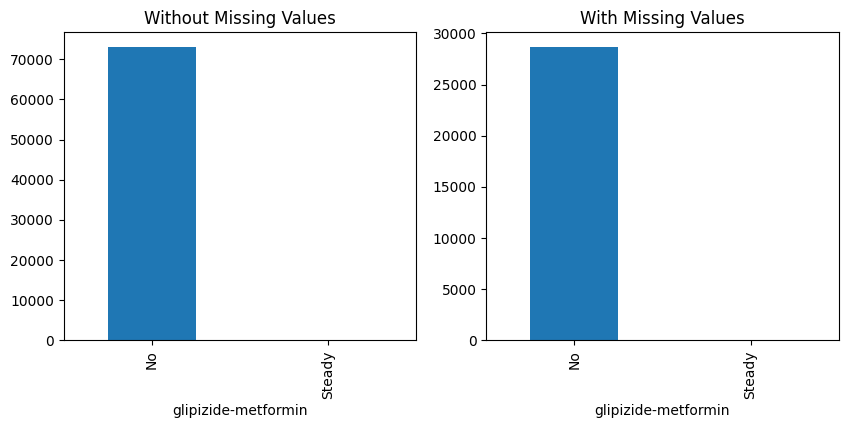

p-value of Chi-squared test: 0.6066030456765656
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


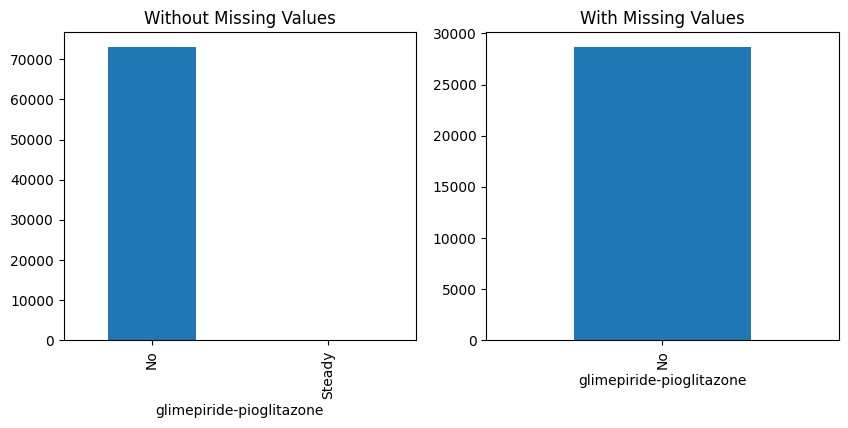

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


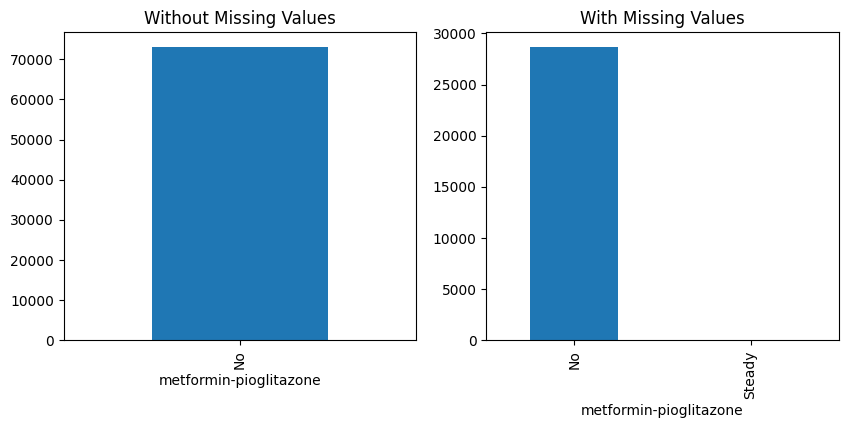

p-value of Chi-squared test: 0.6278568594144229
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


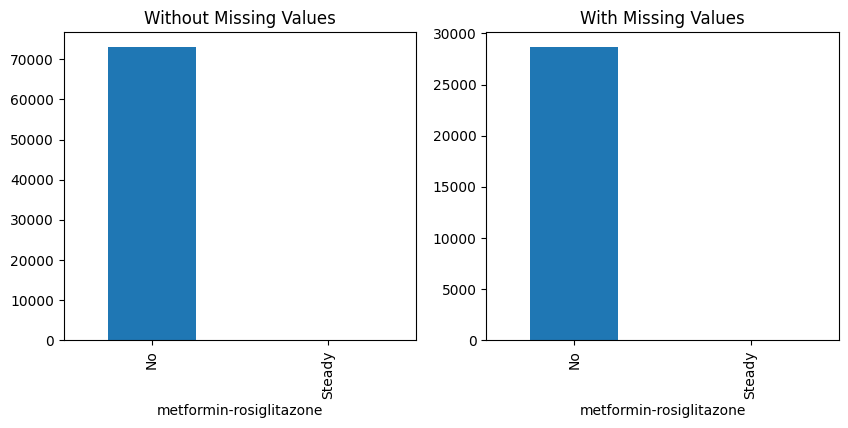

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


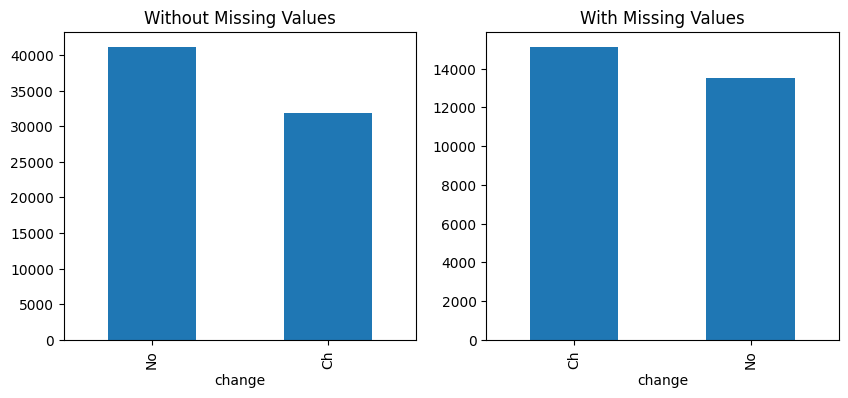

p-value of Chi-squared test: 6.730755246288683e-154
The missingness in 'change' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


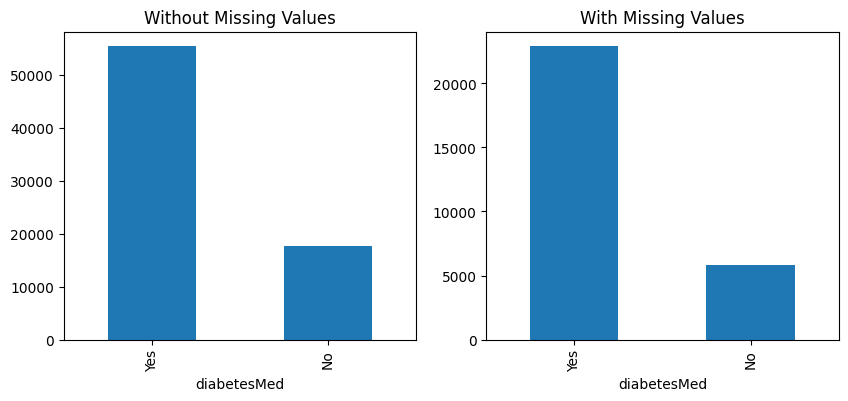

p-value of Chi-squared test: 4.9772668151369515e-40
The missingness in 'diabetesMed' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


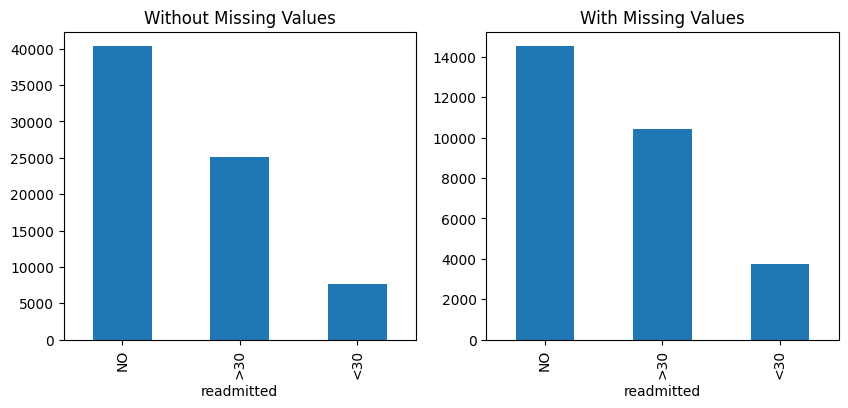

p-value of Chi-squared test: 5.577522994239756e-51
The missingness in 'readmitted' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.num_procedures.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### After going through this we can say the missing value for `num_procedures` is MAR type because if the time in hospital is greater than 5 we see more missing values

## Detecting Missing type for number_outpatient

Diagnosis Analysis of Missing Values for time_in_hospital:


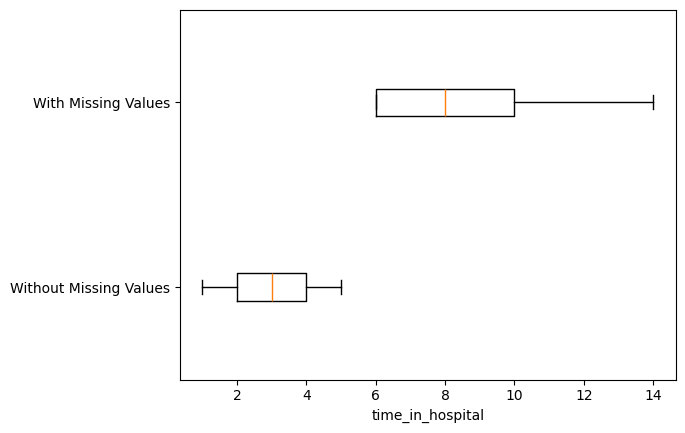

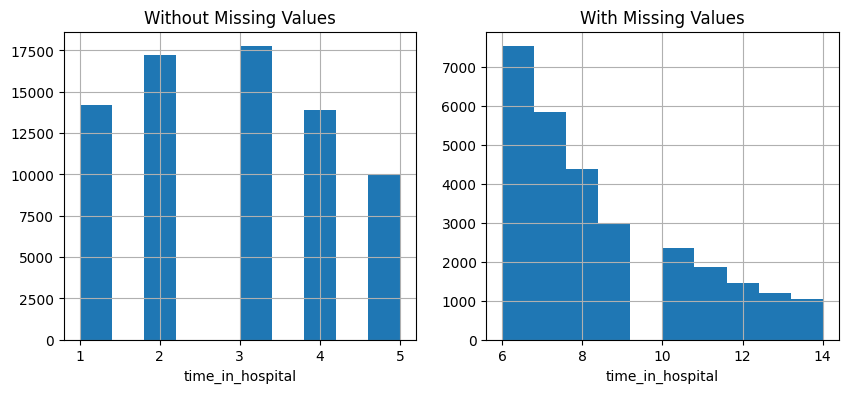

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


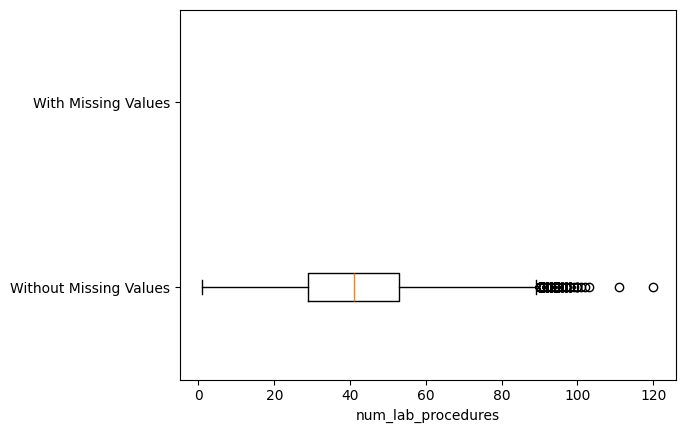

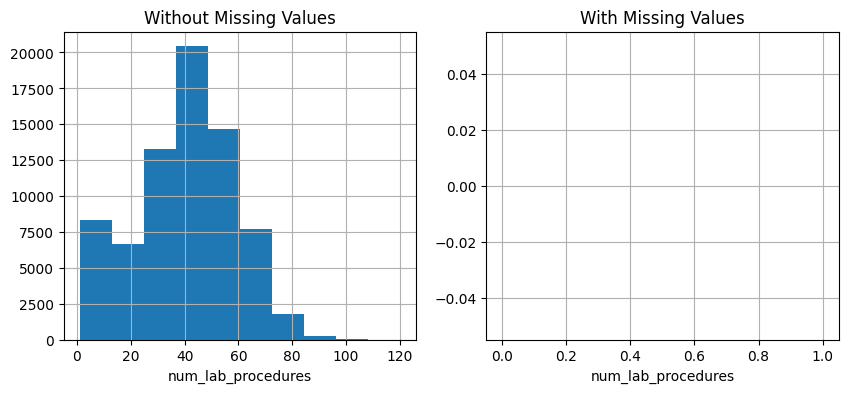

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


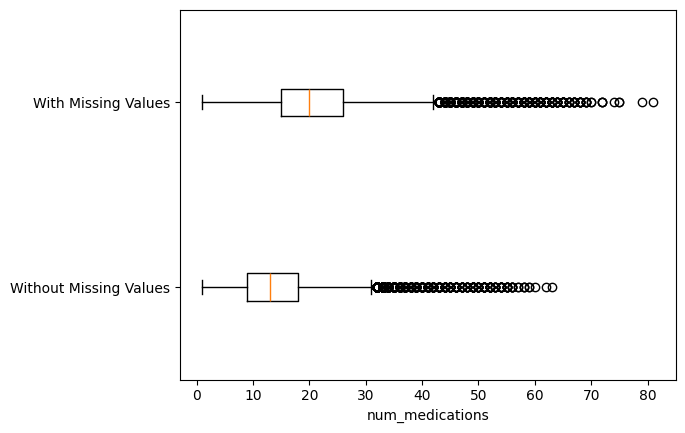

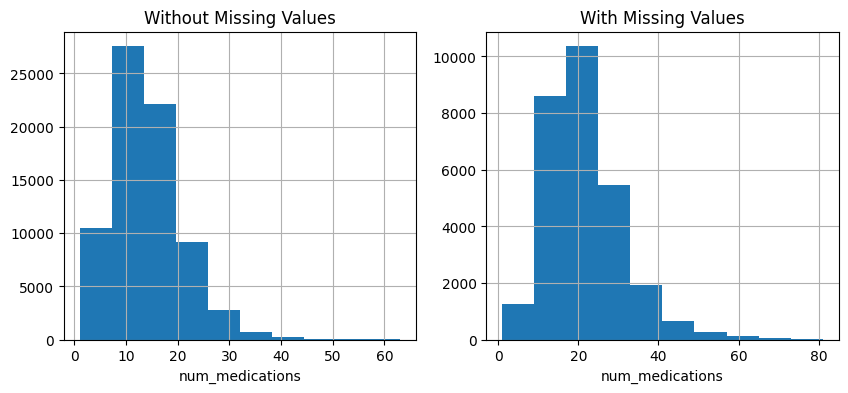

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


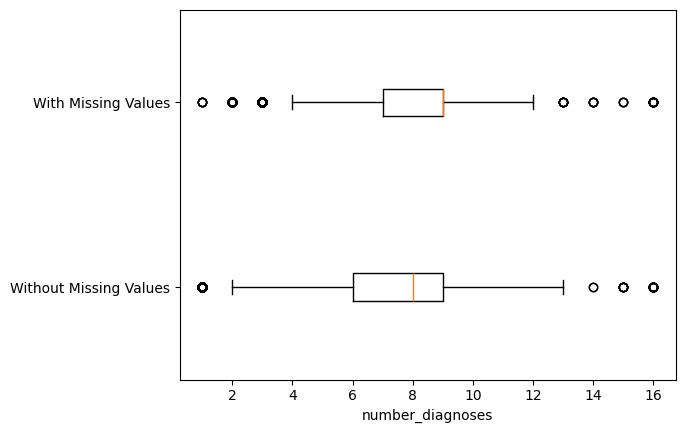

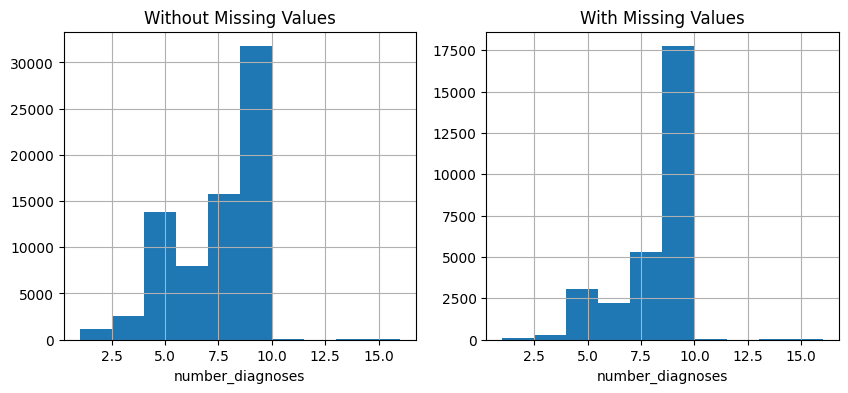

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


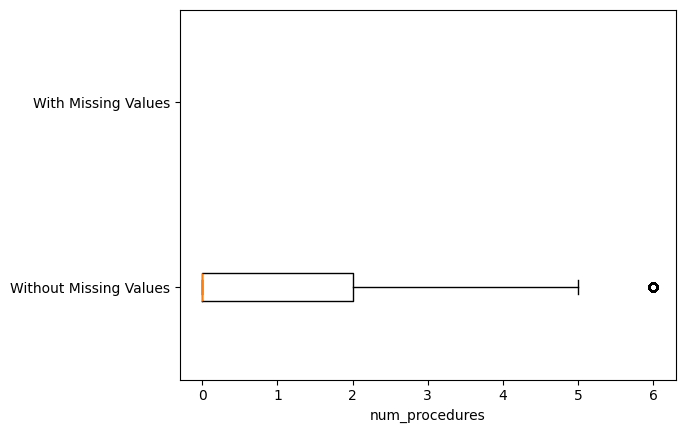

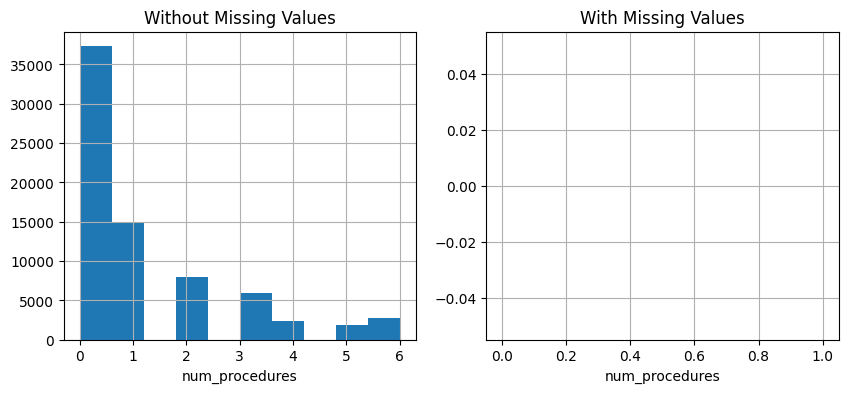

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


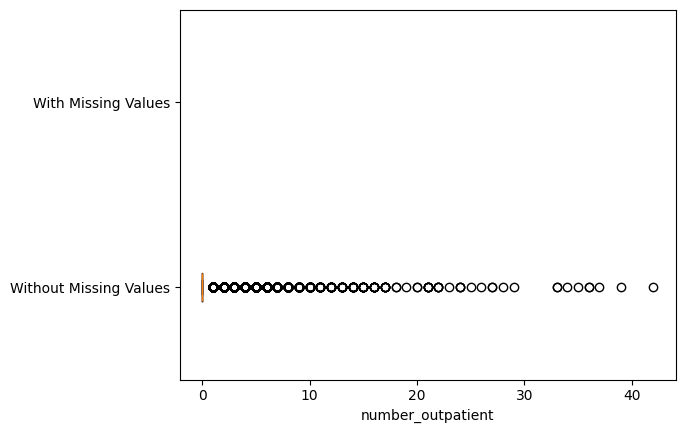

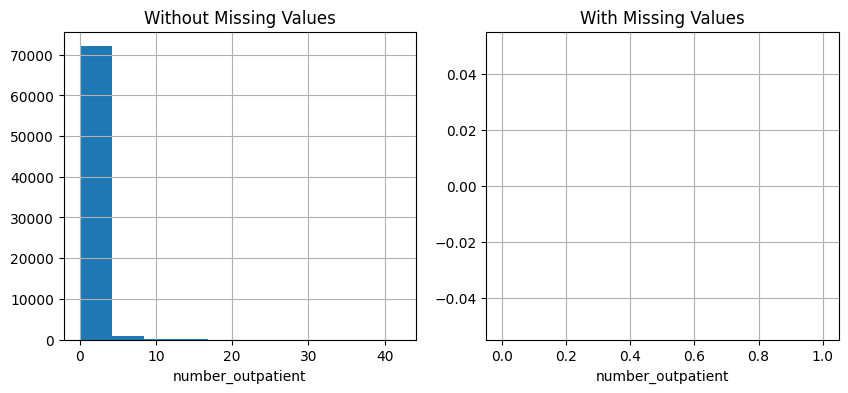

p-value of t-test: nan
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


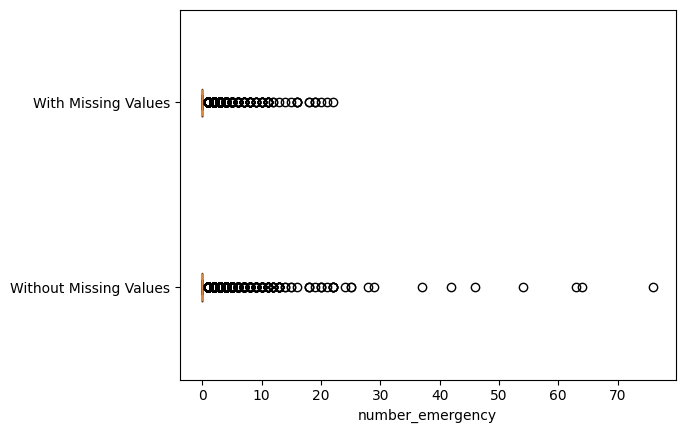

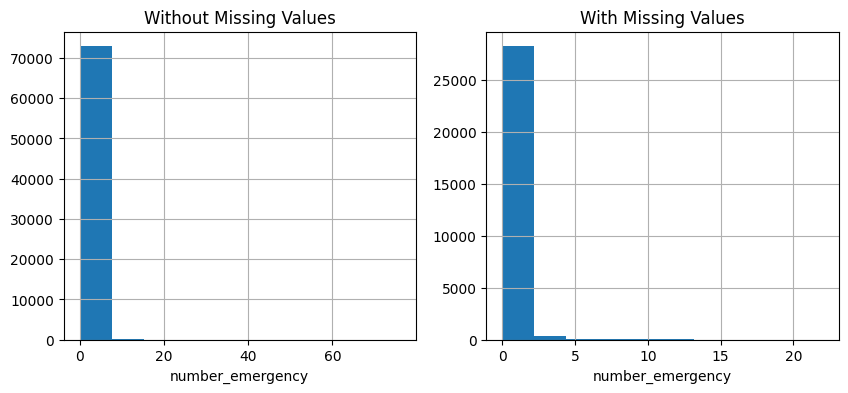

p-value of t-test: 0.026396136088154807
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


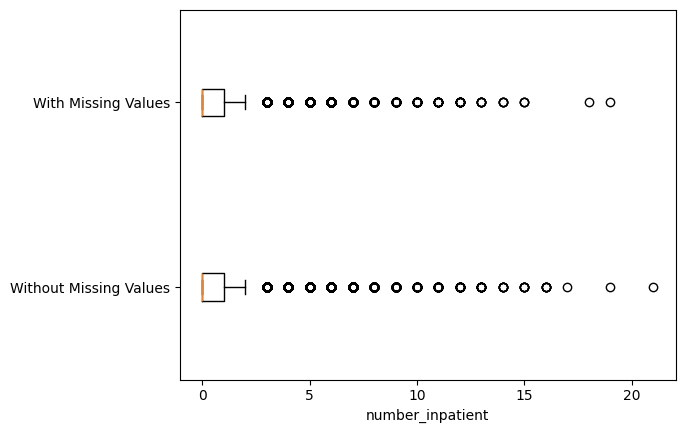

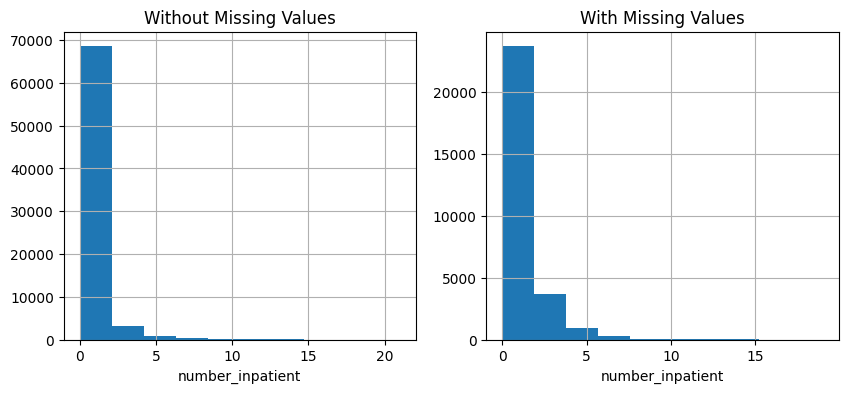

p-value of t-test: 3.94486455109948e-86
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.number_outpatient.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:


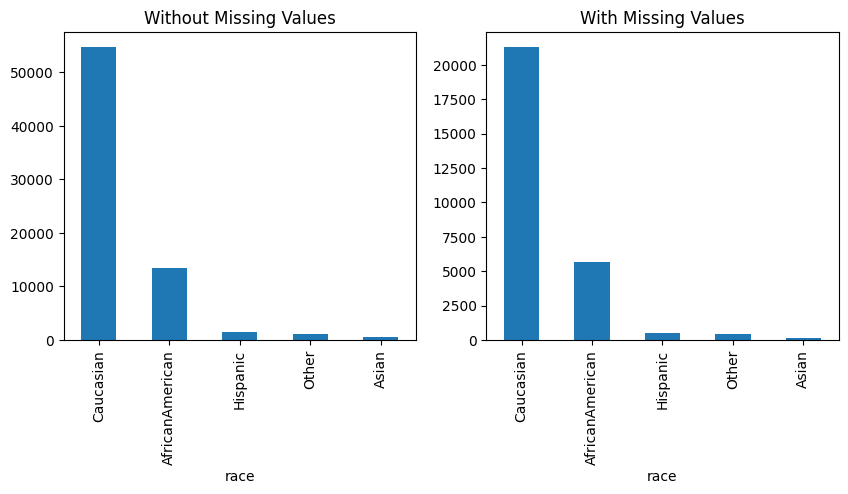

p-value of Chi-squared test: 1.347356777820178e-09
The missingness in 'race' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


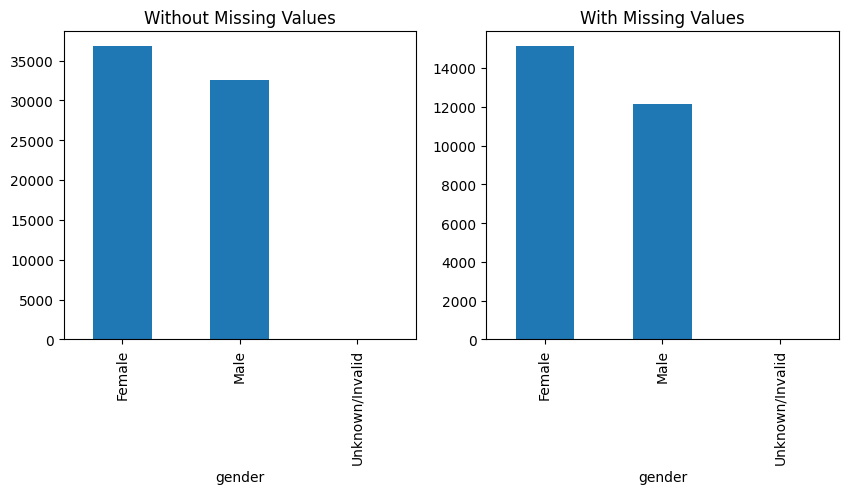

p-value of Chi-squared test: 2.694590452829927e-11
The missingness in 'gender' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


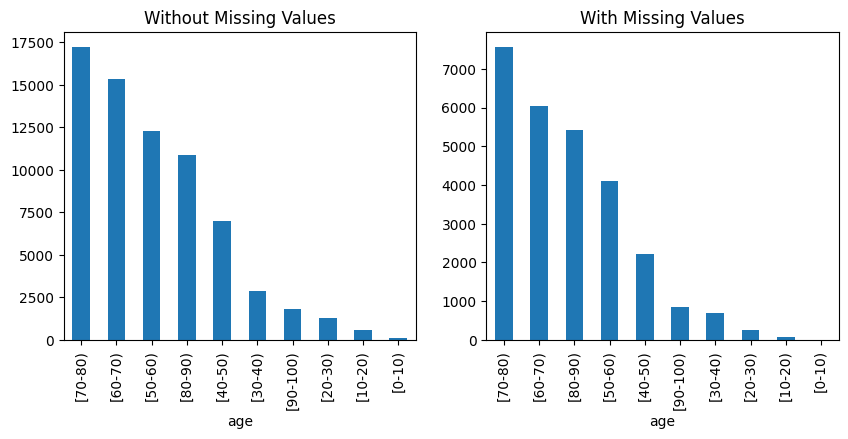

p-value of Chi-squared test: 7.447681731818582e-167
The missingness in 'age' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


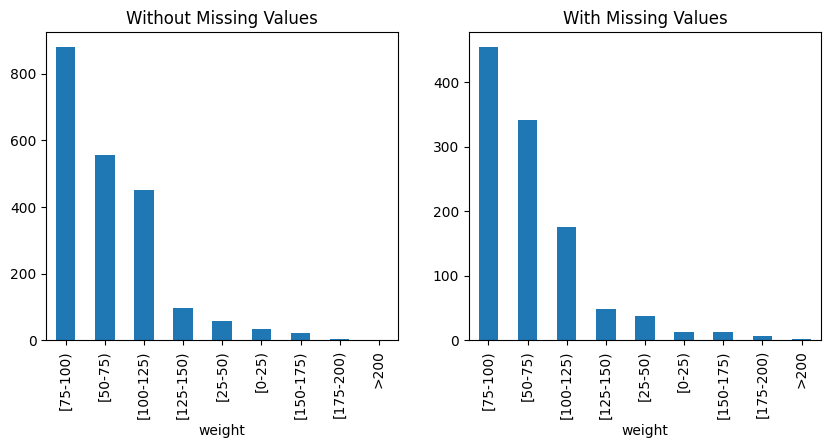

p-value of Chi-squared test: 0.004745880705158979
The missingness in 'weight' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


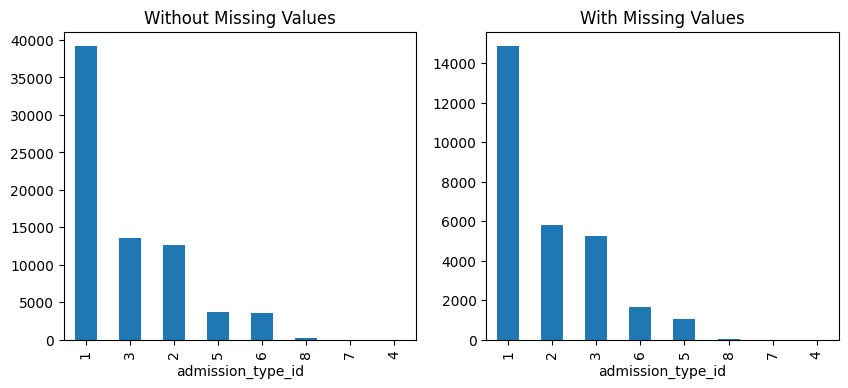

p-value of Chi-squared test: 1.112365208697738e-52
The missingness in 'admission_type_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


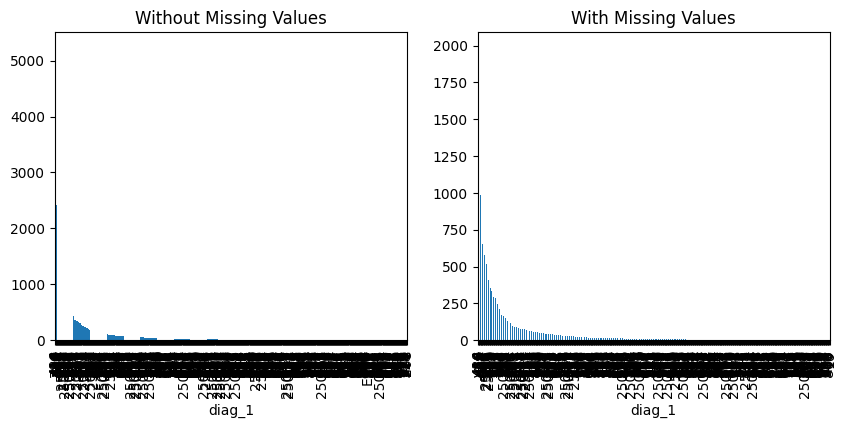

p-value of Chi-squared test: 0.0
The missingness in 'diag_1' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


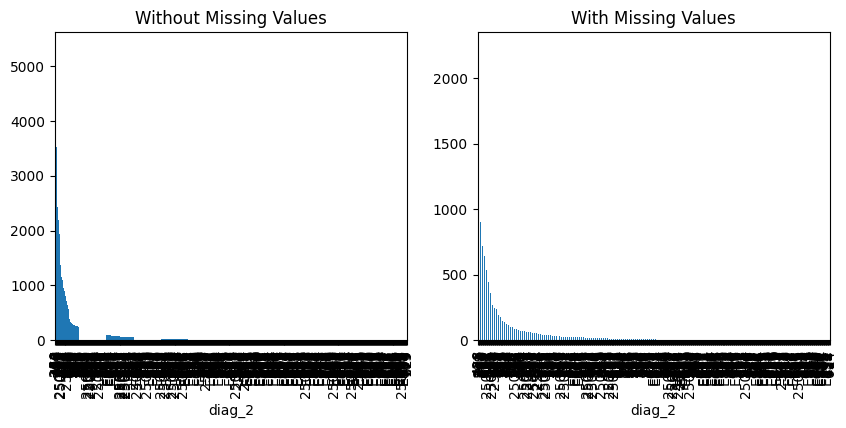

p-value of Chi-squared test: 0.0
The missingness in 'diag_2' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


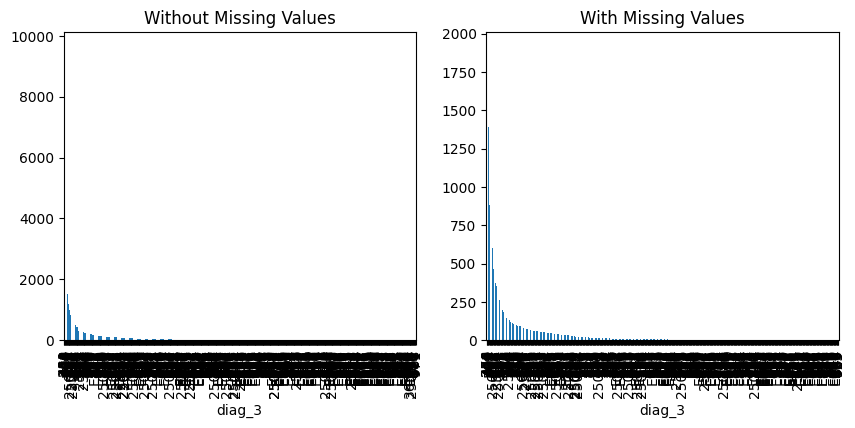

p-value of Chi-squared test: 0.0
The missingness in 'diag_3' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


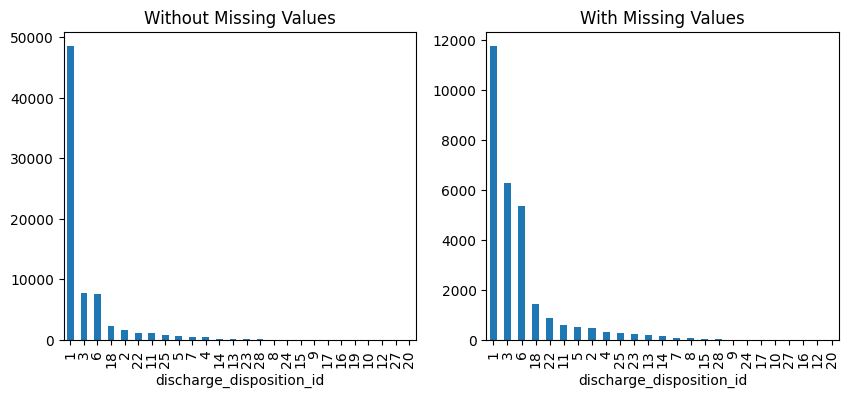

p-value of Chi-squared test: 0.0
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


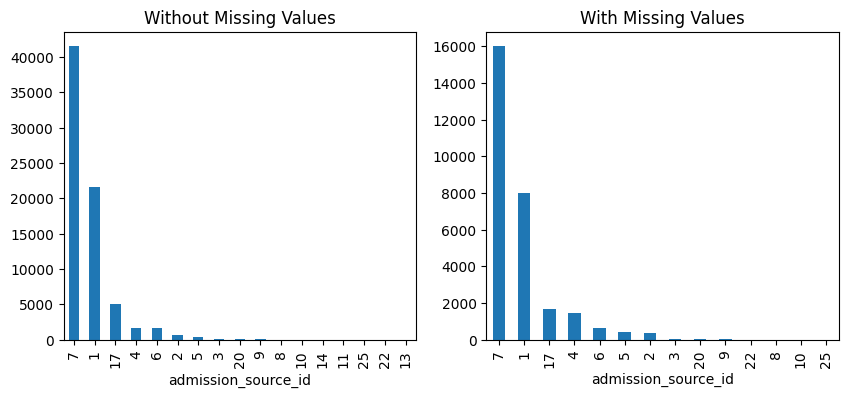

p-value of Chi-squared test: 4.6328354250575384e-160
The missingness in 'admission_source_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


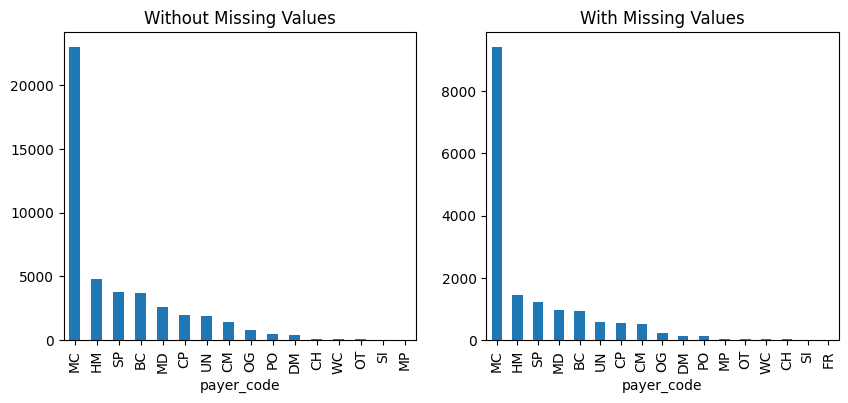

p-value of Chi-squared test: 3.137901603820795e-74
The missingness in 'payer_code' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


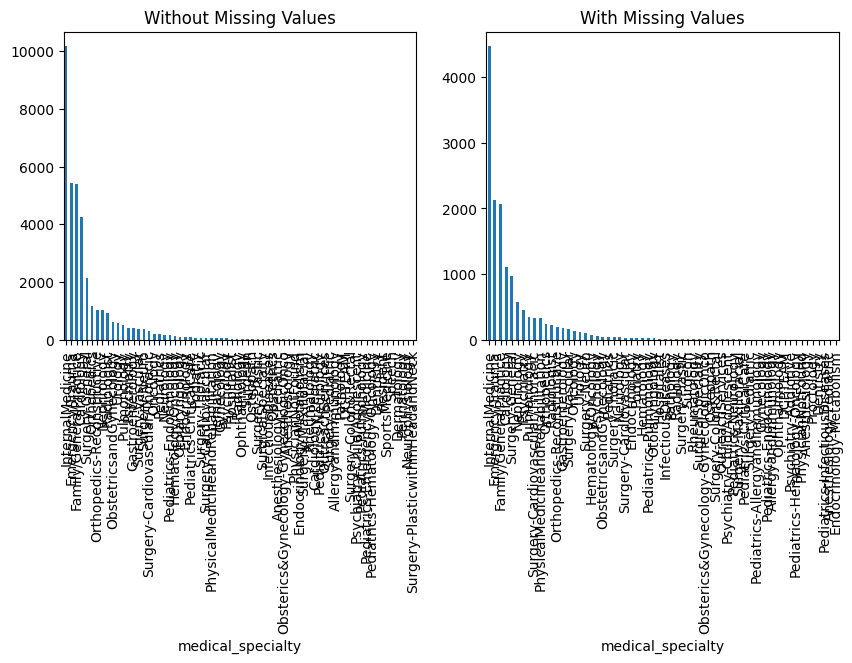

p-value of Chi-squared test: 0.0
The missingness in 'medical_specialty' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


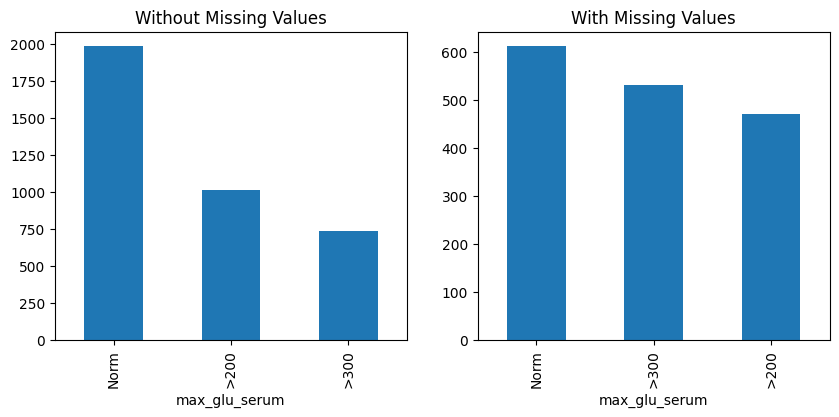

p-value of Chi-squared test: 3.815098758839264e-31
The missingness in 'max_glu_serum' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


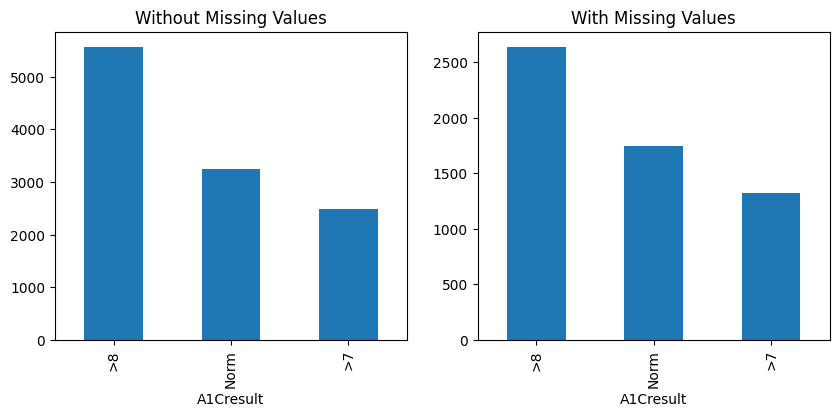

p-value of Chi-squared test: 0.001000733114747327
The missingness in 'A1Cresult' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


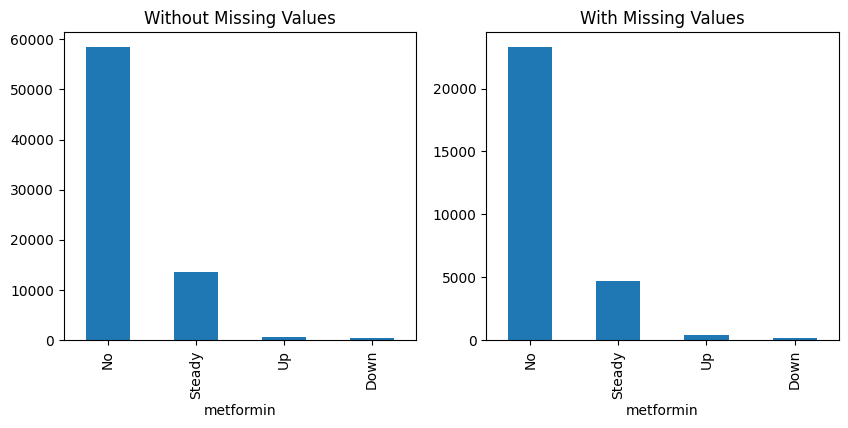

p-value of Chi-squared test: 3.243439275198125e-32
The missingness in 'metformin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


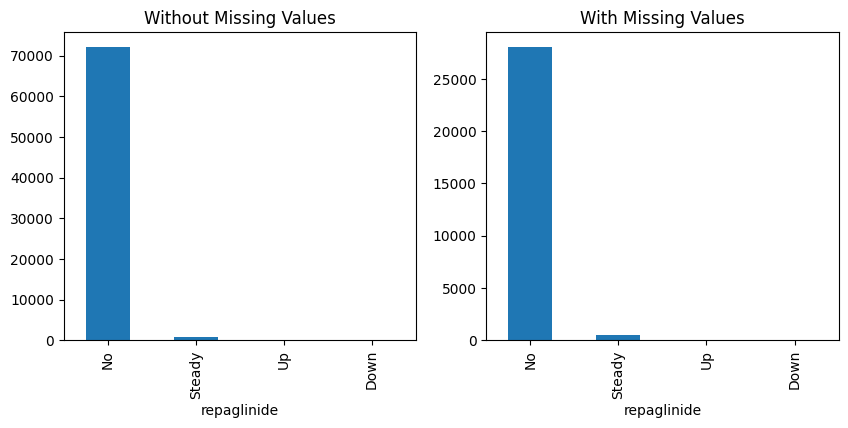

p-value of Chi-squared test: 1.651323670819997e-29
The missingness in 'repaglinide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


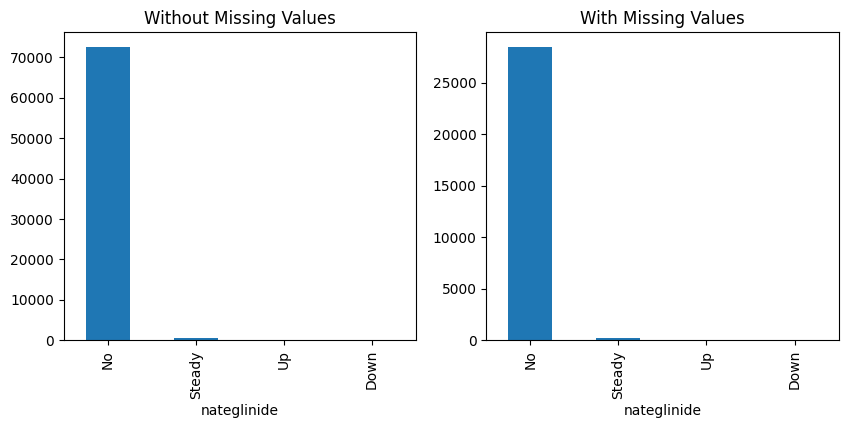

p-value of Chi-squared test: 0.028157193795197332
The missingness in 'nateglinide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


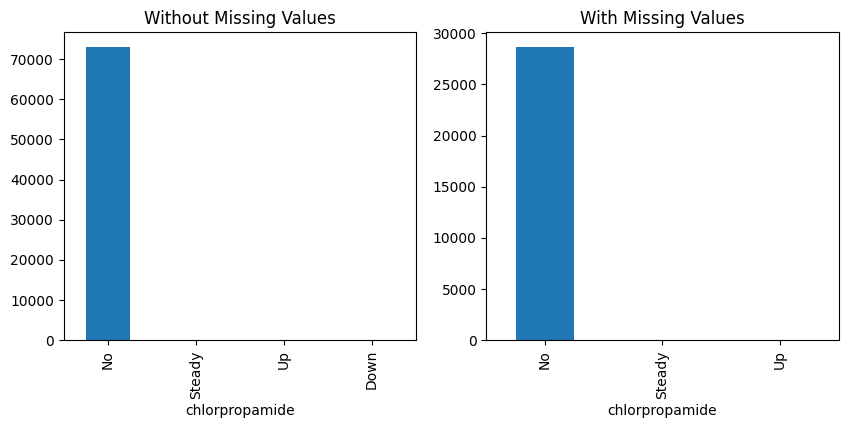

p-value of Chi-squared test: 0.7192961195043427
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


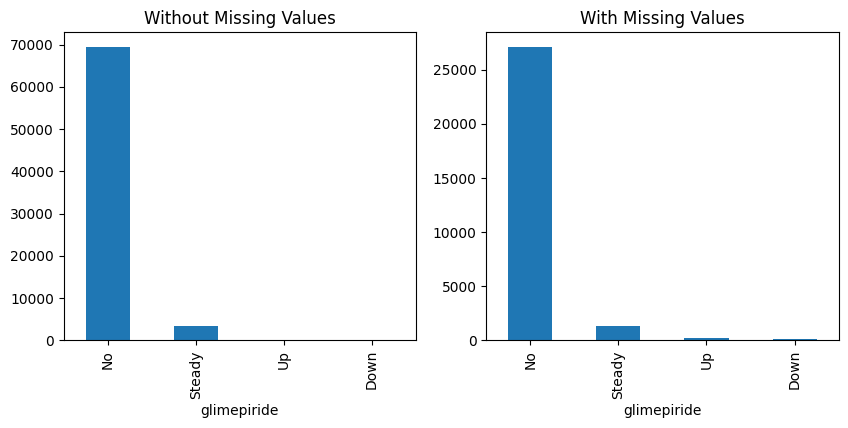

p-value of Chi-squared test: 2.3700169115332424e-29
The missingness in 'glimepiride' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


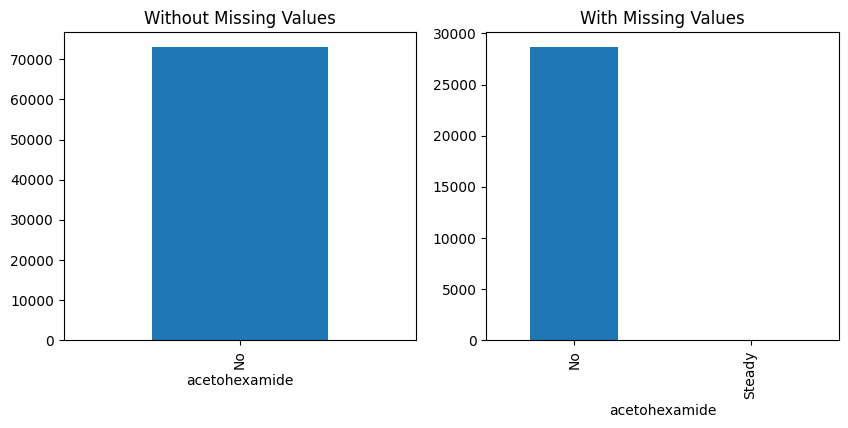

p-value of Chi-squared test: 0.6278568594144229
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


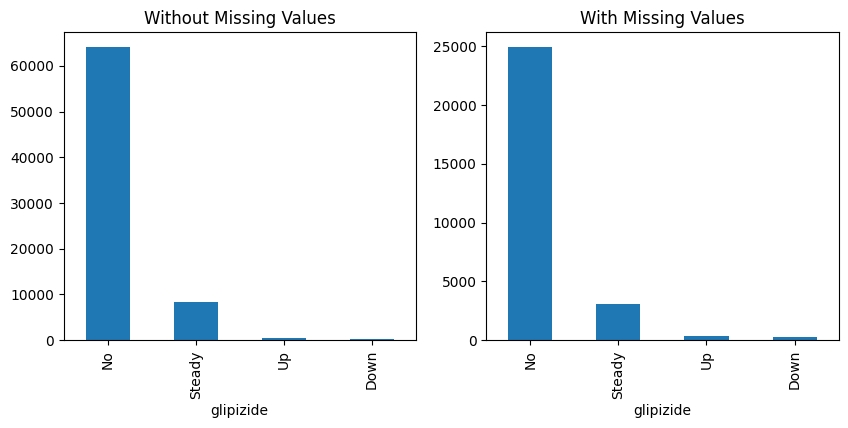

p-value of Chi-squared test: 1.0925807043701735e-57
The missingness in 'glipizide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


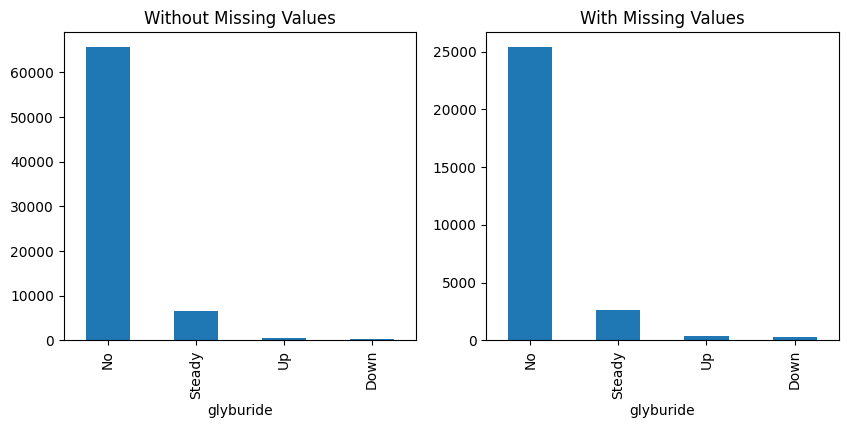

p-value of Chi-squared test: 1.0222288875746806e-49
The missingness in 'glyburide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


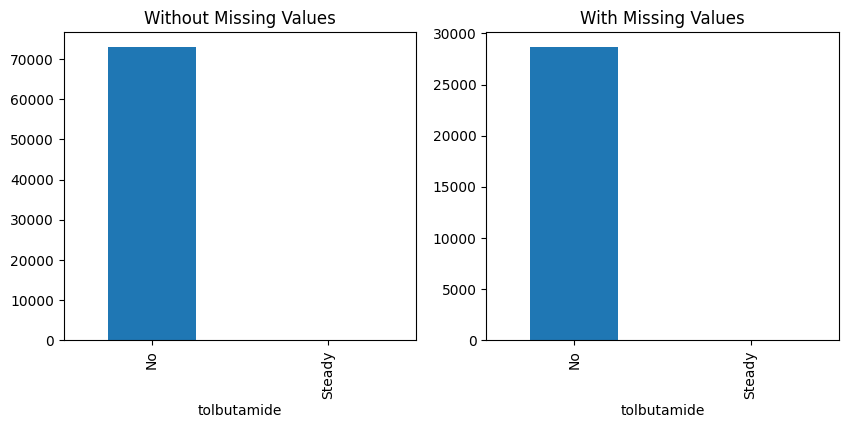

p-value of Chi-squared test: 0.350032458529108
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


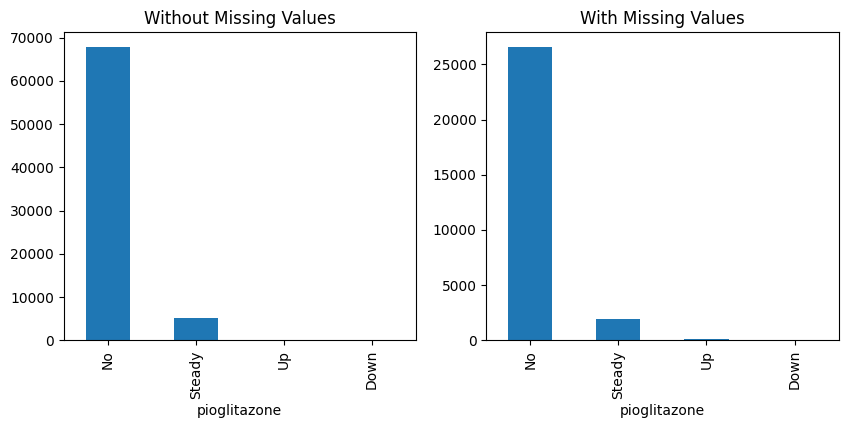

p-value of Chi-squared test: 5.983303582437579e-27
The missingness in 'pioglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


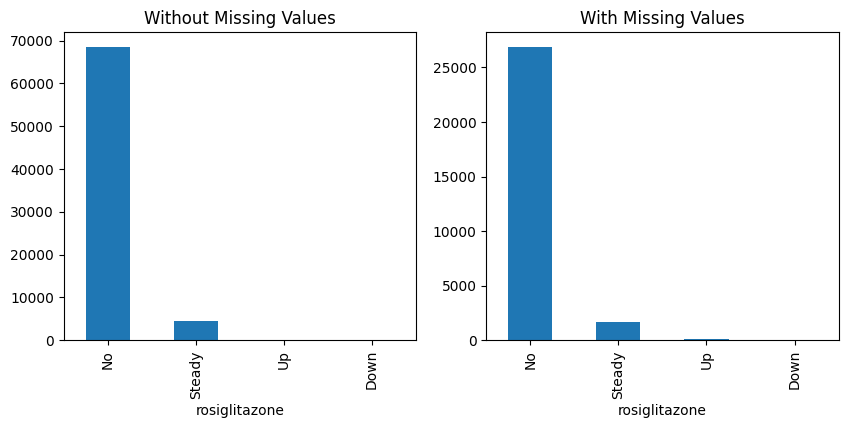

p-value of Chi-squared test: 1.450208159959678e-13
The missingness in 'rosiglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


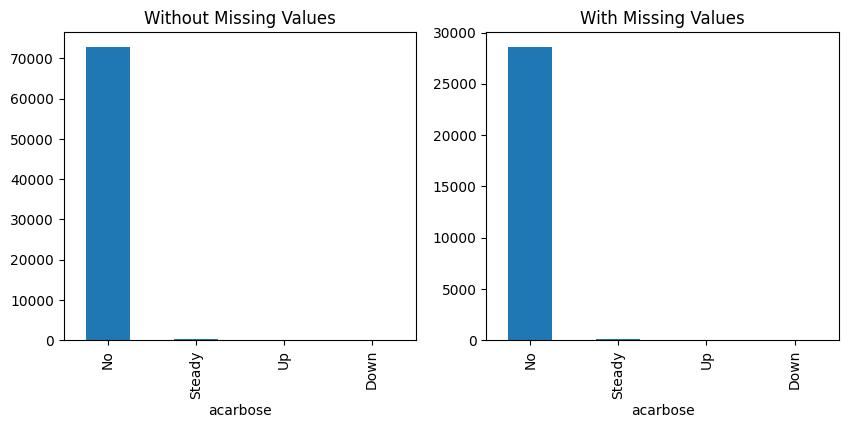

p-value of Chi-squared test: 0.157384302452171
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


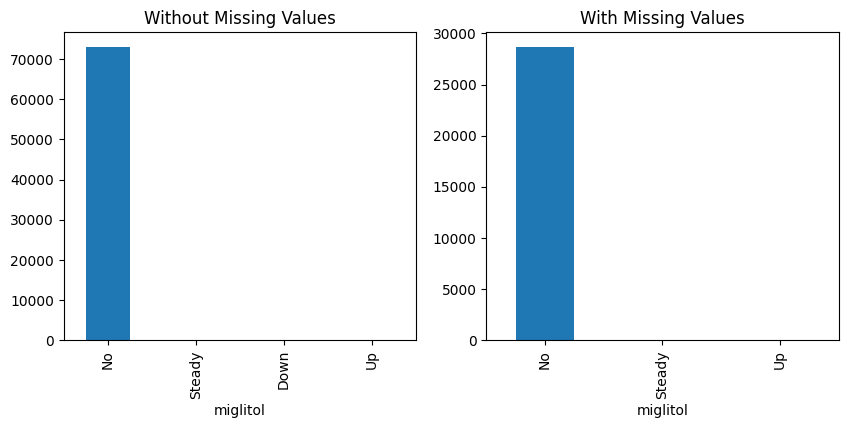

p-value of Chi-squared test: 0.4855572249166583
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


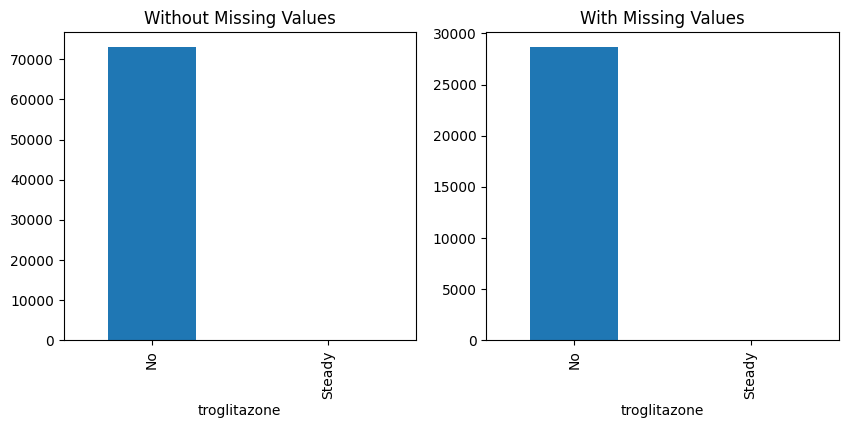

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


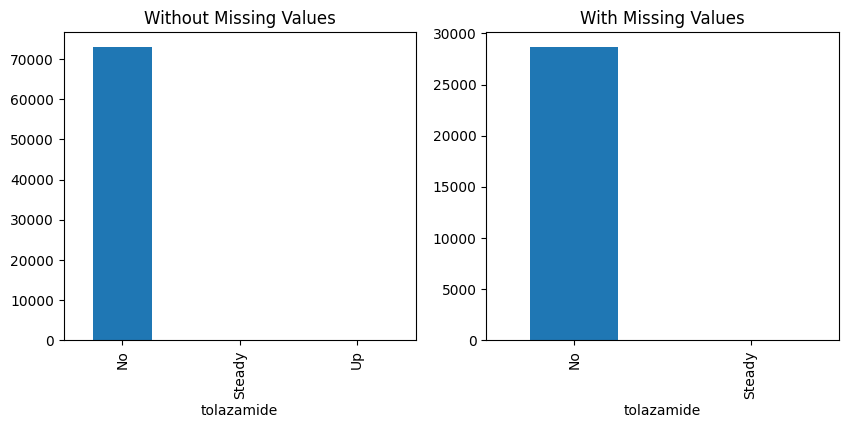

p-value of Chi-squared test: 0.8173687869044056
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


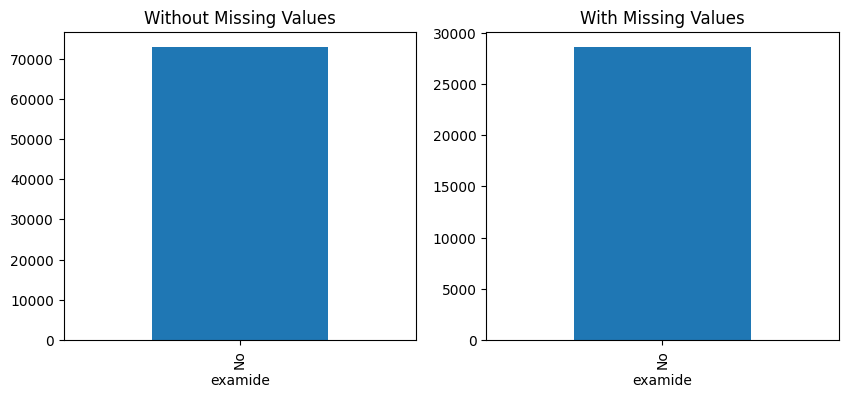

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


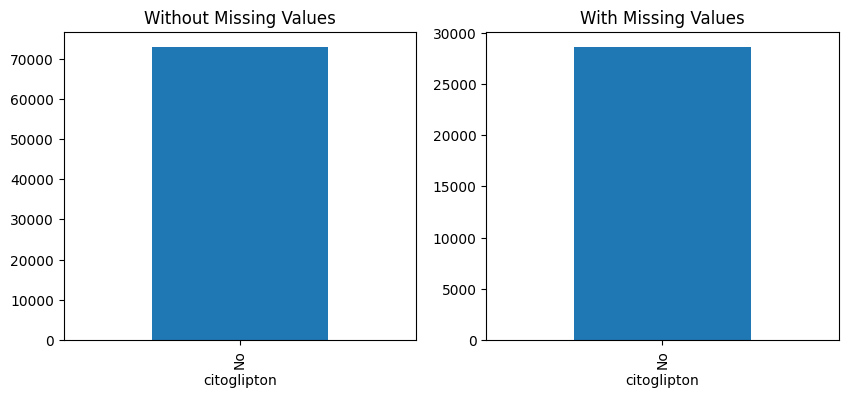

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:


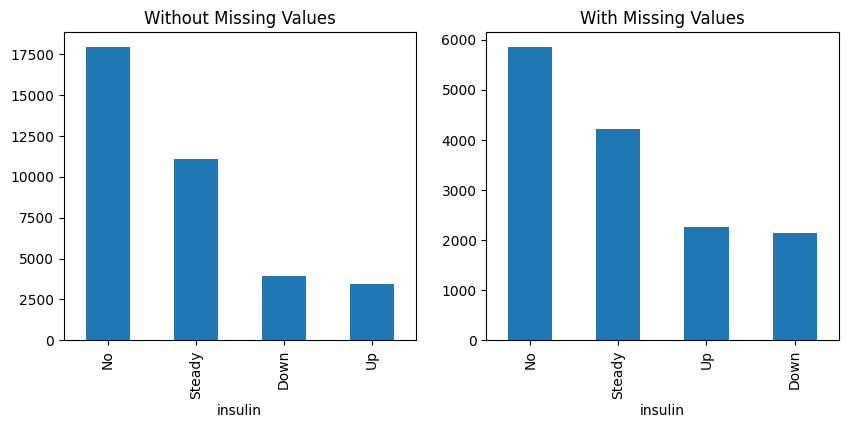

p-value of Chi-squared test: 1.9799957810181318e-144
The missingness in 'insulin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


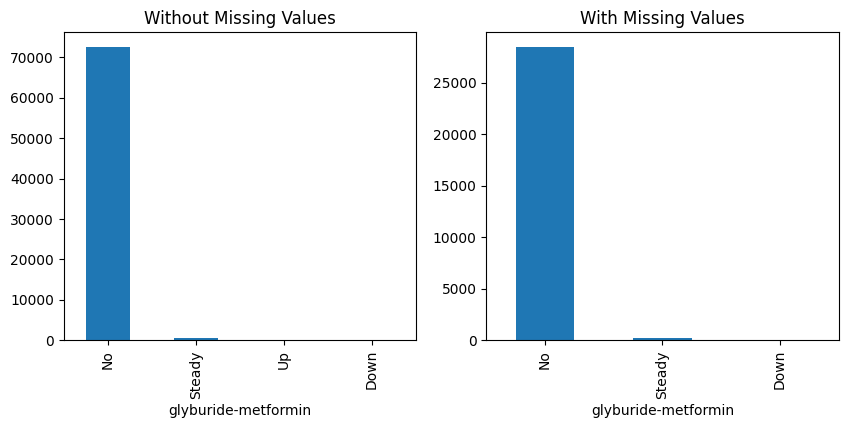

p-value of Chi-squared test: 0.18575072674402496
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


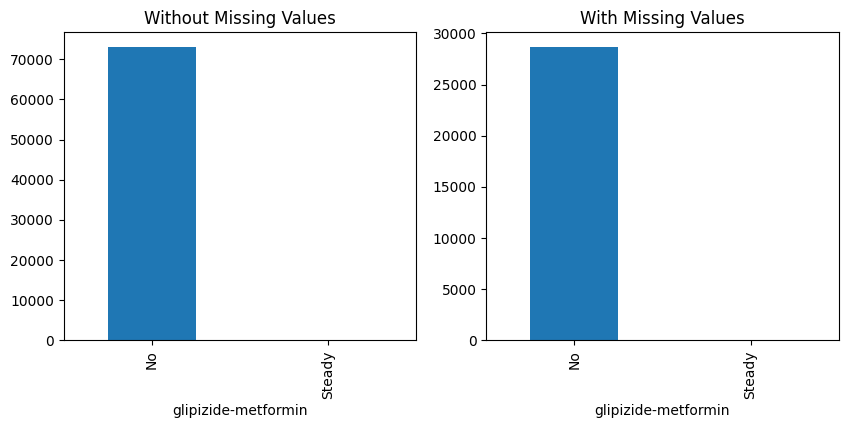

p-value of Chi-squared test: 0.6066030456765656
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


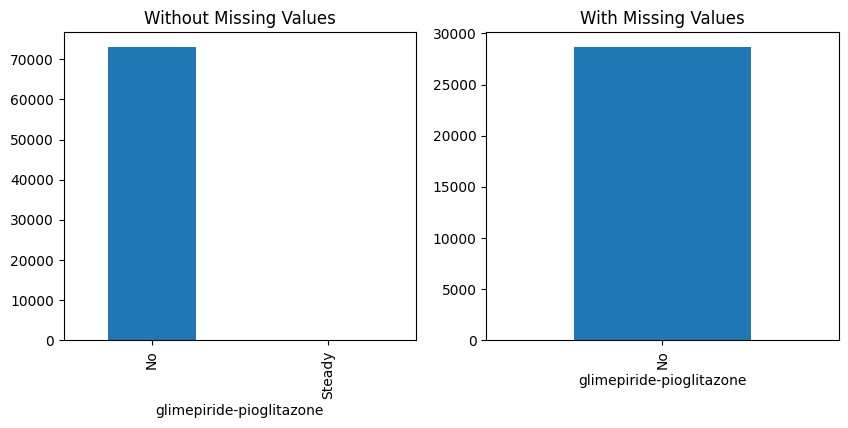

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


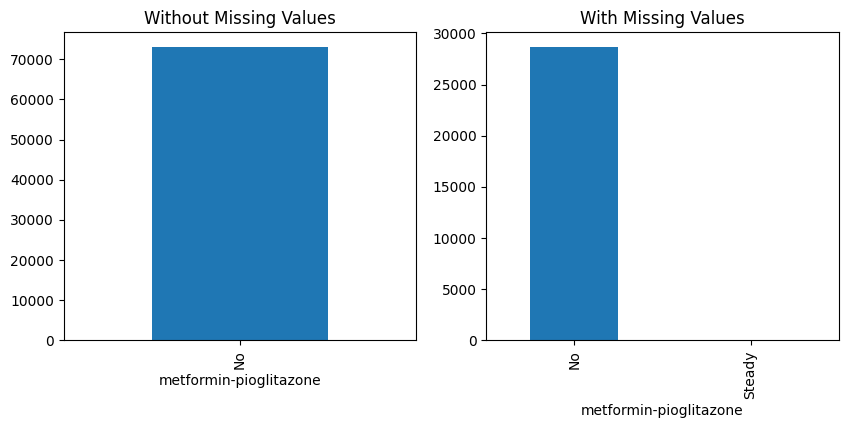

p-value of Chi-squared test: 0.6278568594144229
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


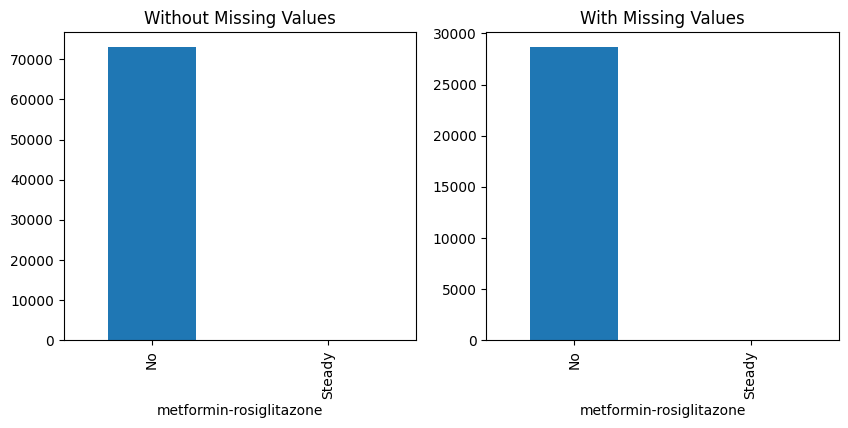

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


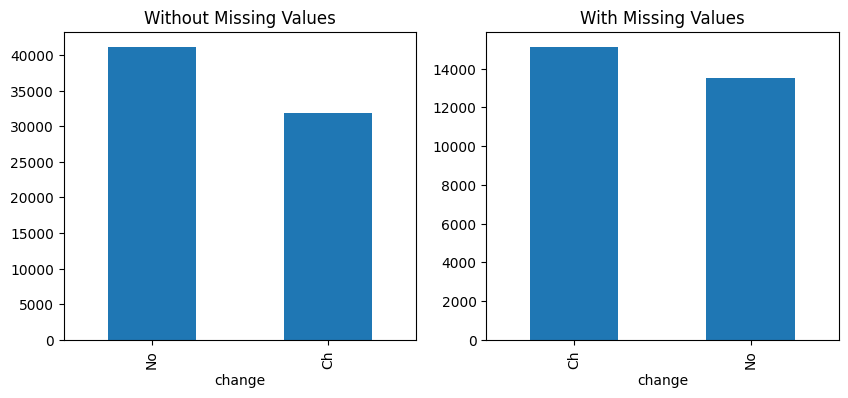

p-value of Chi-squared test: 6.730755246288683e-154
The missingness in 'change' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


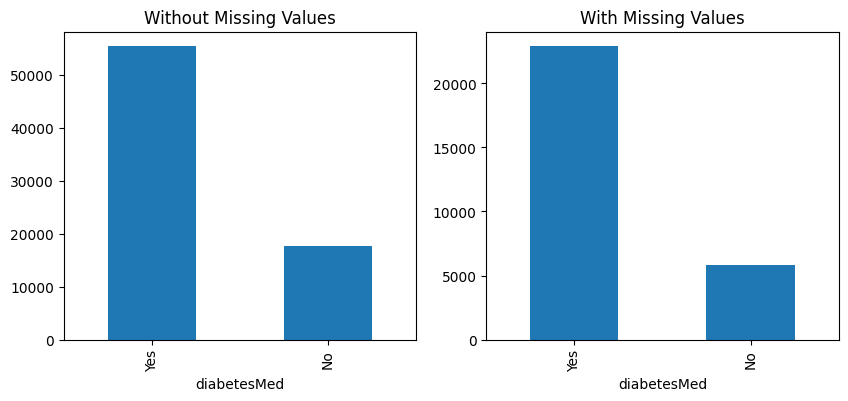

p-value of Chi-squared test: 4.9772668151369515e-40
The missingness in 'diabetesMed' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


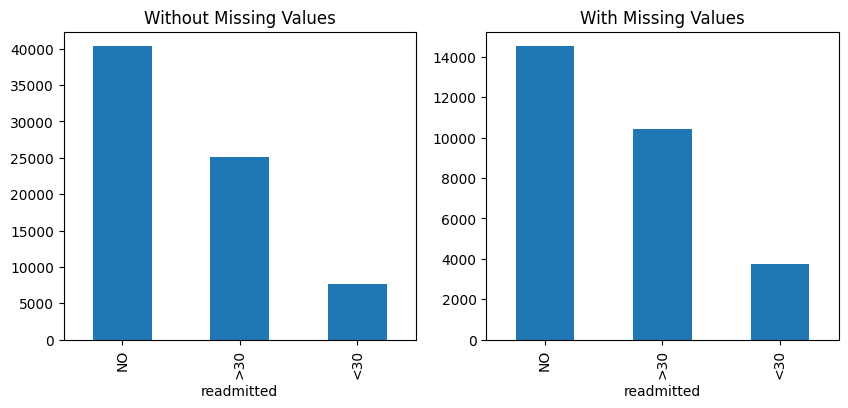

p-value of Chi-squared test: 5.577522994239756e-51
The missingness in 'readmitted' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.number_outpatient.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### After going through this we can say the missing value for num_procedures is MAR type because if the time in hospital is greater than 5 we see more missing values

## Detecting Missing type for diag_1

Diagnosis Analysis of Missing Values for time_in_hospital:


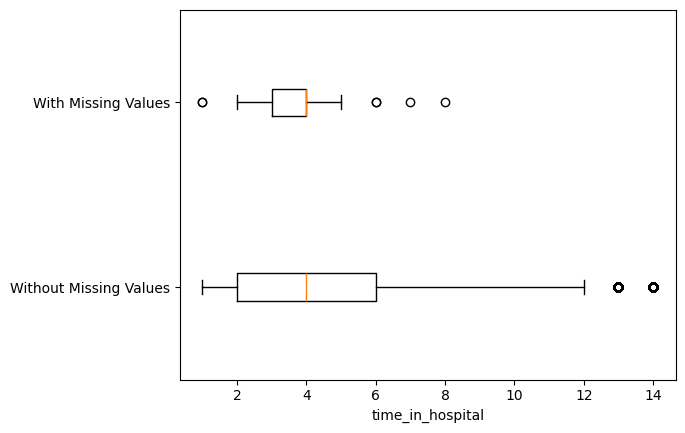

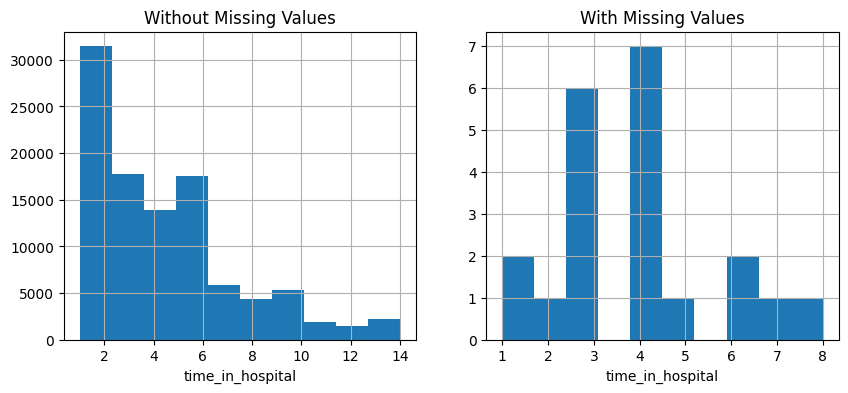

p-value of t-test: 0.45074398718656195
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


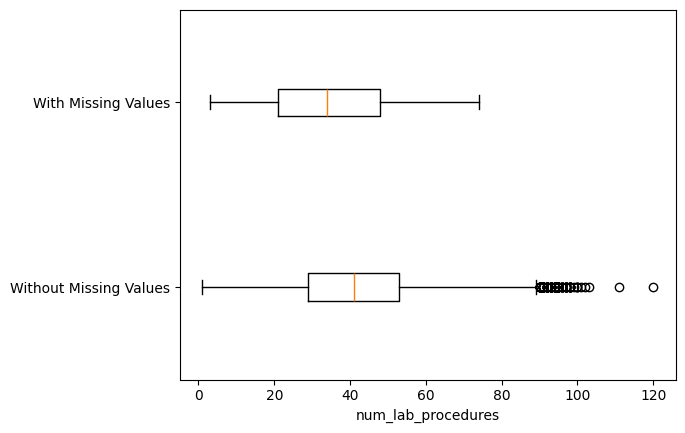

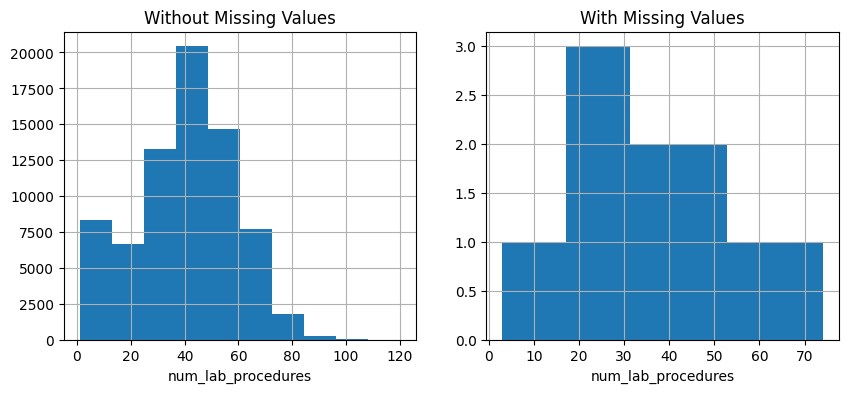

p-value of t-test: 0.41190126784692715
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


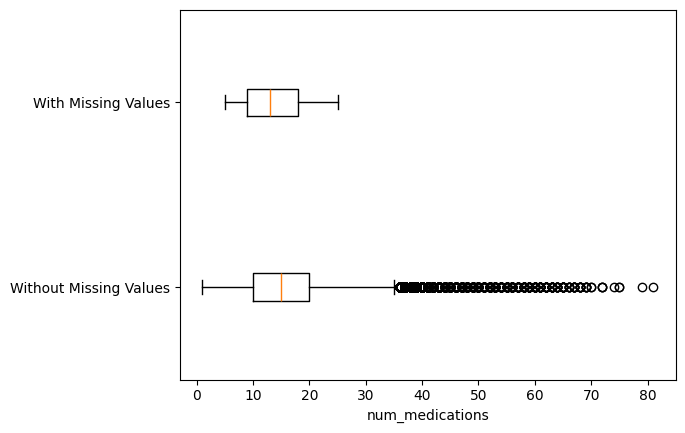

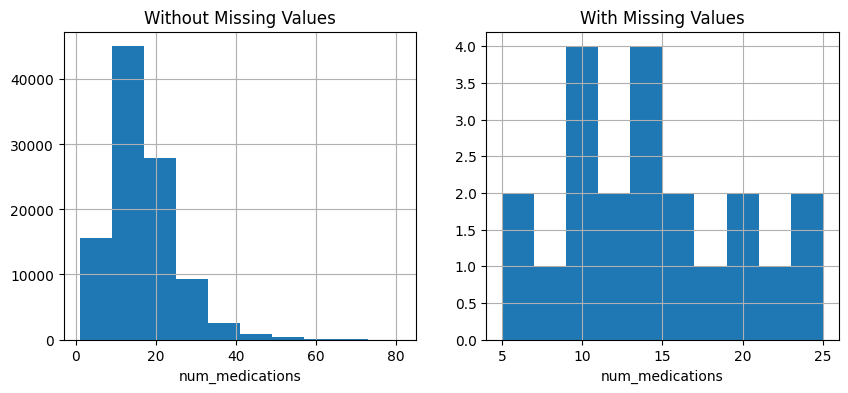

p-value of t-test: 0.2432330864827508
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


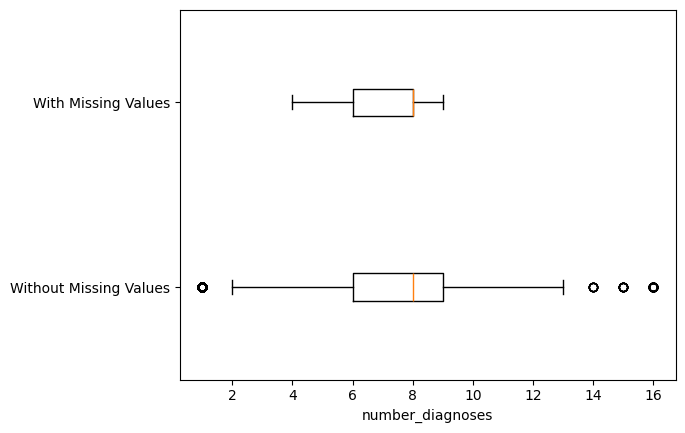

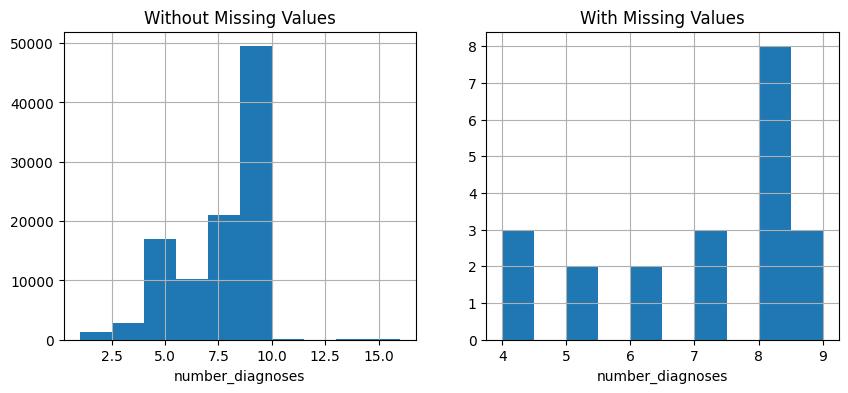

p-value of t-test: 0.26505120125023635
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


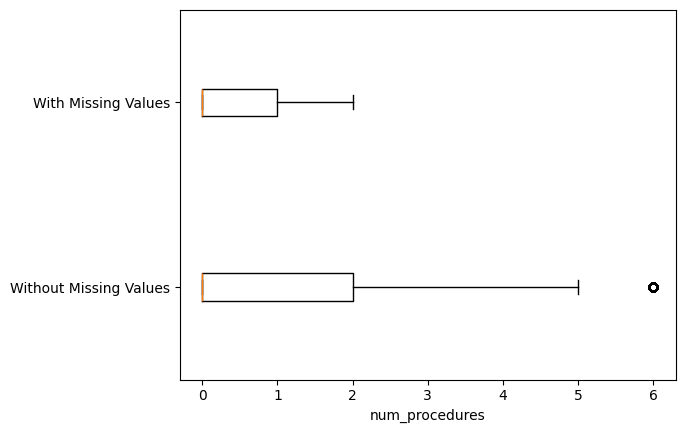

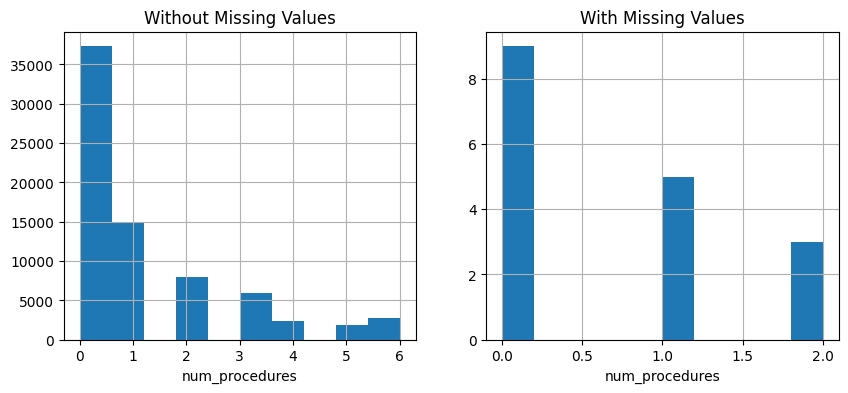

p-value of t-test: 0.1955665645884299
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


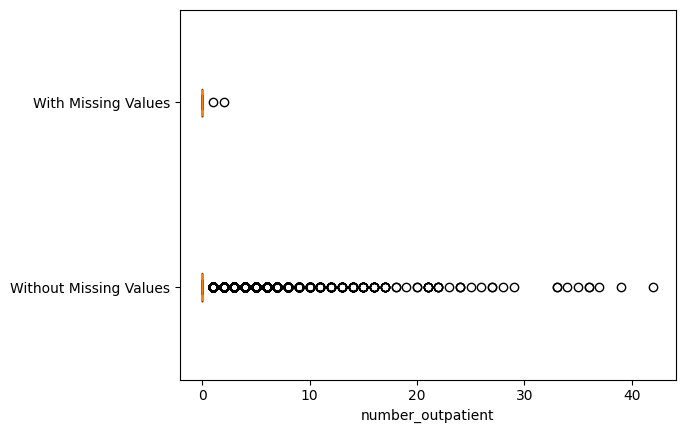

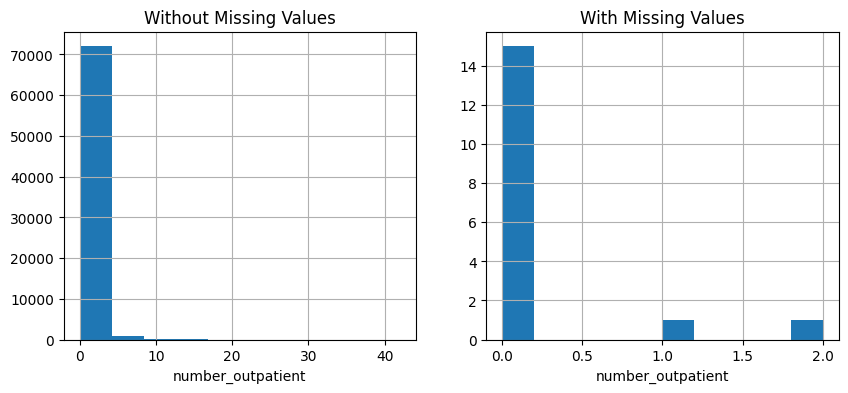

p-value of t-test: 0.5124486921801084
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


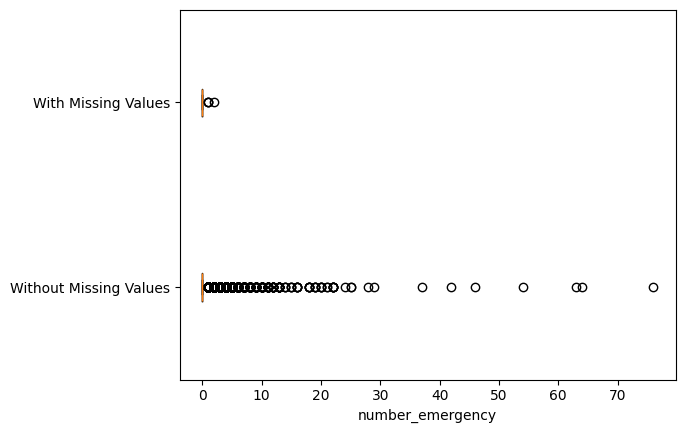

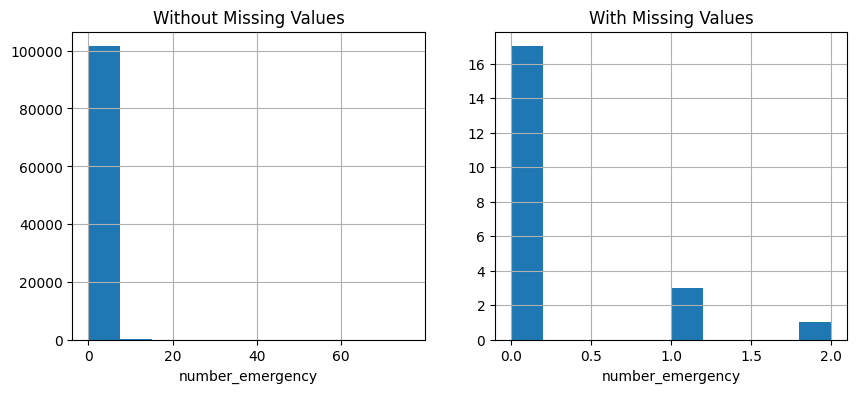

p-value of t-test: 0.8428144904401973
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


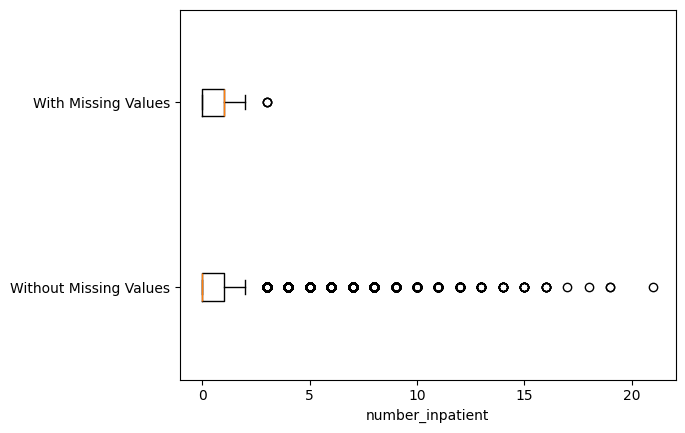

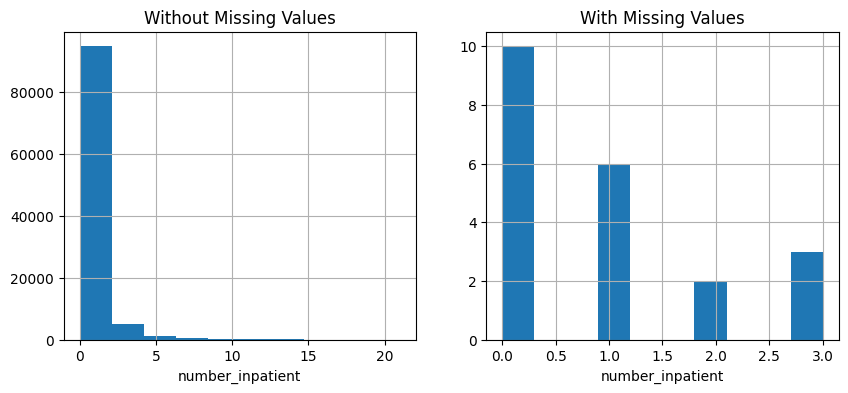

p-value of t-test: 0.3286025900483418
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.diag_1.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:


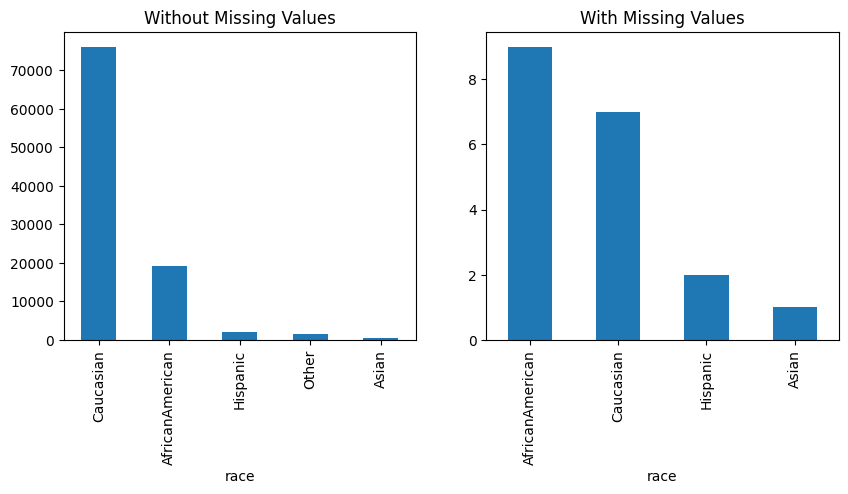

p-value of Chi-squared test: 5.2490650749405074e-05
The missingness in 'race' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


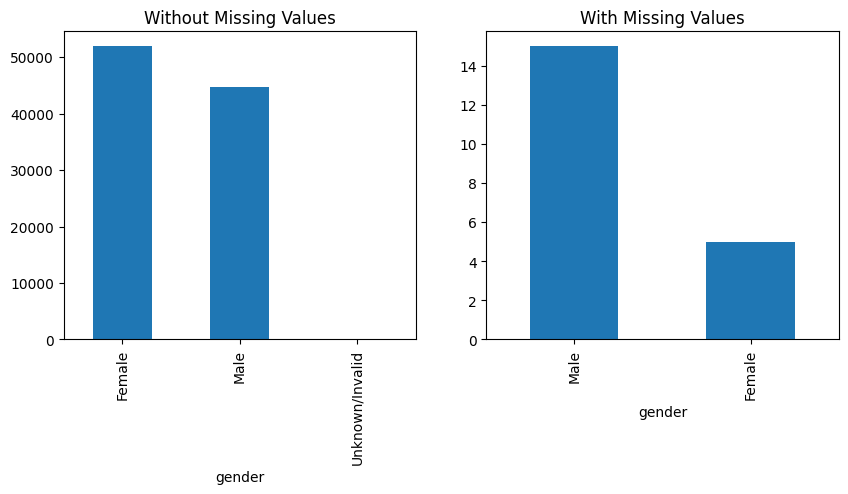

p-value of Chi-squared test: 0.036041527810930535
The missingness in 'gender' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


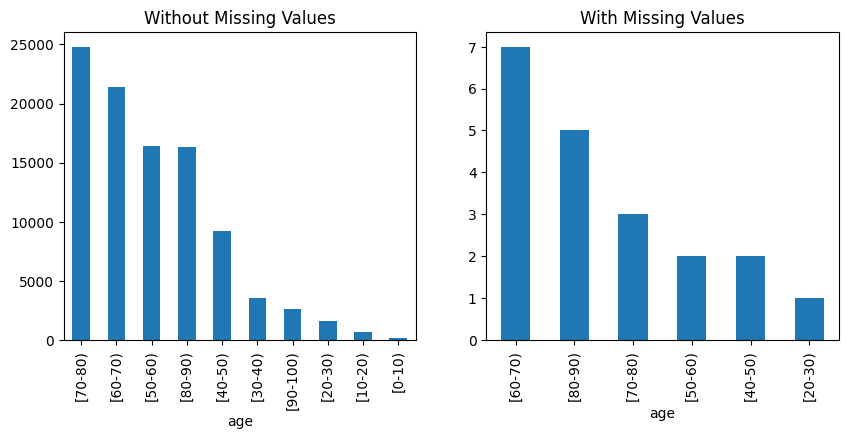

p-value of Chi-squared test: 0.6792374003742188
The missingness in 'age' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:
No data for group: With Missing Values


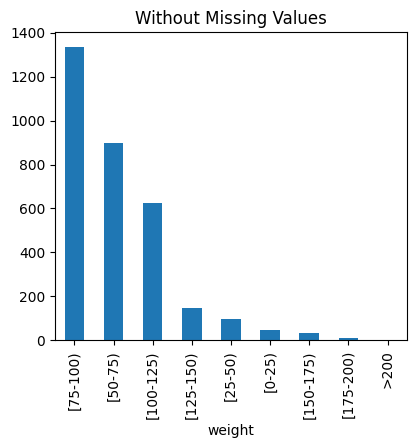

p-value of Chi-squared test: 1.0
The missingness in 'weight' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


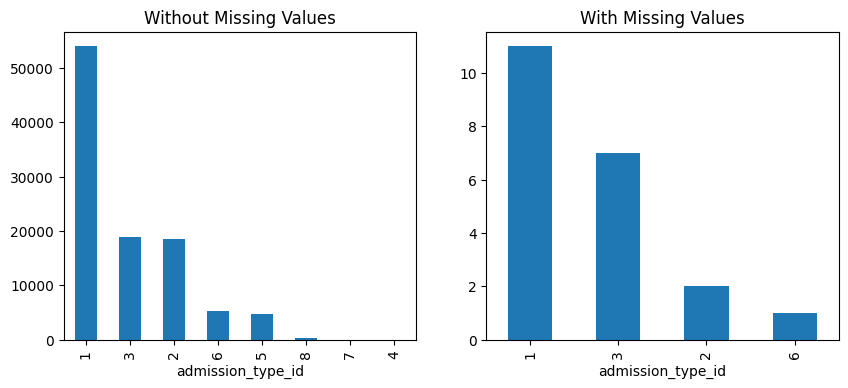

p-value of Chi-squared test: 0.7314410943634123
The missingness in 'admission_type_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:
No data for group: With Missing Values


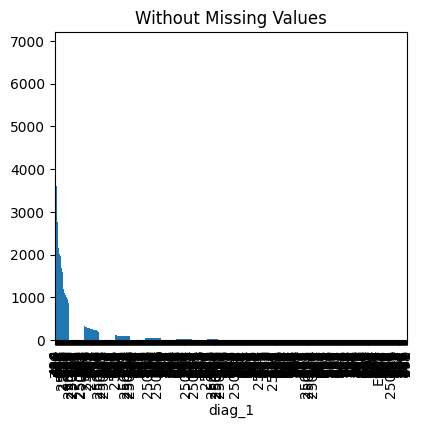

p-value of Chi-squared test: 1.0
The missingness in 'diag_1' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


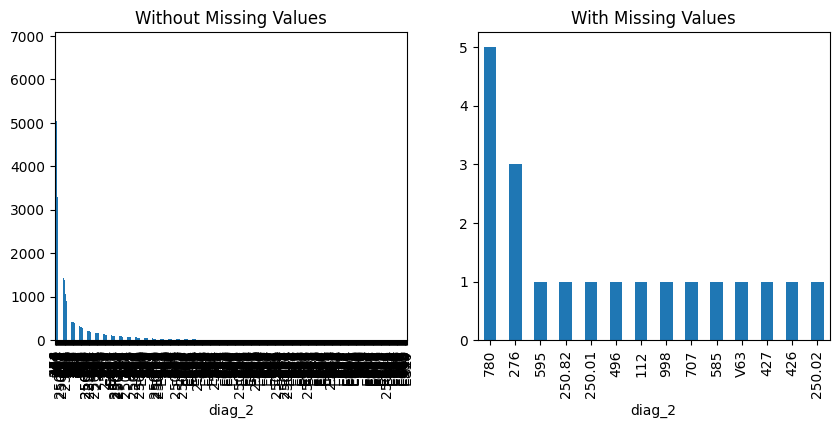

p-value of Chi-squared test: 1.0
The missingness in 'diag_2' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


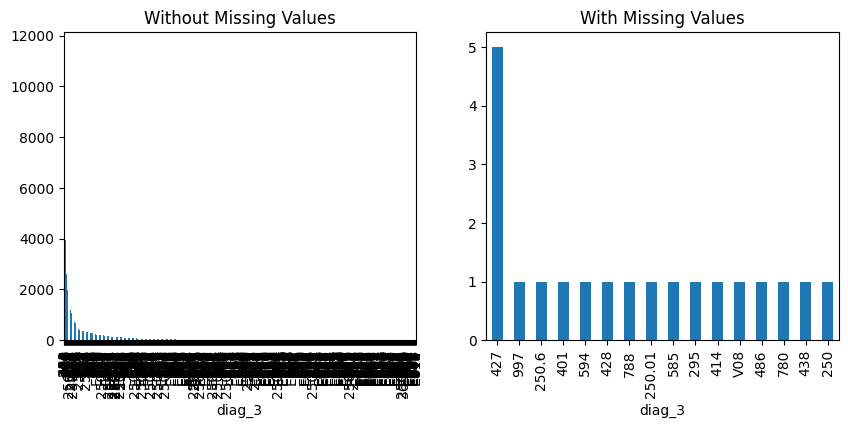

p-value of Chi-squared test: 0.0004909177187276059
The missingness in 'diag_3' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


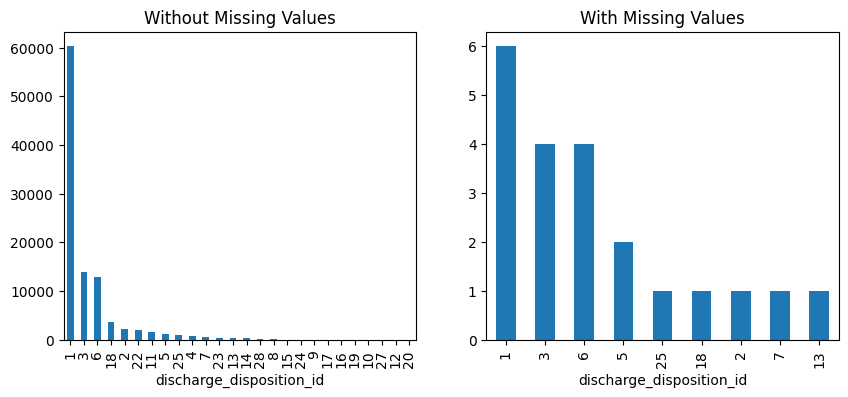

p-value of Chi-squared test: 0.04366765415747362
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


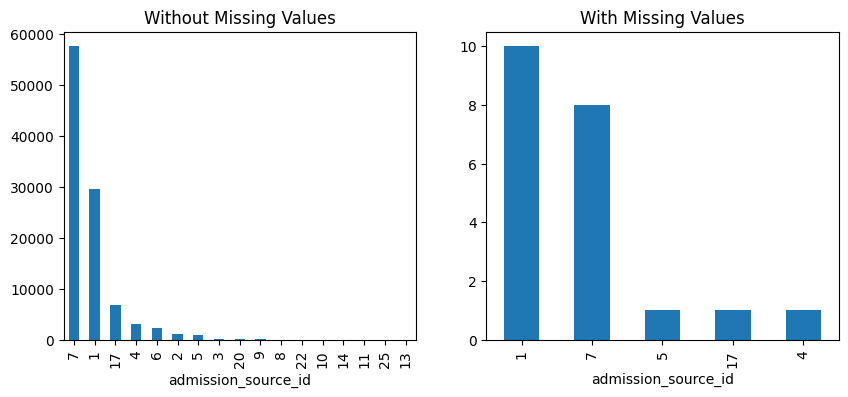

p-value of Chi-squared test: 0.9256212057055785
The missingness in 'admission_source_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


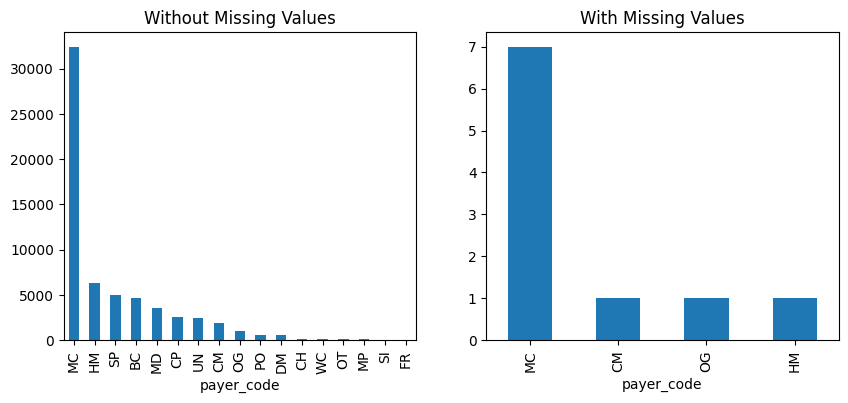

p-value of Chi-squared test: 0.8958844770098371
The missingness in 'payer_code' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


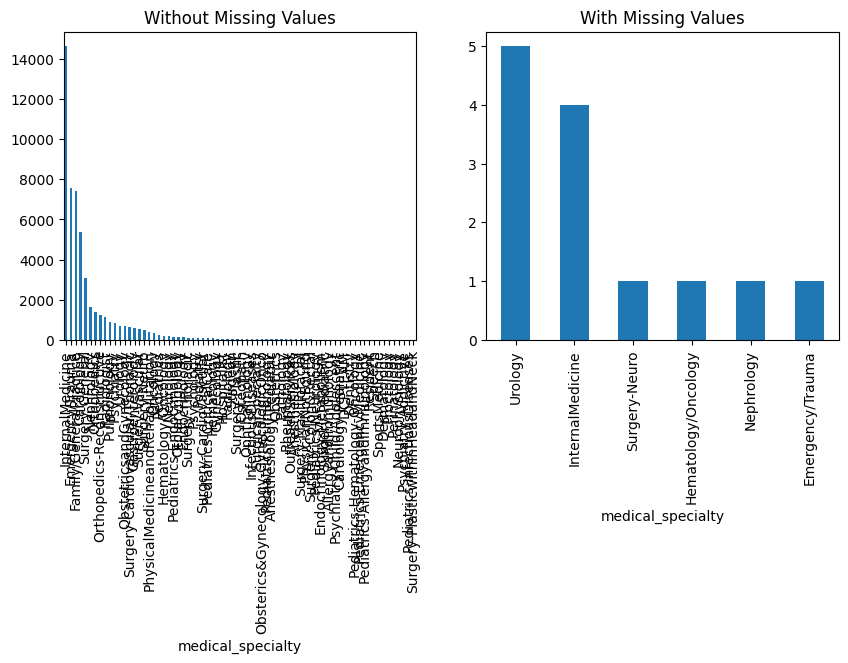

p-value of Chi-squared test: 8.641797473380354e-10
The missingness in 'medical_specialty' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


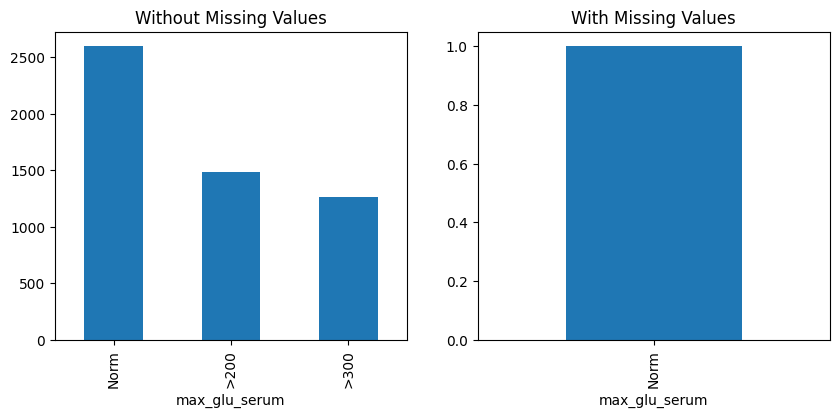

p-value of Chi-squared test: 0.5889797027231374
The missingness in 'max_glu_serum' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


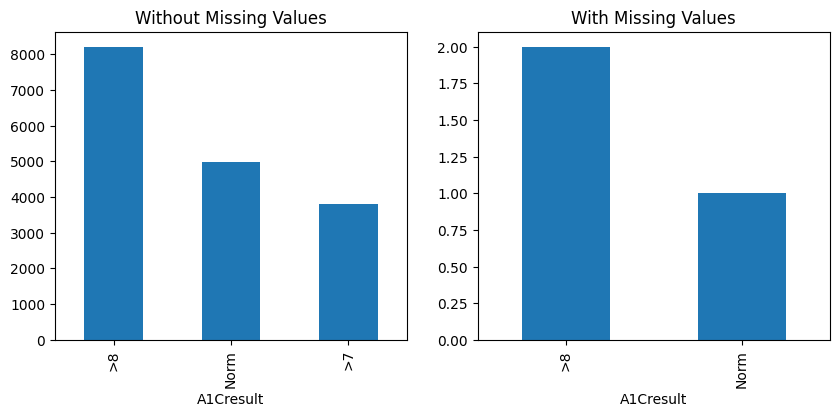

p-value of Chi-squared test: 0.638032842438614
The missingness in 'A1Cresult' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


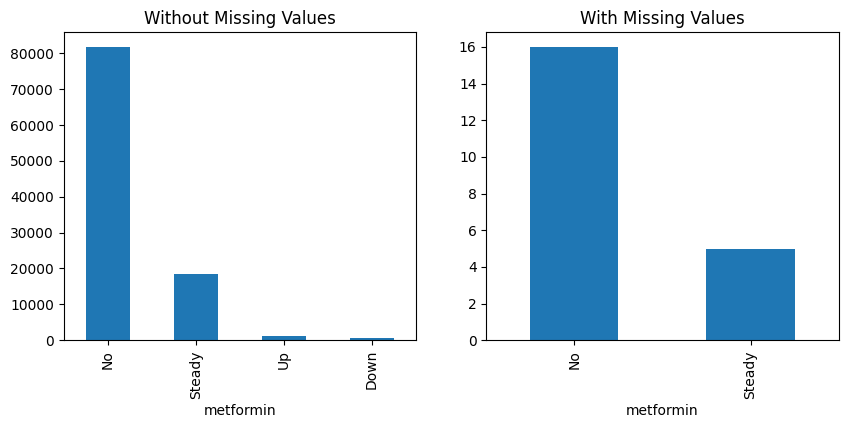

p-value of Chi-squared test: 0.8557170146640316
The missingness in 'metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


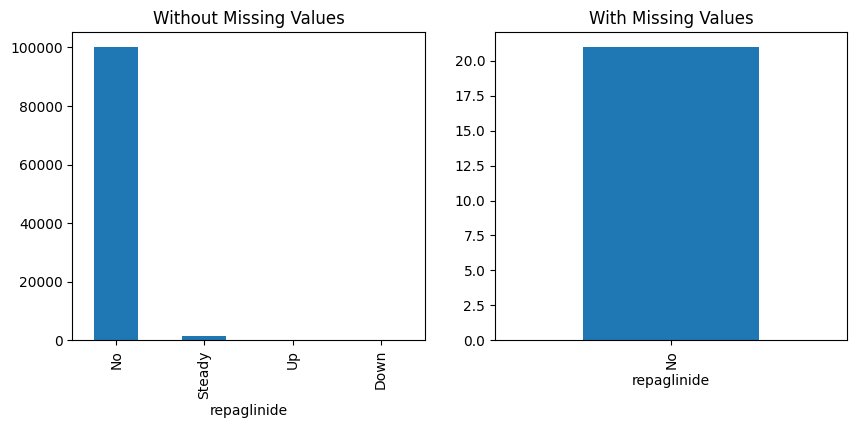

p-value of Chi-squared test: 0.9557380186375941
The missingness in 'repaglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


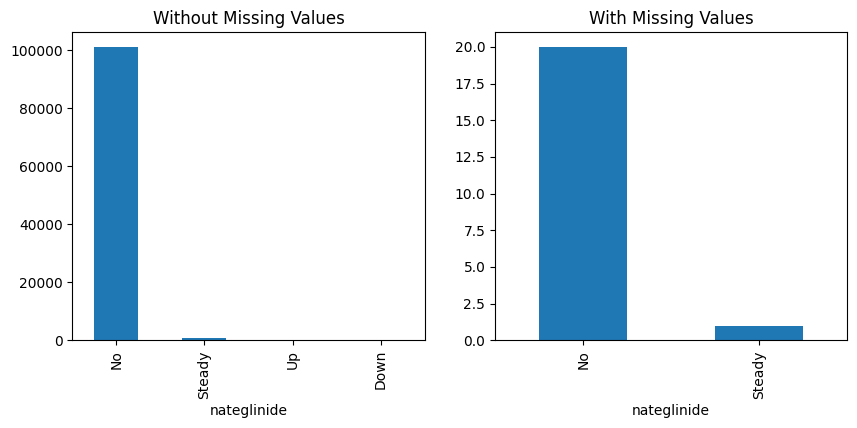

p-value of Chi-squared test: 0.14253372798051883
The missingness in 'nateglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


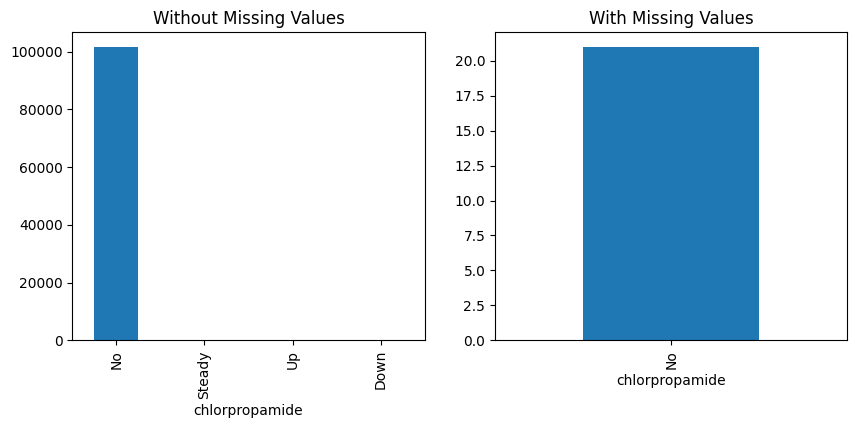

p-value of Chi-squared test: 0.9993735835854004
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


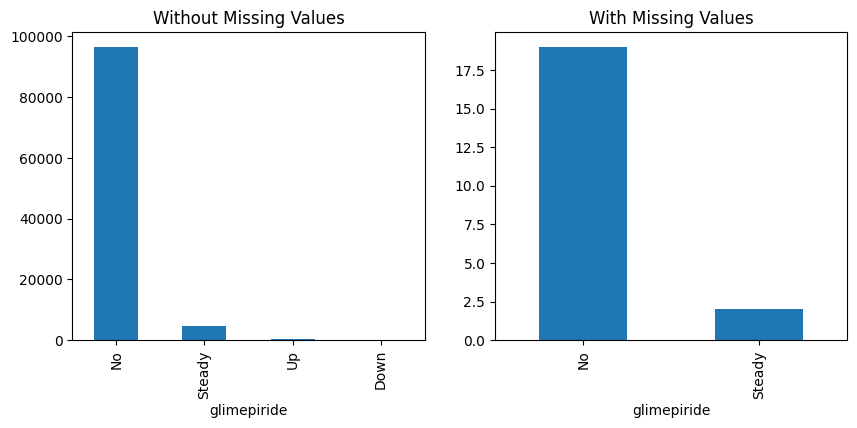

p-value of Chi-squared test: 0.7373432897707715
The missingness in 'glimepiride' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


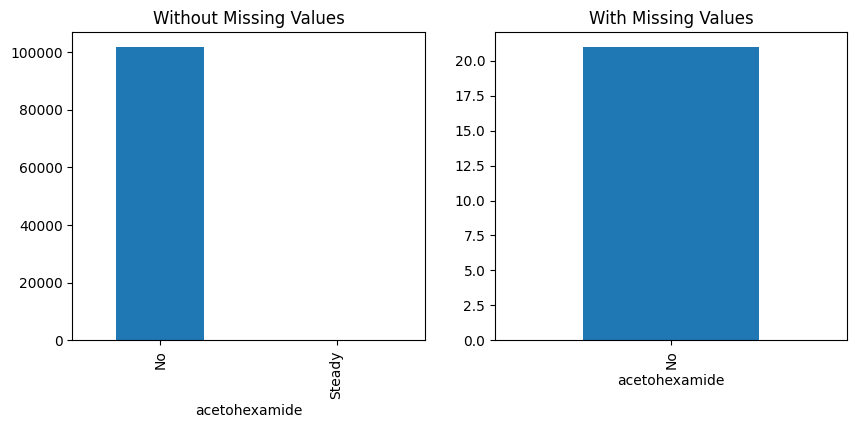

p-value of Chi-squared test: 1.0
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


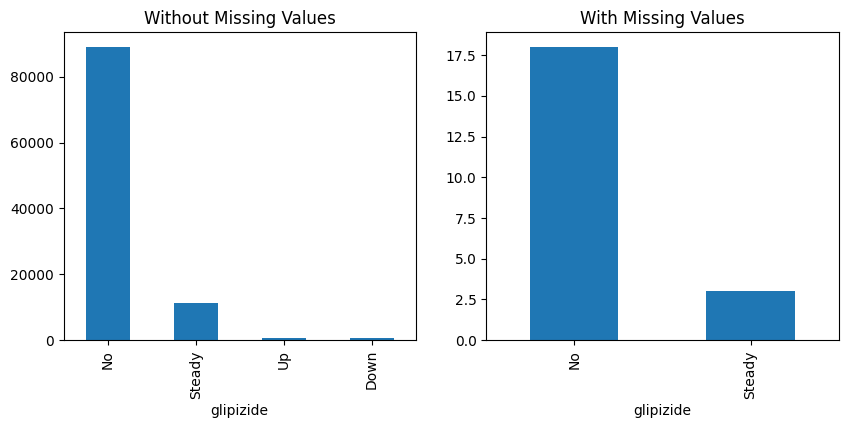

p-value of Chi-squared test: 0.926190616615718
The missingness in 'glipizide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


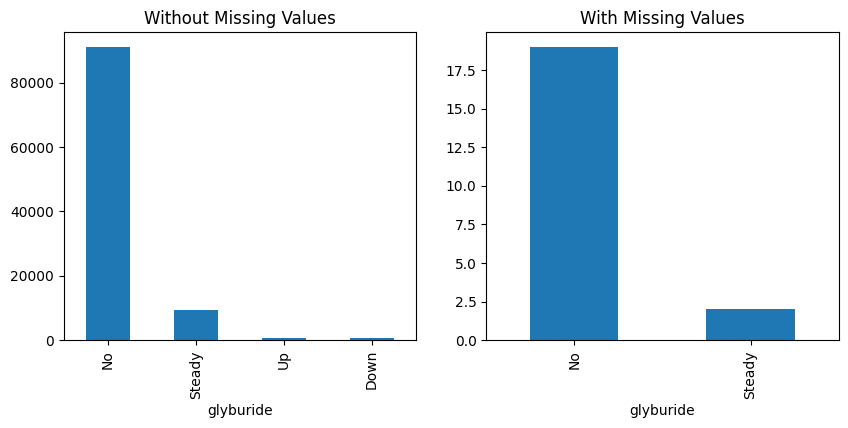

p-value of Chi-squared test: 0.9619033738392014
The missingness in 'glyburide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


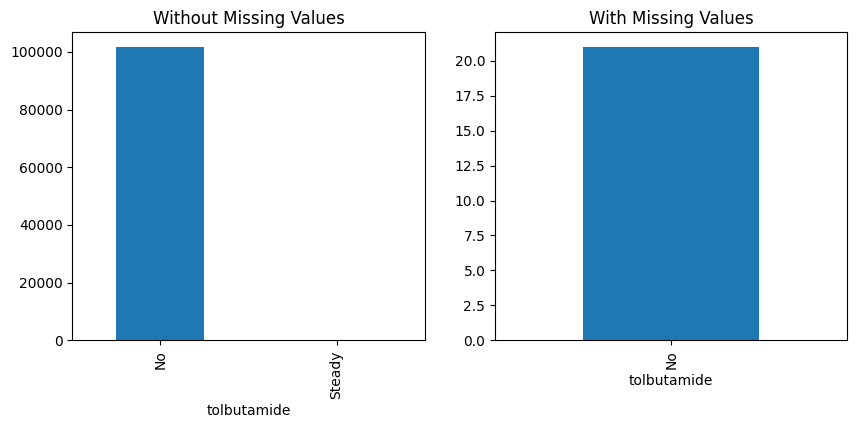

p-value of Chi-squared test: 1.0
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


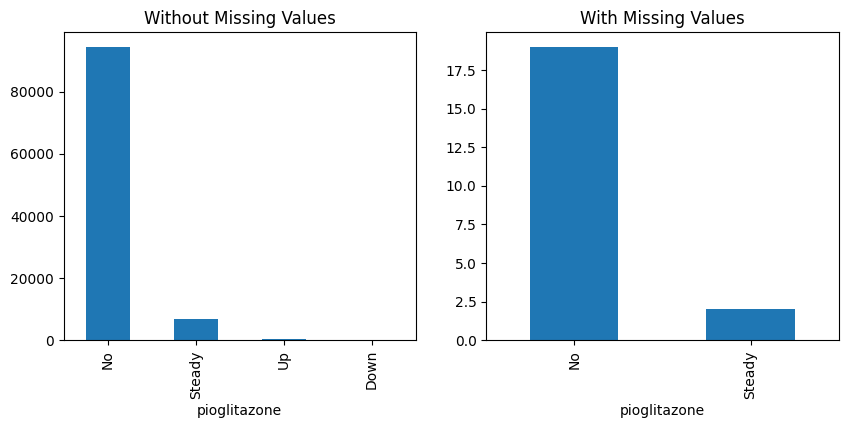

p-value of Chi-squared test: 0.9594408842512695
The missingness in 'pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


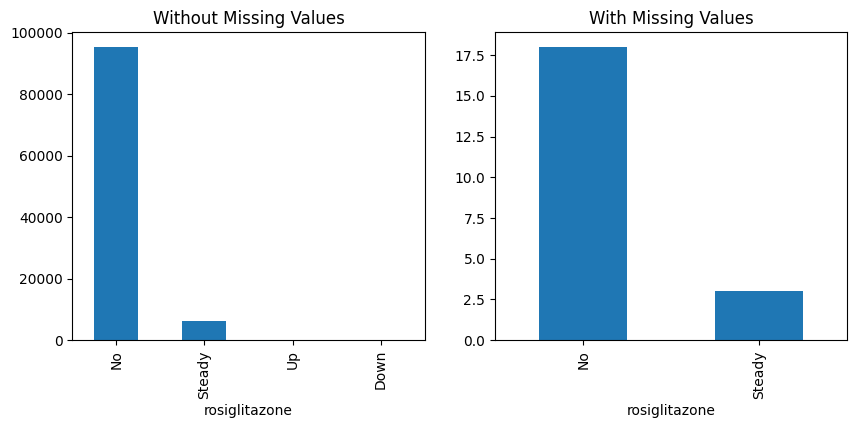

p-value of Chi-squared test: 0.45603368460349025
The missingness in 'rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


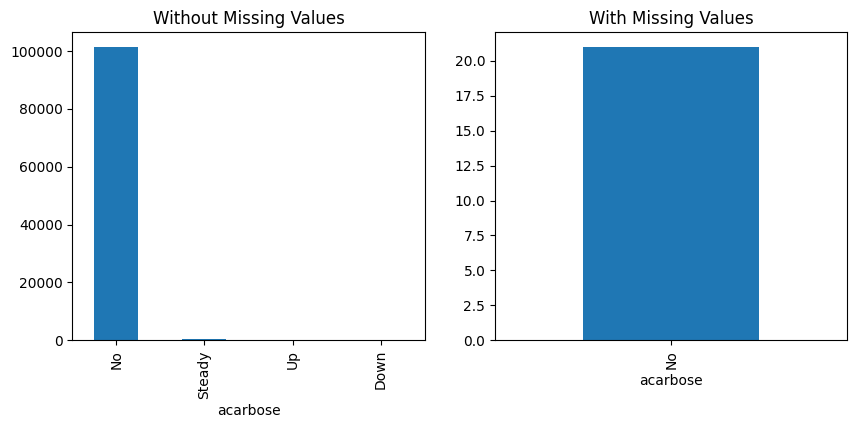

p-value of Chi-squared test: 0.9957986747296995
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


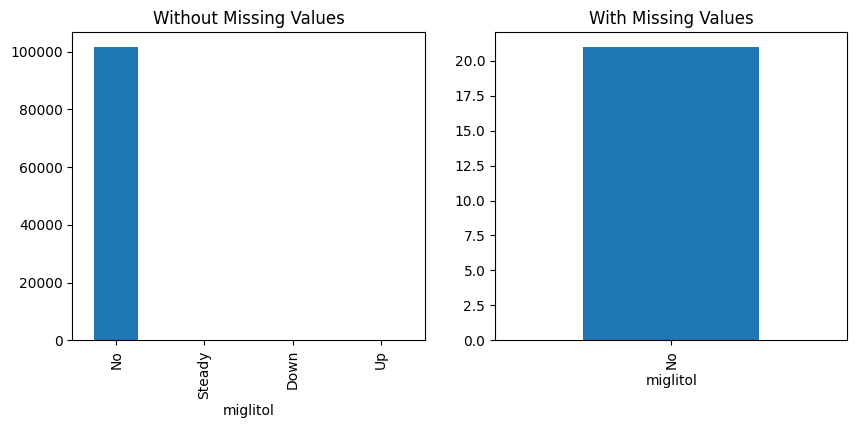

p-value of Chi-squared test: 0.9998155941029165
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


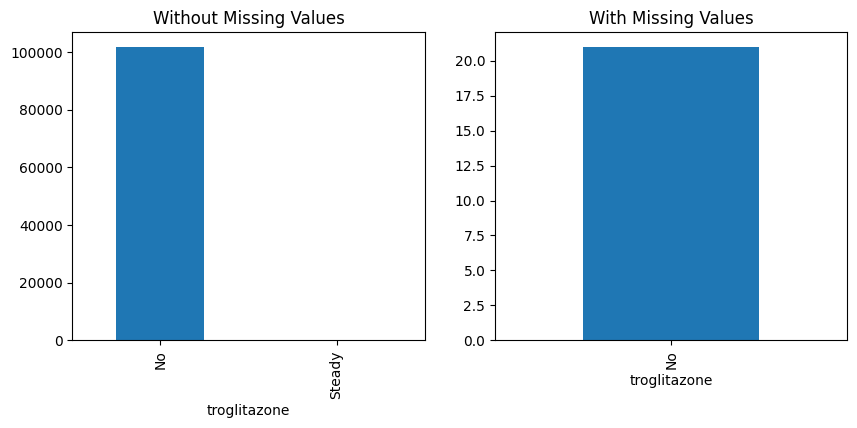

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


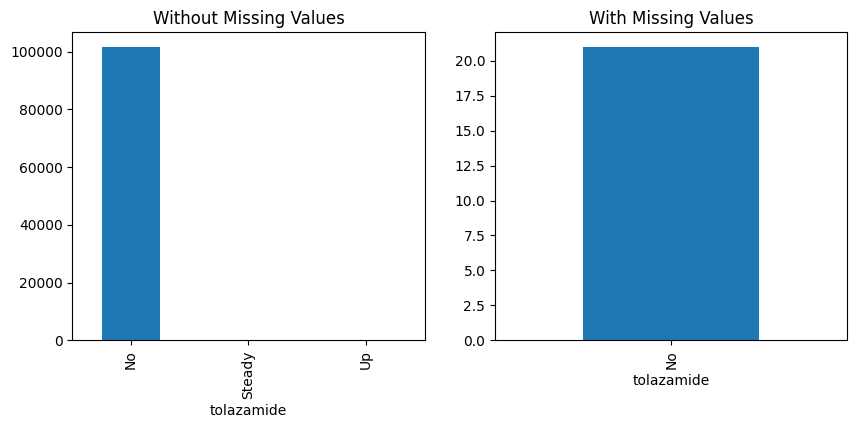

p-value of Chi-squared test: 0.9959817839082945
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


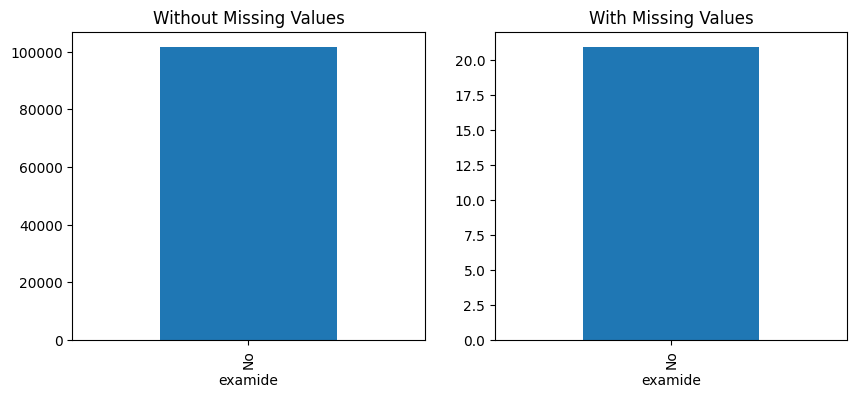

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


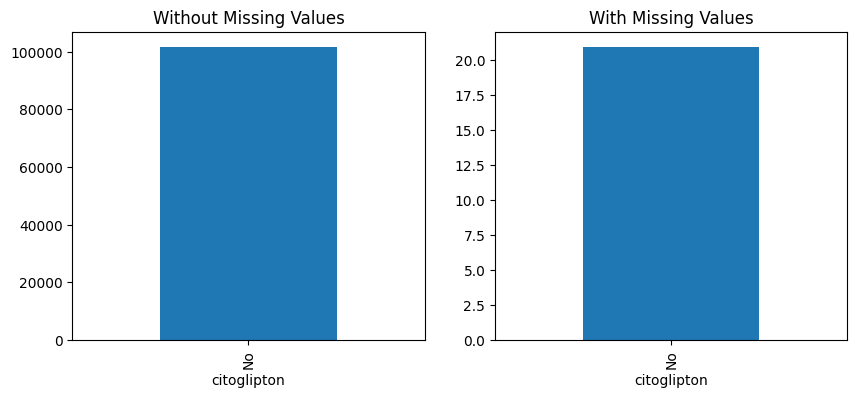

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:


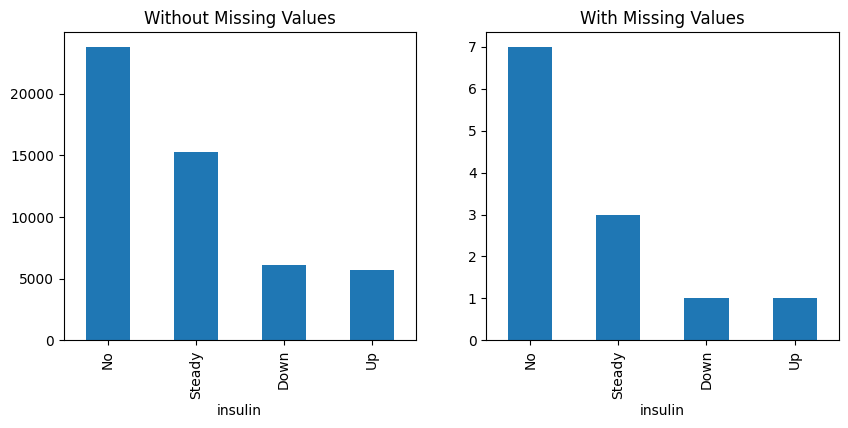

p-value of Chi-squared test: 0.8816130115703995
The missingness in 'insulin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


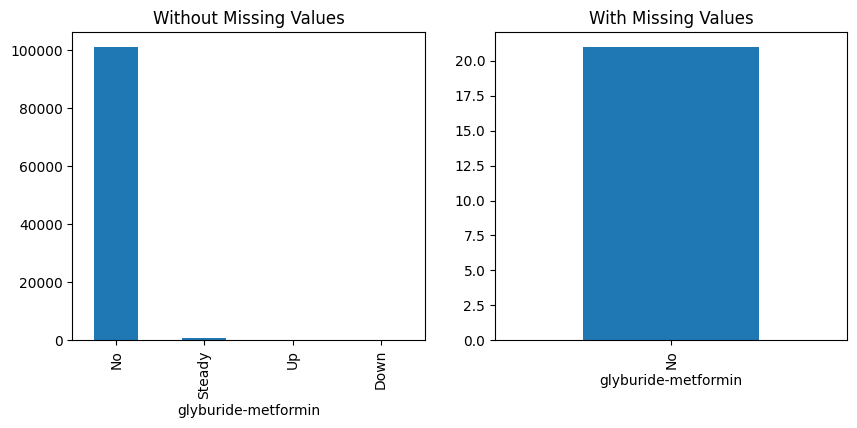

p-value of Chi-squared test: 0.9856918746145978
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


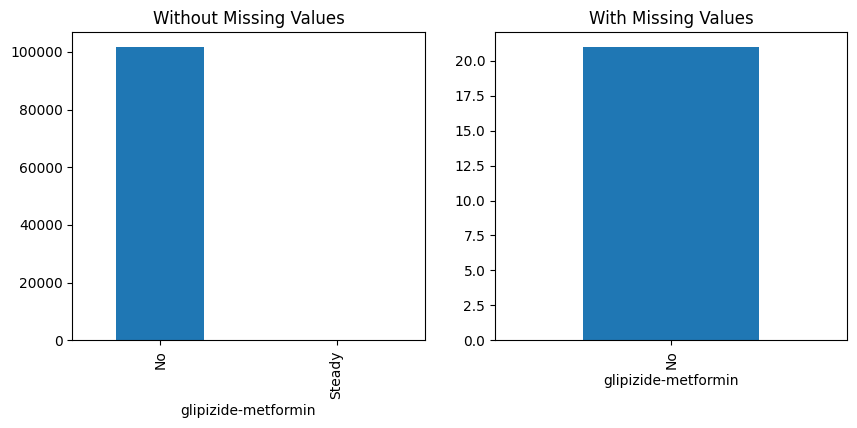

p-value of Chi-squared test: 1.0
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


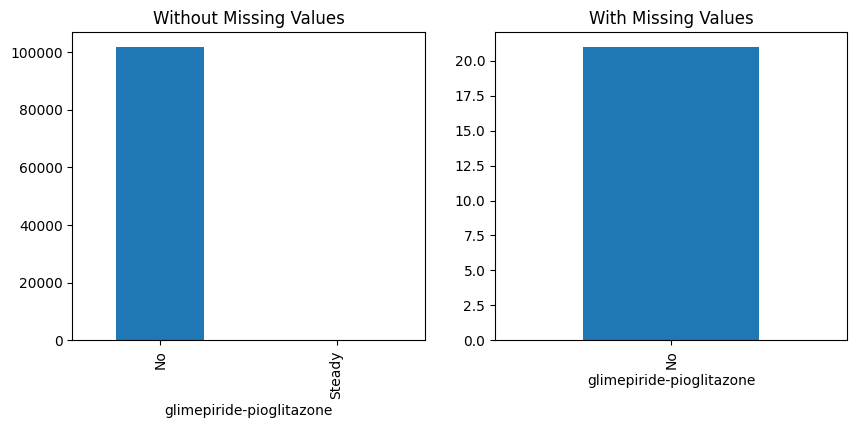

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


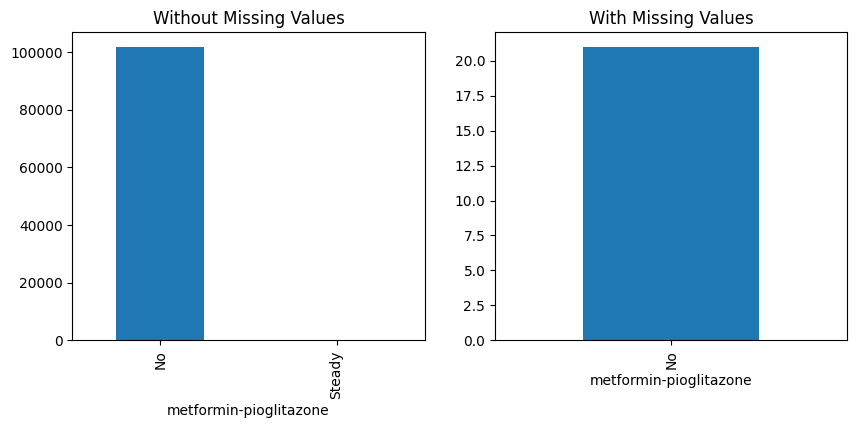

p-value of Chi-squared test: 1.0
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


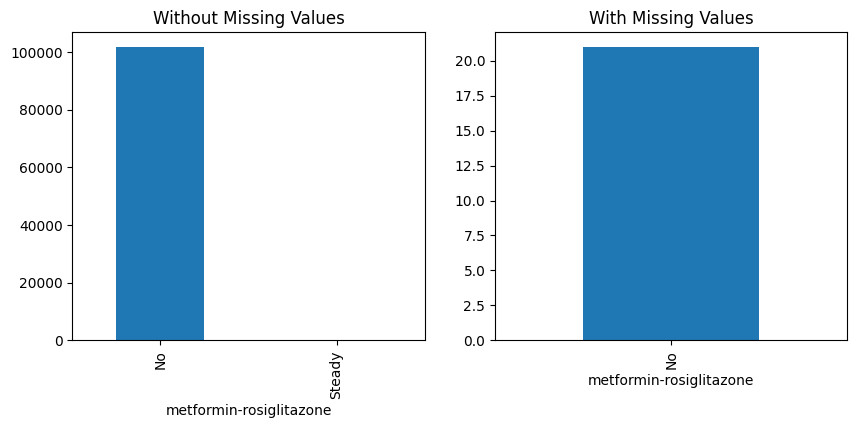

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


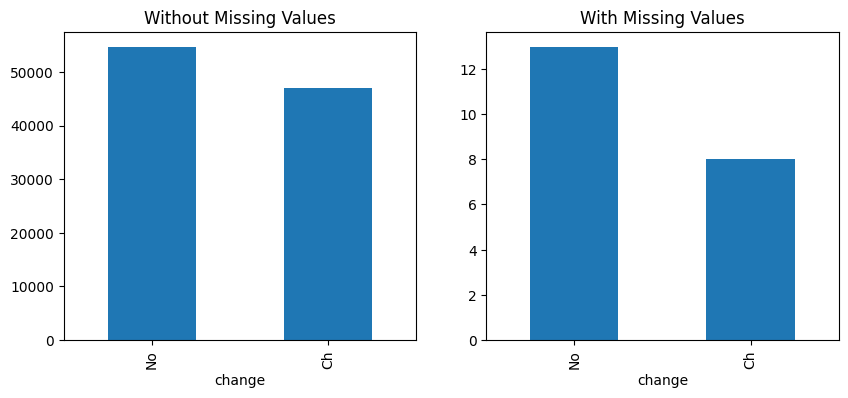

p-value of Chi-squared test: 0.5990732511705903
The missingness in 'change' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


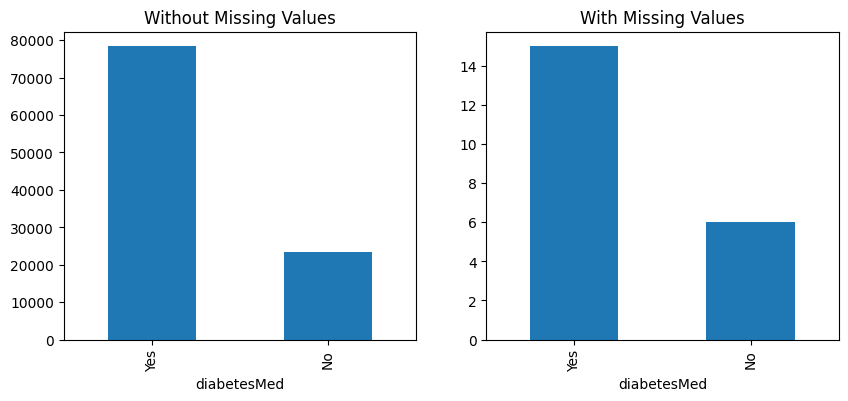

p-value of Chi-squared test: 0.7279801934951187
The missingness in 'diabetesMed' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


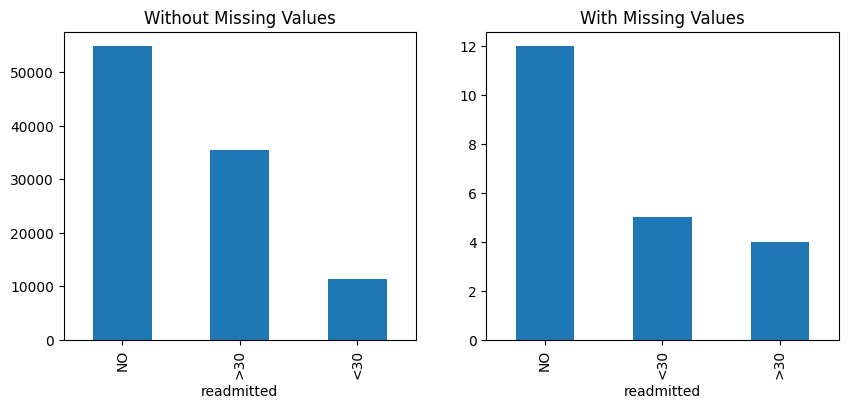

p-value of Chi-squared test: 0.10183105696537995
The missingness in 'readmitted' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.diag_1.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### After going through the analysis we can say `diag_1` is of MCAR

## Detecting Missing type for diag_2

Diagnosis Analysis of Missing Values for time_in_hospital:


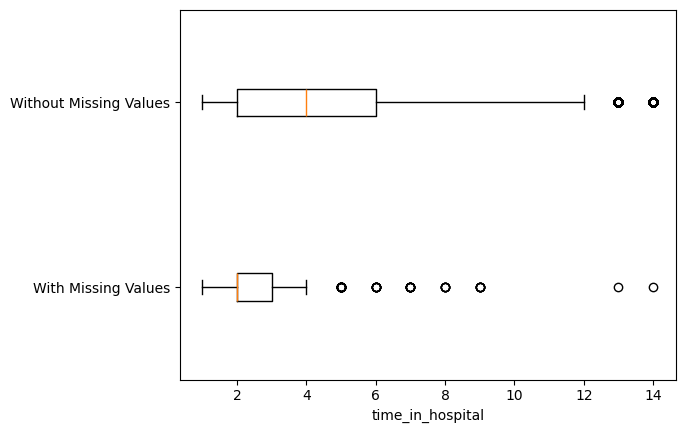

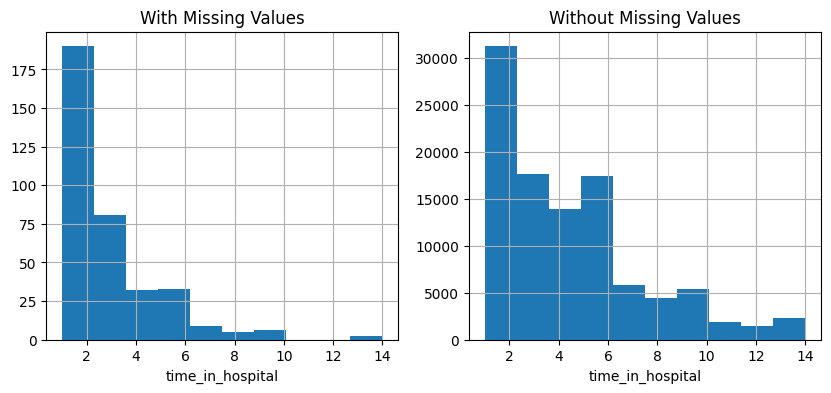

p-value of t-test: 3.596290638366817e-22
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


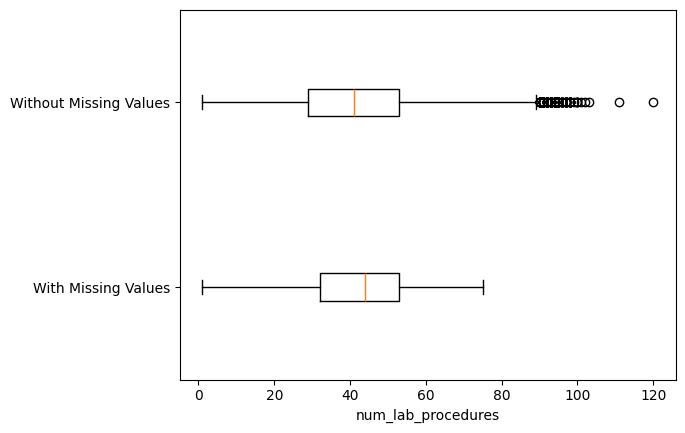

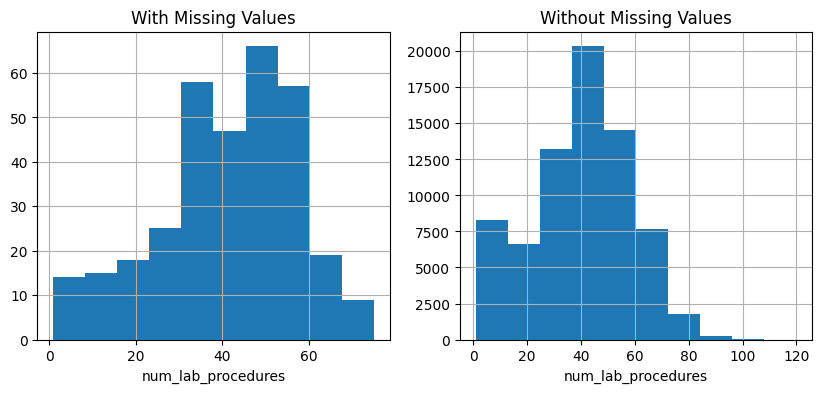

p-value of t-test: 0.22401189126196228
No significant difference between groups. Missing values might be random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


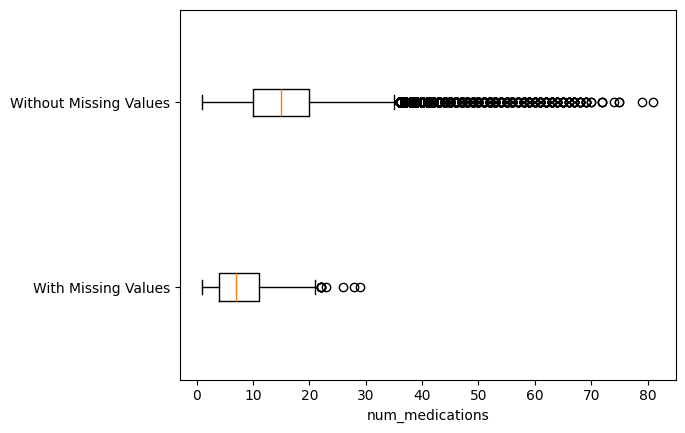

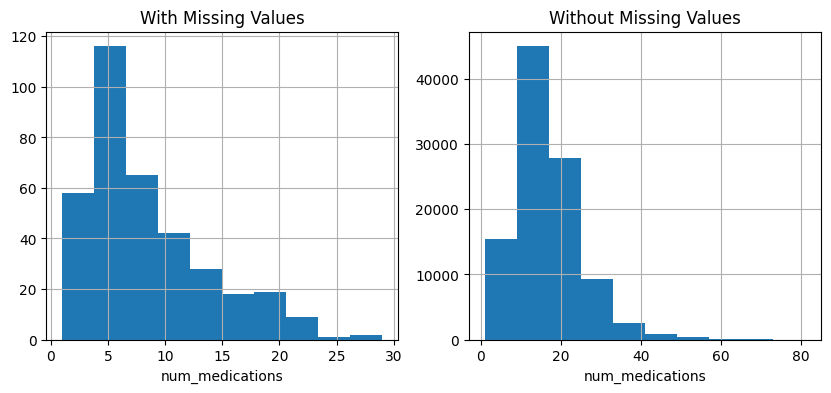

p-value of t-test: 1.6502900472141187e-71
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


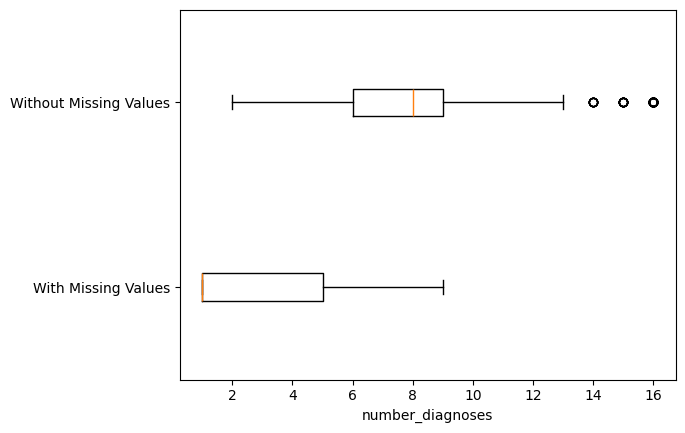

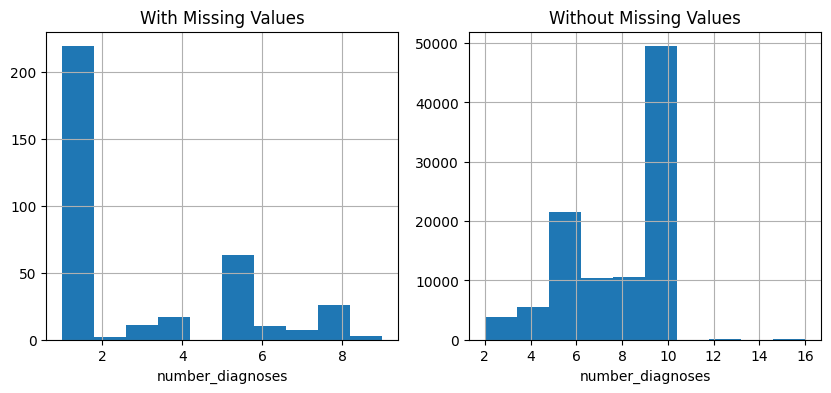

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


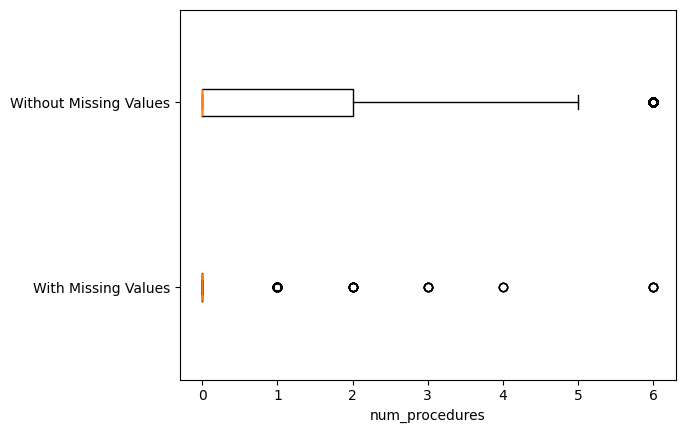

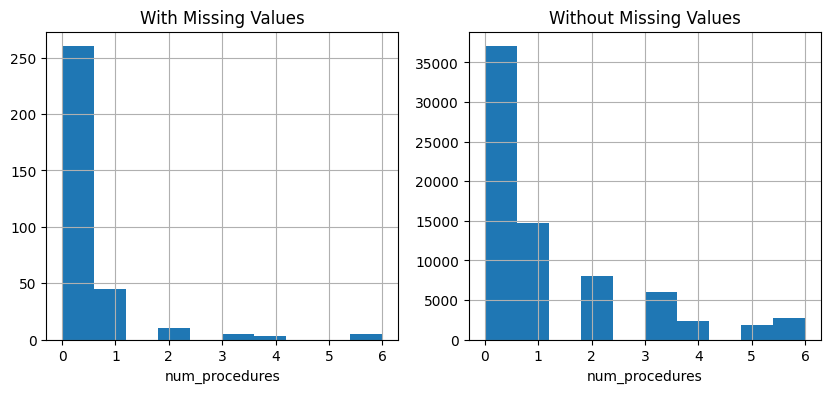

p-value of t-test: 1.1730444211320364e-18
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


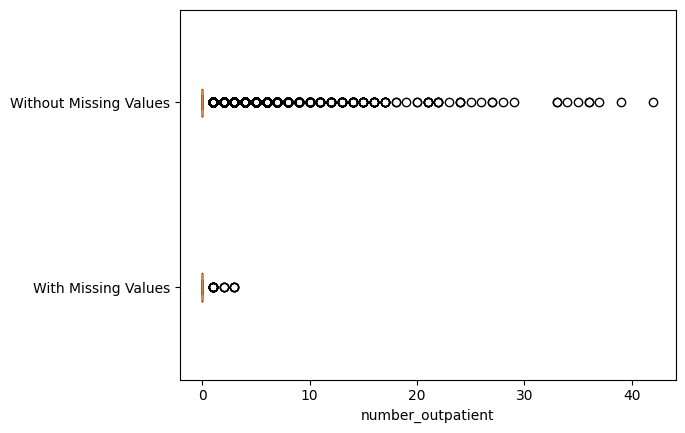

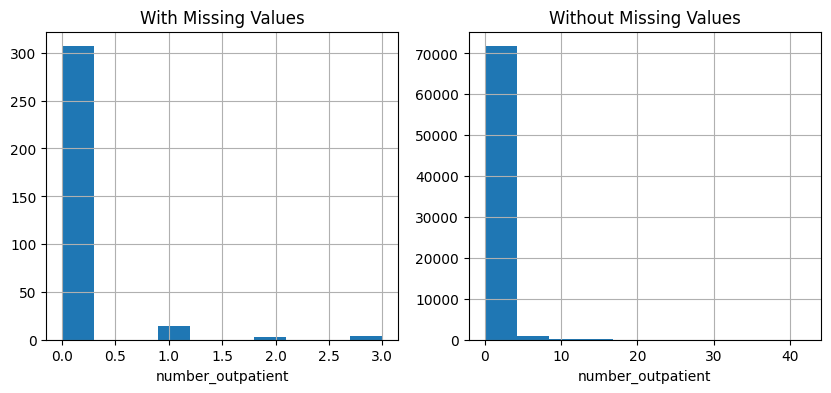

p-value of t-test: 5.803983033487431e-05
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


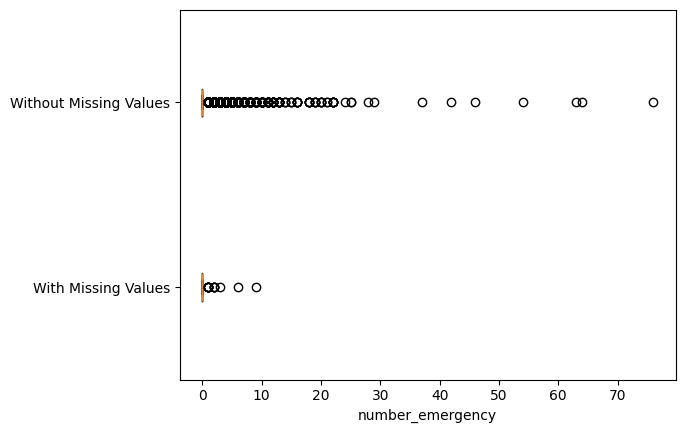

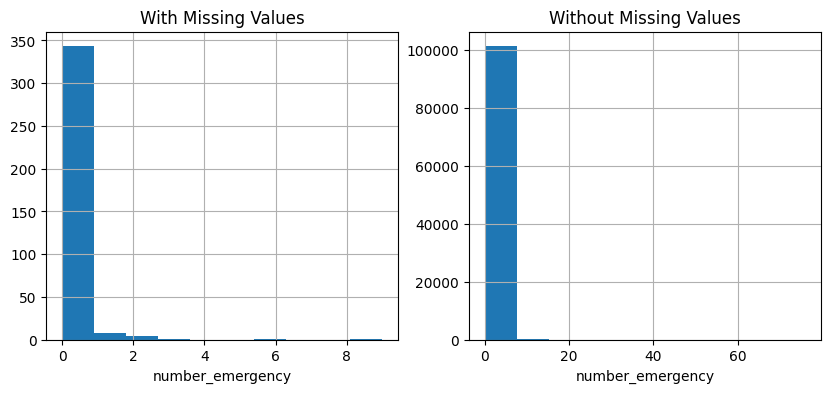

p-value of t-test: 0.03613463979357666
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


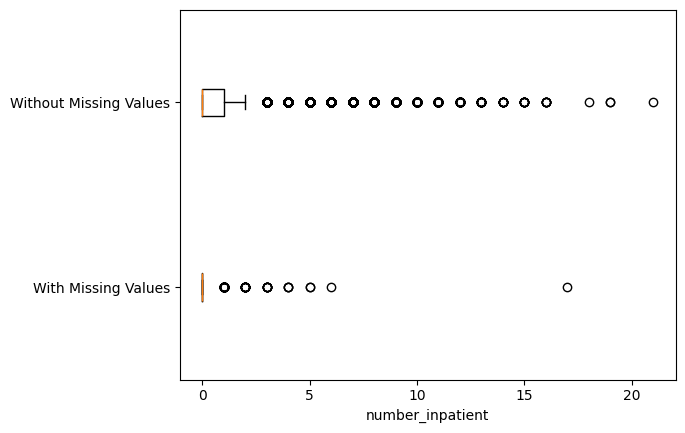

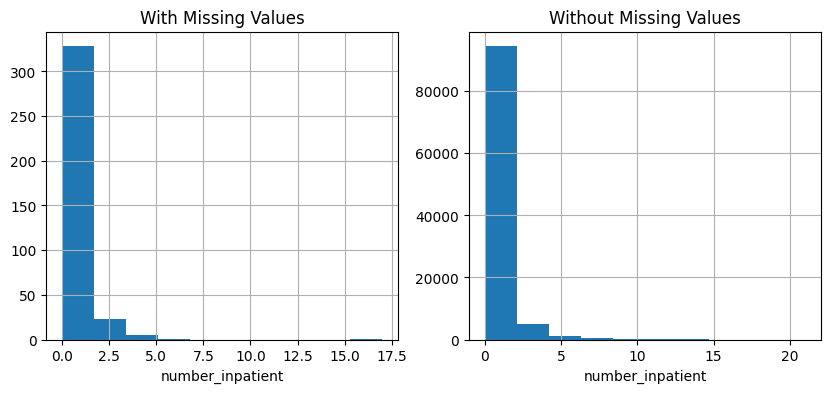

p-value of t-test: 0.00020580785338840786
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.diag_2.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:


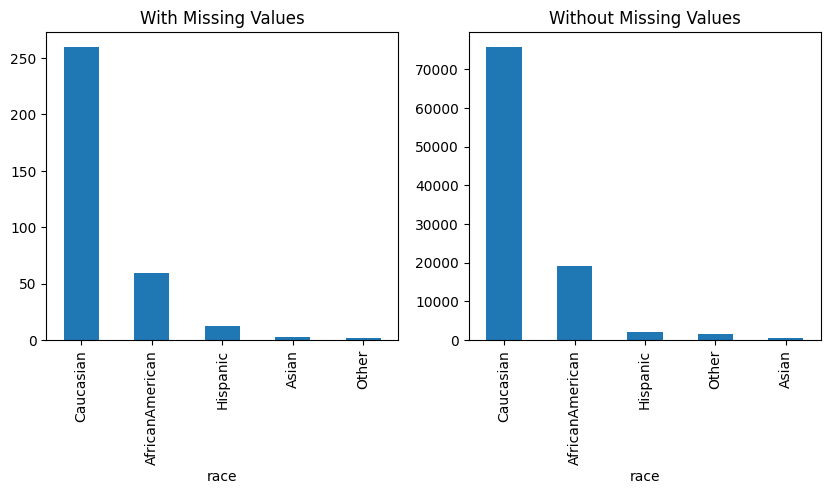

p-value of Chi-squared test: 0.15884532328189843
The missingness in 'race' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


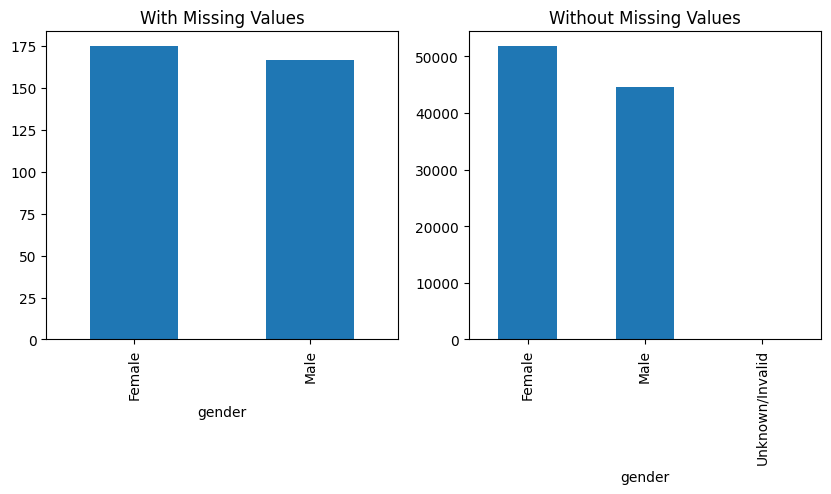

p-value of Chi-squared test: 0.6319057418885656
The missingness in 'gender' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


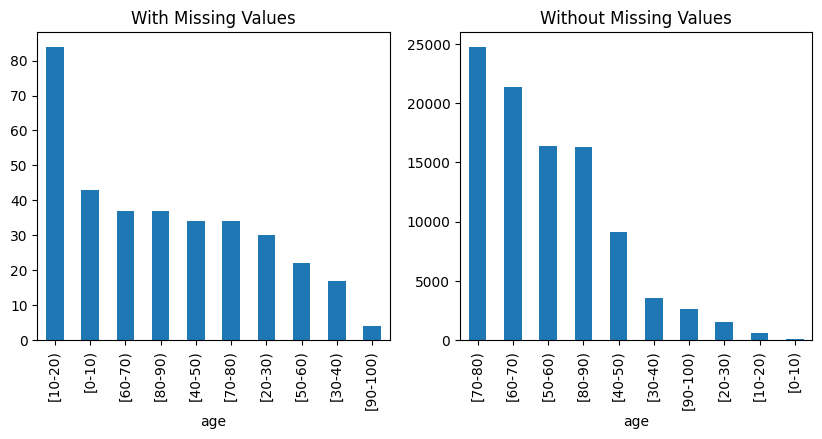

p-value of Chi-squared test: 0.0
The missingness in 'age' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


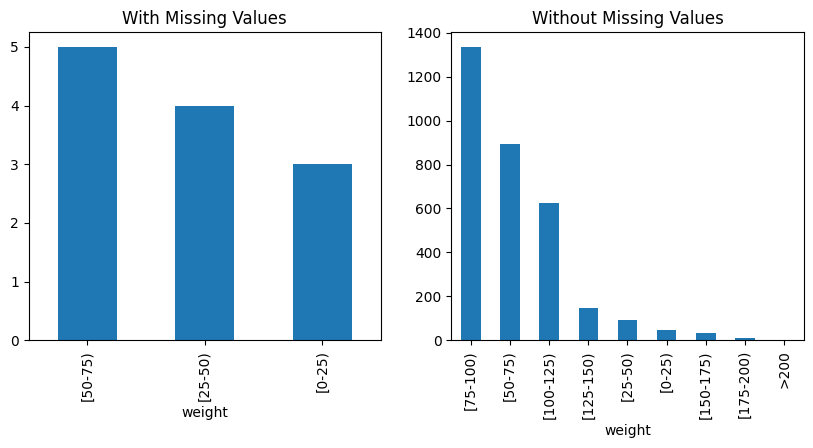

p-value of Chi-squared test: 5.451633894447189e-16
The missingness in 'weight' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


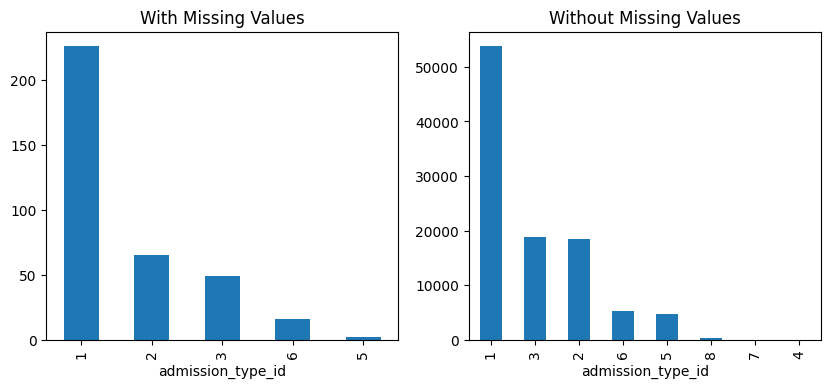

p-value of Chi-squared test: 0.00047070705712020283
The missingness in 'admission_type_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


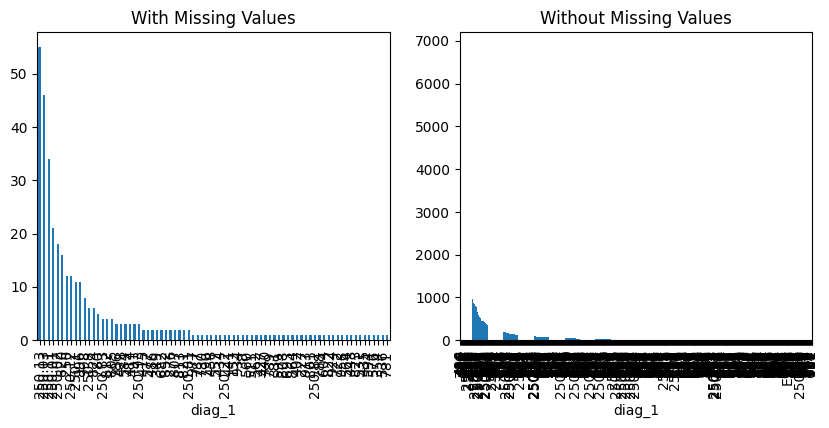

p-value of Chi-squared test: 0.0
The missingness in 'diag_1' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:
No data for group: With Missing Values


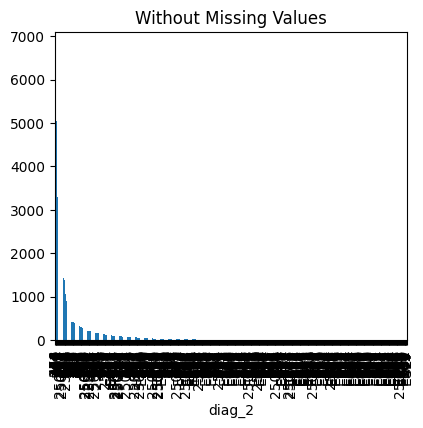

p-value of Chi-squared test: 1.0
The missingness in 'diag_2' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


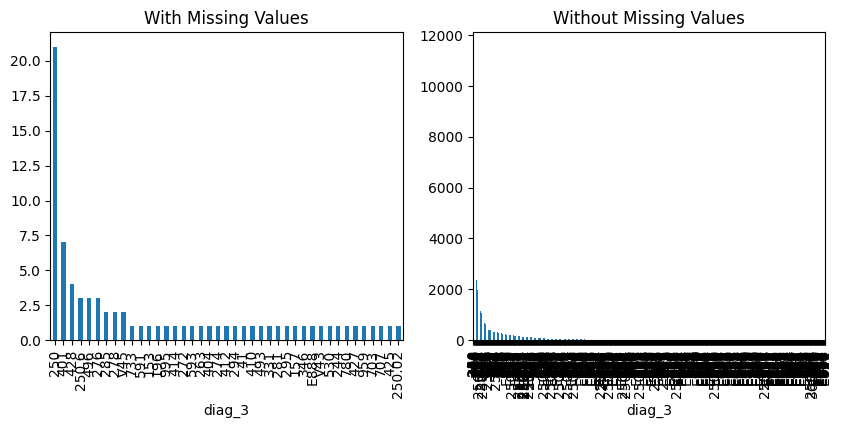

p-value of Chi-squared test: 0.8432146967424731
The missingness in 'diag_3' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


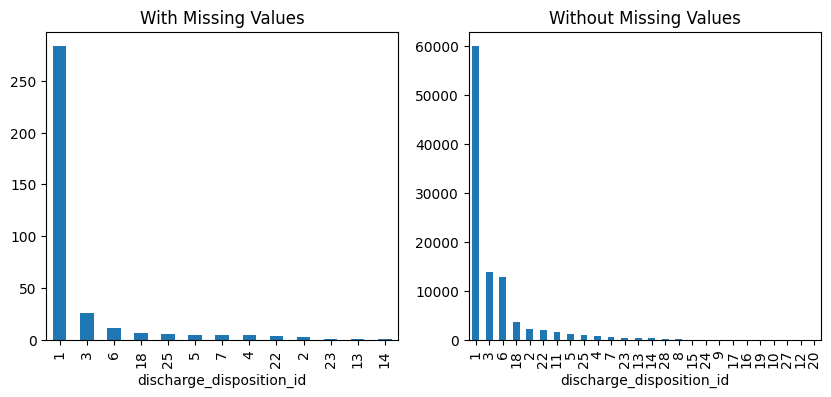

p-value of Chi-squared test: 4.452421015940414e-08
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


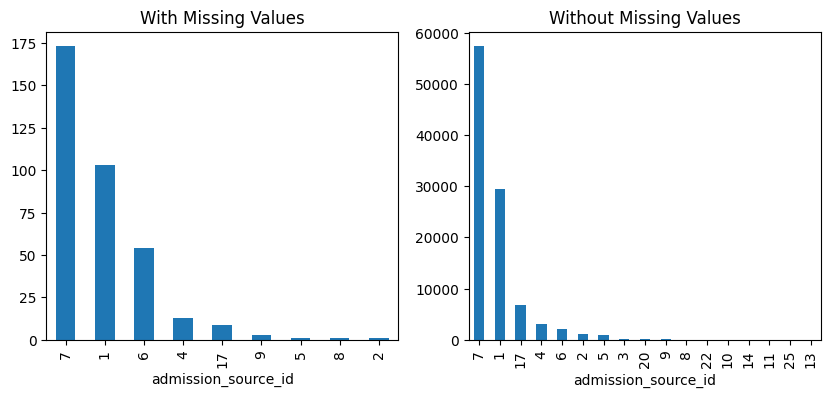

p-value of Chi-squared test: 9.616567127511445e-58
The missingness in 'admission_source_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


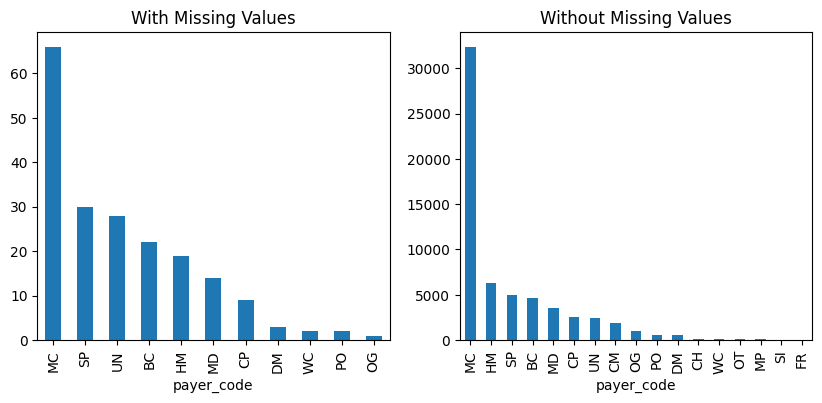

p-value of Chi-squared test: 6.973567409462186e-14
The missingness in 'payer_code' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


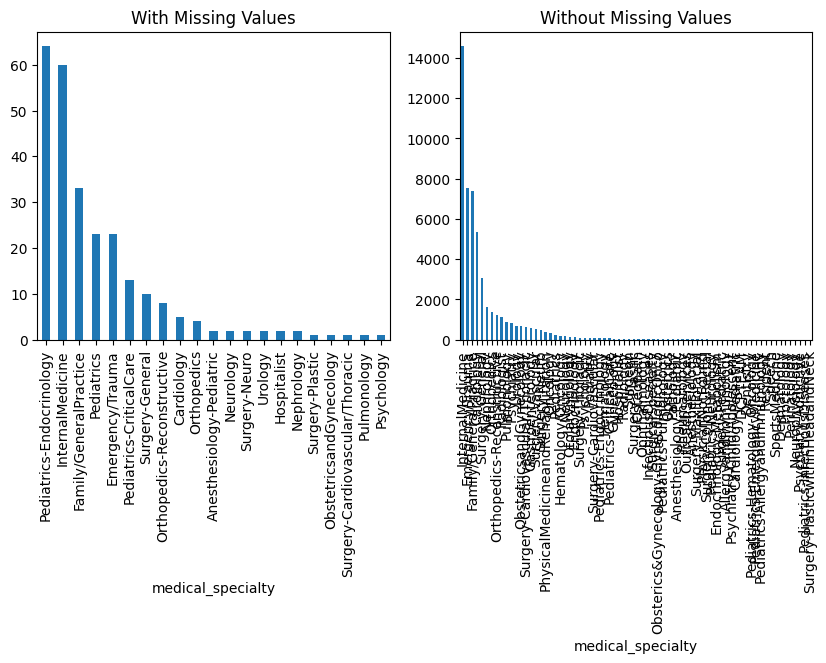

p-value of Chi-squared test: 0.0
The missingness in 'medical_specialty' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


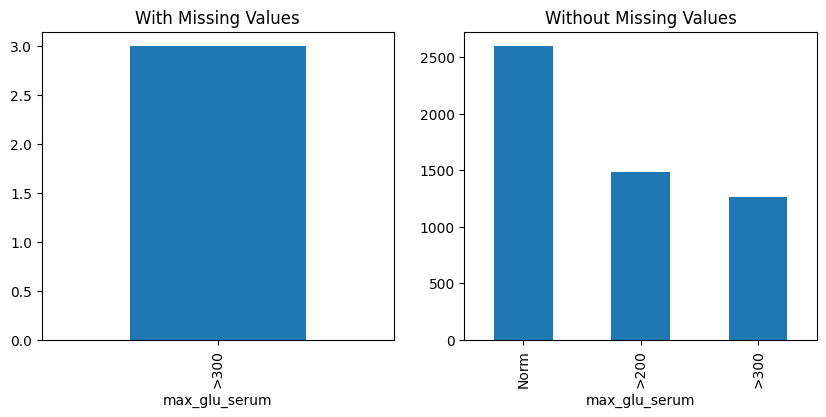

p-value of Chi-squared test: 0.007852954318515036
The missingness in 'max_glu_serum' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


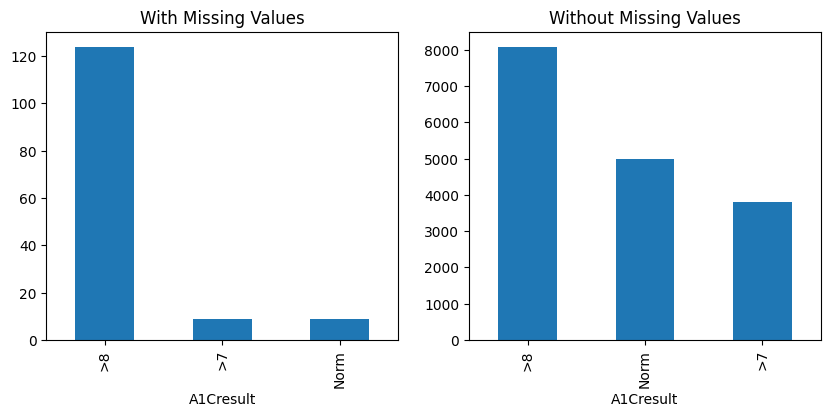

p-value of Chi-squared test: 9.948288580011705e-20
The missingness in 'A1Cresult' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


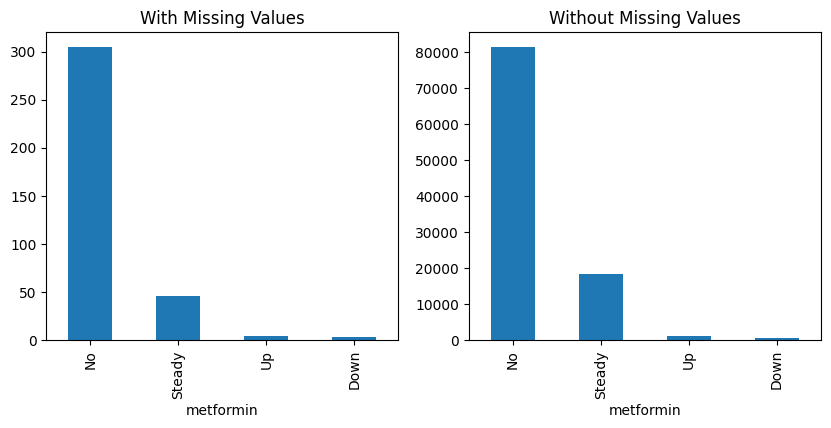

p-value of Chi-squared test: 0.07582243044768905
The missingness in 'metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


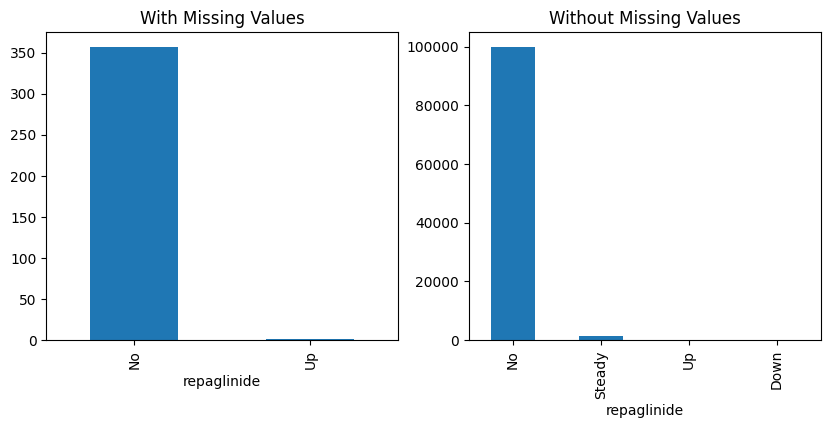

p-value of Chi-squared test: 0.10802518164604501
The missingness in 'repaglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


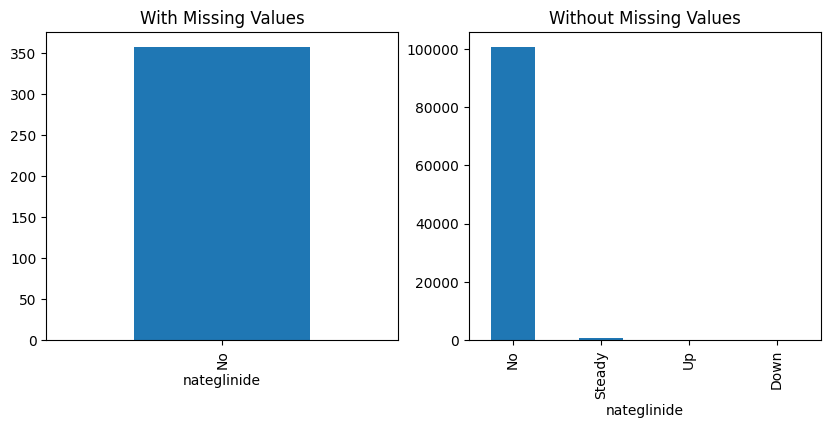

p-value of Chi-squared test: 0.4754610180087754
The missingness in 'nateglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


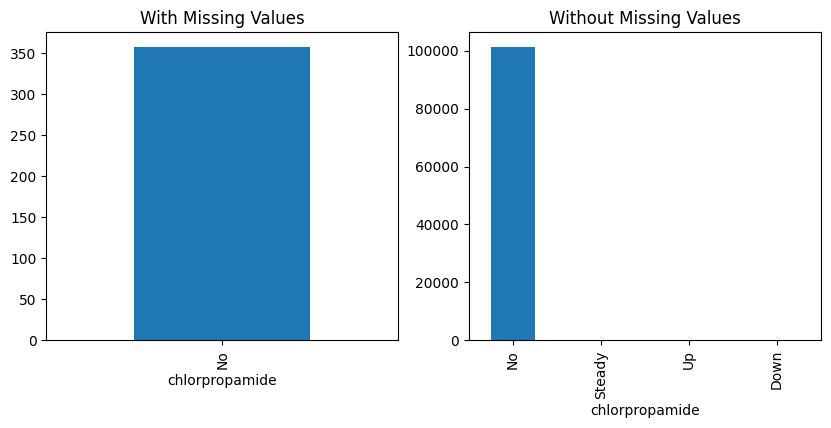

p-value of Chi-squared test: 0.9593005088142055
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


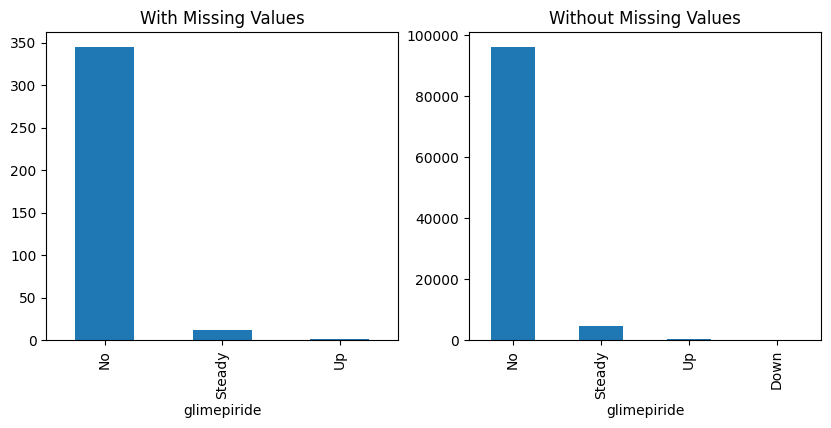

p-value of Chi-squared test: 0.5756678747362496
The missingness in 'glimepiride' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


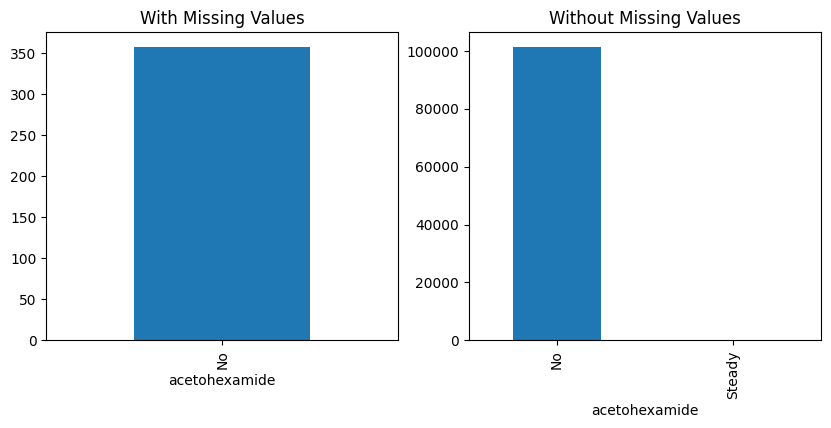

p-value of Chi-squared test: 1.0
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


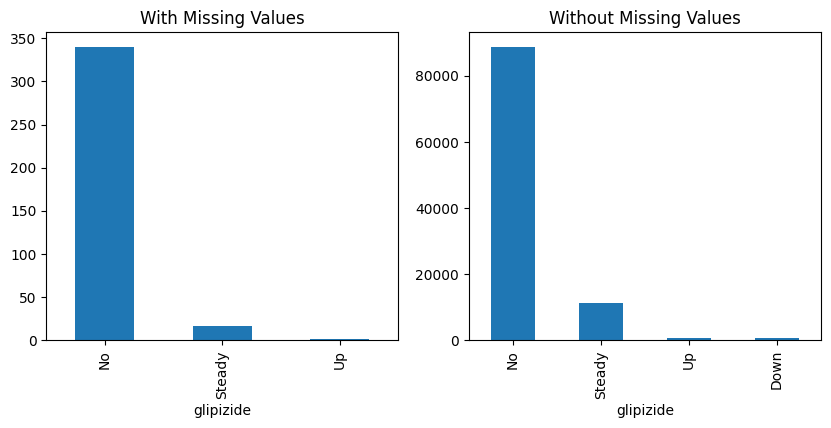

p-value of Chi-squared test: 0.0003372263829829541
The missingness in 'glipizide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


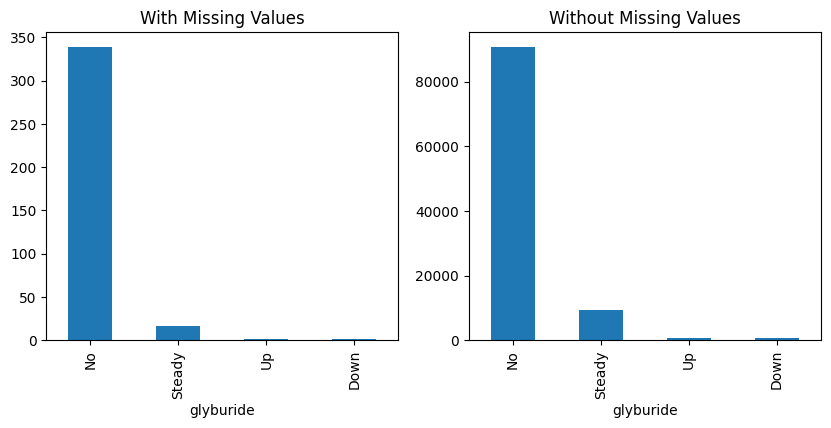

p-value of Chi-squared test: 0.016347560042031934
The missingness in 'glyburide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


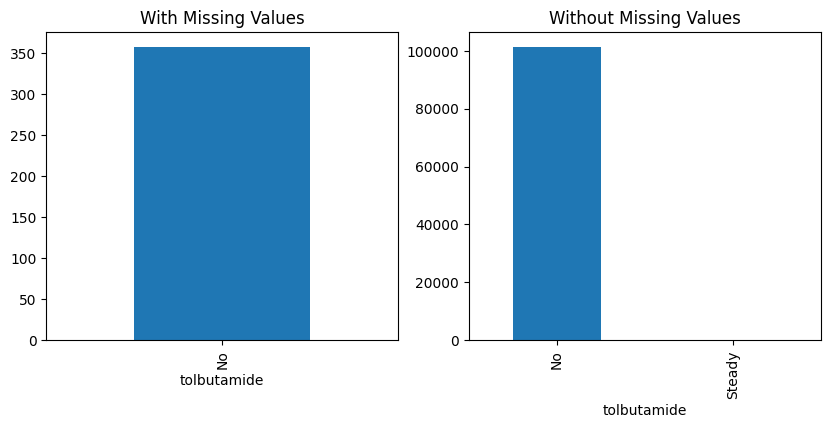

p-value of Chi-squared test: 1.0
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


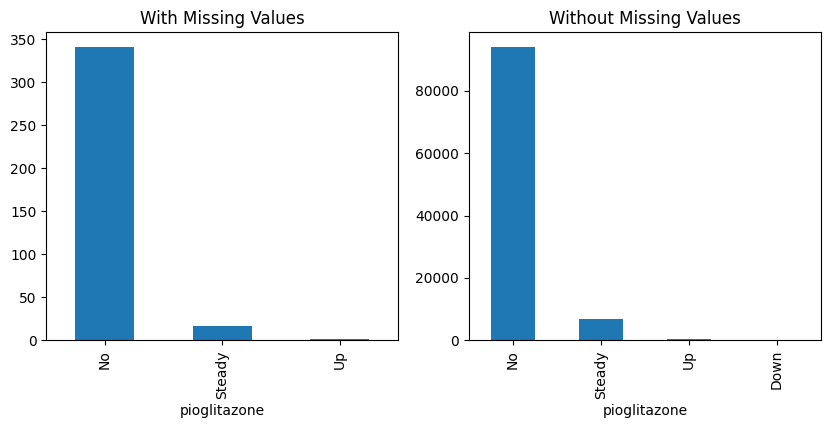

p-value of Chi-squared test: 0.2993332307797405
The missingness in 'pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


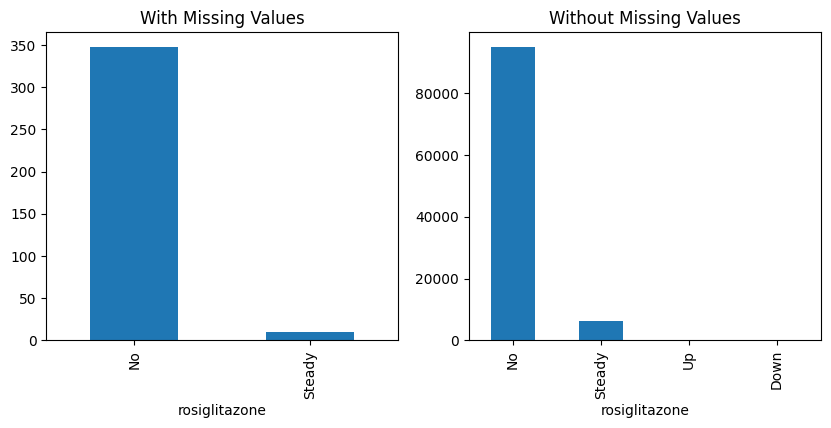

p-value of Chi-squared test: 0.05665763066270731
The missingness in 'rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


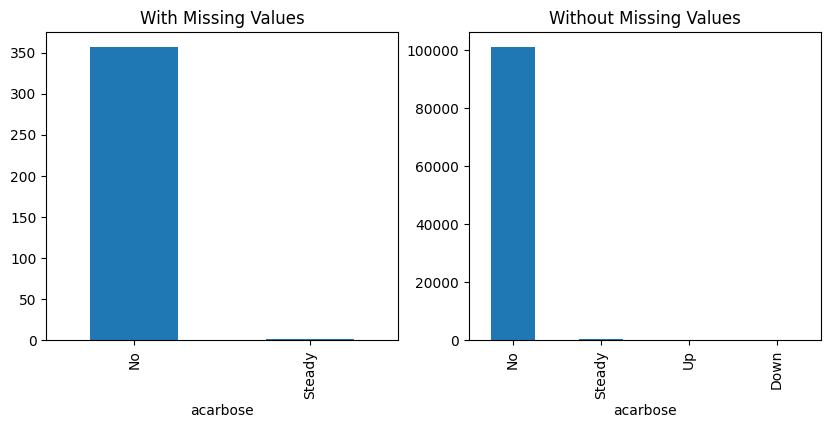

p-value of Chi-squared test: 0.9973031141082284
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


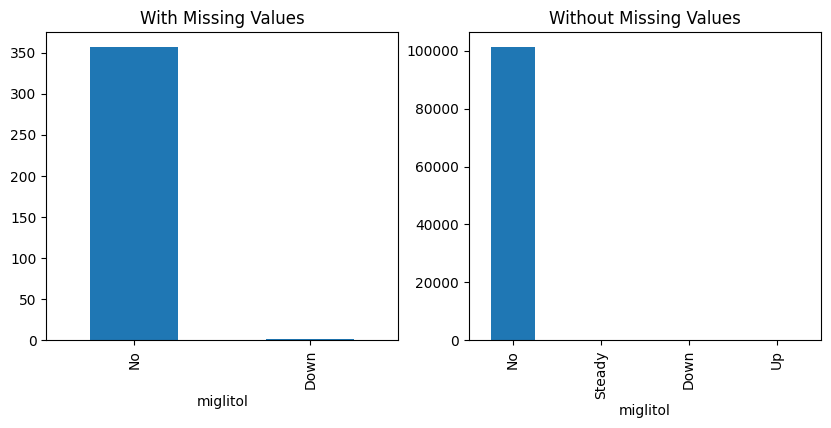

p-value of Chi-squared test: 6.2776602466093445e-12
The missingness in 'miglitol' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


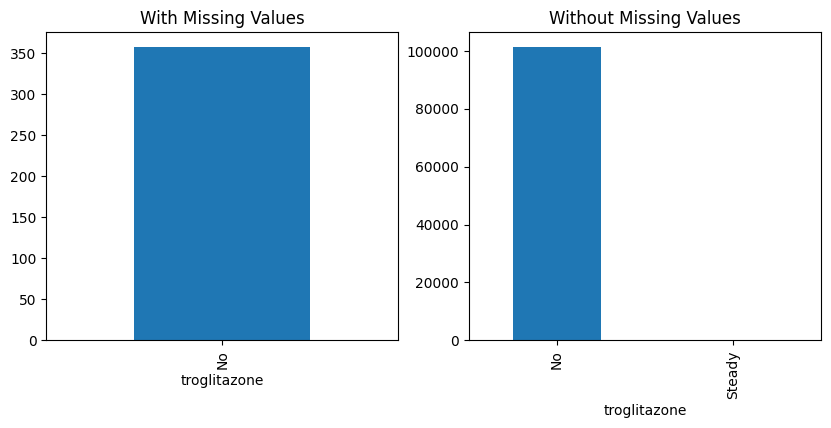

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


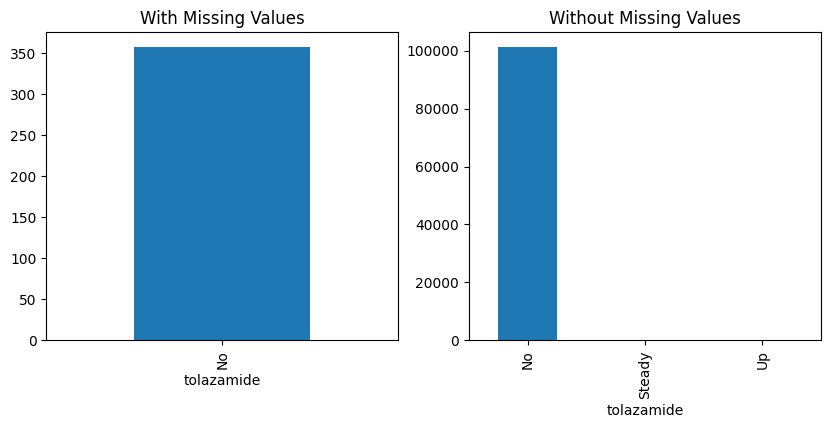

p-value of Chi-squared test: 0.9334507137002221
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


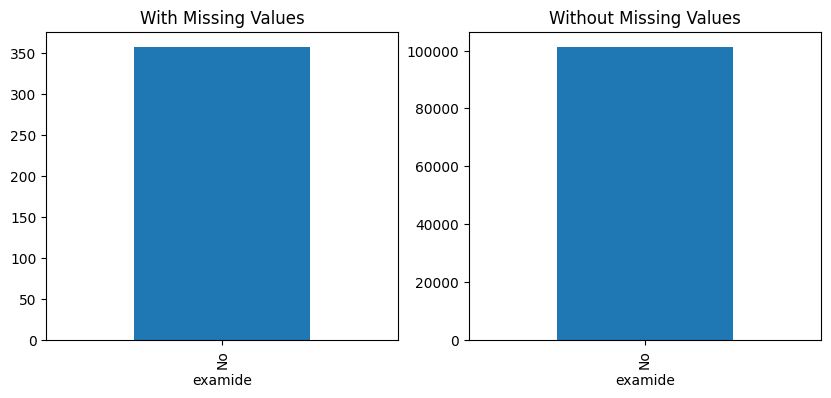

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


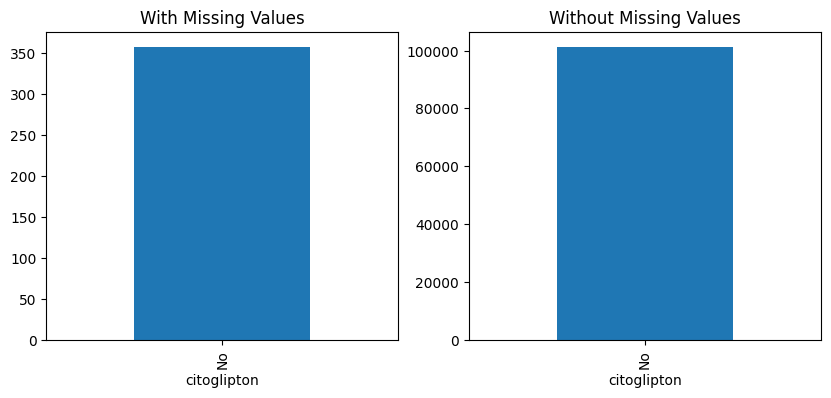

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:


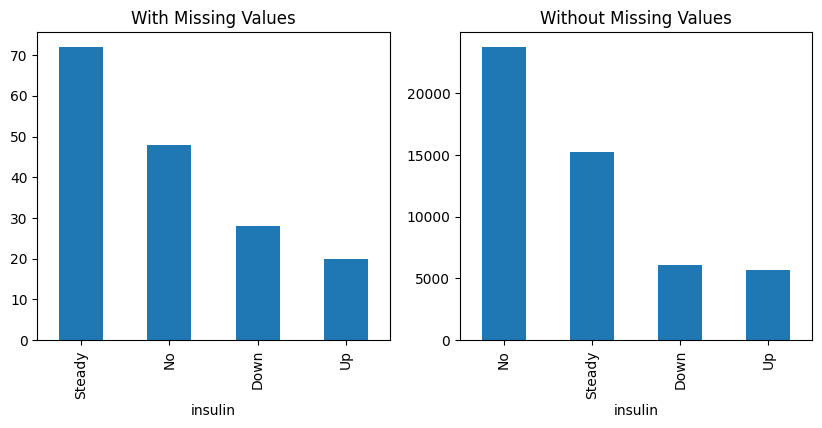

p-value of Chi-squared test: 2.1292647411793706e-05
The missingness in 'insulin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


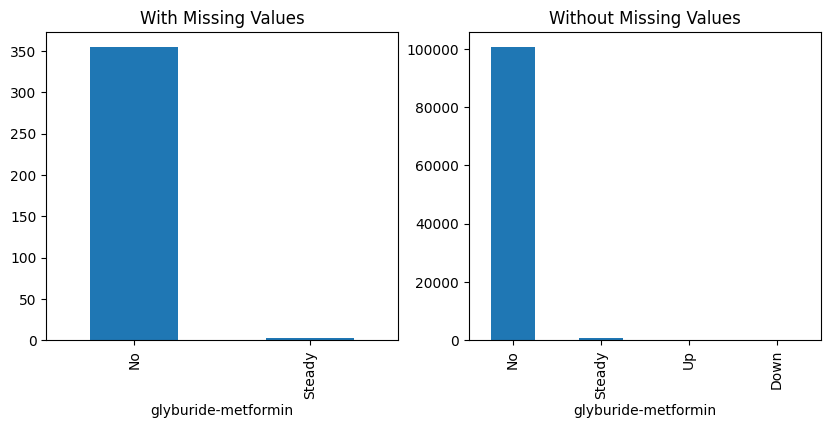

p-value of Chi-squared test: 0.9804311220705582
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


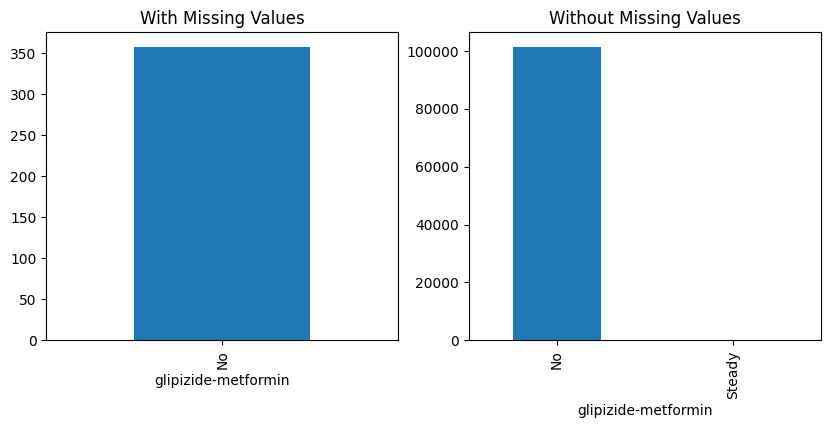

p-value of Chi-squared test: 1.0
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


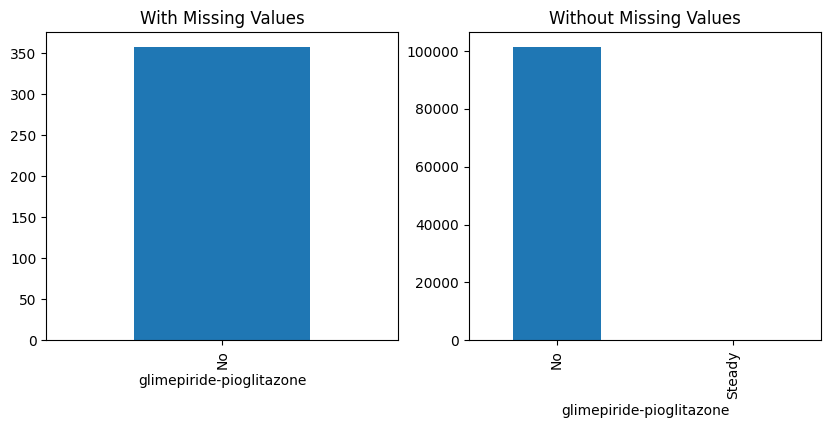

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


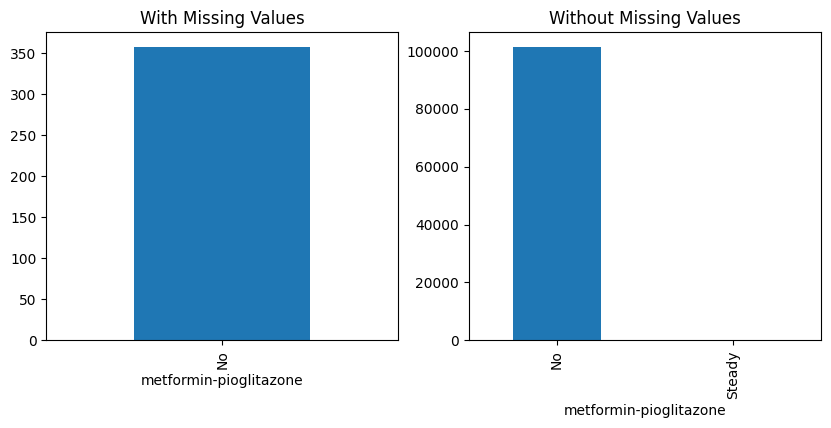

p-value of Chi-squared test: 1.0
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


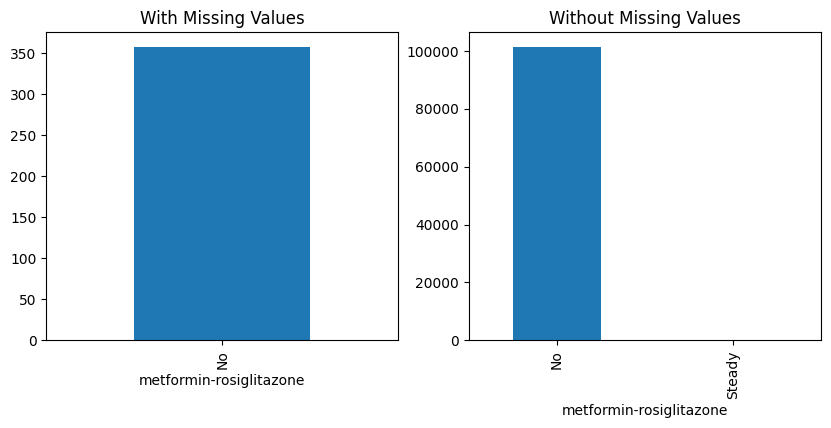

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


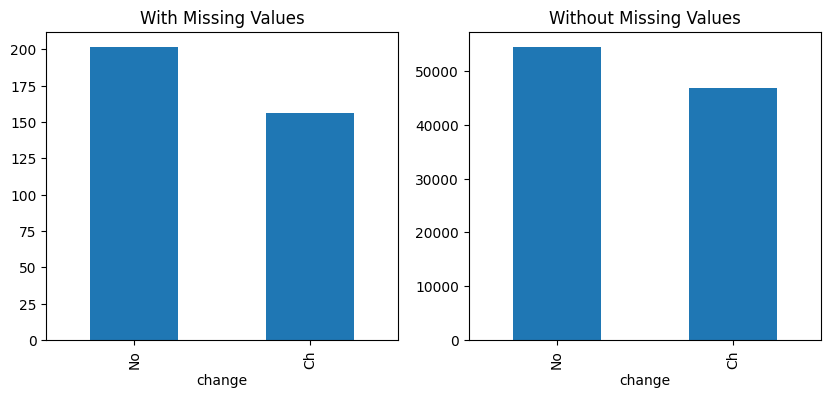

p-value of Chi-squared test: 0.34572875173430007
The missingness in 'change' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


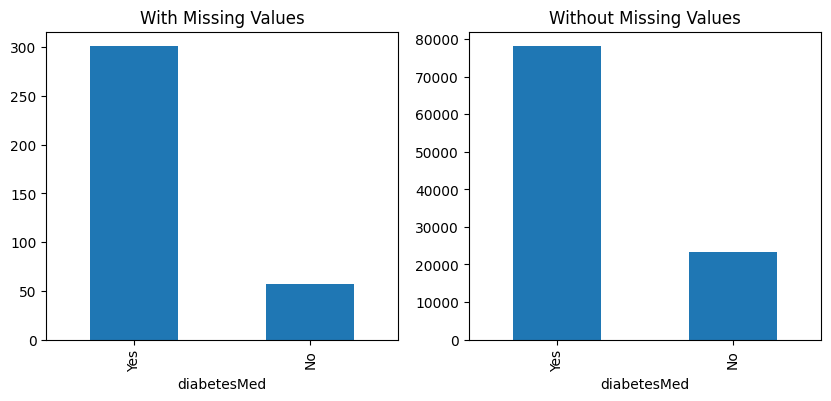

p-value of Chi-squared test: 0.0017849737187011568
The missingness in 'diabetesMed' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


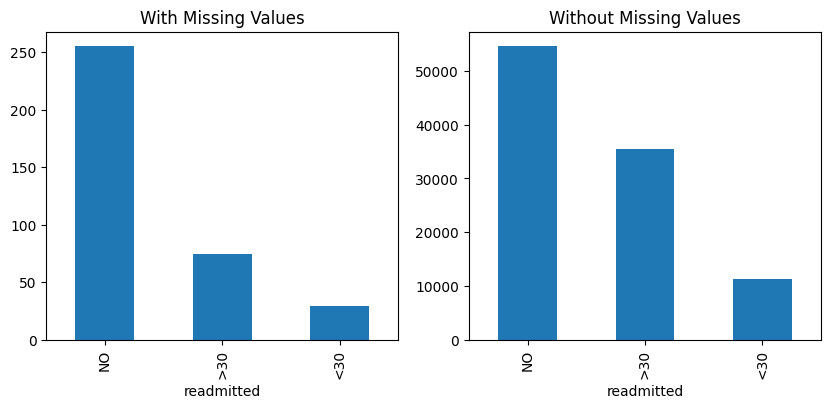

p-value of Chi-squared test: 2.9230999811365483e-10
The missingness in 'readmitted' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.diag_2.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### After going through the analysis we can say `diag_2` is of MCAR

## Detecting Missing type for diag_3

Diagnosis Analysis of Missing Values for time_in_hospital:


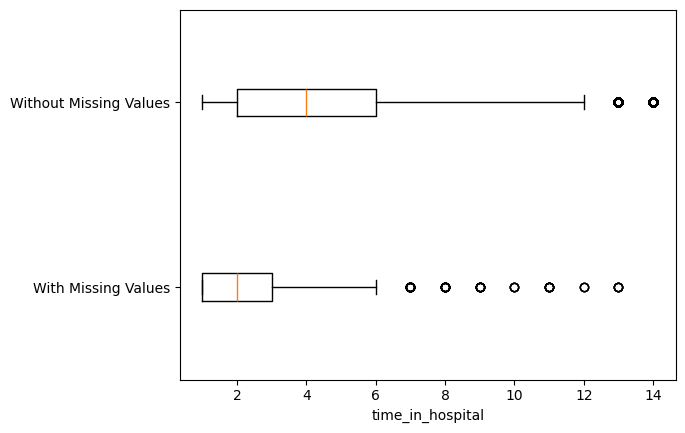

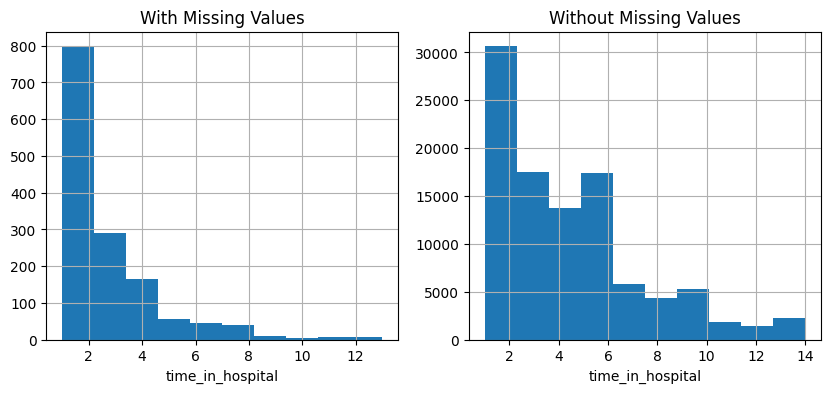

p-value of t-test: 7.060116469212431e-100
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_lab_procedures:


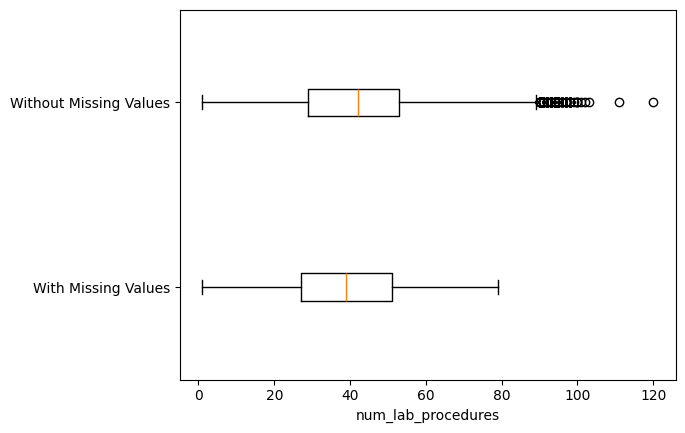

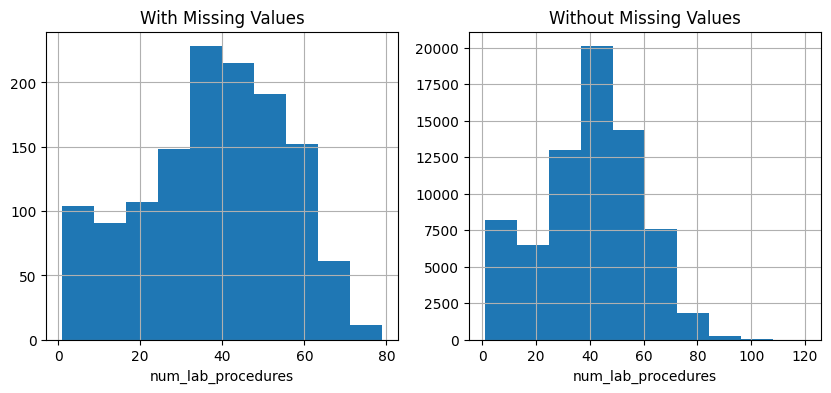

p-value of t-test: 7.806702332959315e-06
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_medications:


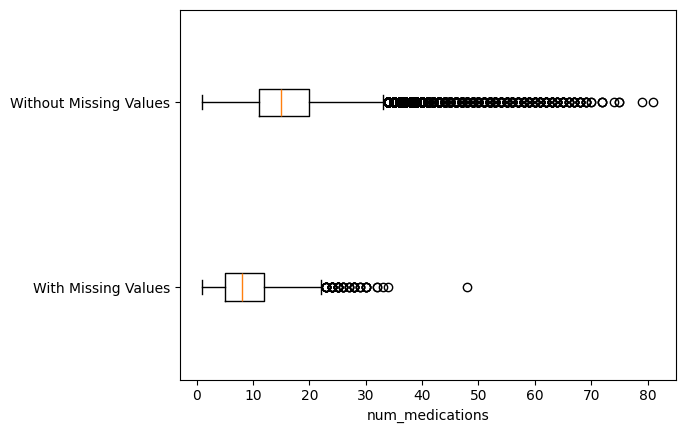

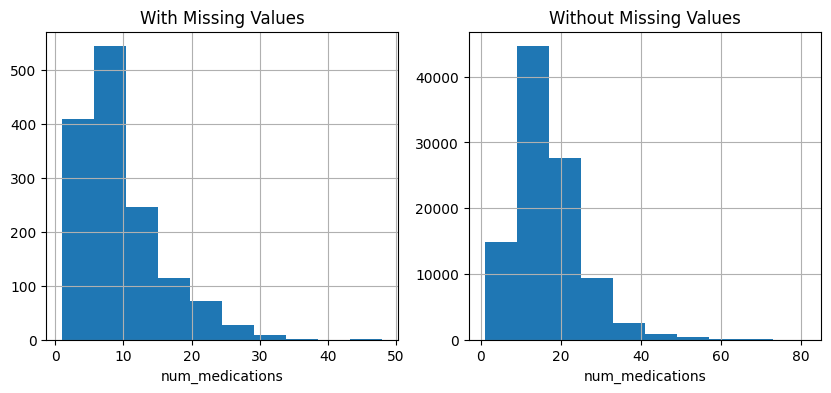

p-value of t-test: 2.2595212704341722e-209
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_diagnoses:


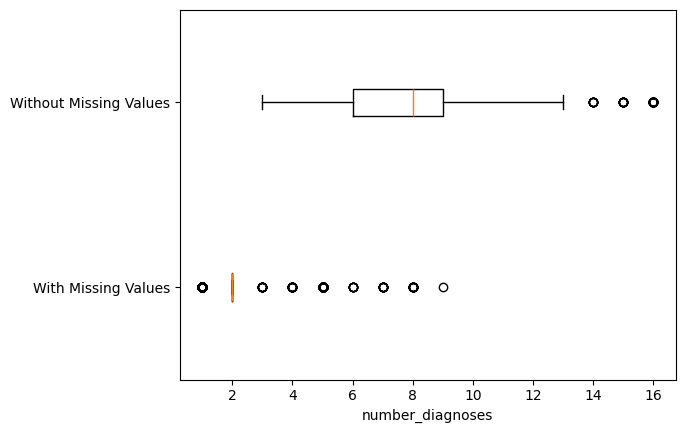

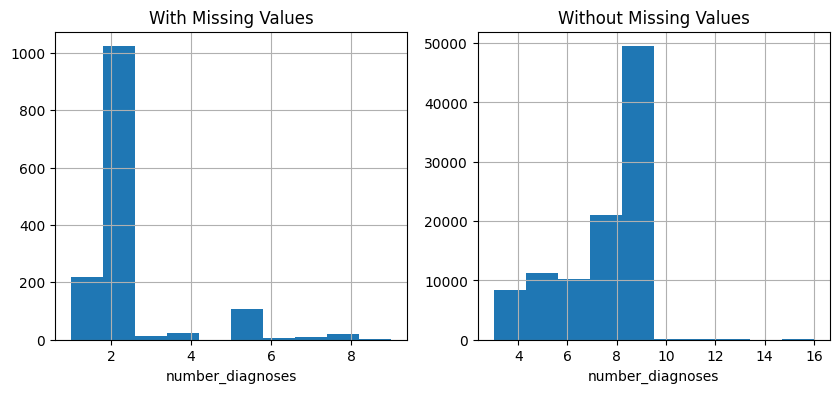

p-value of t-test: 0.0
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for num_procedures:


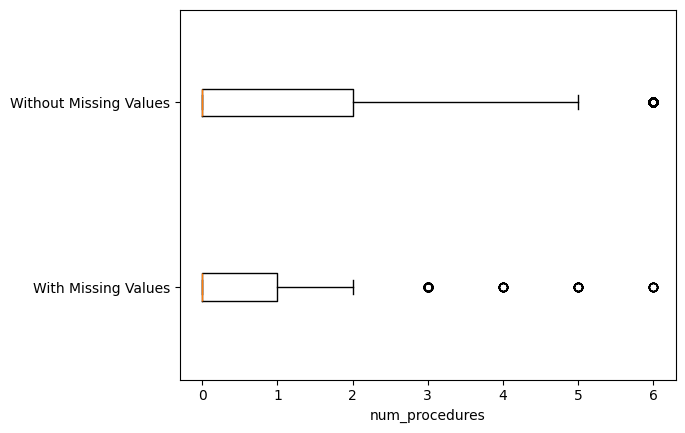

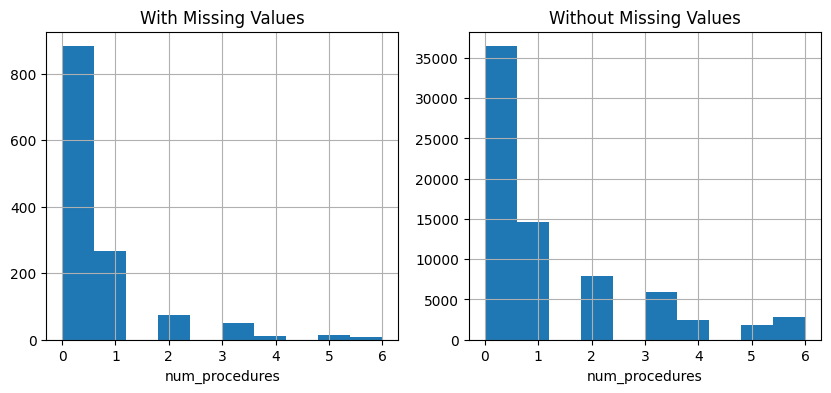

p-value of t-test: 2.3848853258689798e-40
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_outpatient:


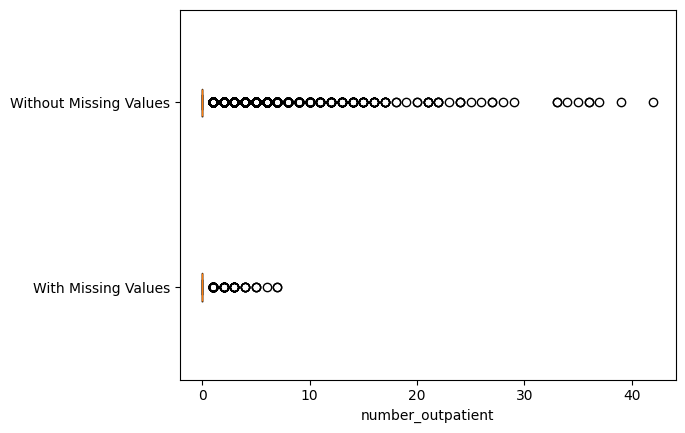

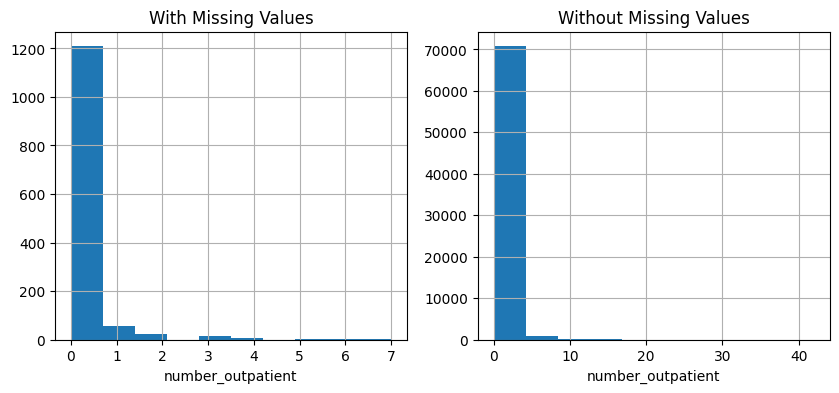

p-value of t-test: 2.051089175922336e-11
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_emergency:


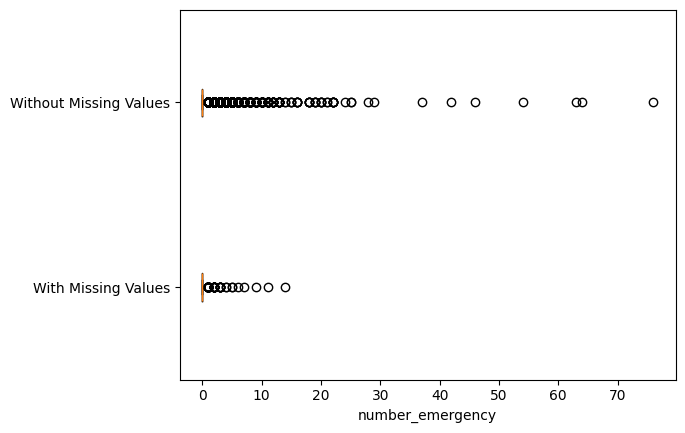

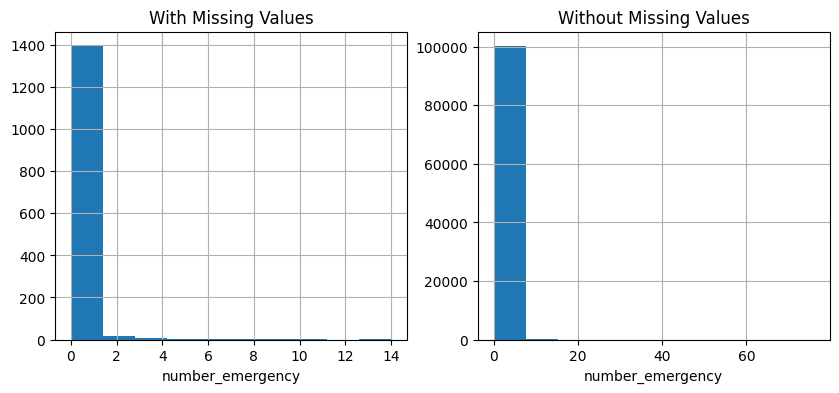

p-value of t-test: 0.0024651197680367293
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for number_inpatient:


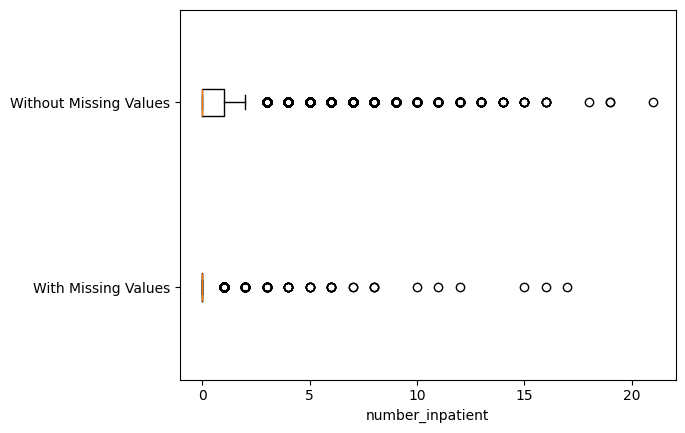

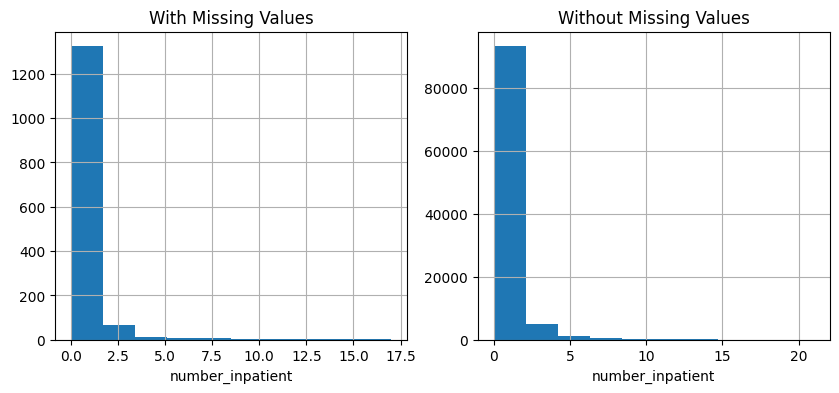

p-value of t-test: 1.2777709069731713e-16
The groups are significantly different. Missing values are not random.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.diag_3.isna()
for att in numerical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Numerical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')


Diagnosis Analysis of Missing Values for race:


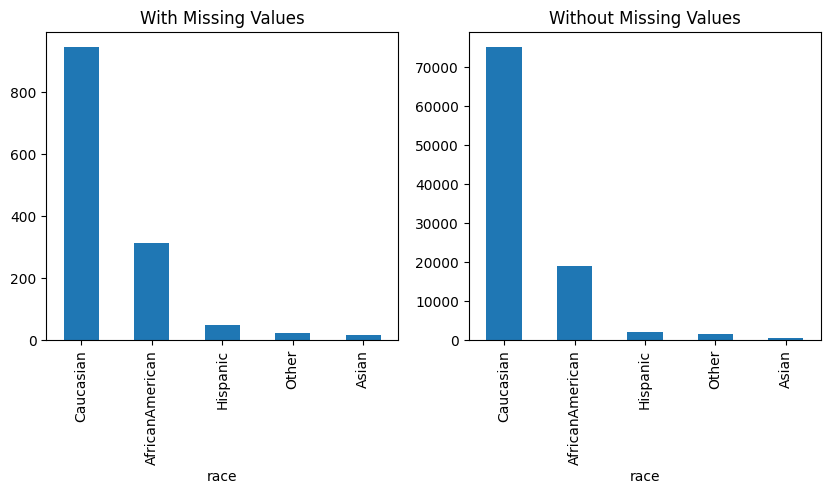

p-value of Chi-squared test: 2.455121318116611e-08
The missingness in 'race' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


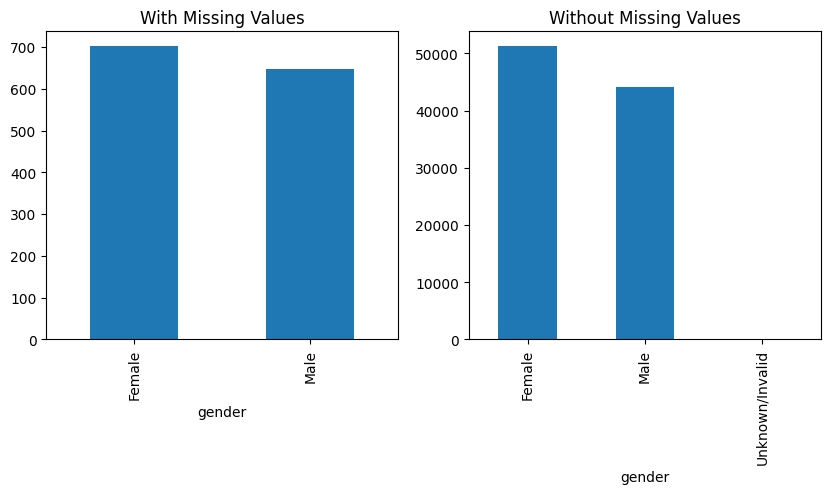

p-value of Chi-squared test: 0.4452586895440106
The missingness in 'gender' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


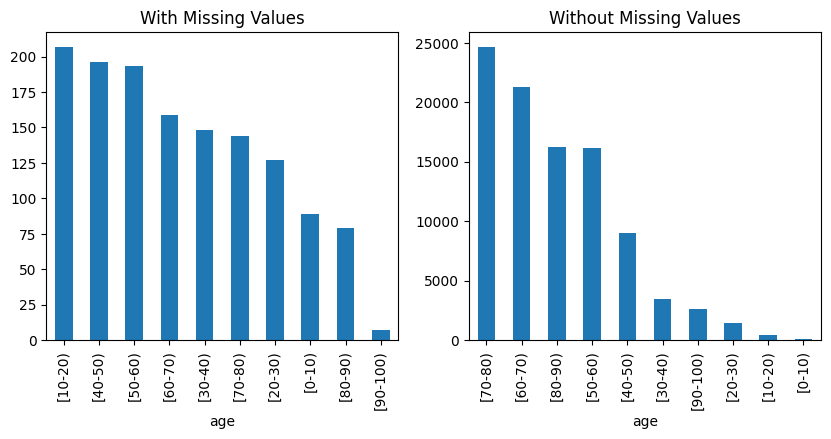

p-value of Chi-squared test: 0.0
The missingness in 'age' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


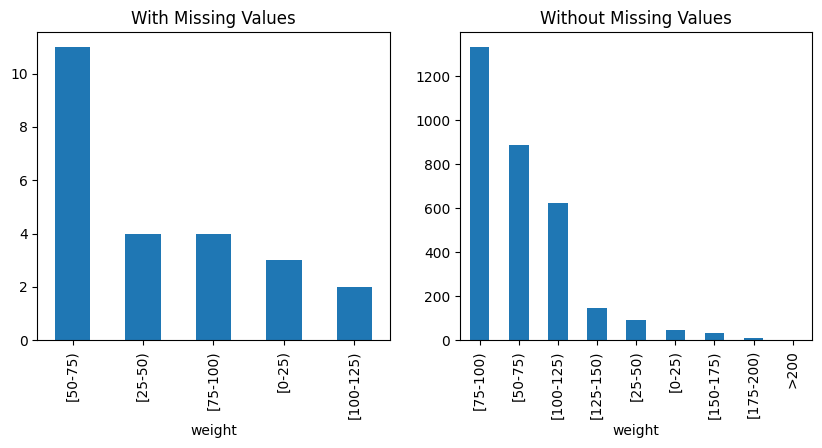

p-value of Chi-squared test: 6.499452746182769e-07
The missingness in 'weight' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


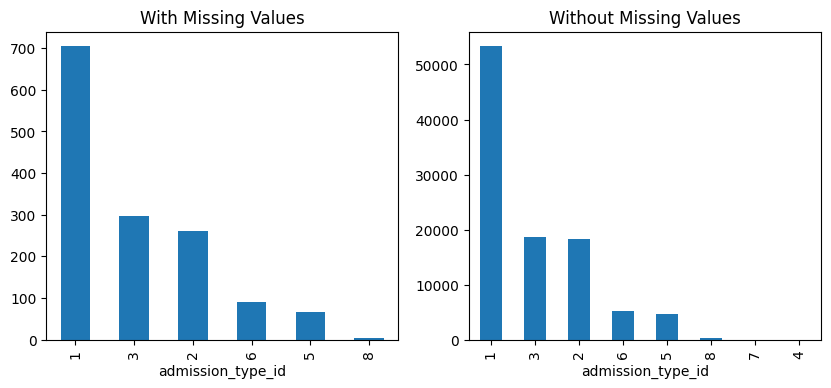

p-value of Chi-squared test: 0.10152793491735553
The missingness in 'admission_type_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


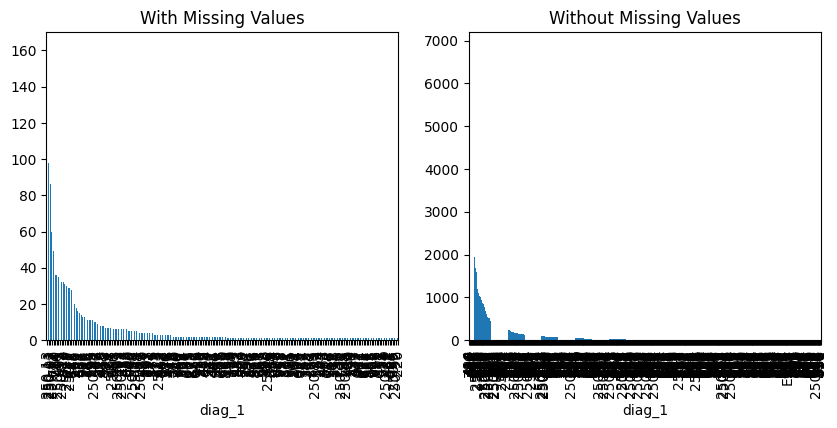

p-value of Chi-squared test: 0.0
The missingness in 'diag_1' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


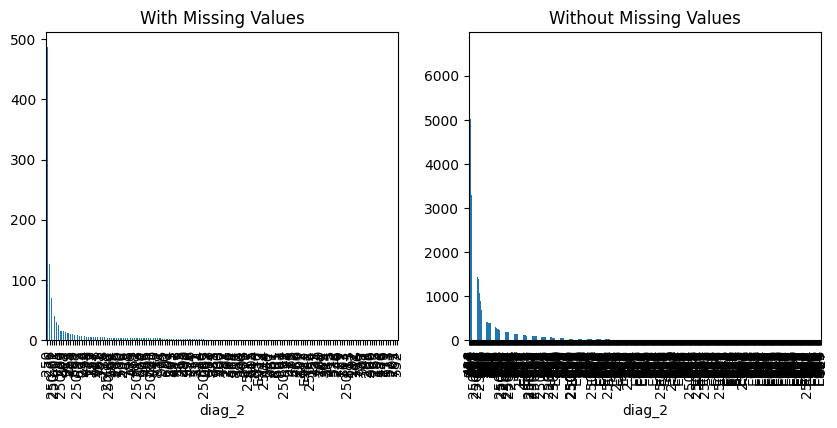

p-value of Chi-squared test: 0.0
The missingness in 'diag_2' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:
No data for group: With Missing Values


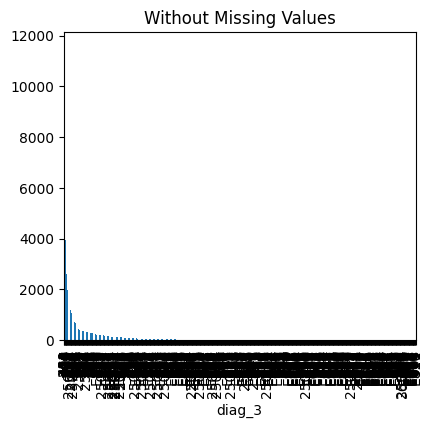

p-value of Chi-squared test: 1.0
The missingness in 'diag_3' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


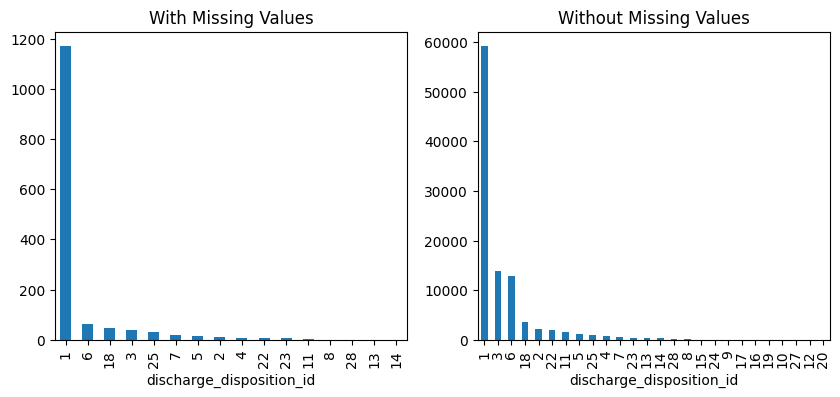

p-value of Chi-squared test: 3.763572317661426e-74
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


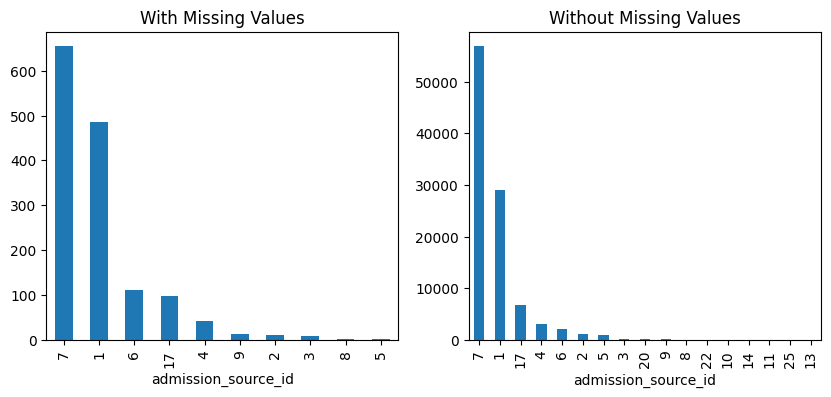

p-value of Chi-squared test: 5.105803519195779e-61
The missingness in 'admission_source_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


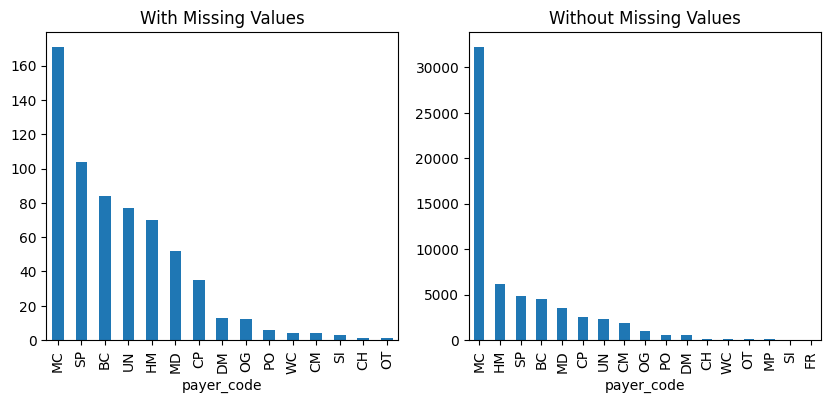

p-value of Chi-squared test: 7.715100593768452e-58
The missingness in 'payer_code' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


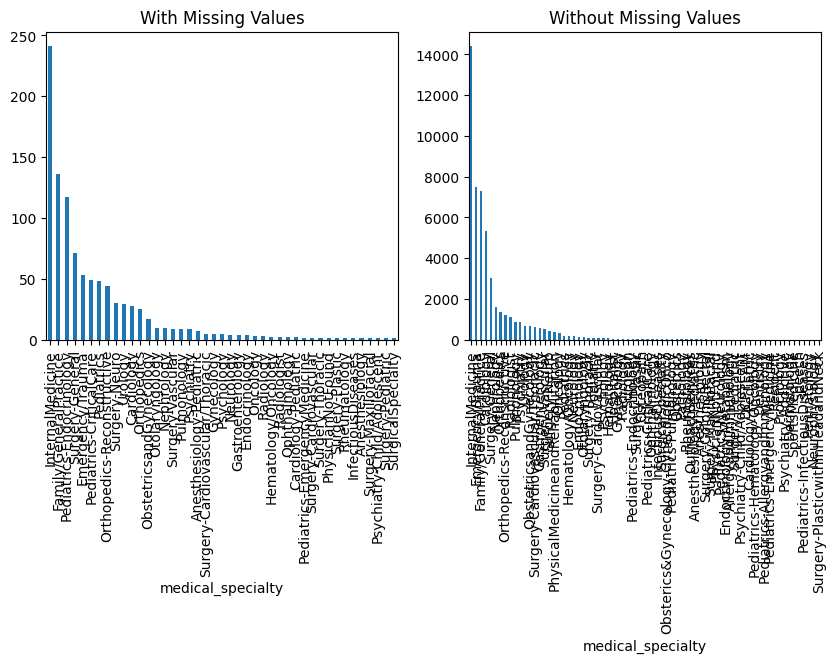

p-value of Chi-squared test: 0.0
The missingness in 'medical_specialty' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


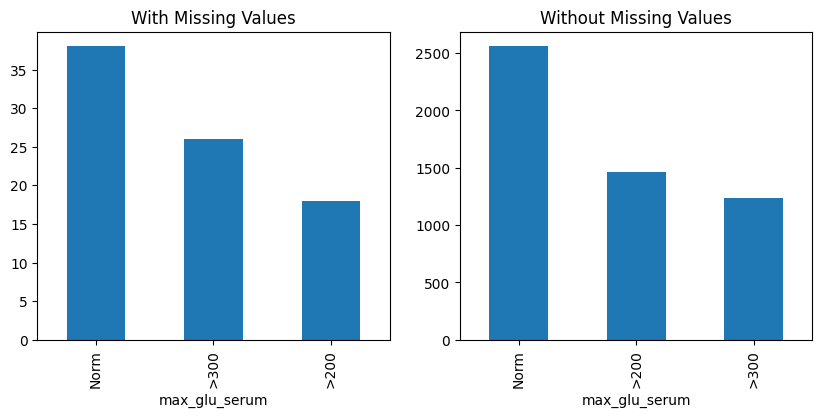

p-value of Chi-squared test: 0.18326443937799353
The missingness in 'max_glu_serum' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


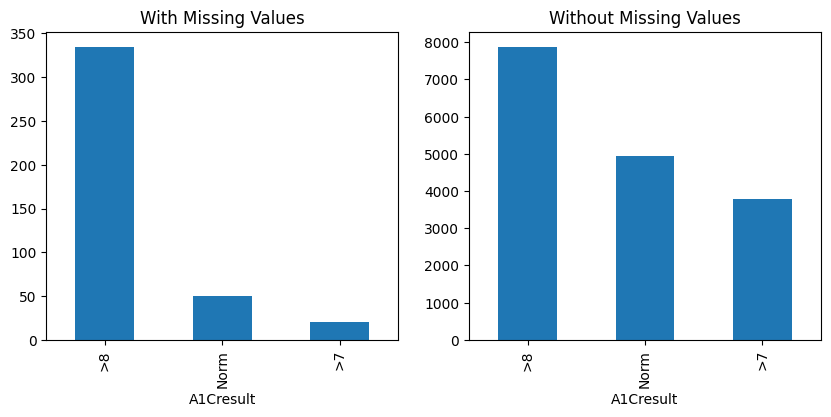

p-value of Chi-squared test: 5.655275820045017e-44
The missingness in 'A1Cresult' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


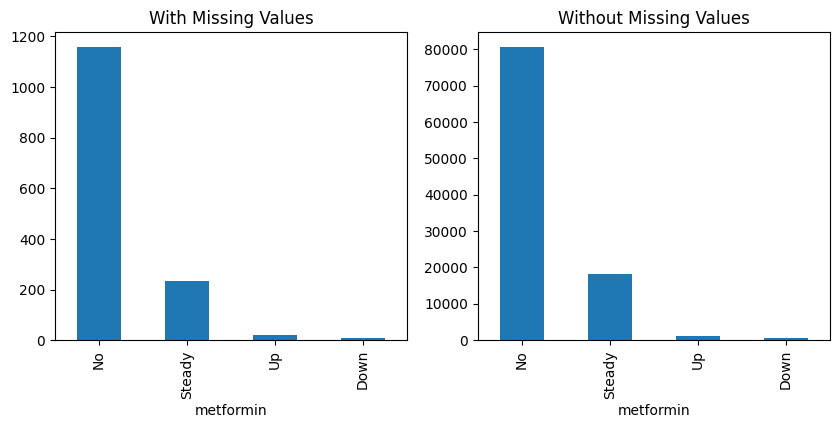

p-value of Chi-squared test: 0.23490897387858087
The missingness in 'metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


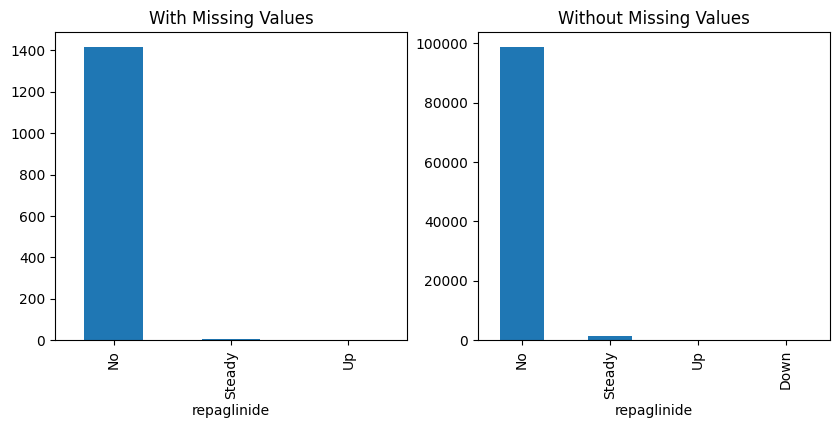

p-value of Chi-squared test: 0.0040210807552701405
The missingness in 'repaglinide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


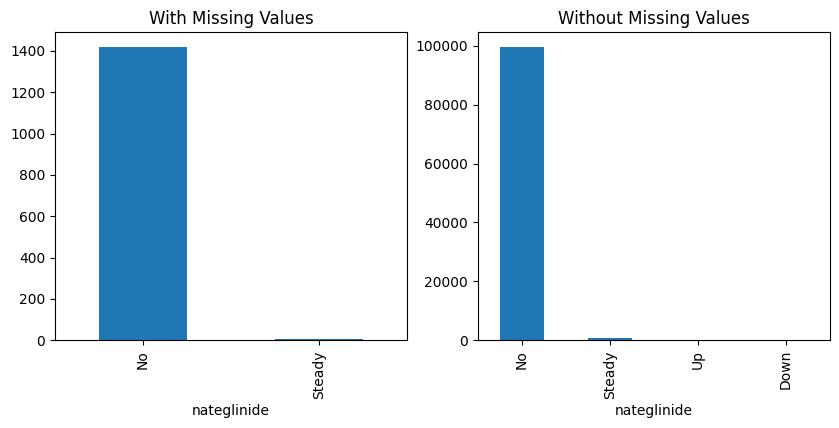

p-value of Chi-squared test: 0.30581886181842954
The missingness in 'nateglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


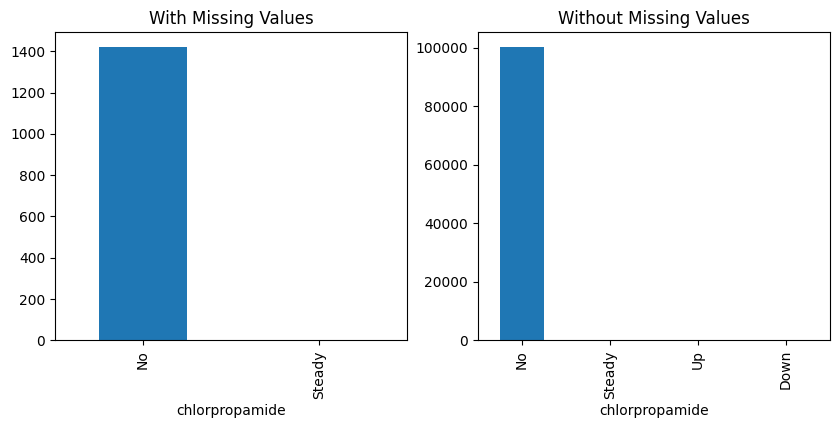

p-value of Chi-squared test: 0.8409117901313385
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


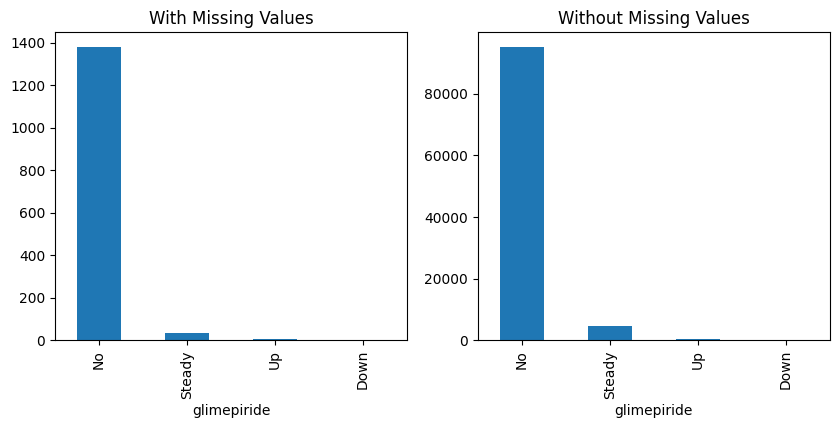

p-value of Chi-squared test: 0.0013962838622685815
The missingness in 'glimepiride' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


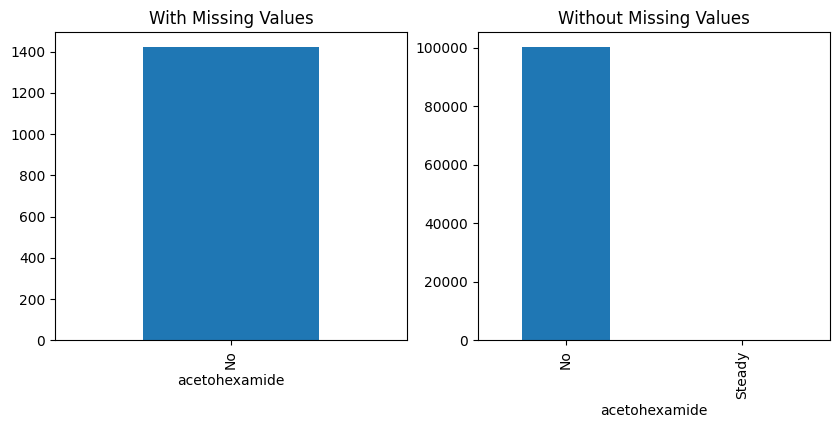

p-value of Chi-squared test: 1.0
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


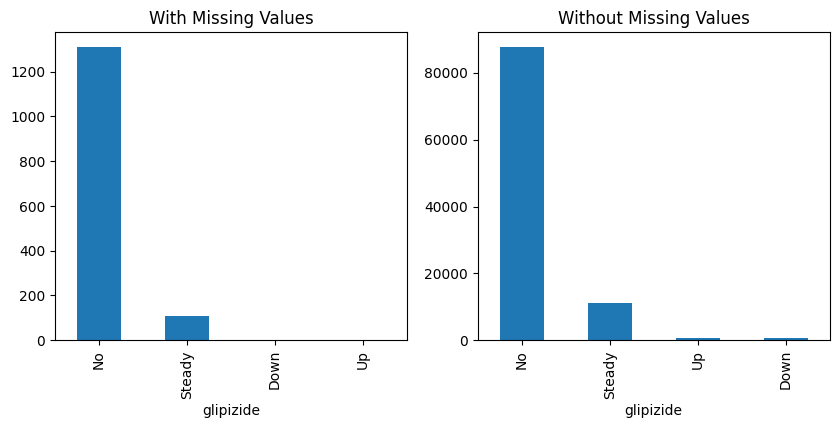

p-value of Chi-squared test: 9.03111359584263e-07
The missingness in 'glipizide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


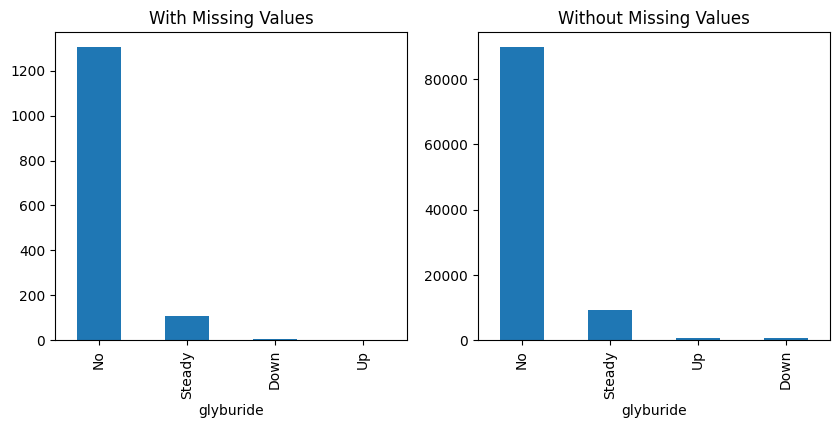

p-value of Chi-squared test: 0.006121530049713604
The missingness in 'glyburide' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


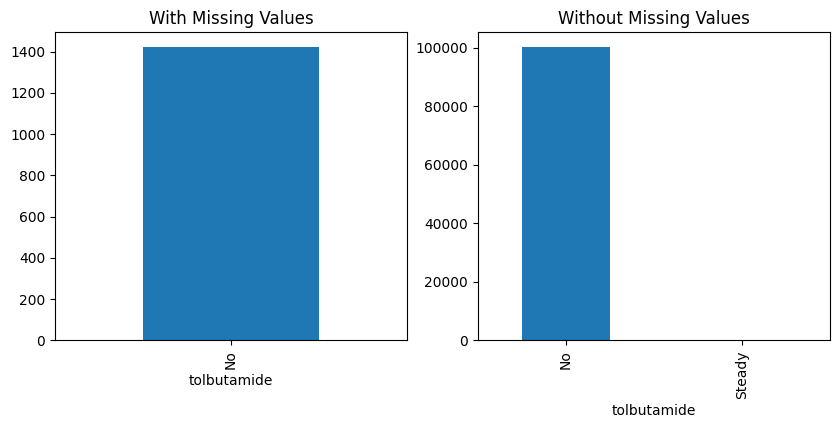

p-value of Chi-squared test: 1.0
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


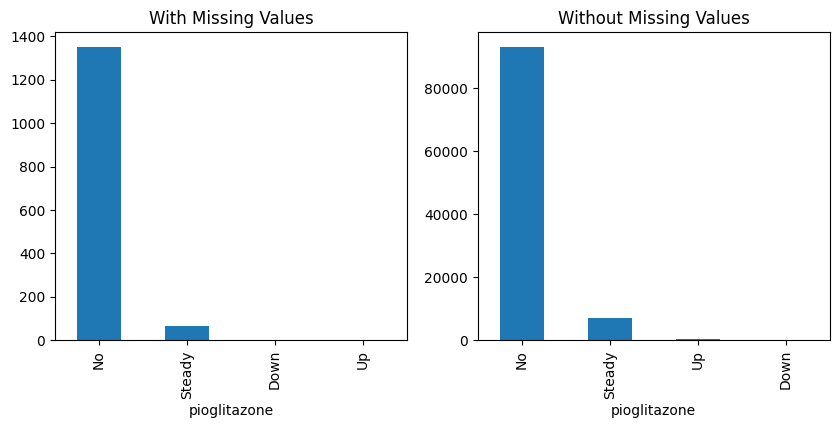

p-value of Chi-squared test: 0.011521127235232275
The missingness in 'pioglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


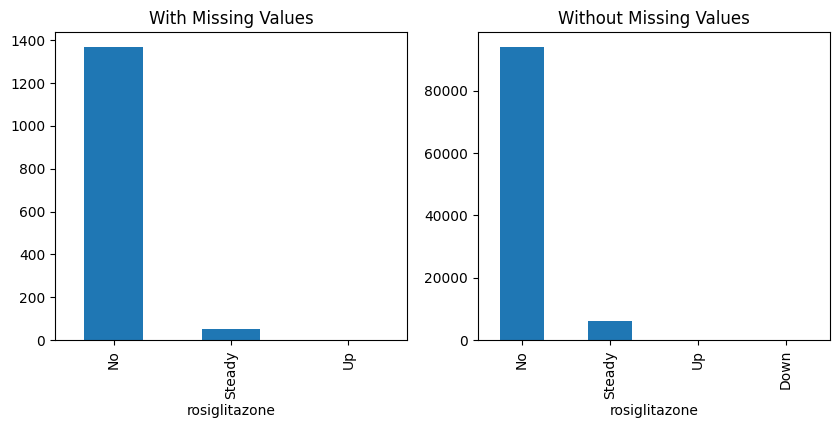

p-value of Chi-squared test: 0.0021292957979907007
The missingness in 'rosiglitazone' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


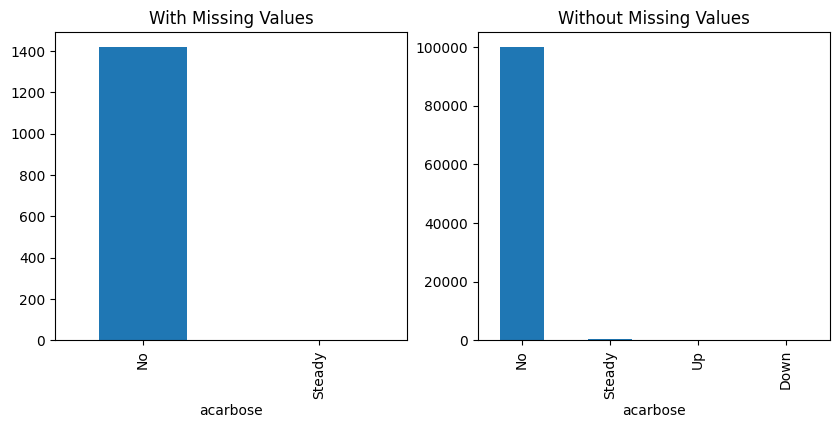

p-value of Chi-squared test: 0.9196050866074116
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


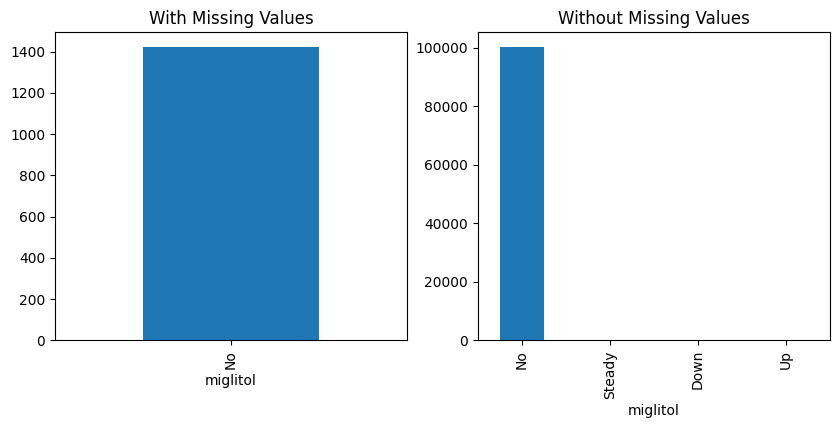

p-value of Chi-squared test: 0.9102226559424278
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


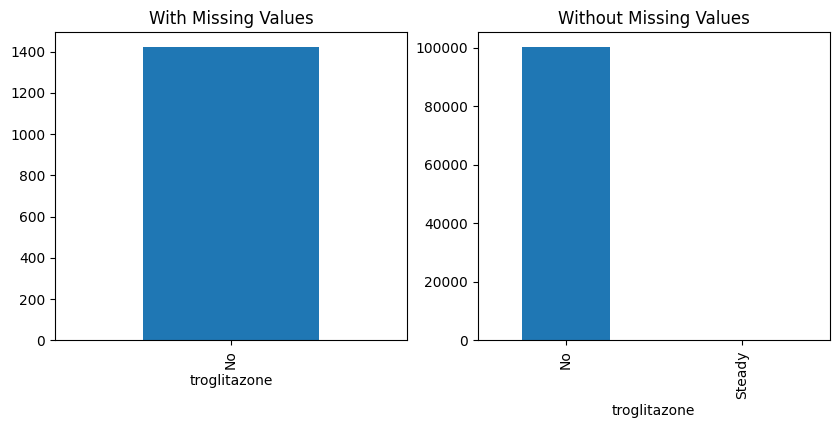

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


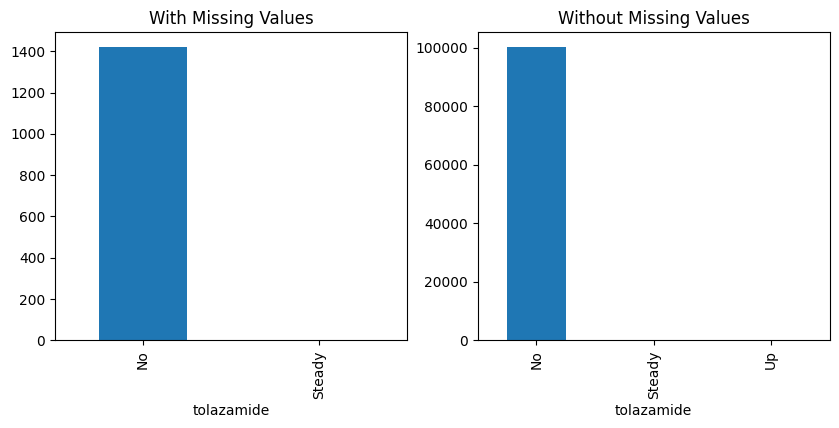

p-value of Chi-squared test: 0.12665870432211557
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


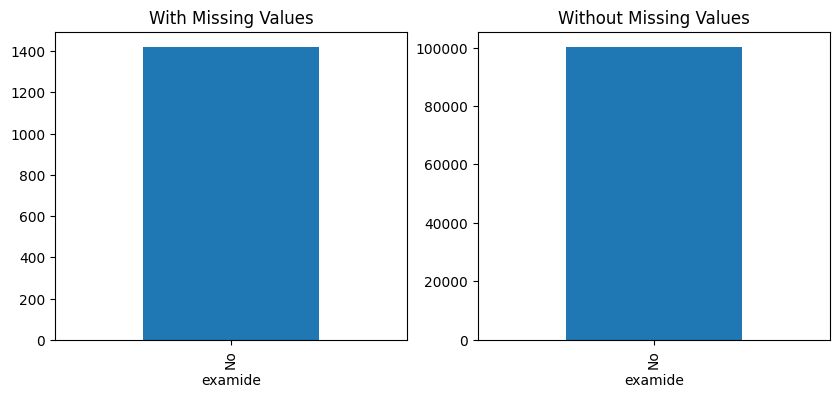

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


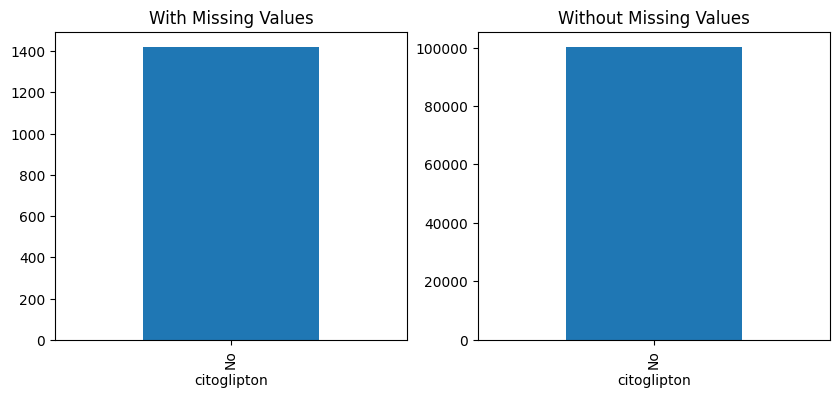

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:


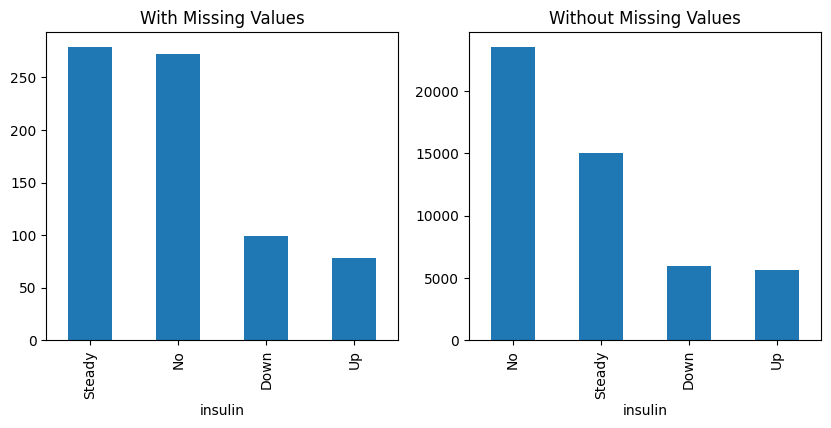

p-value of Chi-squared test: 3.867353989942772e-07
The missingness in 'insulin' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


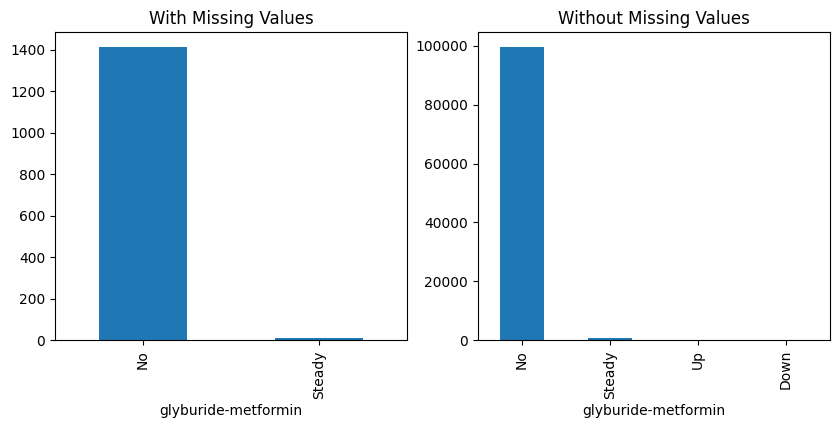

p-value of Chi-squared test: 0.9696637706890228
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


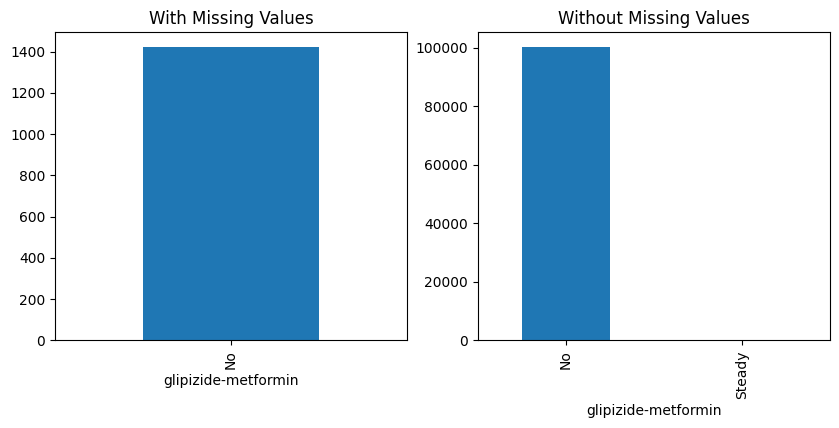

p-value of Chi-squared test: 1.0
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


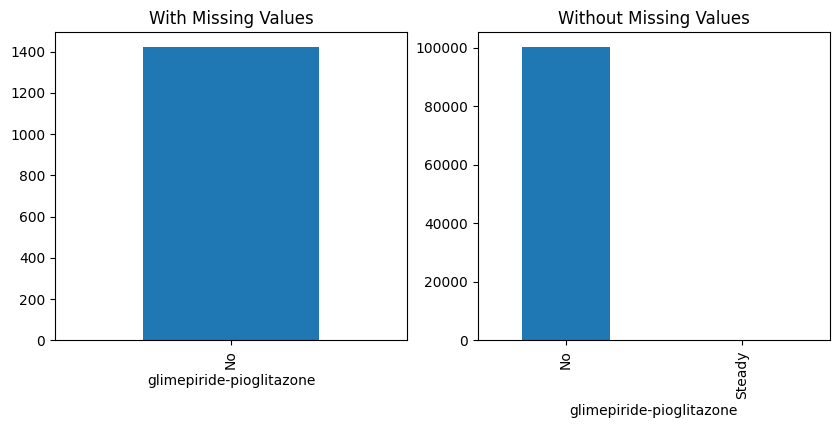

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


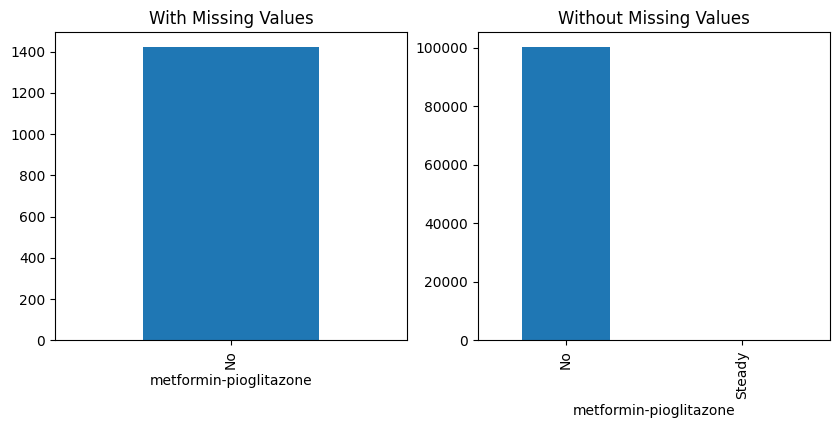

p-value of Chi-squared test: 1.0
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


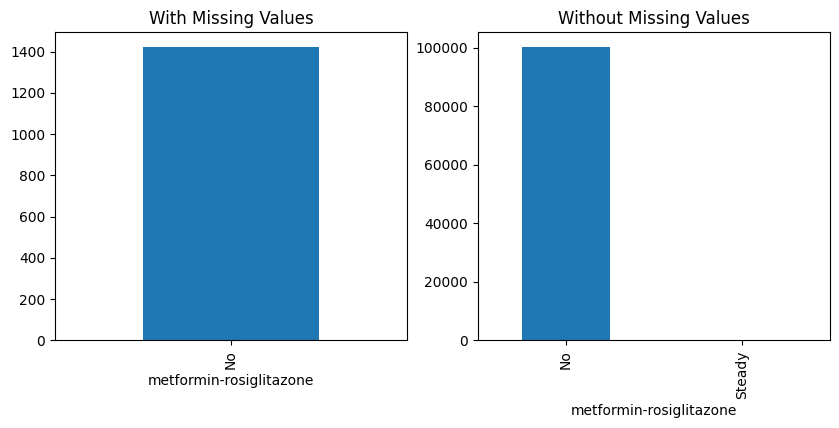

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


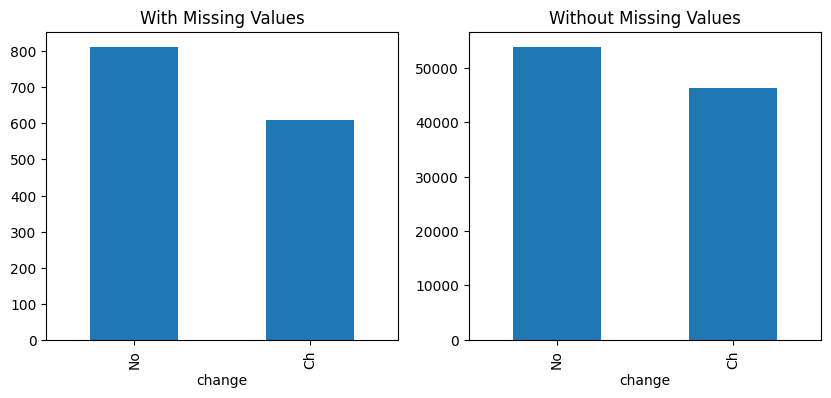

p-value of Chi-squared test: 0.012102248055045669
The missingness in 'change' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


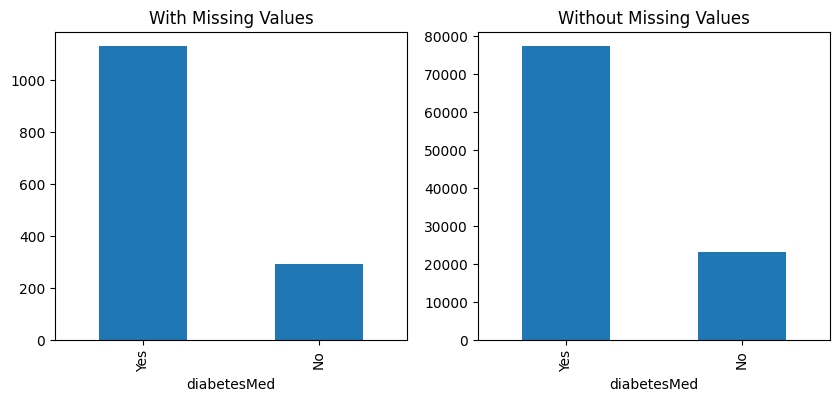

p-value of Chi-squared test: 0.03228739415834712
The missingness in 'diabetesMed' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


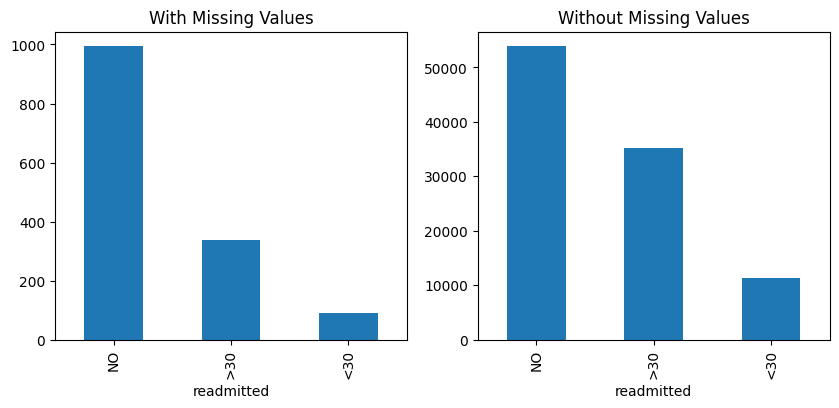

p-value of Chi-squared test: 4.4473994545540154e-33
The missingness in 'readmitted' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.diag_3.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')


### After going through the analysis we can say `diag_3` is of MCAR

## Detecting Missing type for `insulin`

Diagnosis Analysis of Missing Values for race:


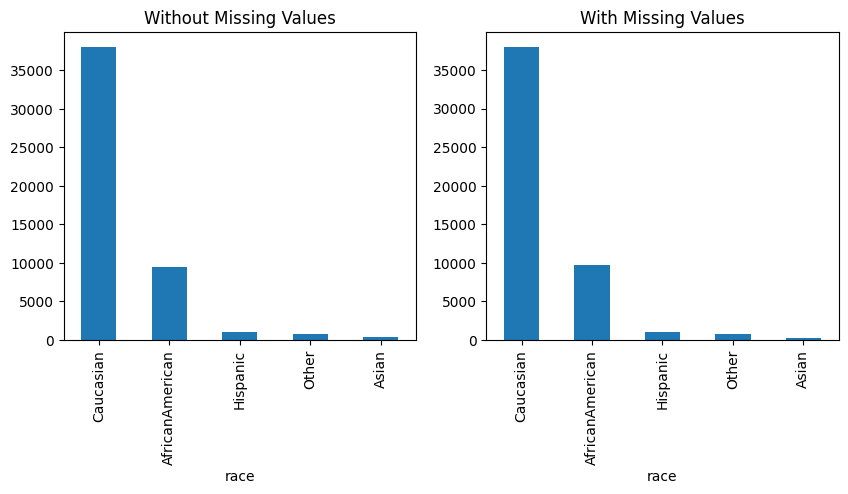

p-value of Chi-squared test: 0.06870018938702271
The missingness in 'race' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


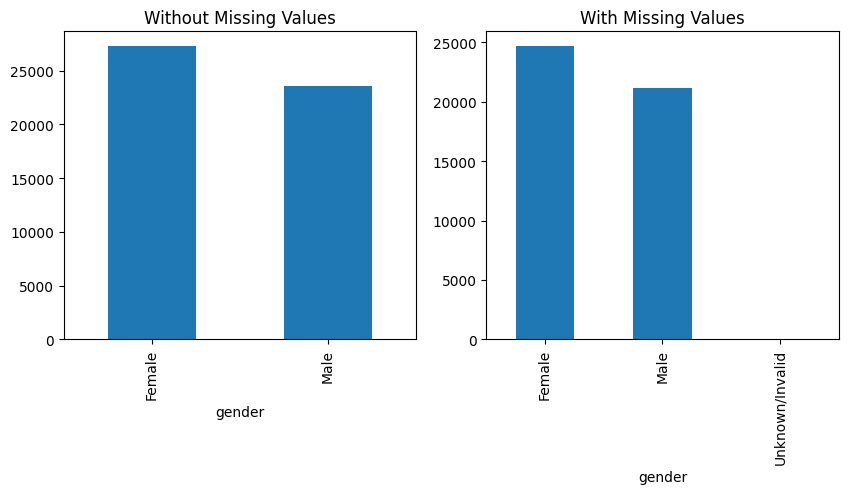

p-value of Chi-squared test: 0.21963090838824761
The missingness in 'gender' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


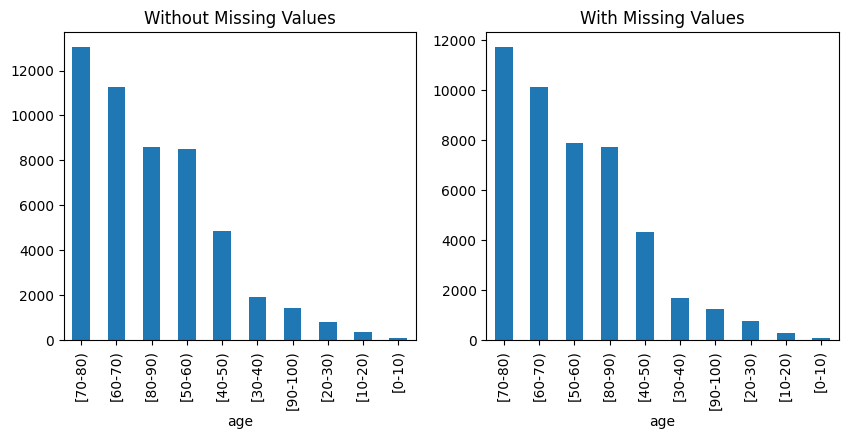

p-value of Chi-squared test: 0.21580784065251413
The missingness in 'age' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:


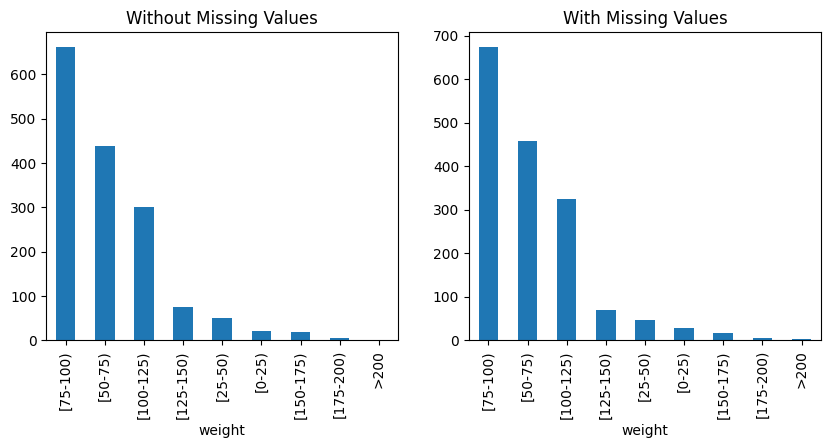

p-value of Chi-squared test: 0.963218700880508
The missingness in 'weight' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


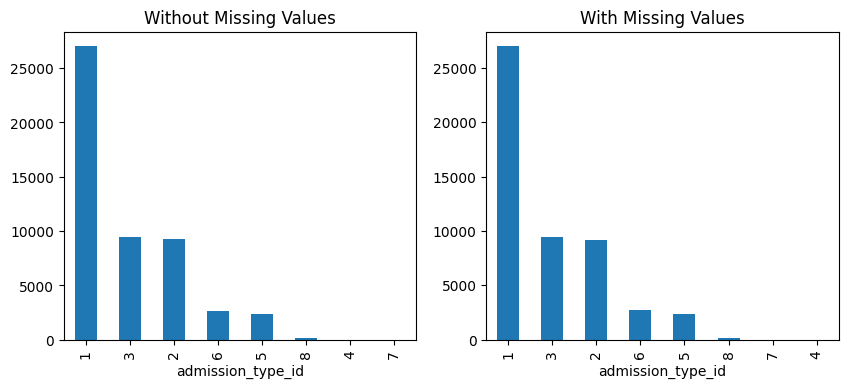

p-value of Chi-squared test: 0.4570174452580129
The missingness in 'admission_type_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:


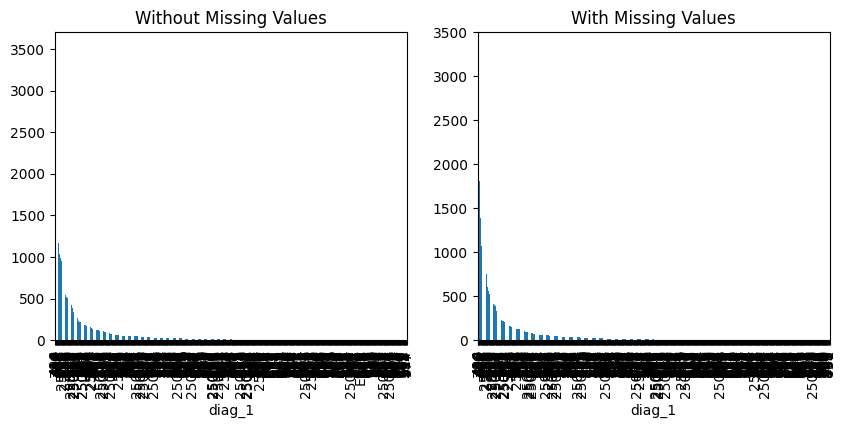

p-value of Chi-squared test: 0.7058489603706807
The missingness in 'diag_1' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


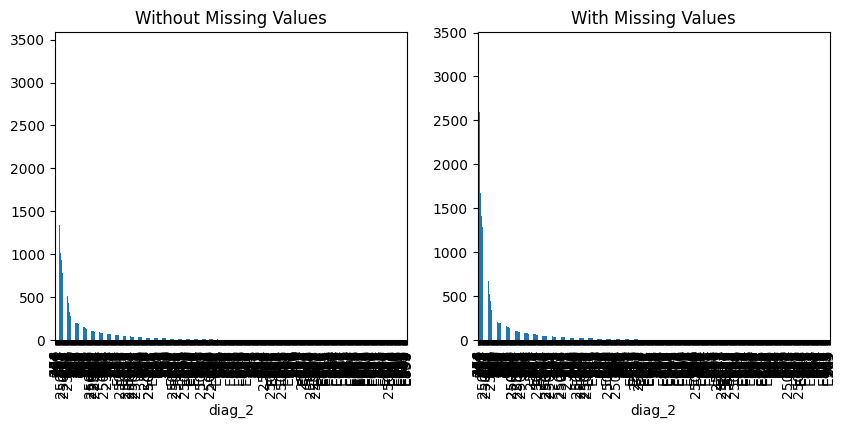

p-value of Chi-squared test: 0.8169203743745274
The missingness in 'diag_2' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


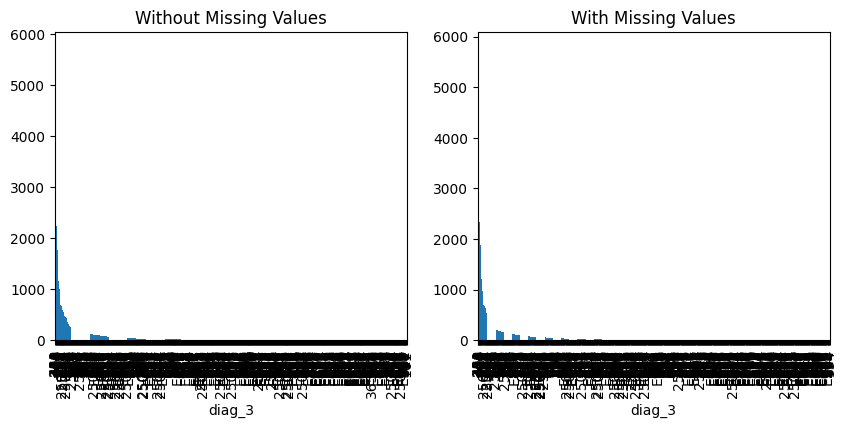

p-value of Chi-squared test: 0.10859025059561282
The missingness in 'diag_3' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


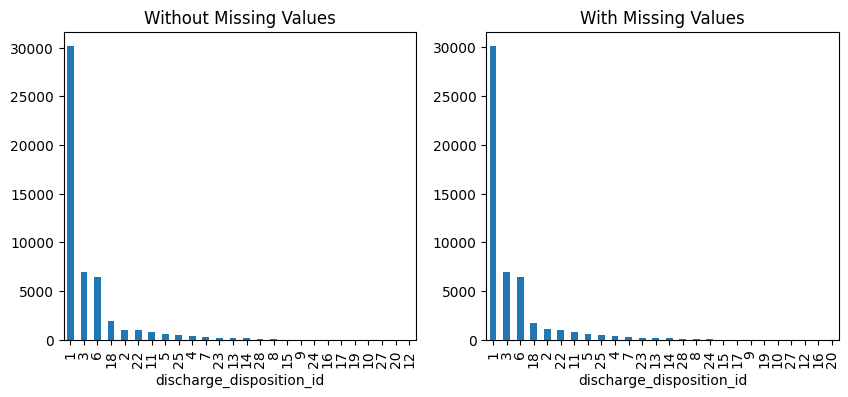

p-value of Chi-squared test: 0.13484040658688815
The missingness in 'discharge_disposition_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


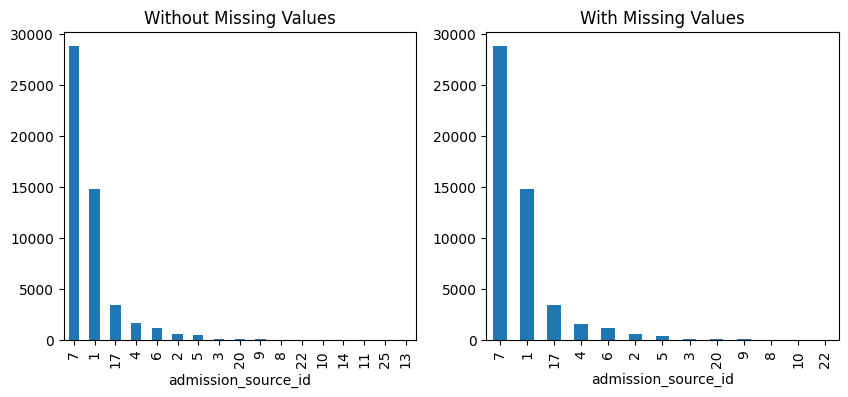

p-value of Chi-squared test: 0.7847943623350336
The missingness in 'admission_source_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


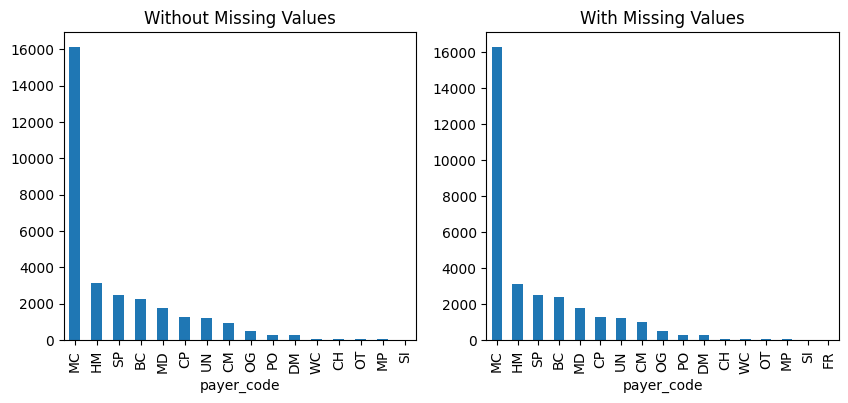

p-value of Chi-squared test: 0.9006033966704794
The missingness in 'payer_code' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


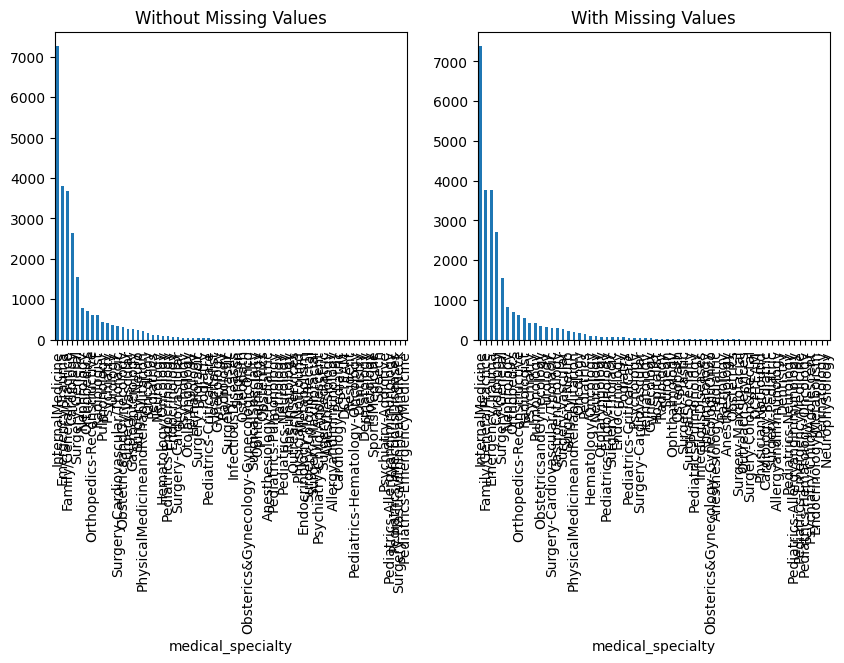

p-value of Chi-squared test: 0.5199248864712712
The missingness in 'medical_specialty' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


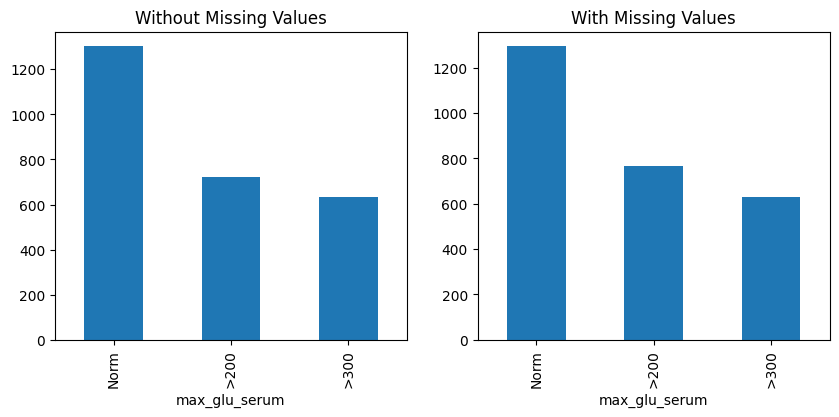

p-value of Chi-squared test: 0.543491095049135
The missingness in 'max_glu_serum' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


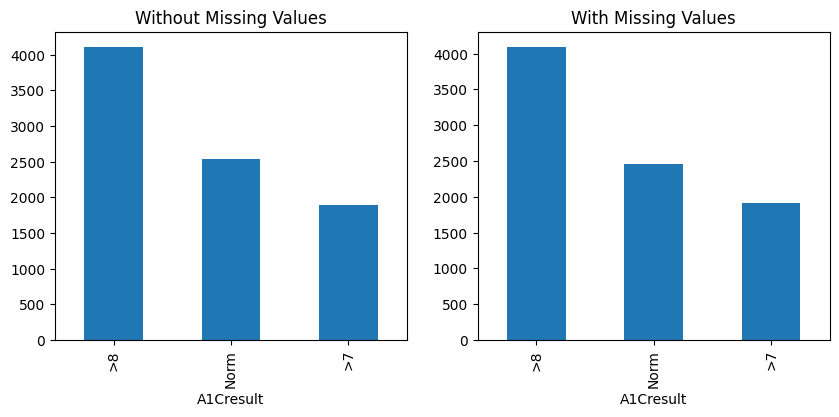

p-value of Chi-squared test: 0.5740547808863055
The missingness in 'A1Cresult' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


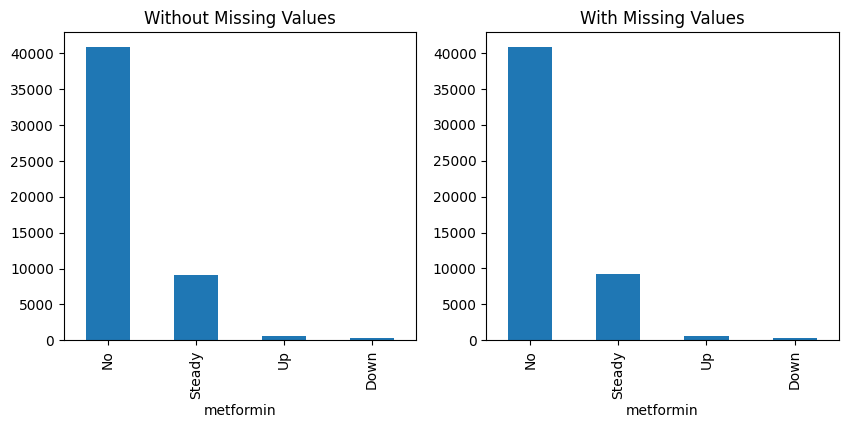

p-value of Chi-squared test: 0.5126353989408525
The missingness in 'metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


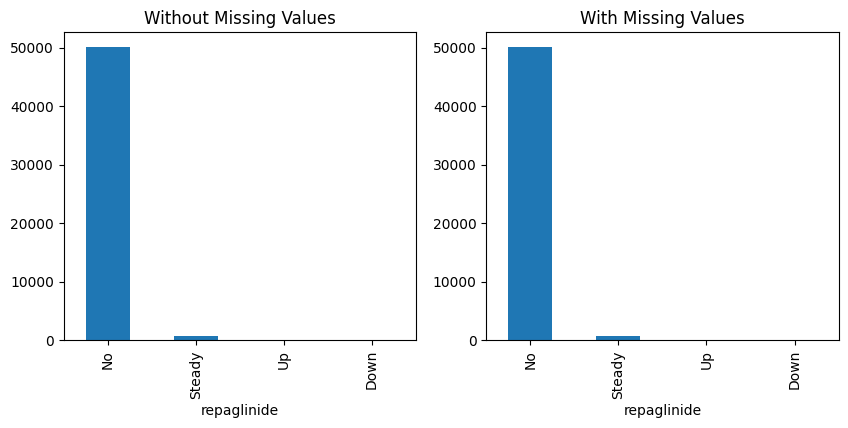

p-value of Chi-squared test: 0.9119778077639104
The missingness in 'repaglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


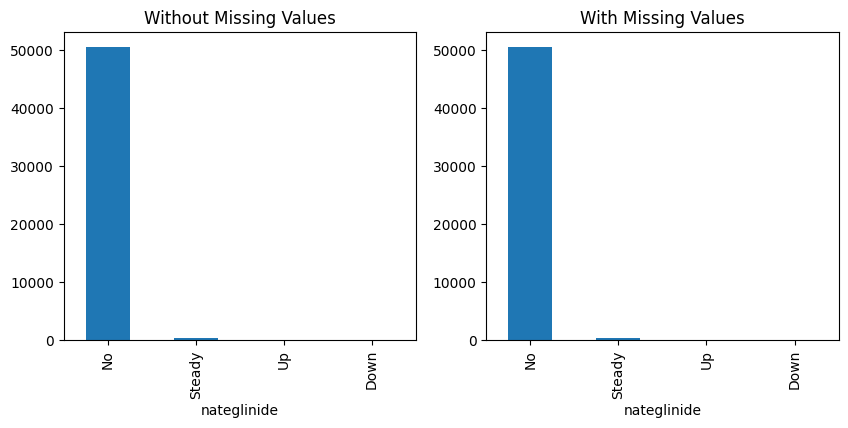

p-value of Chi-squared test: 0.989984878441102
The missingness in 'nateglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


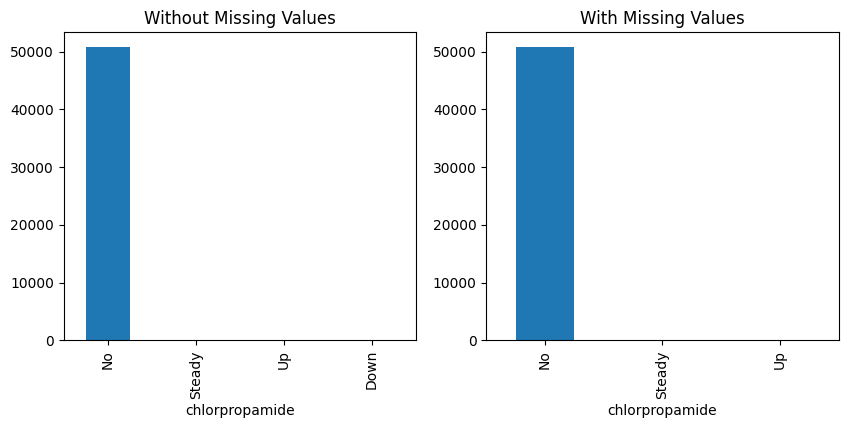

p-value of Chi-squared test: 0.6415313019618509
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


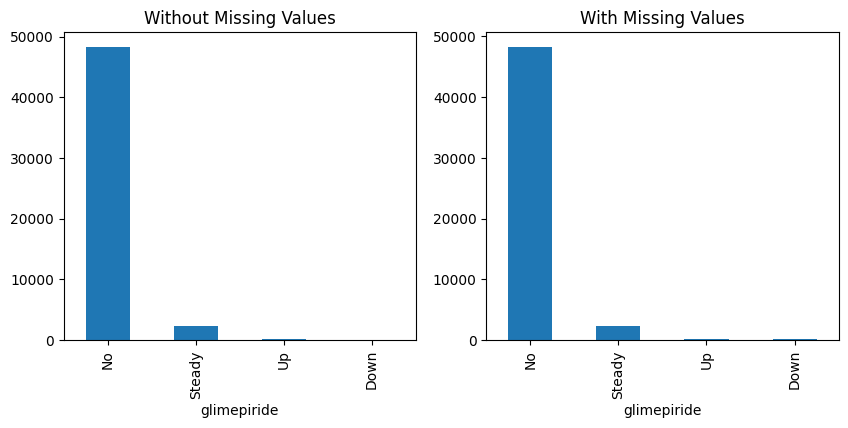

p-value of Chi-squared test: 0.01775833459250295
The missingness in 'glimepiride' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


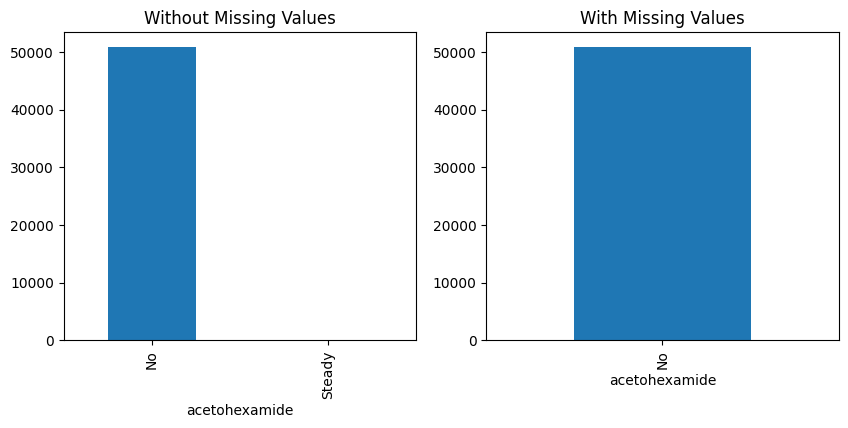

p-value of Chi-squared test: 1.0
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


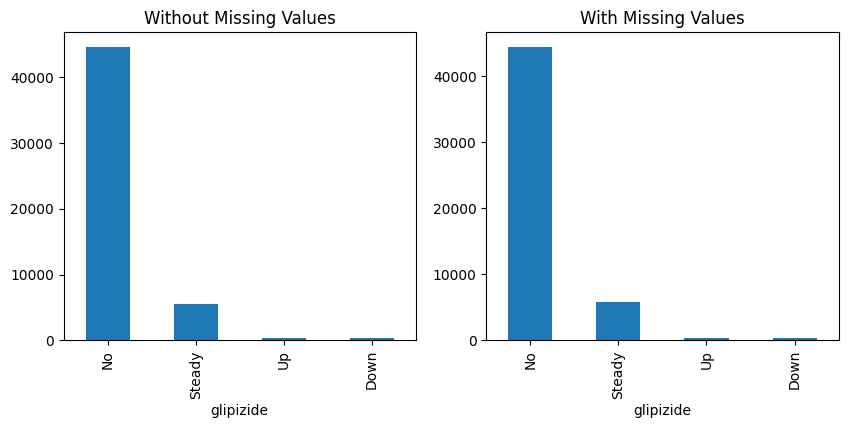

p-value of Chi-squared test: 0.1309237934641963
The missingness in 'glipizide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


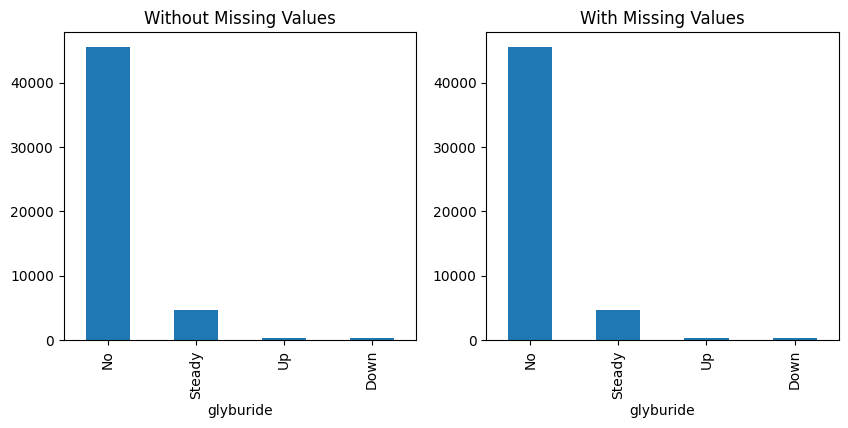

p-value of Chi-squared test: 0.9335267001074518
The missingness in 'glyburide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


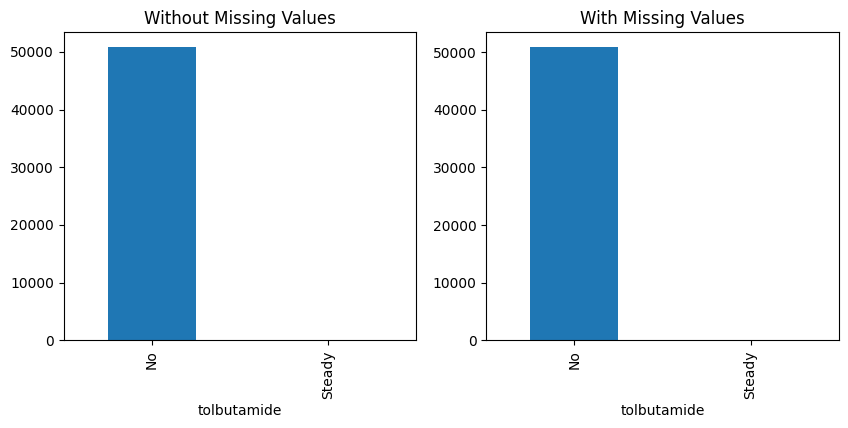

p-value of Chi-squared test: 0.09525542431177801
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


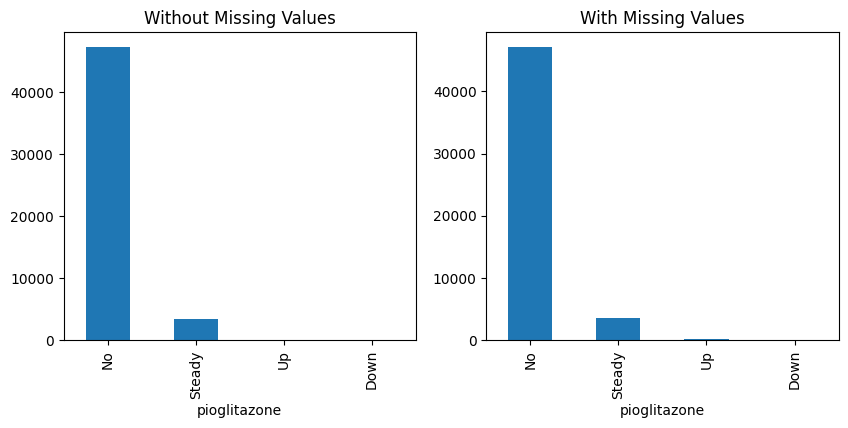

p-value of Chi-squared test: 0.31745529720523186
The missingness in 'pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


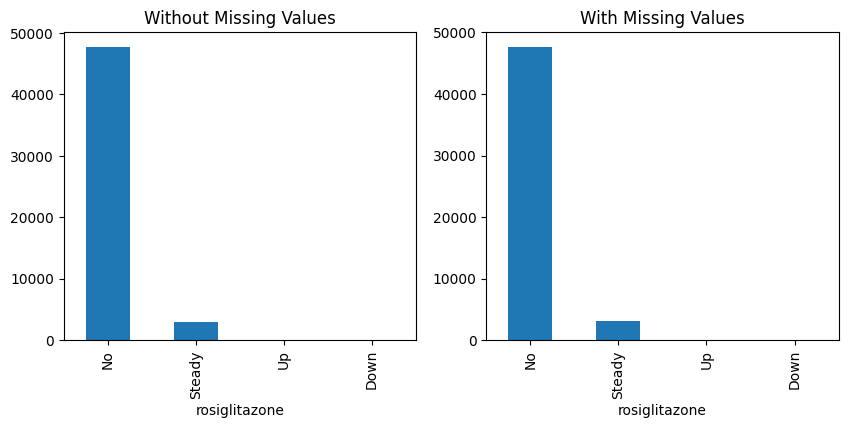

p-value of Chi-squared test: 0.2841591470099981
The missingness in 'rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


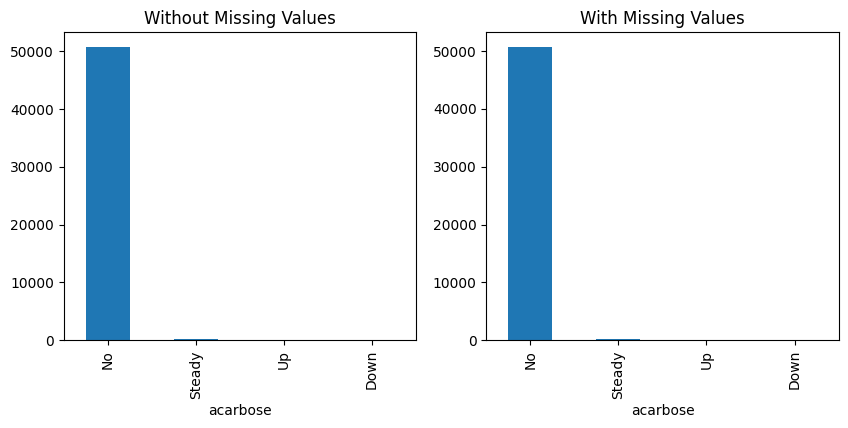

p-value of Chi-squared test: 0.40447878144968263
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


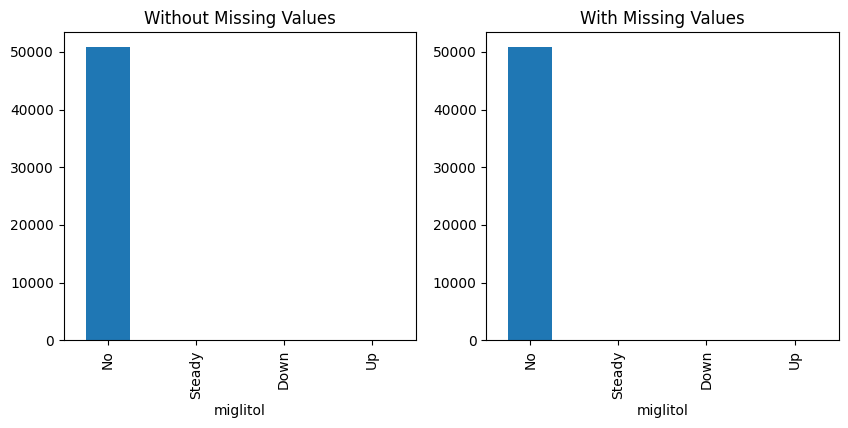

p-value of Chi-squared test: 0.9722143092278829
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


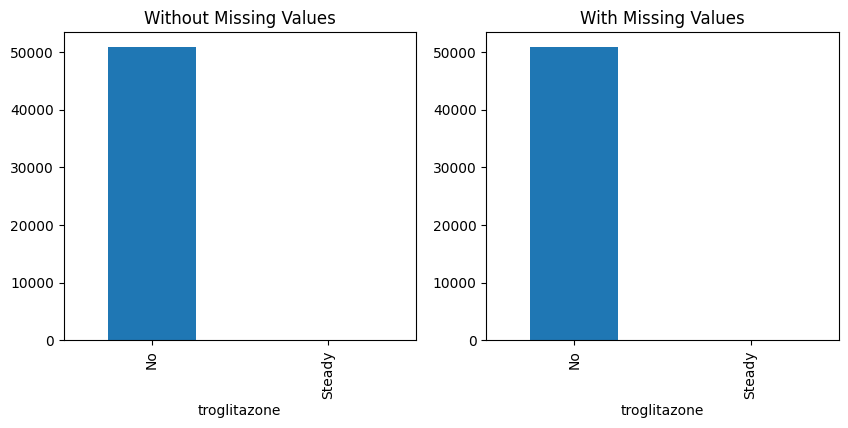

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


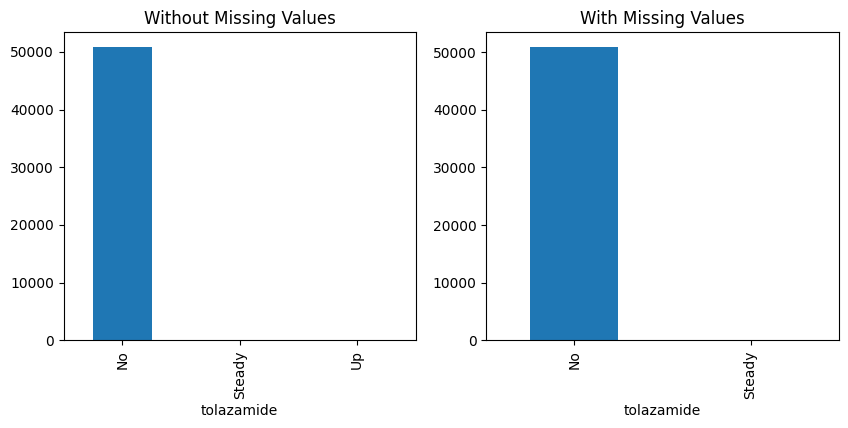

p-value of Chi-squared test: 0.26119098719619
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


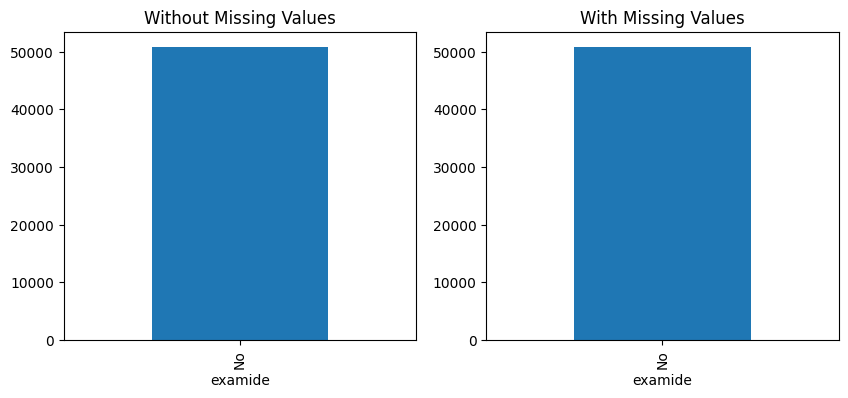

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


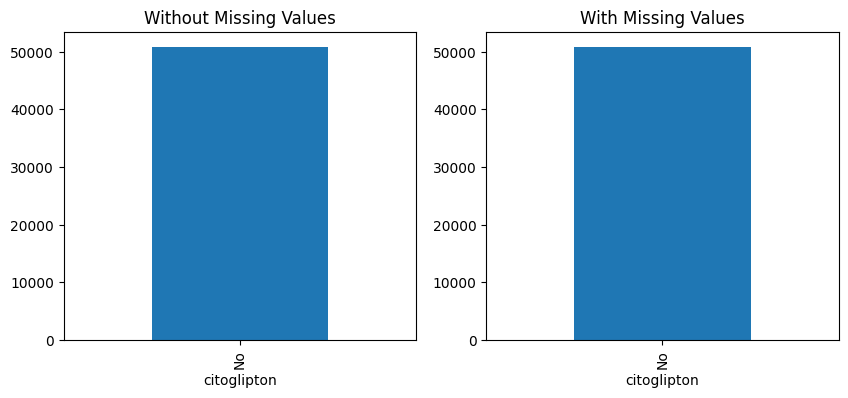

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:
No data for group: With Missing Values


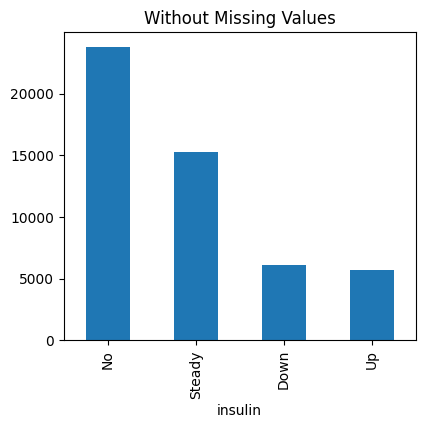

p-value of Chi-squared test: 1.0
The missingness in 'insulin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


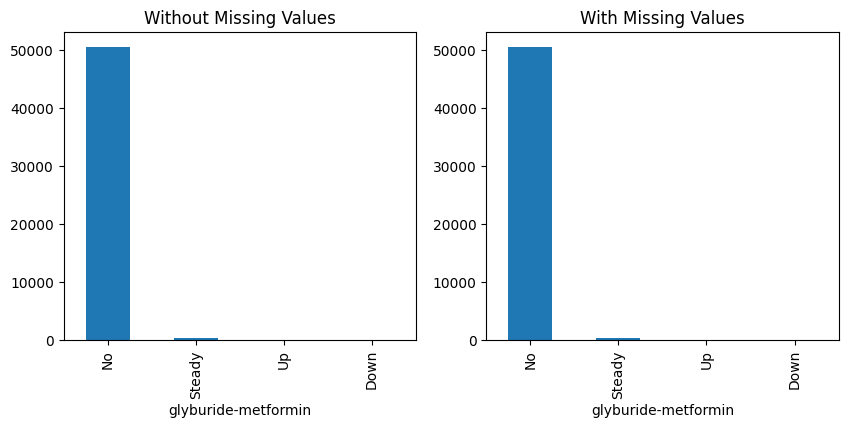

p-value of Chi-squared test: 0.9005420674350055
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


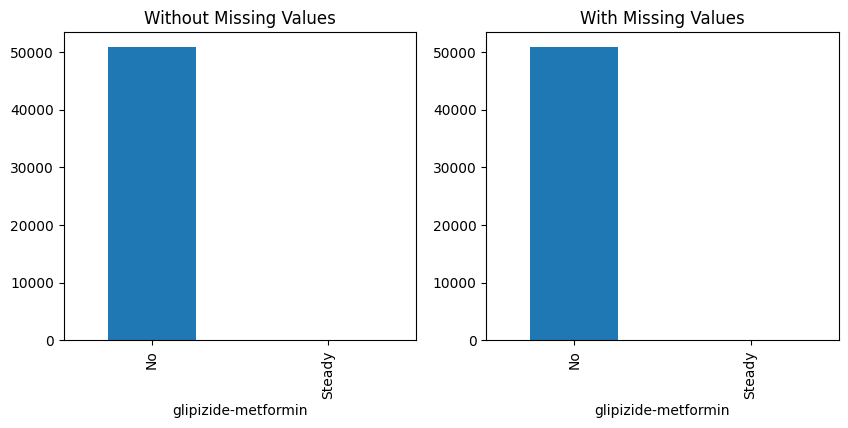

p-value of Chi-squared test: 0.5790755019971643
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


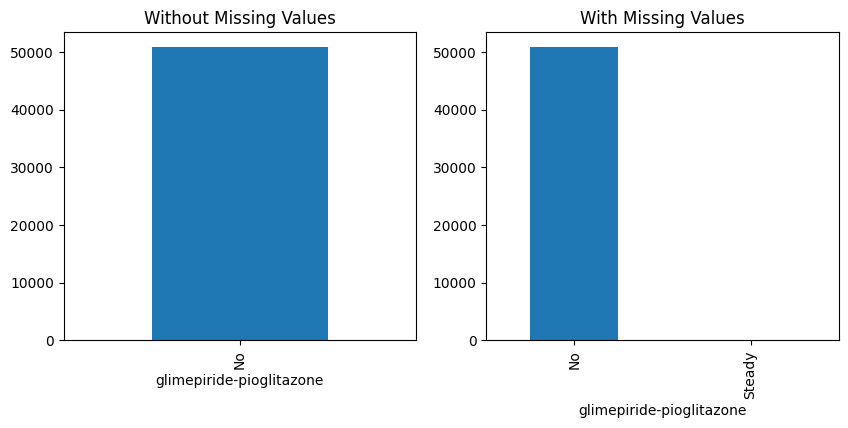

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


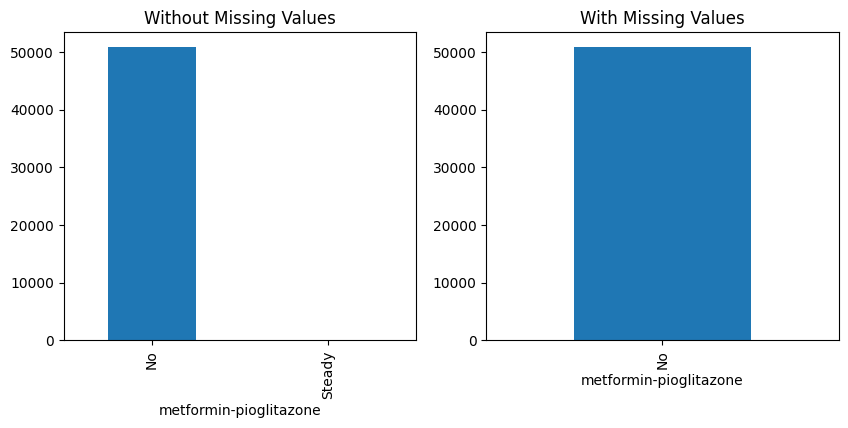

p-value of Chi-squared test: 1.0
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


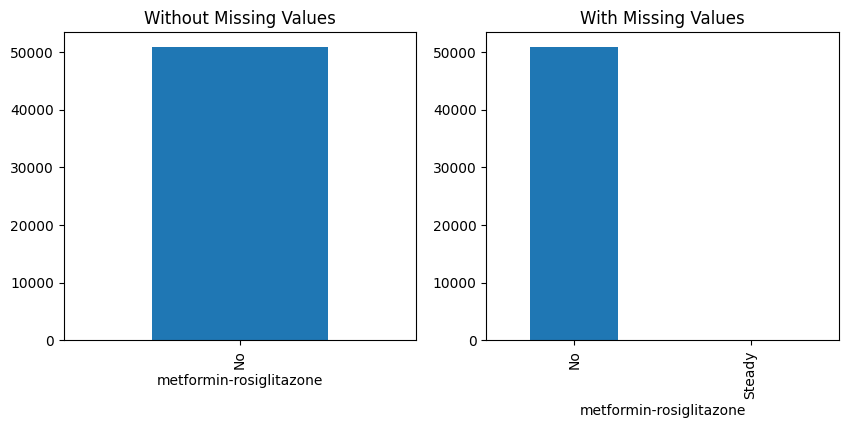

p-value of Chi-squared test: 0.47949580447095197
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


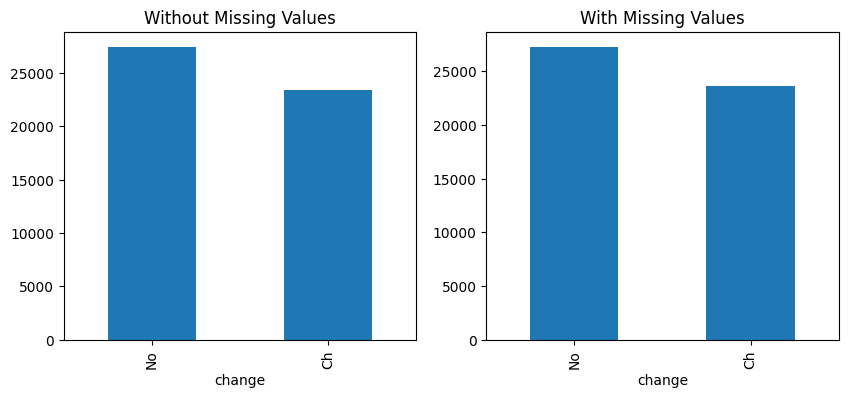

p-value of Chi-squared test: 0.33921079111361513
The missingness in 'change' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


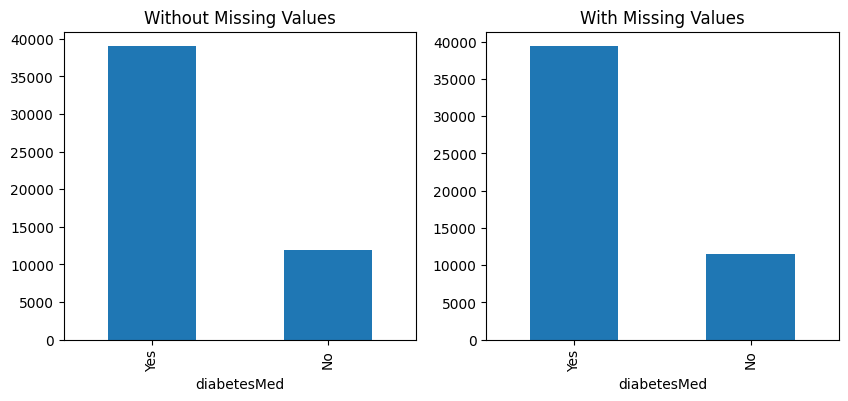

p-value of Chi-squared test: 0.004865589272535426
The missingness in 'diabetesMed' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


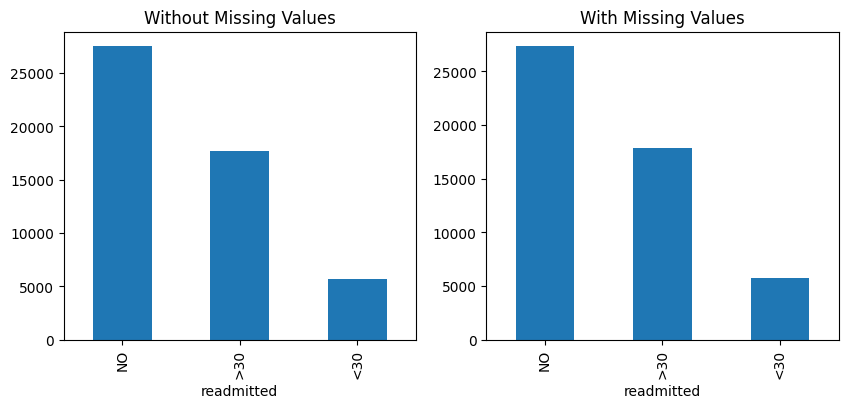

p-value of Chi-squared test: 0.551935335837979
The missingness in 'readmitted' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.insulin.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

Diagnosis Analysis of Missing Values for race:


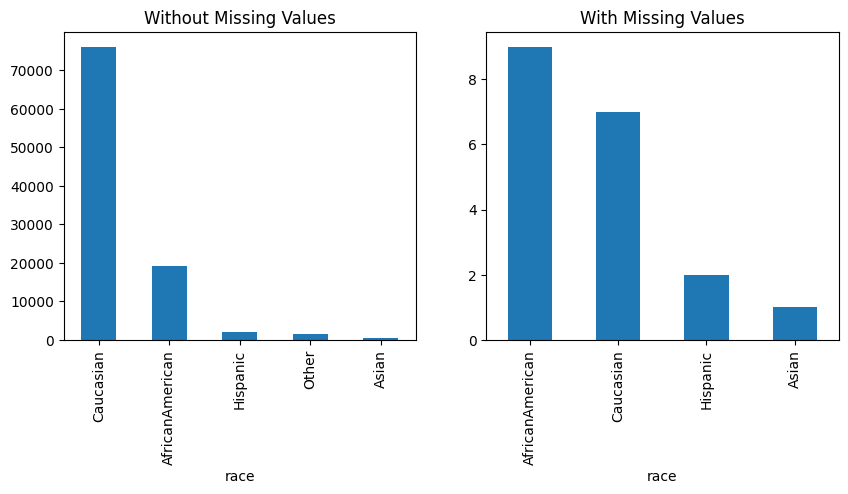

p-value of Chi-squared test: 5.2490650749405074e-05
The missingness in 'race' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for gender:


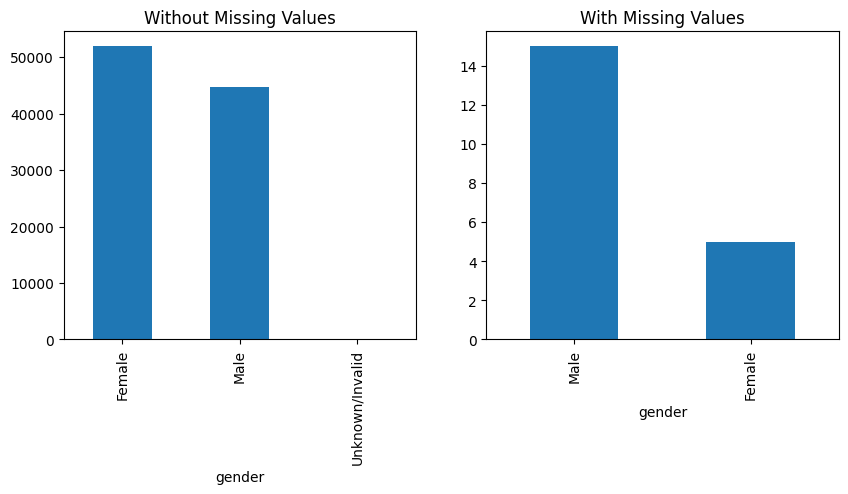

p-value of Chi-squared test: 0.036041527810930535
The missingness in 'gender' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for age:


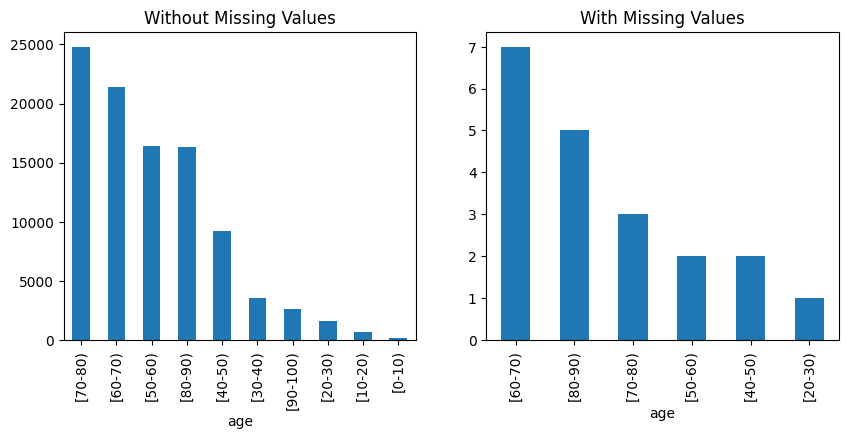

p-value of Chi-squared test: 0.6792374003742188
The missingness in 'age' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for weight:
No data for group: With Missing Values


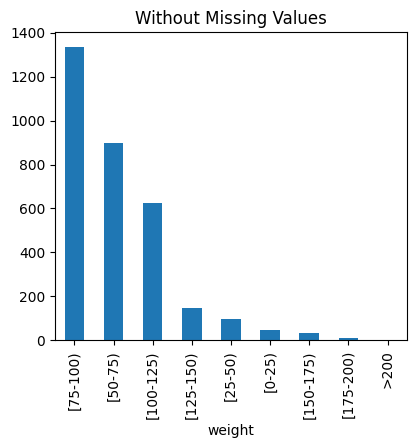

p-value of Chi-squared test: 1.0
The missingness in 'weight' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_type_id:


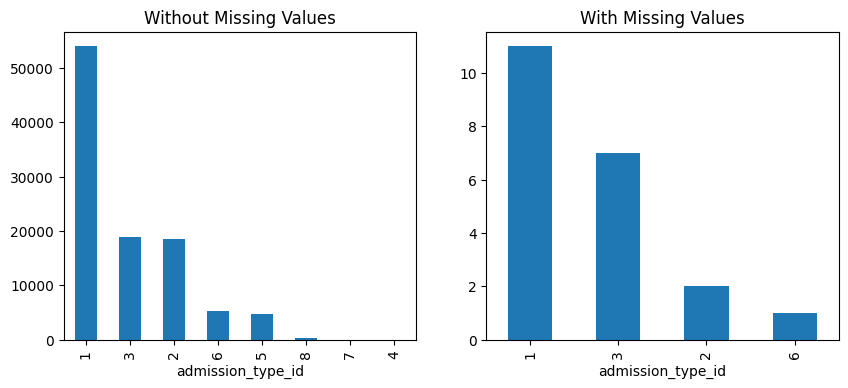

p-value of Chi-squared test: 0.7314410943634123
The missingness in 'admission_type_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_1:
No data for group: With Missing Values


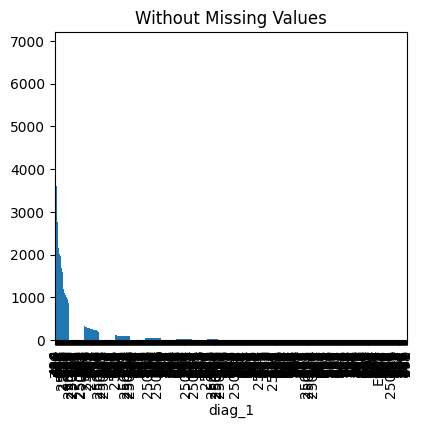

p-value of Chi-squared test: 1.0
The missingness in 'diag_1' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_2:


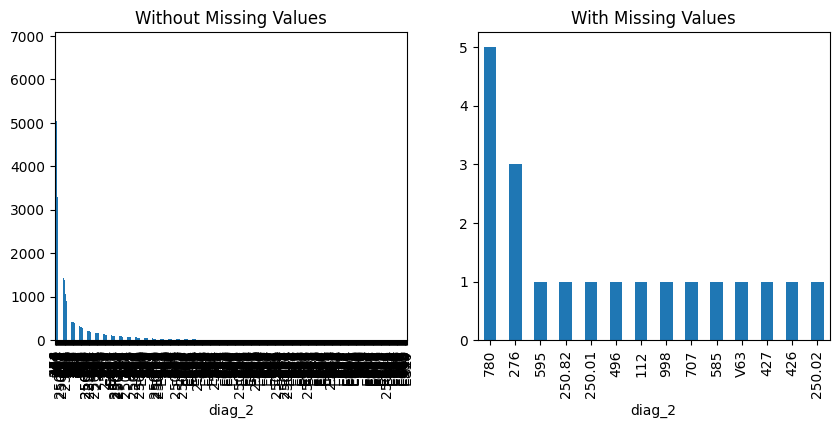

p-value of Chi-squared test: 1.0
The missingness in 'diag_2' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diag_3:


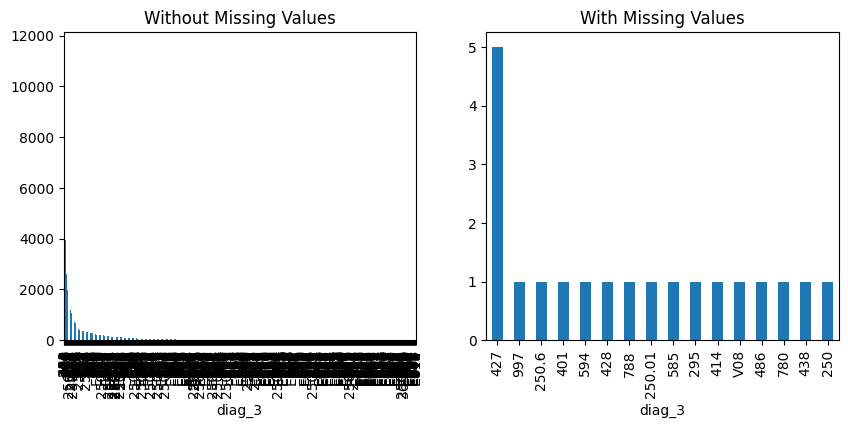

p-value of Chi-squared test: 0.0004909177187276059
The missingness in 'diag_3' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for discharge_disposition_id:


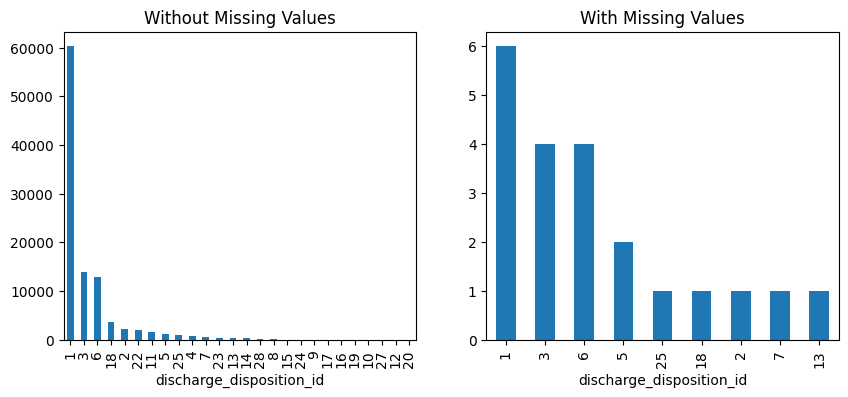

p-value of Chi-squared test: 0.04366765415747362
The missingness in 'discharge_disposition_id' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for admission_source_id:


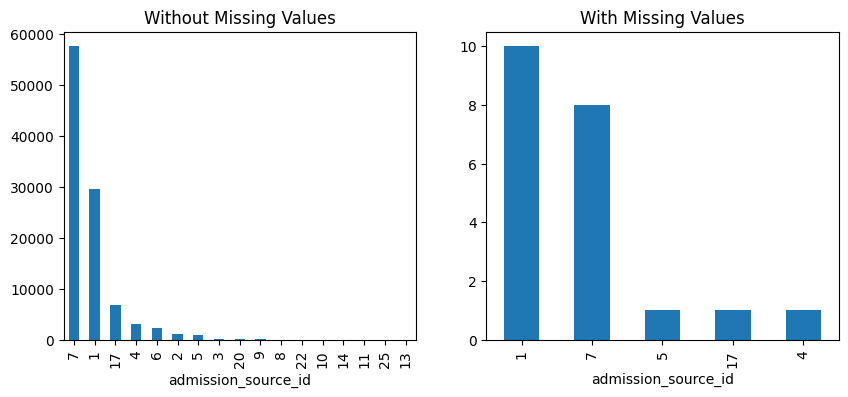

p-value of Chi-squared test: 0.9256212057055785
The missingness in 'admission_source_id' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for payer_code:


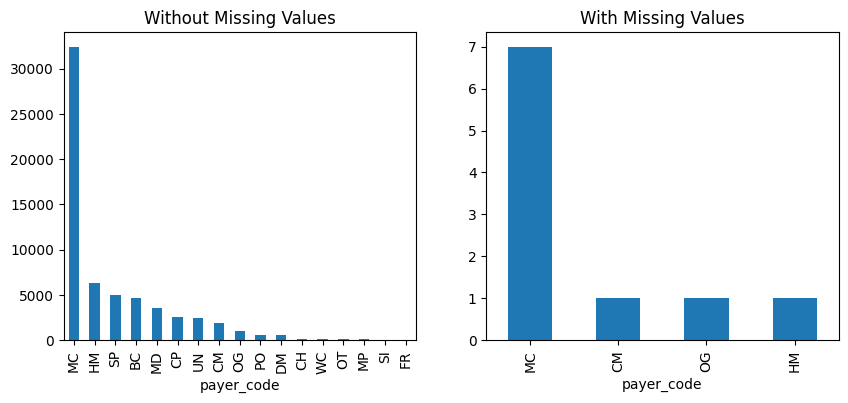

p-value of Chi-squared test: 0.8958844770098371
The missingness in 'payer_code' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for medical_specialty:


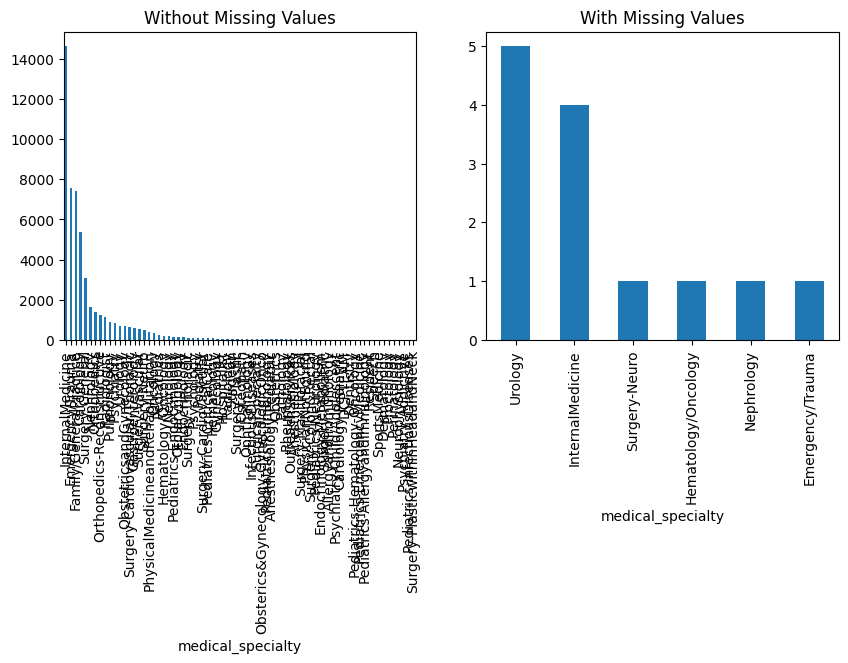

p-value of Chi-squared test: 8.641797473380354e-10
The missingness in 'medical_specialty' is likely **not completely at random** (p < 0.05).
This suggests a significant relationship between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for max_glu_serum:


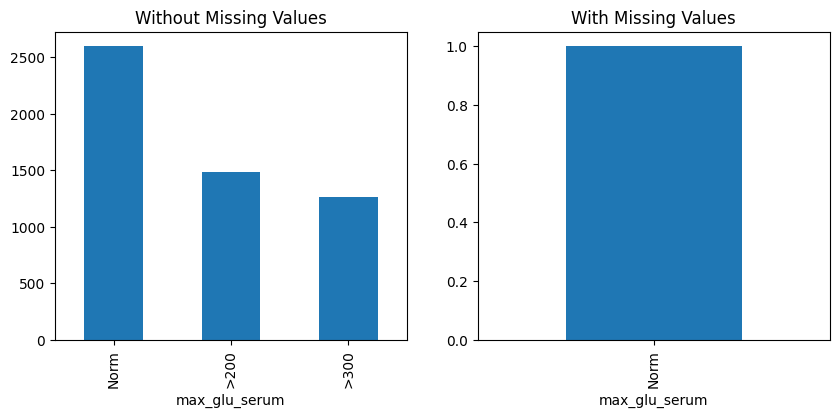

p-value of Chi-squared test: 0.5889797027231374
The missingness in 'max_glu_serum' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for A1Cresult:


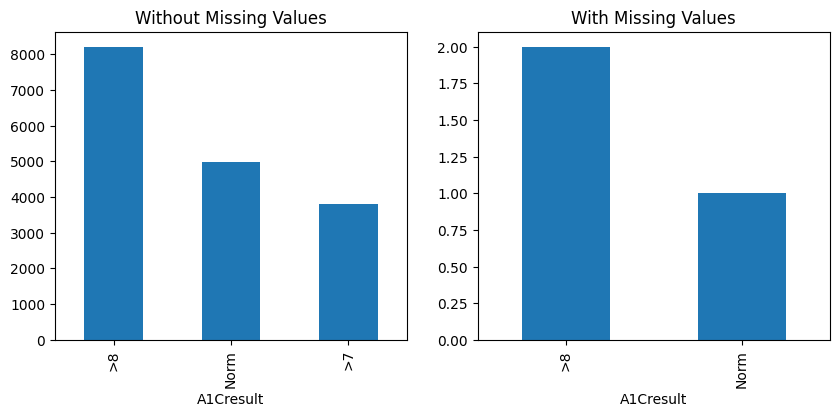

p-value of Chi-squared test: 0.638032842438614
The missingness in 'A1Cresult' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin:


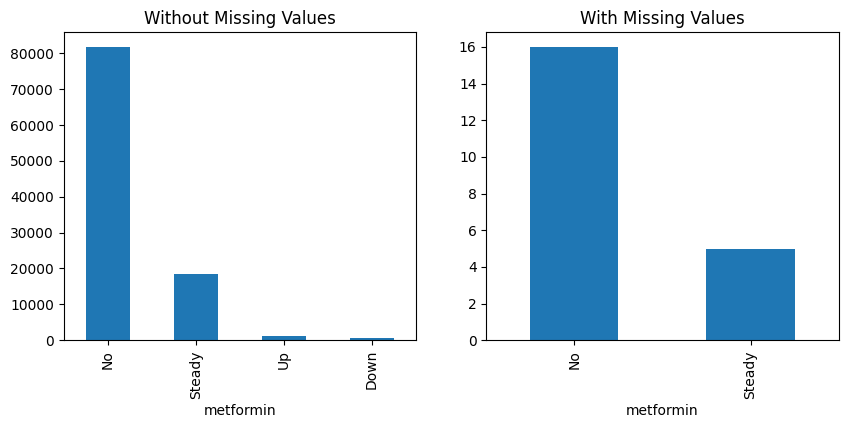

p-value of Chi-squared test: 0.8557170146640316
The missingness in 'metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for repaglinide:


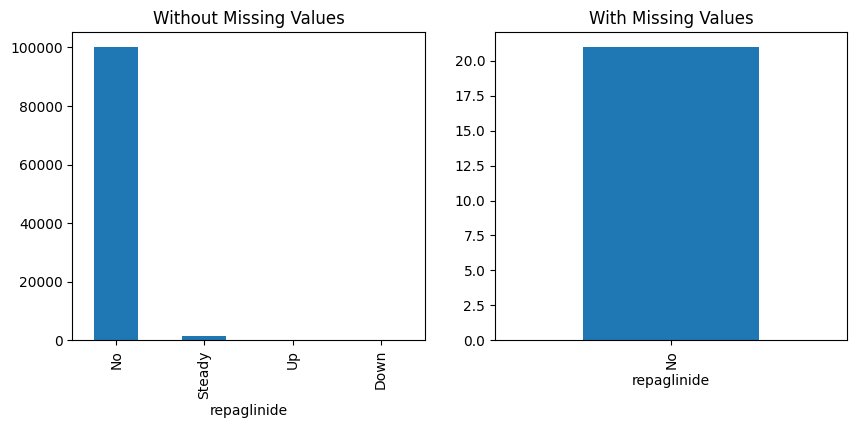

p-value of Chi-squared test: 0.9557380186375941
The missingness in 'repaglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for nateglinide:


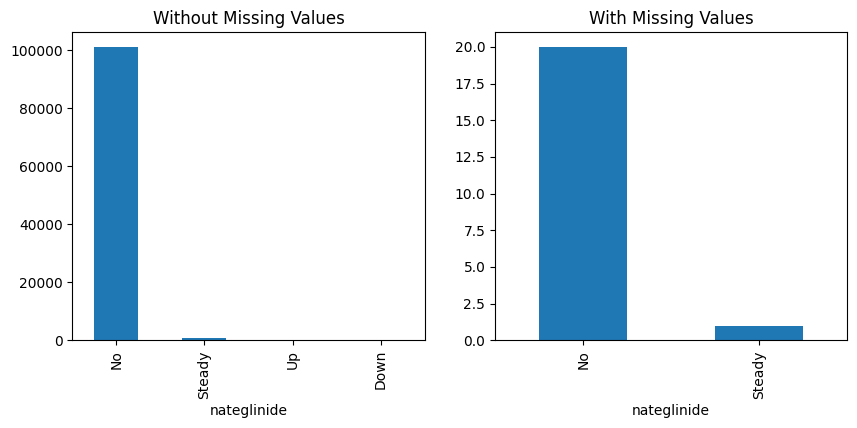

p-value of Chi-squared test: 0.14253372798051883
The missingness in 'nateglinide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for chlorpropamide:


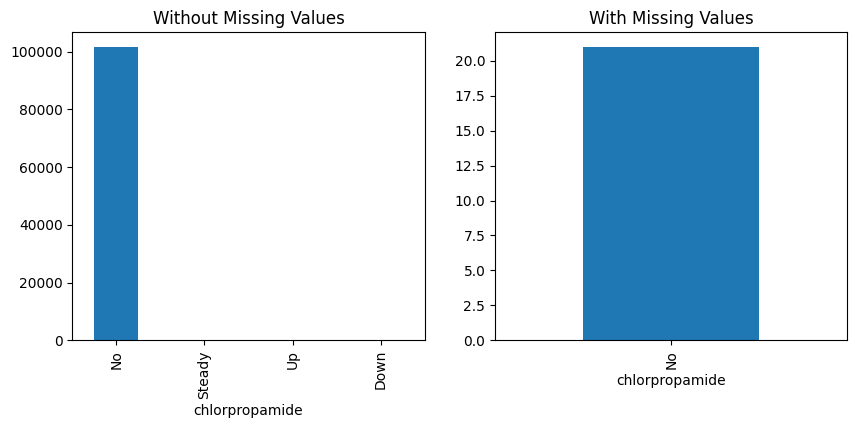

p-value of Chi-squared test: 0.9993735835854004
The missingness in 'chlorpropamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride:


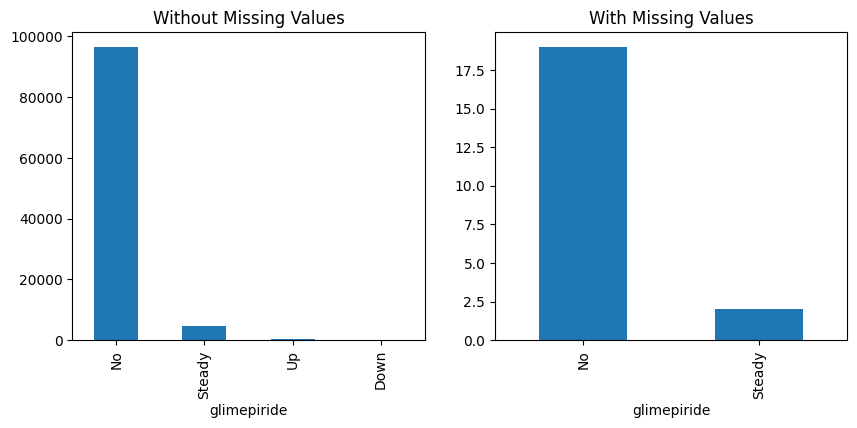

p-value of Chi-squared test: 0.7373432897707715
The missingness in 'glimepiride' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acetohexamide:


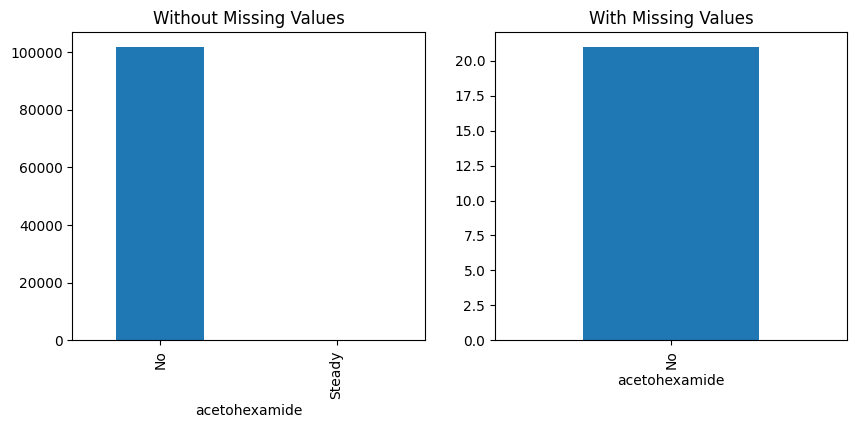

p-value of Chi-squared test: 1.0
The missingness in 'acetohexamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide:


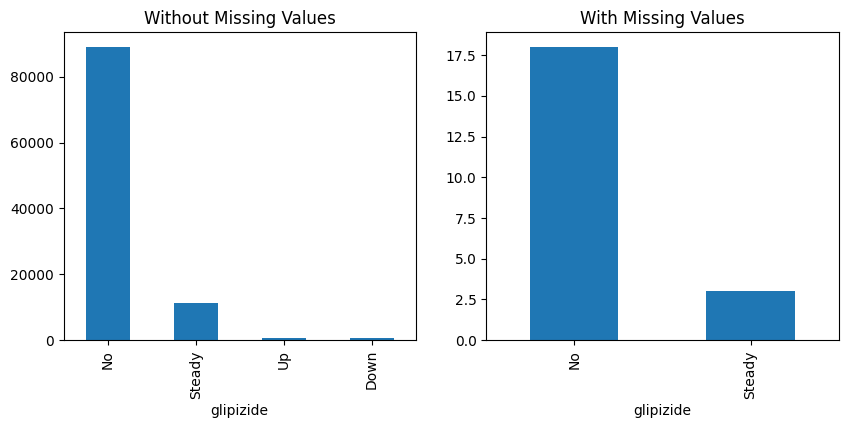

p-value of Chi-squared test: 0.926190616615718
The missingness in 'glipizide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide:


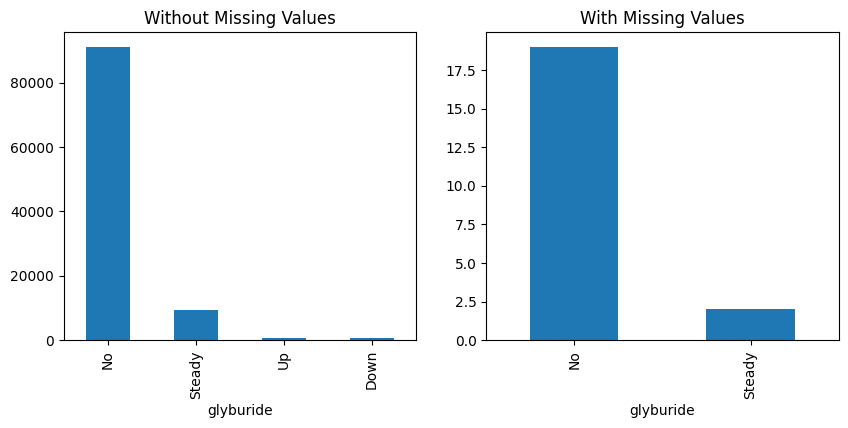

p-value of Chi-squared test: 0.9619033738392014
The missingness in 'glyburide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolbutamide:


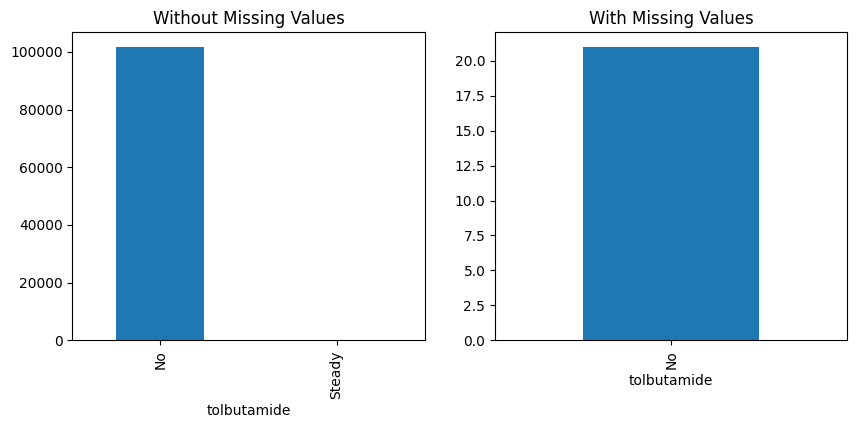

p-value of Chi-squared test: 1.0
The missingness in 'tolbutamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for pioglitazone:


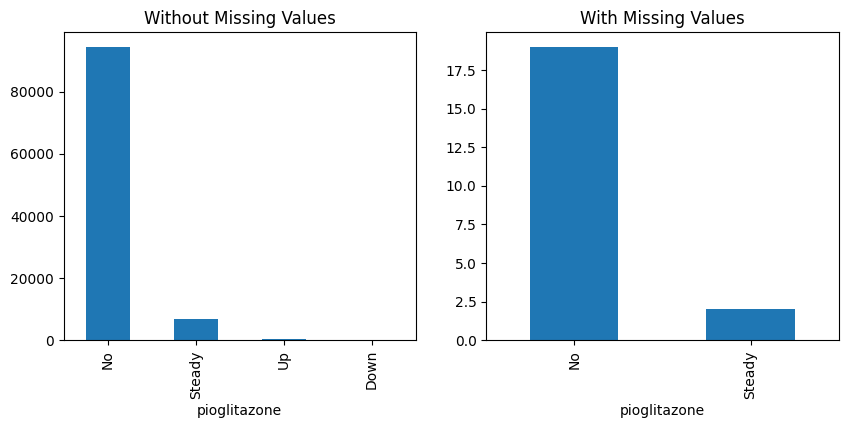

p-value of Chi-squared test: 0.9594408842512695
The missingness in 'pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for rosiglitazone:


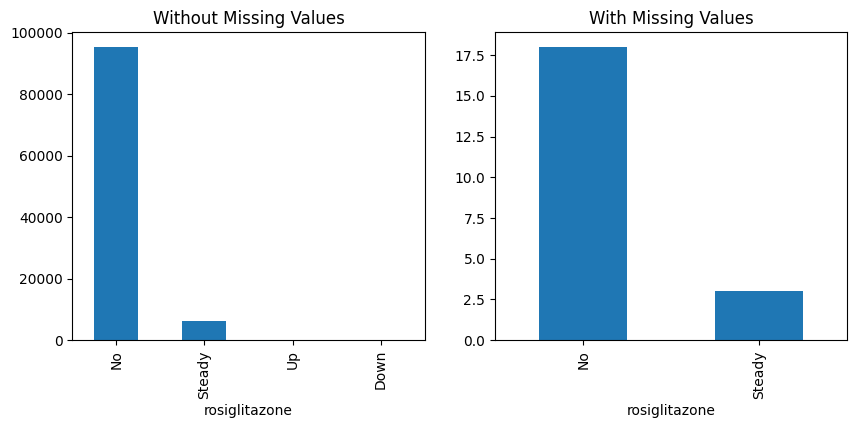

p-value of Chi-squared test: 0.45603368460349025
The missingness in 'rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for acarbose:


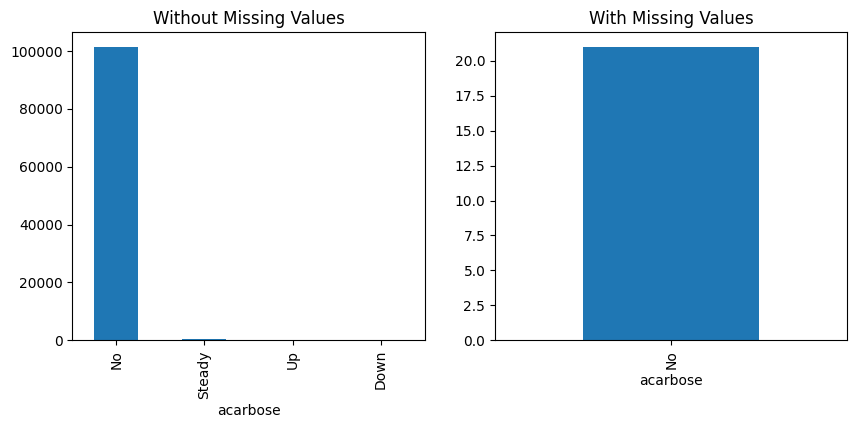

p-value of Chi-squared test: 0.9957986747296995
The missingness in 'acarbose' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for miglitol:


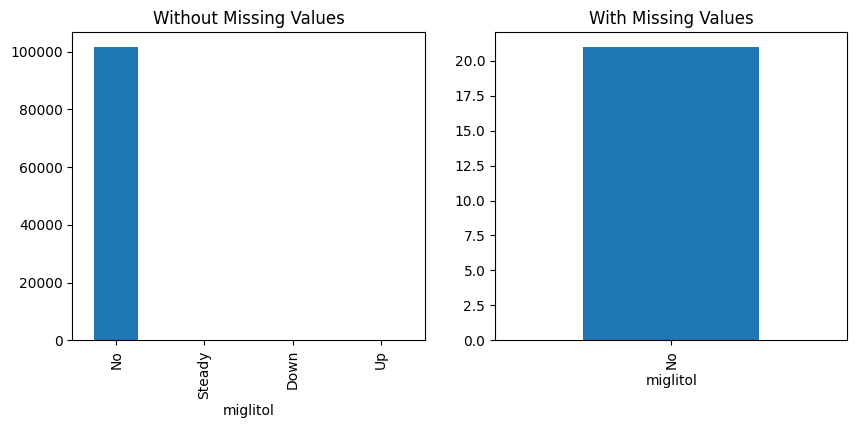

p-value of Chi-squared test: 0.9998155941029165
The missingness in 'miglitol' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for troglitazone:


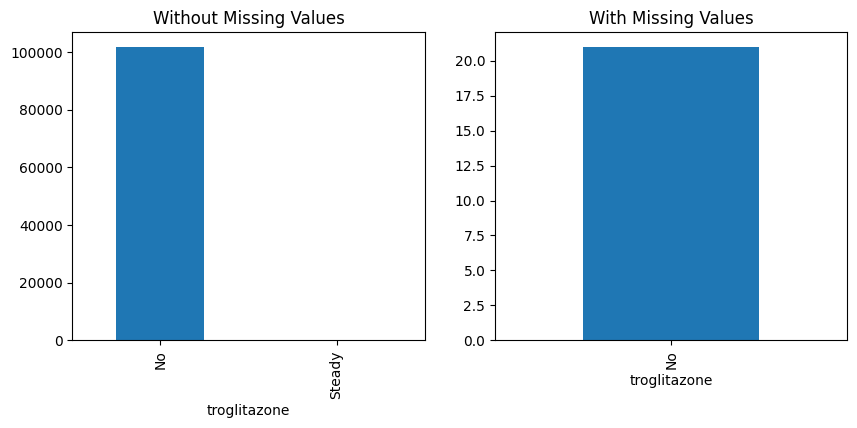

p-value of Chi-squared test: 1.0
The missingness in 'troglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for tolazamide:


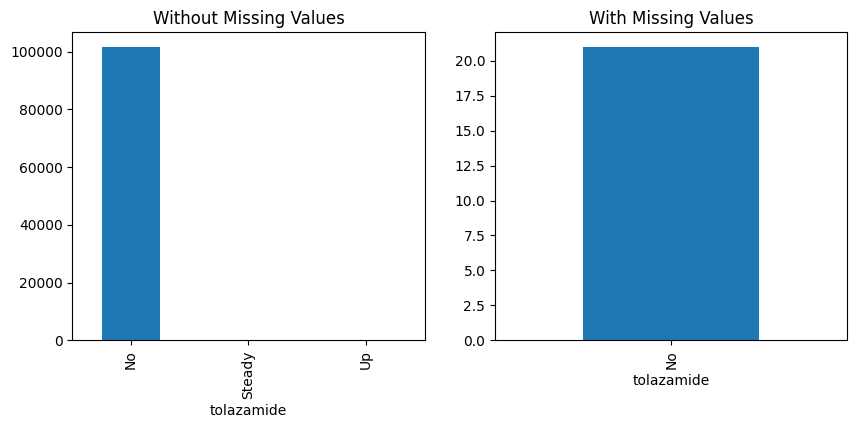

p-value of Chi-squared test: 0.9959817839082945
The missingness in 'tolazamide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for examide:


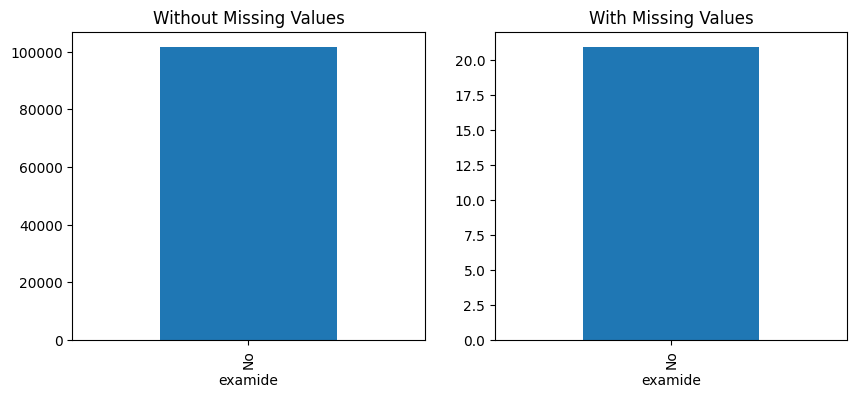

p-value of Chi-squared test: 1.0
The missingness in 'examide' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for citoglipton:


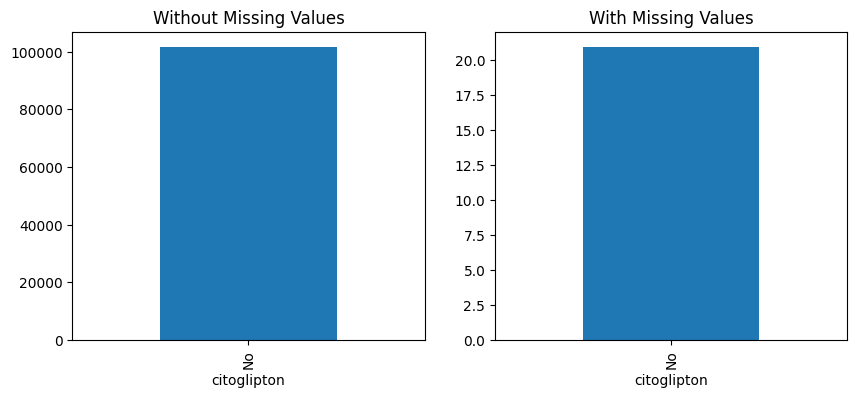

p-value of Chi-squared test: 1.0
The missingness in 'citoglipton' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for insulin:


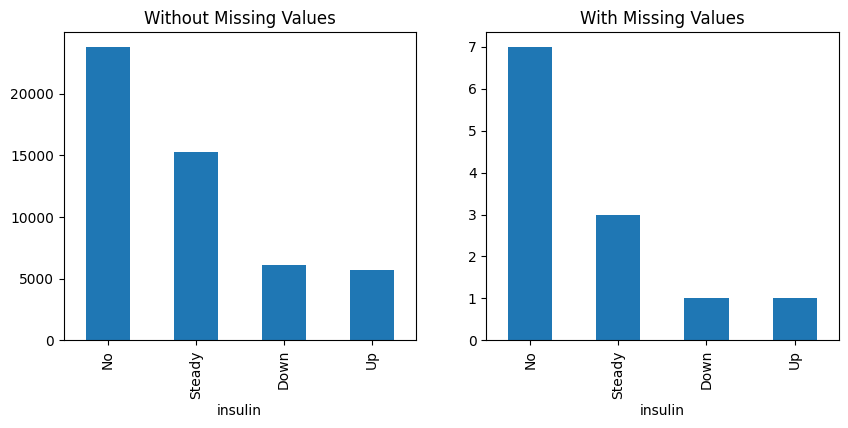

p-value of Chi-squared test: 0.8816130115703995
The missingness in 'insulin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glyburide-metformin:


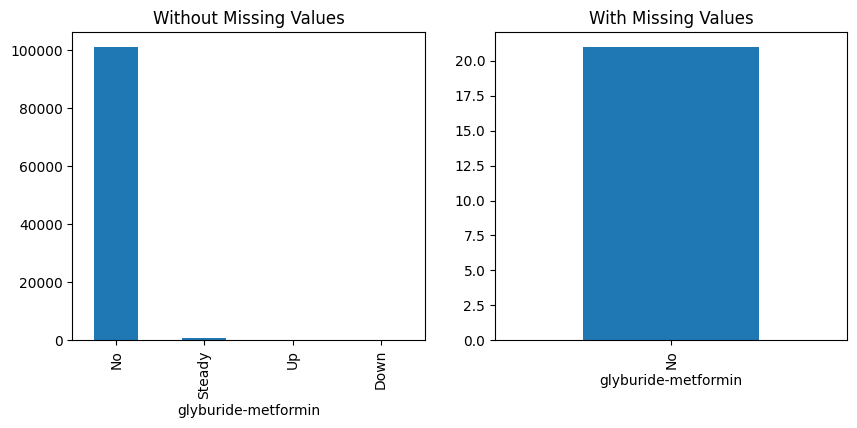

p-value of Chi-squared test: 0.9856918746145978
The missingness in 'glyburide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glipizide-metformin:


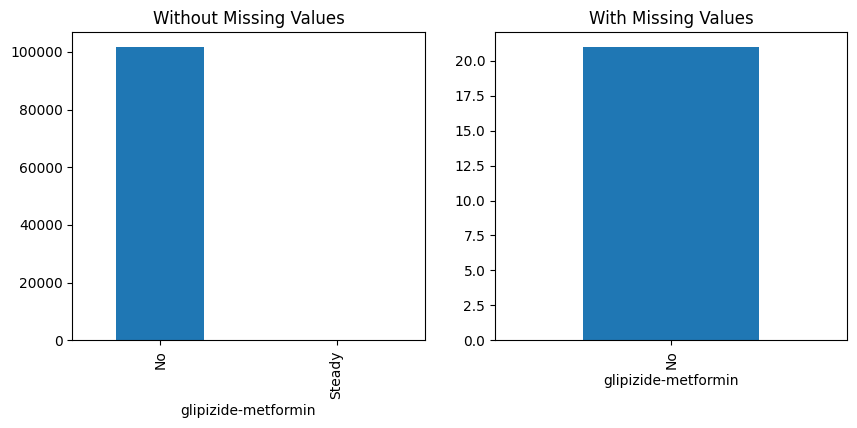

p-value of Chi-squared test: 1.0
The missingness in 'glipizide-metformin' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for glimepiride-pioglitazone:


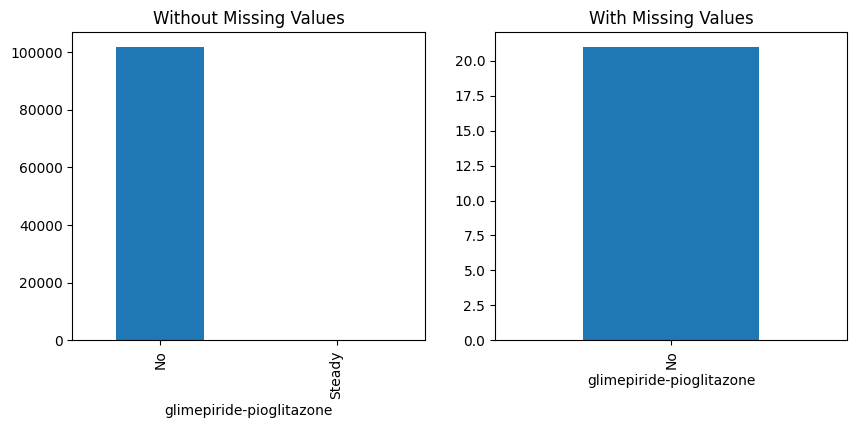

p-value of Chi-squared test: 1.0
The missingness in 'glimepiride-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-pioglitazone:


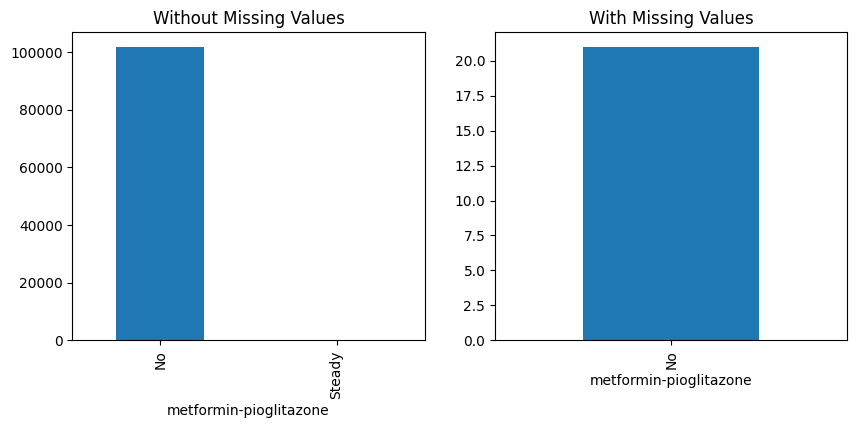

p-value of Chi-squared test: 1.0
The missingness in 'metformin-pioglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for metformin-rosiglitazone:


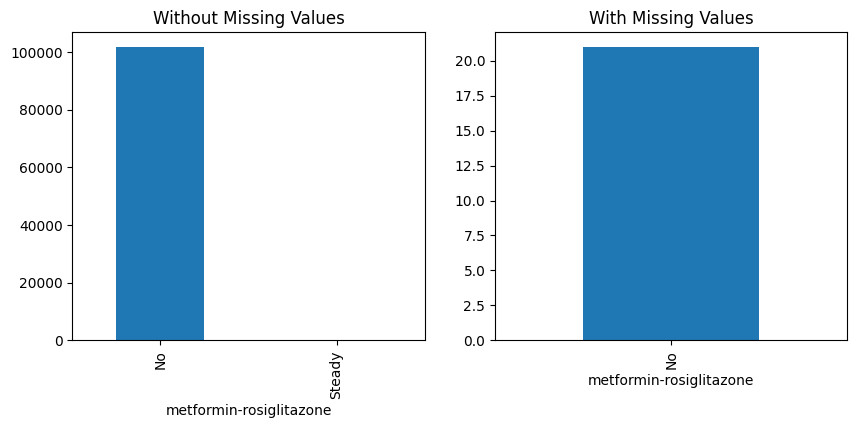

p-value of Chi-squared test: 1.0
The missingness in 'metformin-rosiglitazone' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for change:


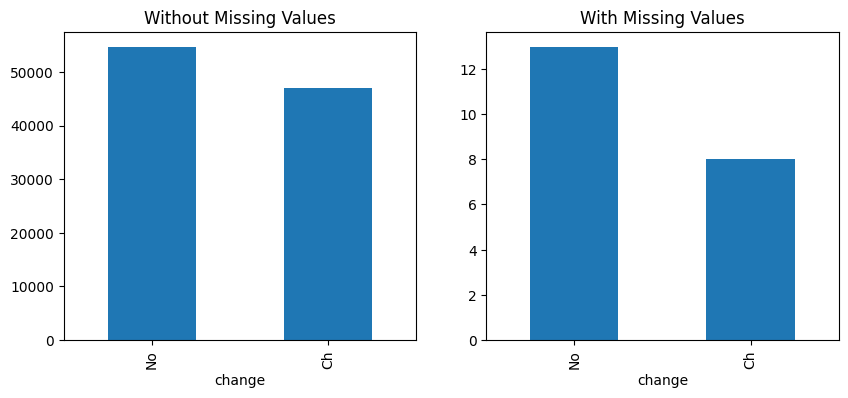

p-value of Chi-squared test: 0.5990732511705903
The missingness in 'change' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for diabetesMed:


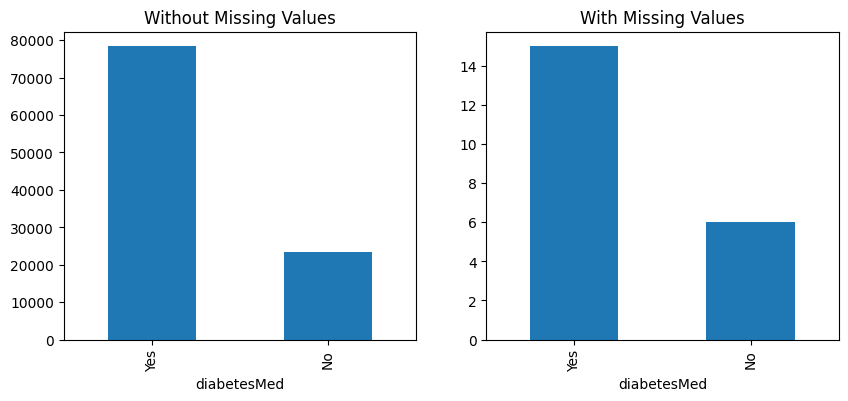

p-value of Chi-squared test: 0.7279801934951187
The missingness in 'diabetesMed' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 
Diagnosis Analysis of Missing Values for readmitted:


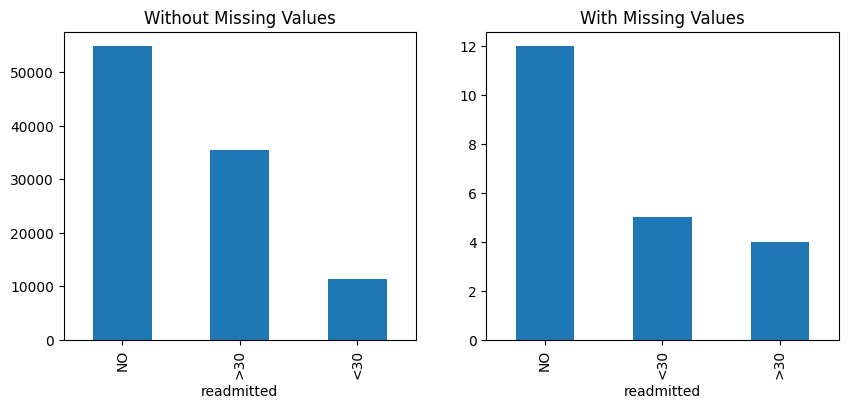

p-value of Chi-squared test: 0.10183105696537995
The missingness in 'readmitted' appears to be **completely at random** (p >= 0.05).
No significant relationship was detected between missingness and the attribute values.
- - - - - - - - - - - - divider - - - - - - - - - - - 


In [ ]:
BM_MV = diabetic_df.diag_1.isna()
for att in categorical_attributes:
    print('Diagnosis Analysis of Missing Values for {}:'.format(att))
    Diagnose_MV_Categorical(diabetic_df,att,BM_MV)
    print('- - - - - - - - - - - - divider - - - - - - - - - - - ')

### Analysis of Insulin Missing Data

The `insulin` attribute contains a significant amount of missing data, which we classify as **Missing Not At Random (MNAR)**. This suggests that the missing values may be due to specific underlying reasons, such as particular patient conditions or treatment patterns, rather than occurring randomly or due to data collection issues.


# Correlation analysis

In [ ]:
numerical_attributes = [
    'encounter_id', 'patient_nbr', 'time_in_hospital', 'num_lab_procedures',
    'num_medications', 'number_diagnoses','num_procedures', 'number_outpatient', 'number_emergency', 'number_inpatient'
]

<Axes: >

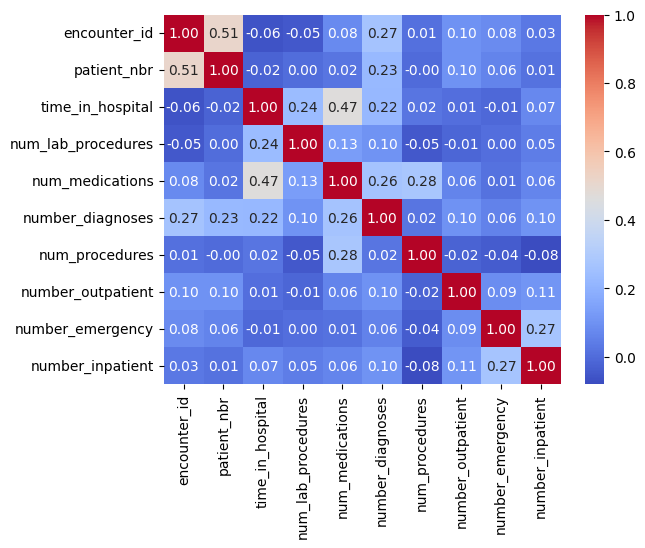

In [ ]:
corr_matrix = diabetic_df[numerical_attributes].corr()
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm')

In [ ]:
categorical_attributes = [
    'race', 'gender', 'age', 'weight', 'admission_type_id', 'diag_1', 'diag_2', 'diag_3',
    'discharge_disposition_id', 'admission_source_id', 'payer_code',
    'medical_specialty', 'max_glu_serum', 'A1Cresult', 'metformin',
    'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride',
    'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
    'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol',
    'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin',
    'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone',
    'metformin-pioglitazone', 'metformin-rosiglitazone', 'change',
    'diabetesMed', 'readmitted'
]

In [ ]:
from scipy.stats import chi2_contingency

In [ ]:
def cramers_v(confusion_matrix):
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    min_dim = min(confusion_matrix.shape) - 1
    if n == 0 or min_dim == 0:
        return np.nan
    return np.sqrt(chi2 / (n * min_dim))

In [ ]:
correlation_results = pd.DataFrame(index=categorical_attributes, columns=categorical_attributes)

for col1 in categorical_attributes:
    for col2 in categorical_attributes:
        if col1 == col2:
            correlation_results.loc[col1, col2] = 1.0
        else:
            contingency_table = pd.crosstab(diabetic_df[col1], diabetic_df[col2])
            if contingency_table.size == 0:
                correlation_results.loc[col1, col2] = np.nan
            else:
                cramer_v_value = cramers_v(contingency_table)
                correlation_results.loc[col1, col2] = cramer_v_value

correlation_results = correlation_results.astype(float)
correlation_results

,race,gender,age,weight,admission_type_id,diag_1,diag_2,diag_3,discharge_disposition_id,admission_source_id,payer_code,medical_specialty,max_glu_serum,A1Cresult,metformin,repaglinide,nateglinide,chlorpropamide,glimepiride,acetohexamide,glipizide,glyburide,tolbutamide,pioglitazone,rosiglitazone,acarbose,miglitol,troglitazone,tolazamide,examide,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-pioglitazone,metformin-rosiglitazone,change,diabetesMed,readmitted
race,1.000000,0.072112,0.095858,0.069749,0.067469,0.146405,0.140672,0.125747,0.053774,0.063177,0.106167,0.133439,0.024504,0.060857,0.013832,0.015778,0.011563,0.007420,0.014033,0.001758,0.015530,0.017897,0.006683,0.016853,0.009171,0.010164,0.003869,0.003045,0.003210,NaN,NaN,0.036867,0.010936,0.006338,0.001758,0.001758,NaN,0.021378,0.013230,0.021780
gender,0.072112,1.000000,0.078736,0.224967,0.015253,0.184911,0.174830,0.397041,0.067032,0.025325,0.079119,0.163929,0.003598,0.033726,0.004793,0.004731,0.004376,0.003742,0.004446,0.002984,0.019579,0.022875,0.000489,0.005911,0.012607,0.010526,0.006842,0.006004,0.006100,NaN,NaN,0.006808,0.002822,0.007132,0.002984,0.002984,0.004902,0.015481,0.016452,0.013694
age,0.095858,0.078736,1.000000,0.161745,0.039650,0.283995,0.217603,0.217648,0.129638,0.045411,0.194410,0.303062,0.139602,0.183310,0.066263,0.030688,0.012112,0.009812,0.025468,0.005473,0.037956,0.050781,0.017446,0.031232,0.027762,0.009935,0.010369,0.006785,0.006269,NaN,NaN,0.069478,0.013743,0.005961,0.006032,0.006032,0.007741,0.055923,0.044866,0.039112
weight,0.069749,0.224967,0.161745,1.000000,0.111419,0.327322,0.321946,0.323731,0.078073,0.126130,0.104014,0.103291,NaN,0.160309,0.078725,0.034471,0.043030,0.050755,0.056234,NaN,0.043436,0.037415,0.020877,0.085701,0.053705,0.020876,NaN,NaN,0.028325,NaN,NaN,0.101502,NaN,NaN,NaN,NaN,NaN,0.082328,0.067198,0.065493
admission_type_id,0.067469,0.015253,0.039650,0.111419,1.000000,0.263139,0.164158,0.165677,0.174583,0.409797,0.100275,0.282997,0.125785,0.072107,0.033464,0.035413,0.014267,0.008558,0.036872,0.002949,0.014831,0.010582,0.015725,0.021889,0.021017,0.007070,0.009700,0.007630,0.010059,NaN,NaN,0.063641,0.028108,0.007171,0.002949,0.006570,0.004013,0.063755,0.043303,0.045197
diag_1,0.146405,0.184911,0.283995,0.327322,0.263139,1.000000,0.190234,0.174537,0.150565,0.162995,0.174800,0.310177,0.387839,0.270098,0.148434,0.074656,0.073660,0.062851,0.086117,0.020730,0.100331,0.100839,0.094255,0.094811,0.089962,0.064649,0.083181,0.022407,0.122349,NaN,NaN,0.180978,0.067465,0.102010,0.024195,0.021333,0.034204,0.179992,0.161037,0.156226
diag_2,0.140672,0.174830,0.217603,0.321946,0.164158,0.190234,1.000000,0.197759,0.125628,0.119593,0.163777,0.227237,0.334835,0.244418,0.147303,0.085869,0.107414,0.070209,0.078521,0.026984,0.097338,0.099920,0.240442,0.086662,0.083452,0.057286,0.041532,0.194186,0.050551,NaN,NaN,0.162916,0.084212,0.078759,0.353541,0.012444,0.028440,0.151116,0.131158,0.139892
diag_3,0.125747,0.397041,0.217648,0.323731,0.165677,0.174537,0.197759,1.000000,0.114606,0.129091,0.158665,0.205356,0.315734,0.221907,0.135770,0.077448,0.130923,0.051766,0.076832,0.015585,0.088196,0.100674,0.060499,0.087687,0.092801,0.060158,0.064033,0.021899,0.039378,NaN,NaN,0.170258,0.124143,0.070387,0.041260,0.022314,0.040534,0.141657,0.125656,0.137271
discharge_disposition_id,0.053774,0.067032,0.129638,0.078073,0.174583,0.150565,0.125628,0.114606,1.000000,0.079787,0.076004,0.100893,0.099464,0.092434,0.049249,0.025154,0.015971,0.034038,0.026988,0.022180,0.033071,0.054685,0.016823,0.030195,0.023470,0.011273,0.020664,0.022093,0.019159,NaN,NaN,0.096921,0.021032,0.015743,0.002603,0.007864,0.005235,0.099829,0.088956,0.132760
admission_source_id,0.063177,0.025325,0.045411,0.126130,0.409797,0.162995,0.119593,0.129091,0.079787,1.000000,0.061979,0.216595,0.150181,0.054544,0.035810,0.026633,0.013147,0.020560,0.022504,0.002751,0.015428,0.029882,0.010837,0.023812,0.024265,0.005756,0.008526,0.004765,0.008856,NaN,NaN,0.069993,0.023039

In [ ]:
redundancy_threshold = 0.45
redundant_pairs = []
for col1 in correlation_results.columns:
    for col2 in correlation_results.index:
        if col1 != col2 and correlation_results.loc[col1, col2] > redundancy_threshold:
            redundant_pairs.append((col1, col2, correlation_results.loc[col1, col2]))


redundant_df = pd.DataFrame(redundant_pairs, columns=['Attribute 1', 'Attribute 2', 'Cramér\'s V'])


print("Potentially Redundant Pairs with High Cramér's V:")
print(redundant_df)

Potentially Redundant Pairs with High Cramér's V:
   Attribute 1  Attribute 2  Cramér's V
0      insulin       change    0.642728
1      insulin  diabetesMed    0.588927
2       change      insulin    0.642728
3       change  diabetesMed    0.506347
4  diabetesMed      insulin    0.588927
5  diabetesMed       change    0.506347


### Analysis of Potentially Redundant Attribute Pairs

Given the high correlation of `insulin` with both `change` and `diabetesMed`, we can consider dropping one of these attributes to reduce redundancy without losing significant information. This will simplify the dataset for further analysis.


# Outliers

## For numerical

In [ ]:
def numerical_outliers(df, col):
    if df[col].dropna().empty:
        print(f"No data in column {col}")
        return pd.DataFrame()

    fig = plt.boxplot(df[col].dropna(), vert=False)
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    BM = (df[col] > (Q3 + 1.5 * IQR)) | (df[col] < (Q1 - 1.5 * IQR))
    plt.show()
    return df[BM]

Outliers for encounter_id


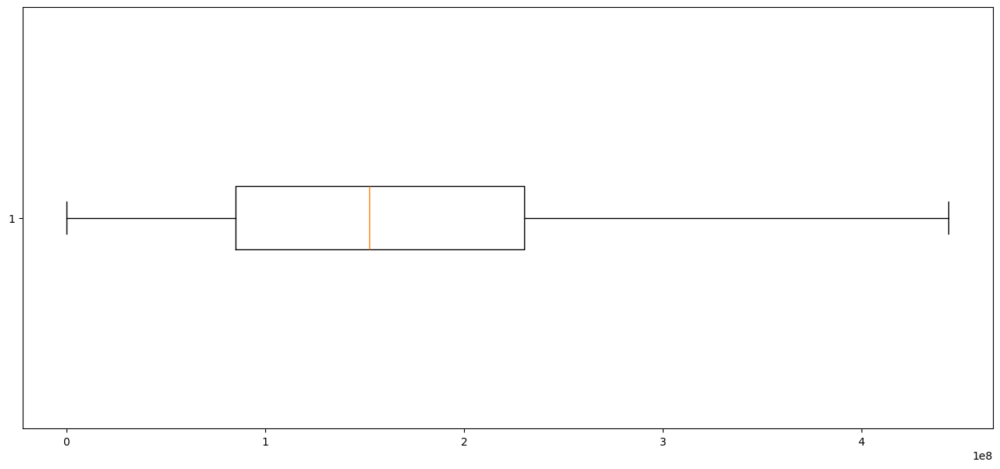

0
Outliers for patient_nbr


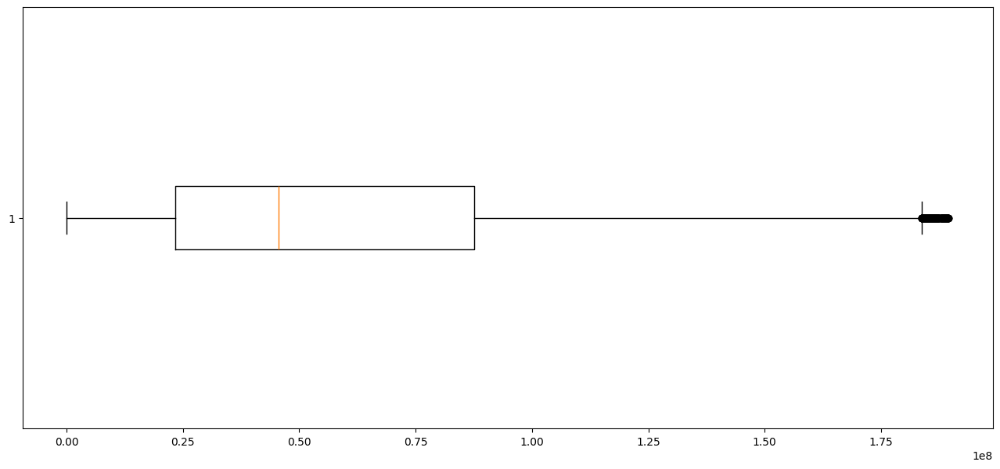

247
Outliers for time_in_hospital


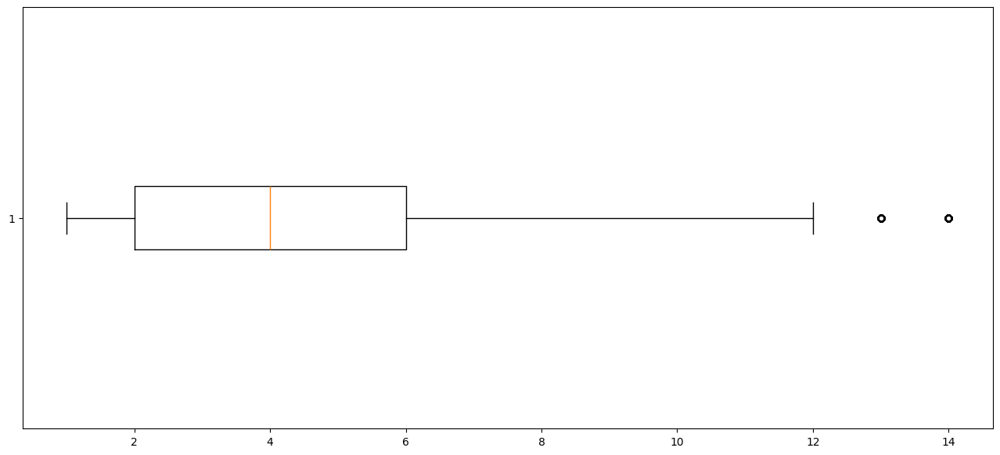

2252
Outliers for num_lab_procedures


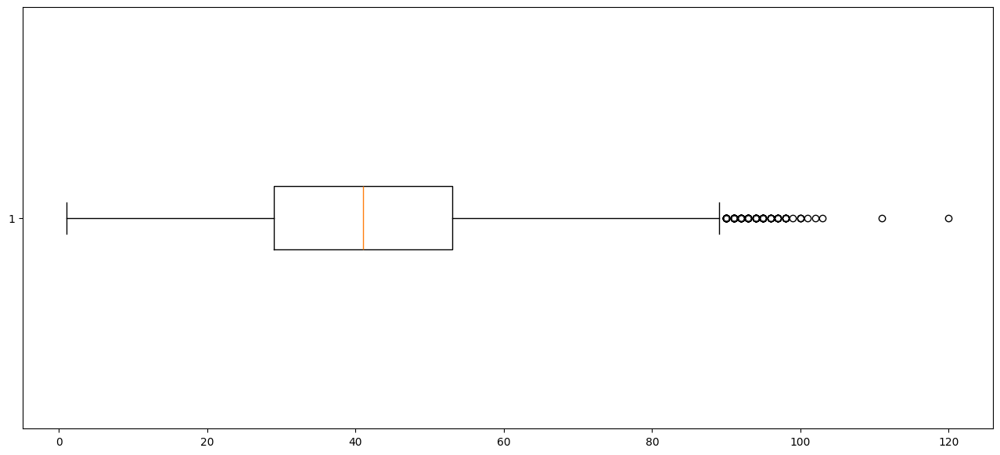

115
Outliers for num_medications


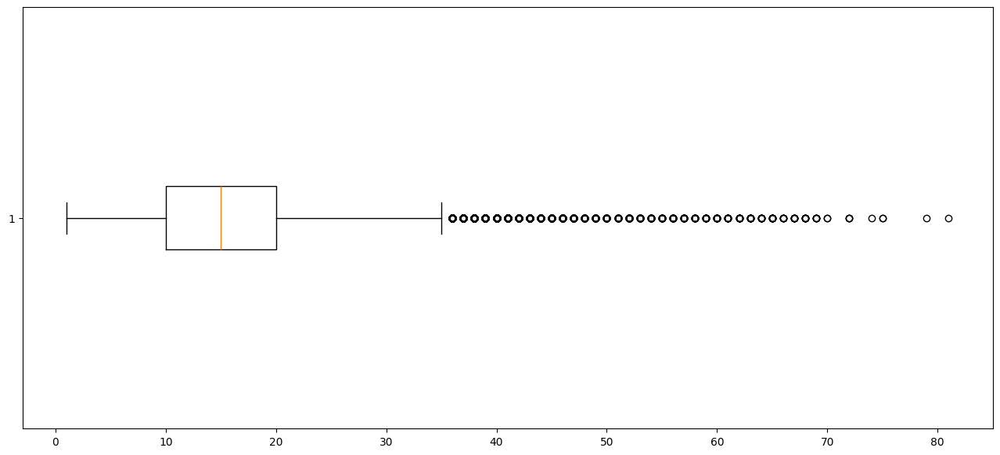

2557
Outliers for number_diagnoses


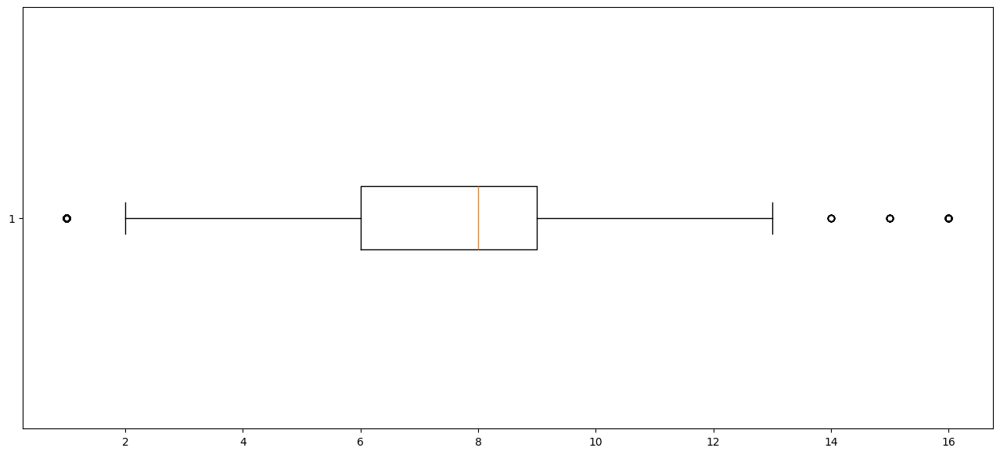

281
Outliers for num_procedures


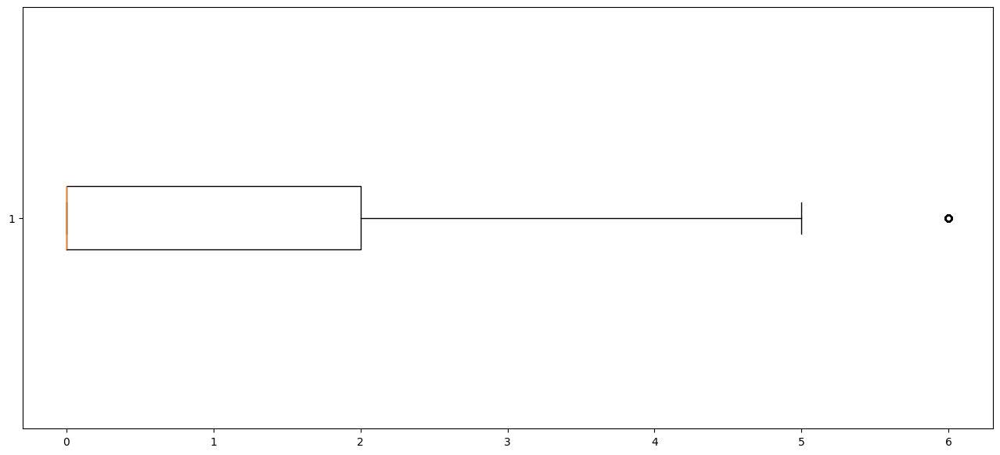

2772
Outliers for number_outpatient


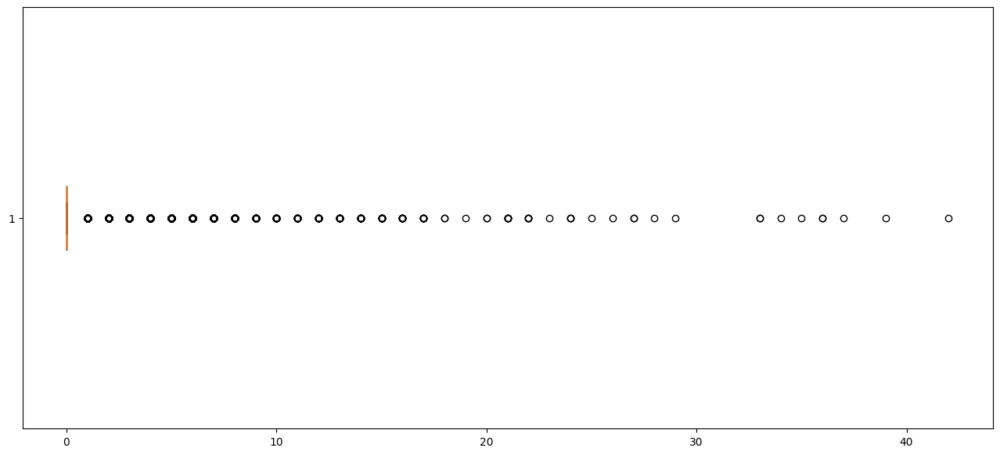

12357
Outliers for number_emergency


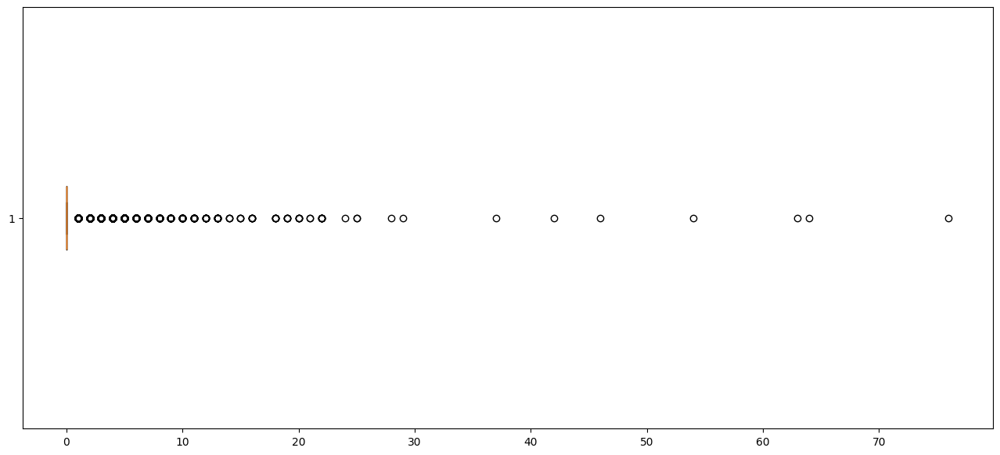

11383
Outliers for number_inpatient


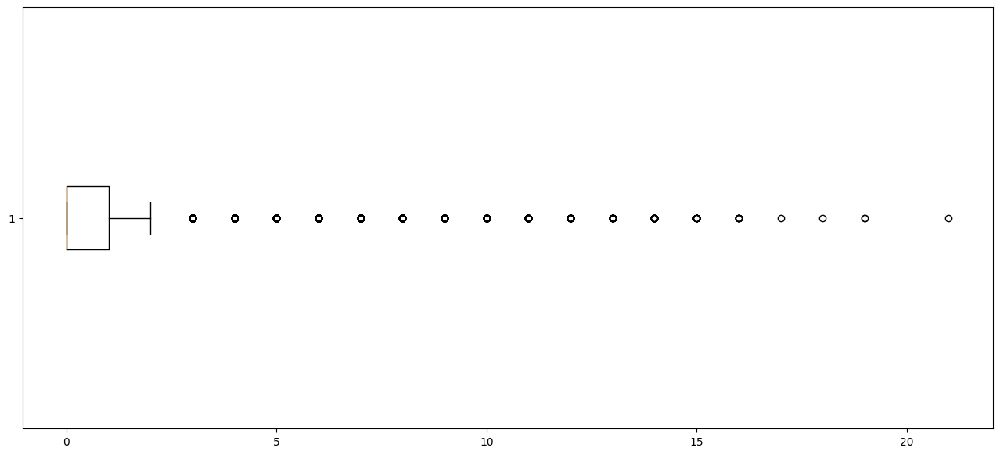

7049


In [ ]:
outlier_total_list = []
for col in numerical_attributes:
  print(f"Outliers for {col}")
  plt.figure(figsize=(16, 7))
  outlier_list = numerical_outliers(diabetic_df,col)
  outlier_total_list.append(outlier_list)
  print(len(outlier_list))

## Categorical attribute

In [ ]:
def categorical_outliers(df, col):
    print(df[col].value_counts())
    plt.figure(figsize=(16, 7))
    df[col].value_counts().plot.bar()
    plt.show()

Outliers for race
race
Caucasian          76099
AfricanAmerican    19210
Hispanic            2037
Other               1506
Asian                641
Name: count, dtype: int64


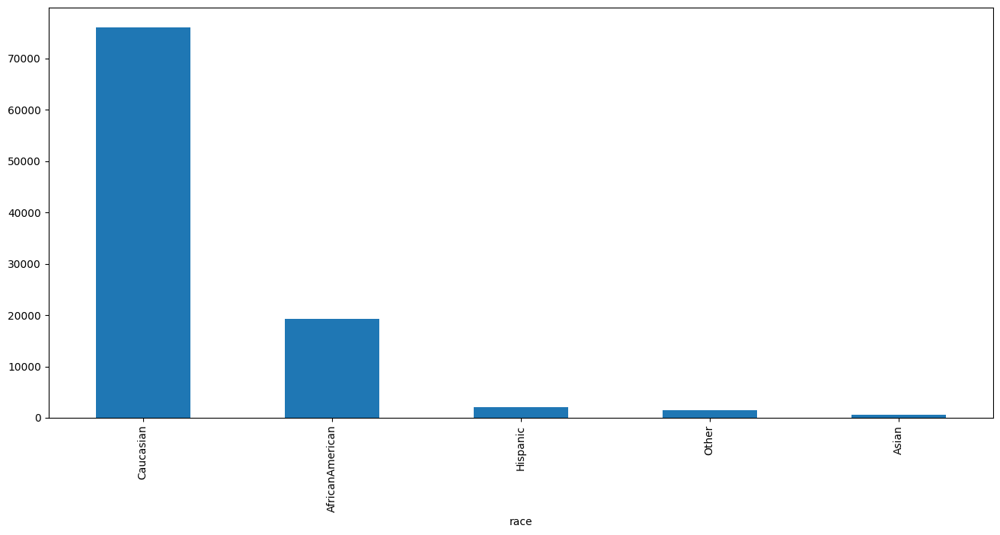

Outliers for gender
gender
Female             51952
Male               44724
Unknown/Invalid        2
Name: count, dtype: int64


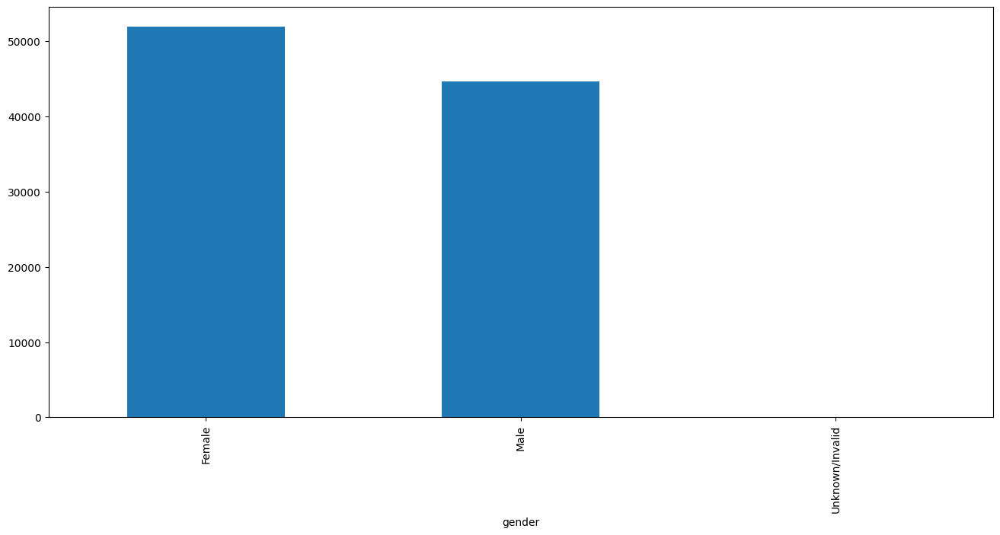

Outliers for age
age
[70-80)     24813
[60-70)     21400
[50-60)     16366
[80-90)     16313
[40-50)      9193
[30-40)      3573
[90-100)     2647
[20-30)      1570
[10-20)       653
[0-10)        150
Name: count, dtype: int64


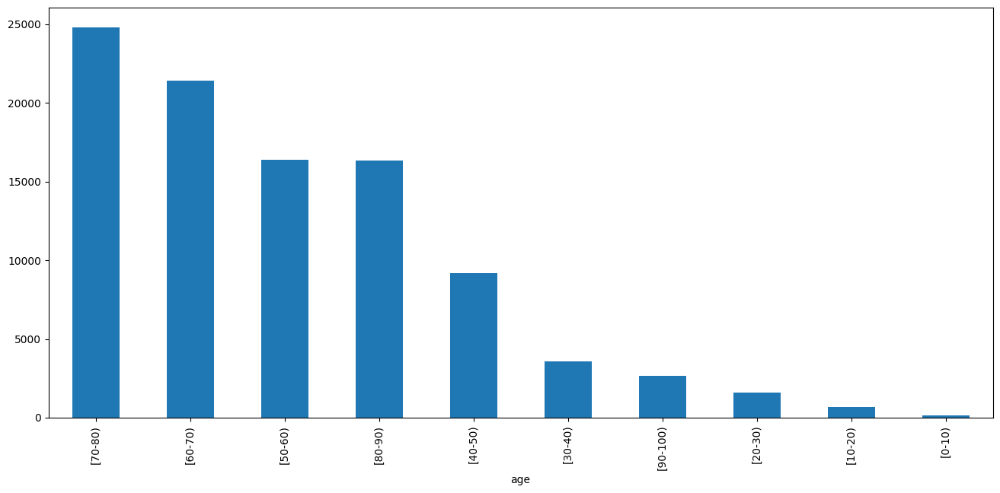

Outliers for weight
weight
[75-100)     1336
[50-75)       897
[100-125)     625
[125-150)     145
[25-50)        97
[0-25)         48
[150-175)      35
[175-200)      11
>200            3
Name: count, dtype: int64


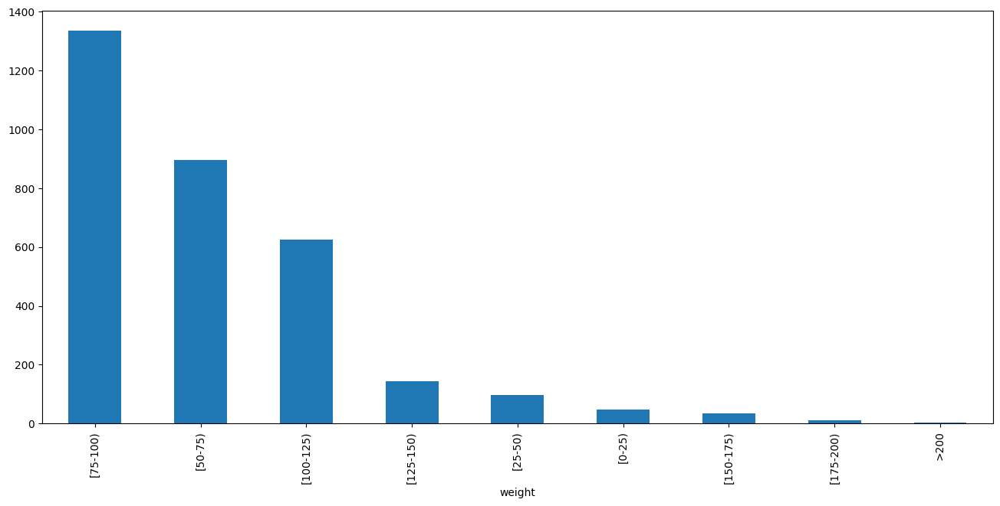

Outliers for admission_type_id
admission_type_id
1    53990
3    18869
2    18480
6     5291
5     4785
8      320
7       21
4       10
Name: count, dtype: int64


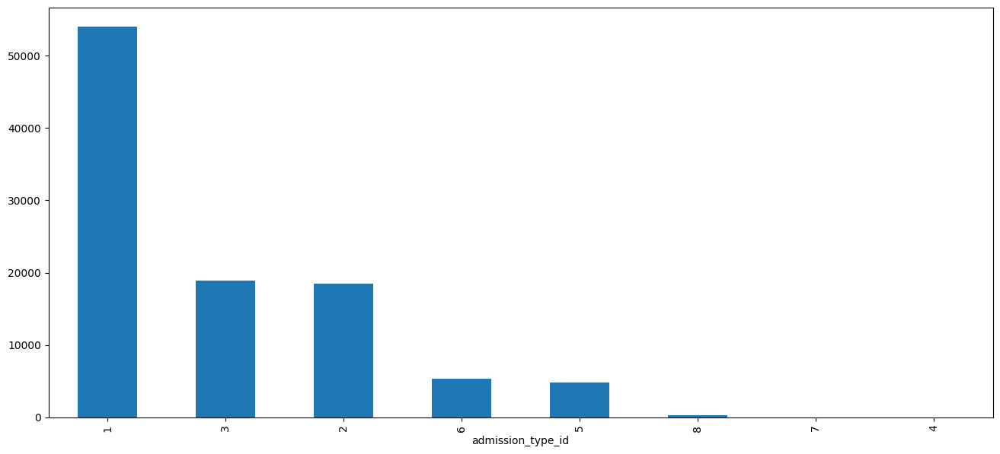

Outliers for diag_1
diag_1
428    6862
414    6581
786    4016
410    3614
486    3508
       ... 
817       1
61        1
148       1
870       1
V51       1
Name: count, Length: 716, dtype: int64


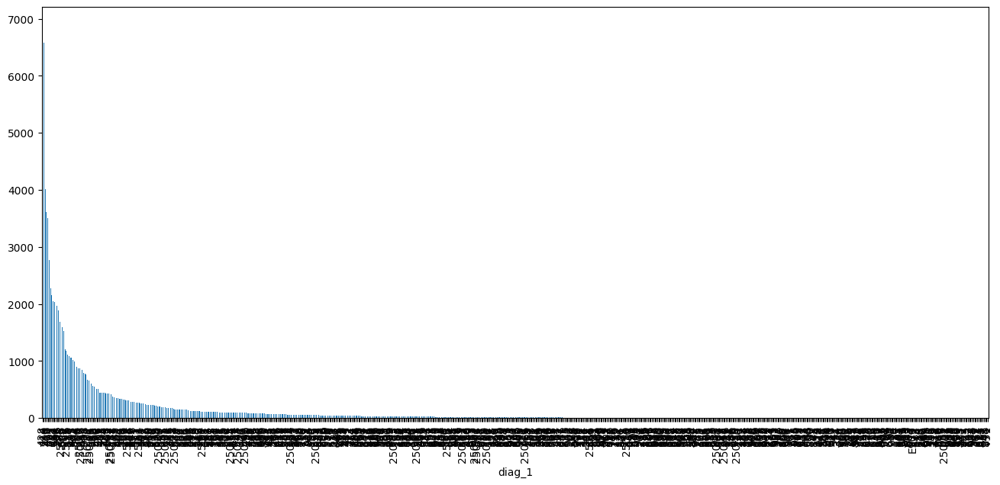

Outliers for diag_2
diag_2
276     6752
428     6662
250     6071
427     5036
401     3736
        ... 
232        1
908        1
52         1
E817       1
927        1
Name: count, Length: 748, dtype: int64


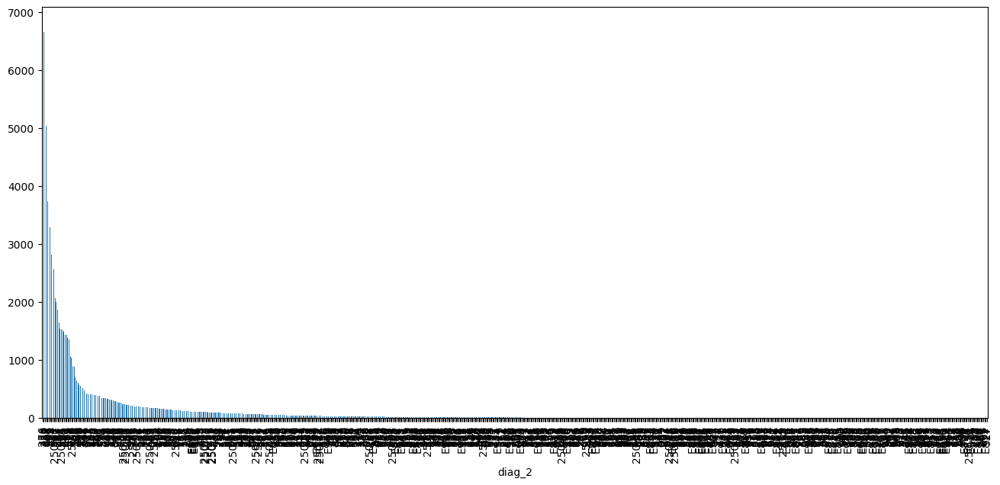

Outliers for diag_3
diag_3
250     11555
401      8289
276      5175
428      4577
427      3955
        ...  
657         1
684         1
603         1
E826        1
971         1
Name: count, Length: 789, dtype: int64


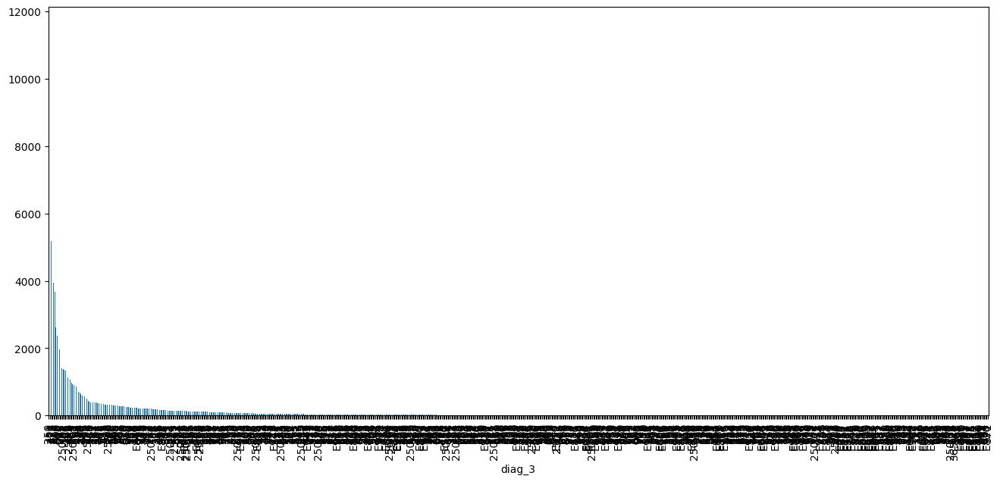

Outliers for discharge_disposition_id
discharge_disposition_id
1     60234
3     13954
6     12902
18     3691
2      2128
22     1993
11     1642
5      1184
25      989
4       815
7       623
23      412
13      399
14      372
28      139
8       108
15       63
24       48
9        21
17       14
16       11
19        8
10        6
27        5
12        3
20        2
Name: count, dtype: int64


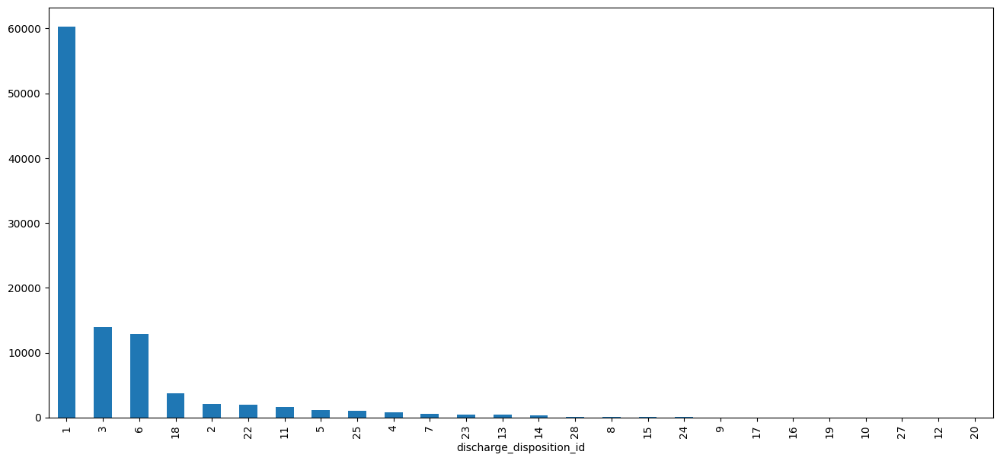

Outliers for admission_source_id
admission_source_id
7     57494
1     29565
17     6781
4      3187
6      2264
2      1104
5       855
3       187
20      161
9       125
8        16
22       12
10        8
14        2
11        2
25        2
13        1
Name: count, dtype: int64


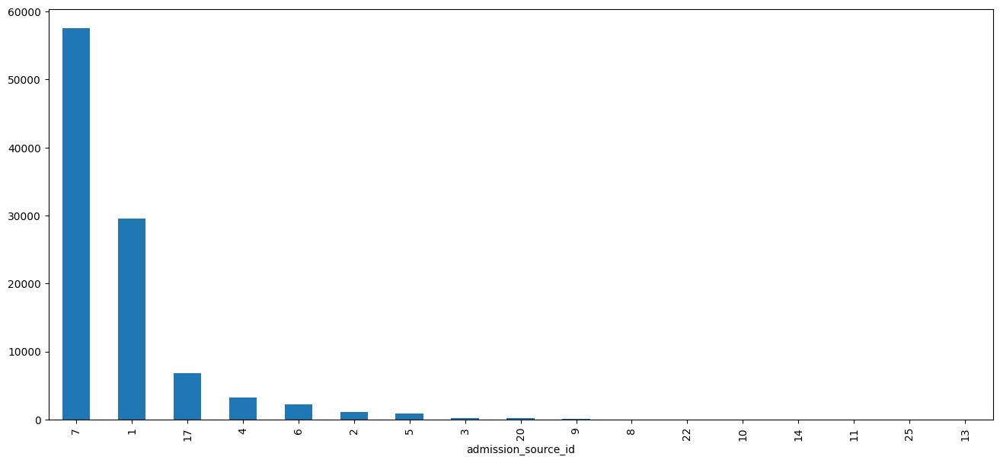

Outliers for payer_code
payer_code
MC    32439
HM     6274
SP     5007
BC     4655
MD     3532
CP     2533
UN     2448
CM     1937
OG     1033
PO      592
DM      549
CH      146
WC      135
OT       95
MP       79
SI       55
FR        1
Name: count, dtype: int64


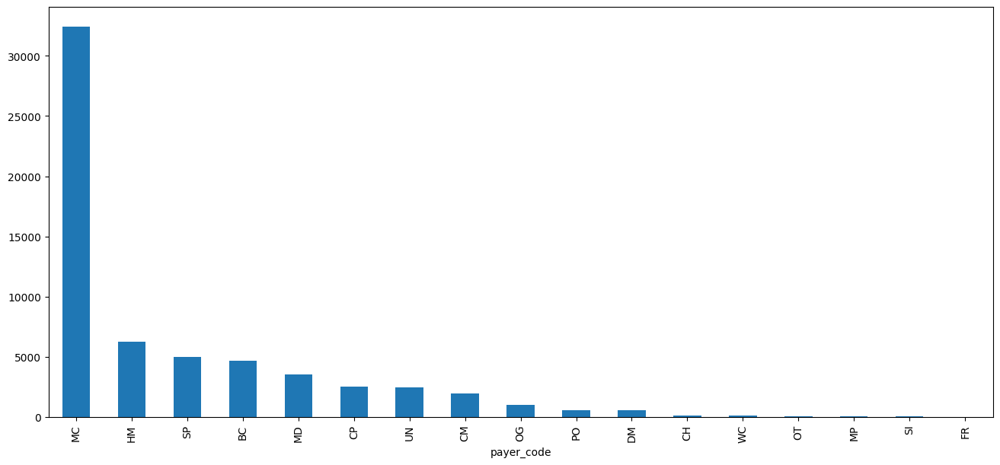

Outliers for medical_specialty
medical_specialty
InternalMedicine                    14635
Emergency/Trauma                     7565
Family/GeneralPractice               7440
Cardiology                           5352
Surgery-General                      3099
                                    ...  
Perinatology                            1
Neurophysiology                         1
Psychiatry-Addictive                    1
Pediatrics-InfectiousDiseases           1
Surgery-PlasticwithinHeadandNeck        1
Name: count, Length: 72, dtype: int64


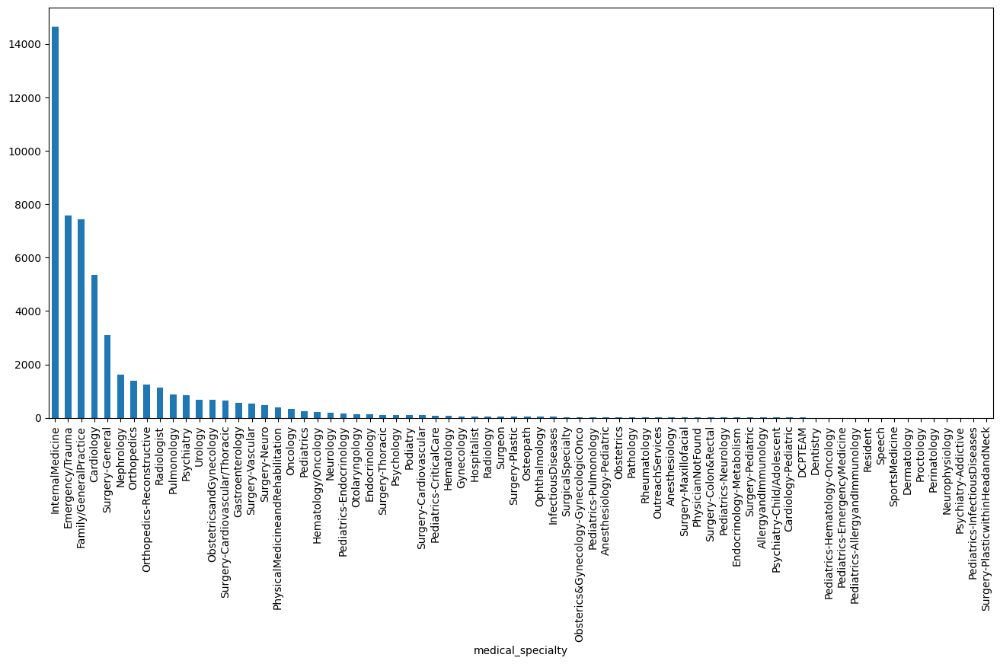

Outliers for max_glu_serum
max_glu_serum
Norm    2597
>200    1485
>300    1264
Name: count, dtype: int64


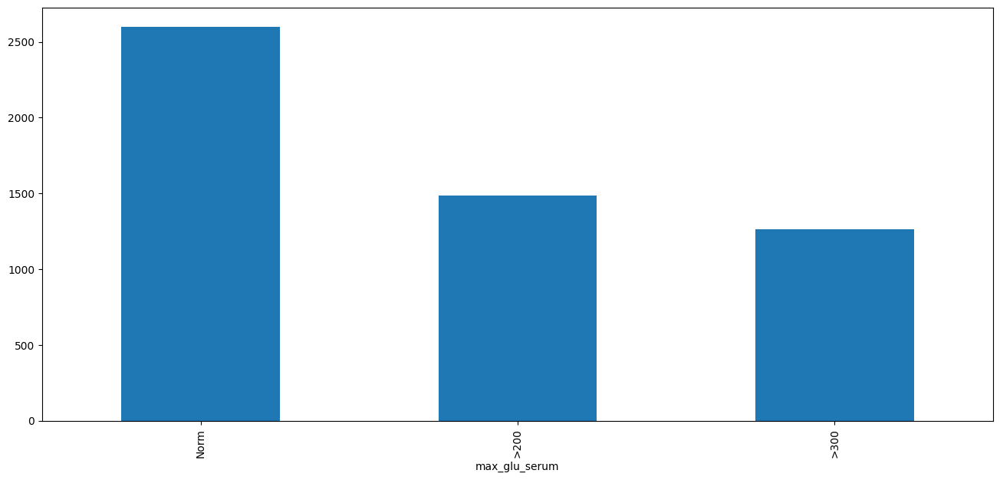

Outliers for A1Cresult
A1Cresult
>8      8216
Norm    4990
>7      3812
Name: count, dtype: int64


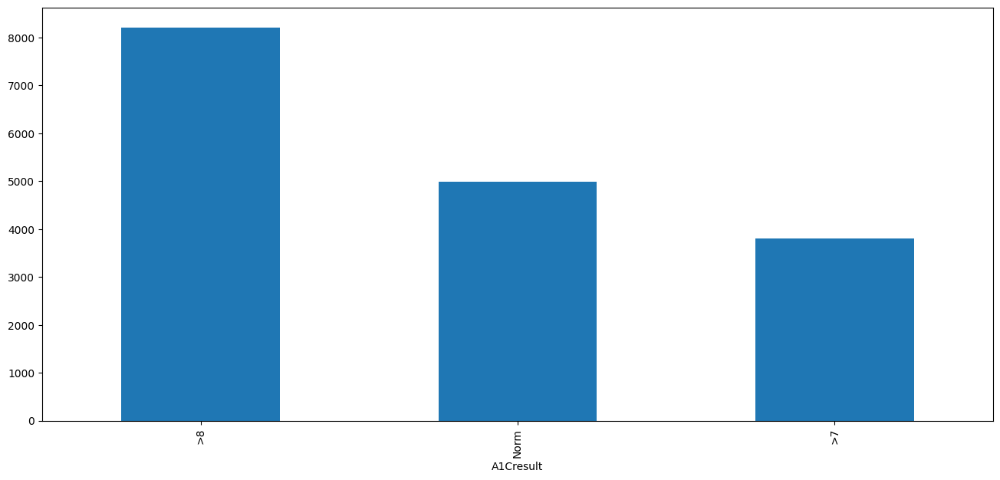

Outliers for metformin
metformin
No        81778
Steady    18346
Up         1067
Down        575
Name: count, dtype: int64


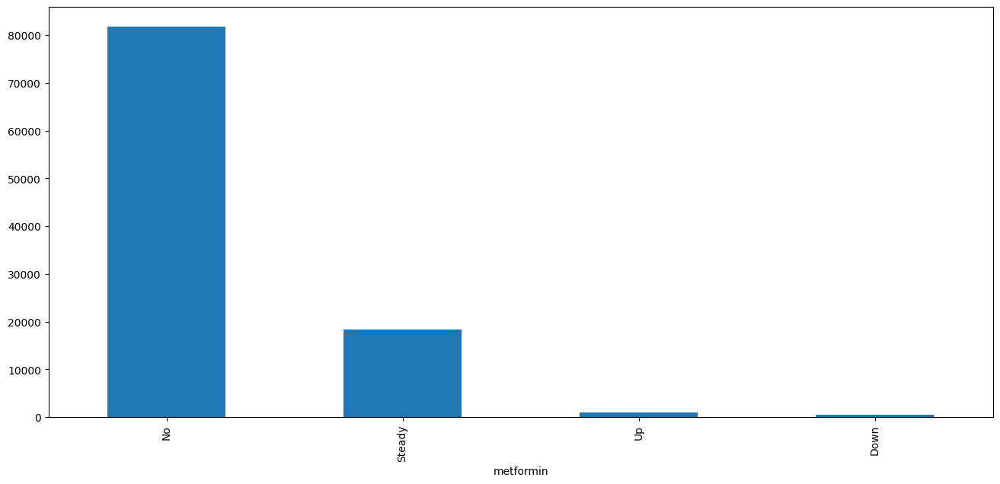

Outliers for repaglinide
repaglinide
No        100227
Steady      1384
Up           110
Down          45
Name: count, dtype: int64


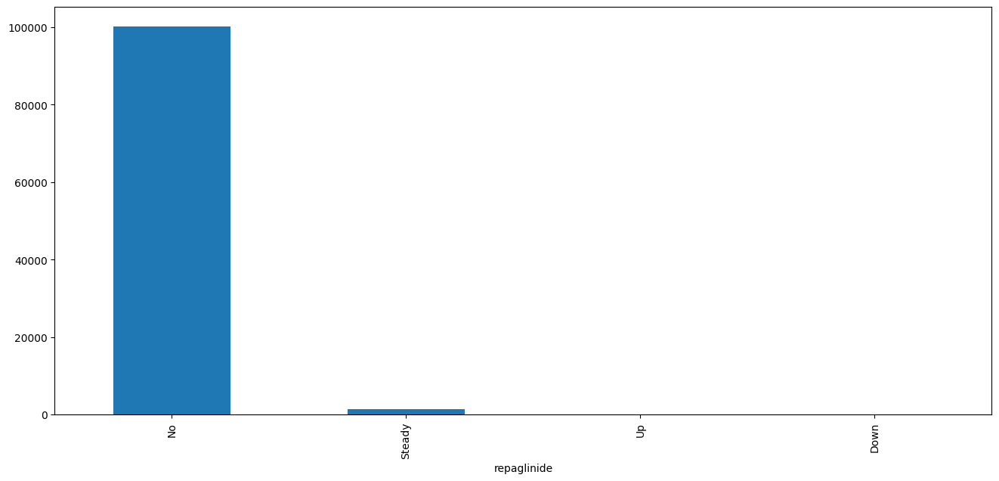

Outliers for nateglinide
nateglinide
No        101063
Steady       668
Up            24
Down          11
Name: count, dtype: int64


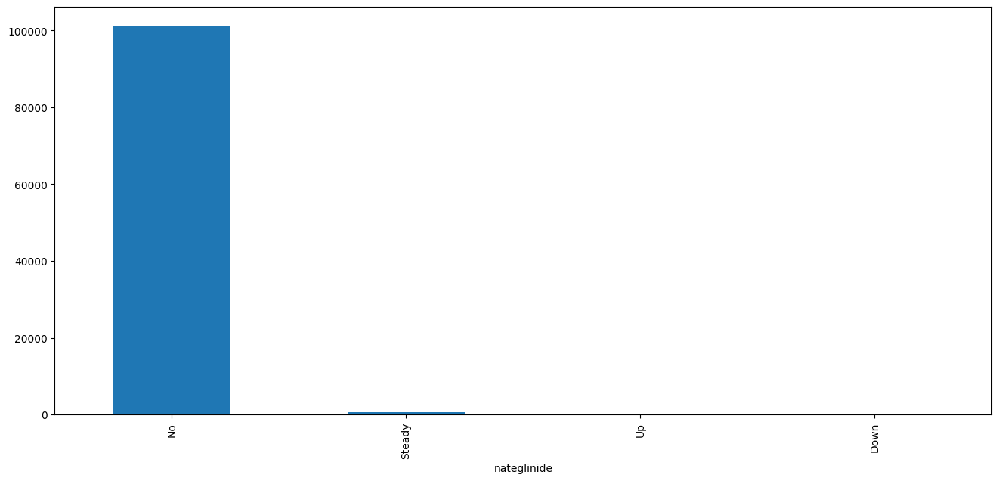

Outliers for chlorpropamide
chlorpropamide
No        101680
Steady        79
Up             6
Down           1
Name: count, dtype: int64


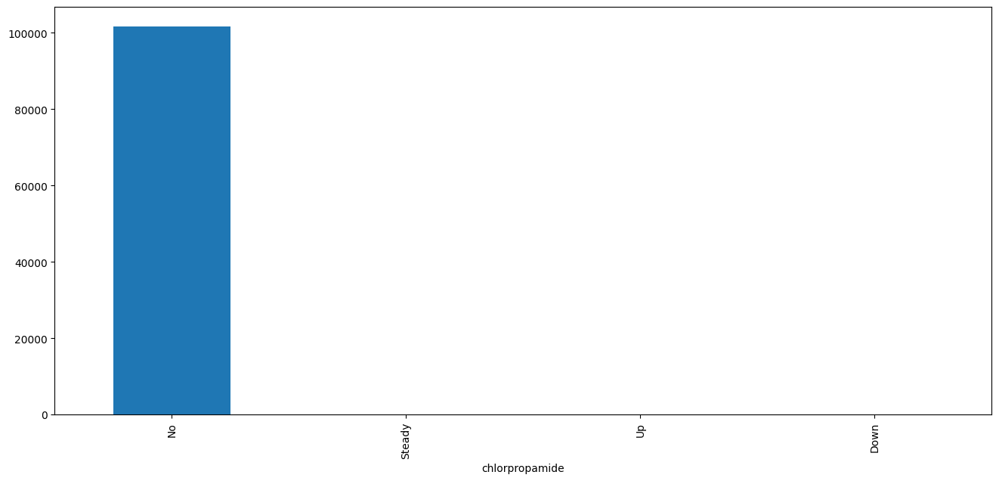

Outliers for glimepiride
glimepiride
No        96575
Steady     4670
Up          327
Down        194
Name: count, dtype: int64


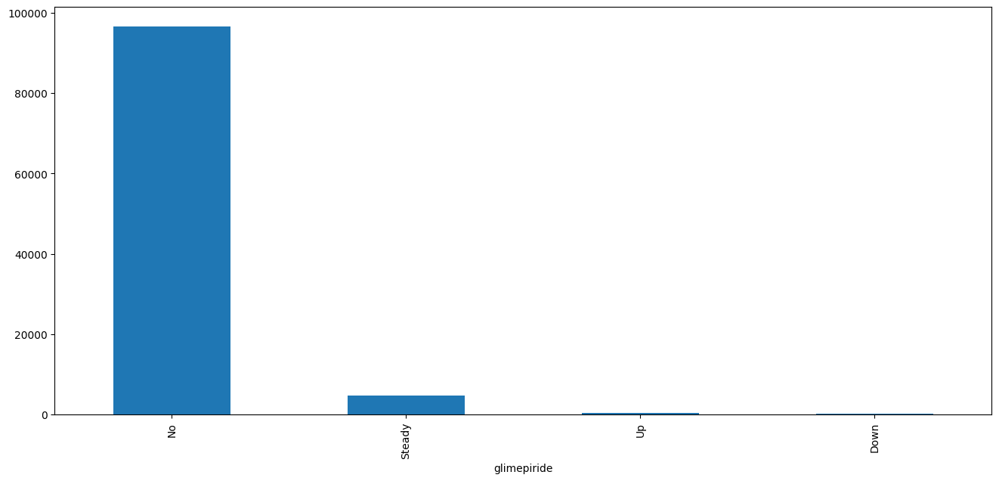

Outliers for acetohexamide
acetohexamide
No        101765
Steady         1
Name: count, dtype: int64


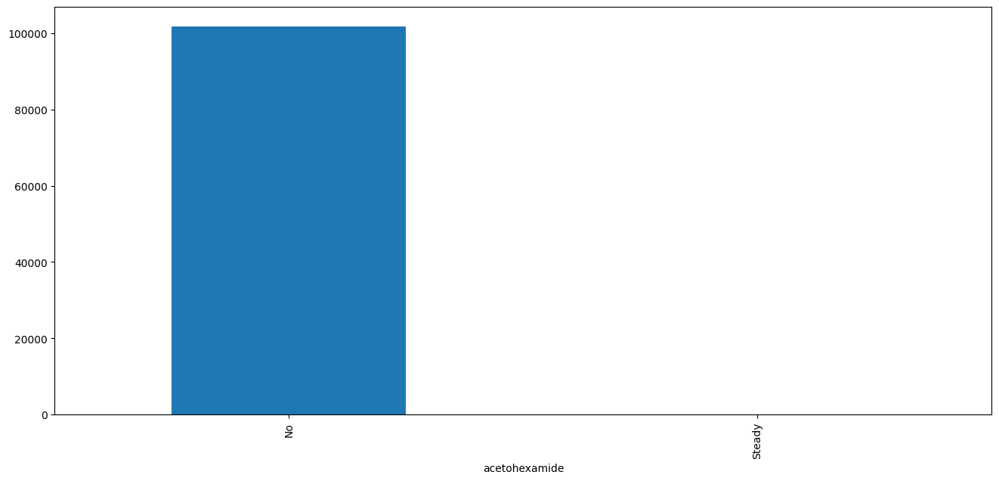

Outliers for glipizide
glipizide
No        89080
Steady    11356
Up          770
Down        560
Name: count, dtype: int64


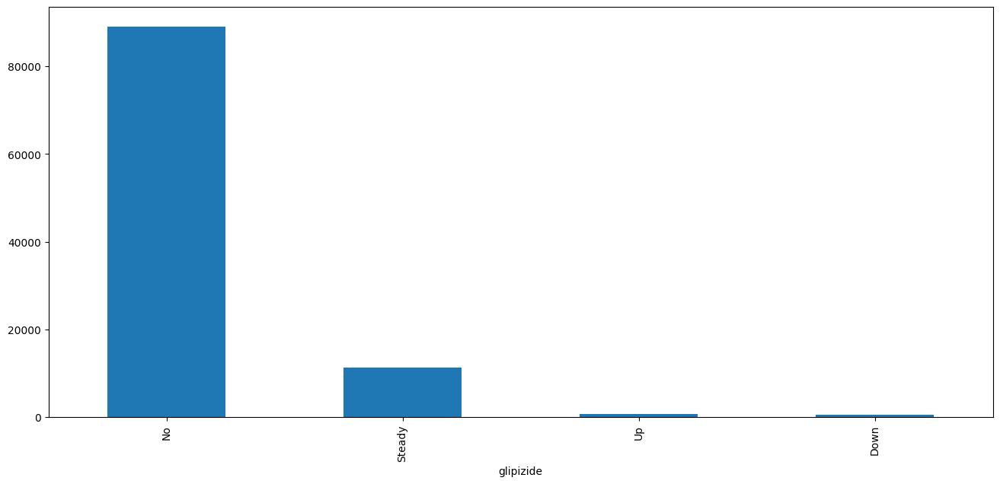

Outliers for glyburide
glyburide
No        91116
Steady     9274
Up          812
Down        564
Name: count, dtype: int64


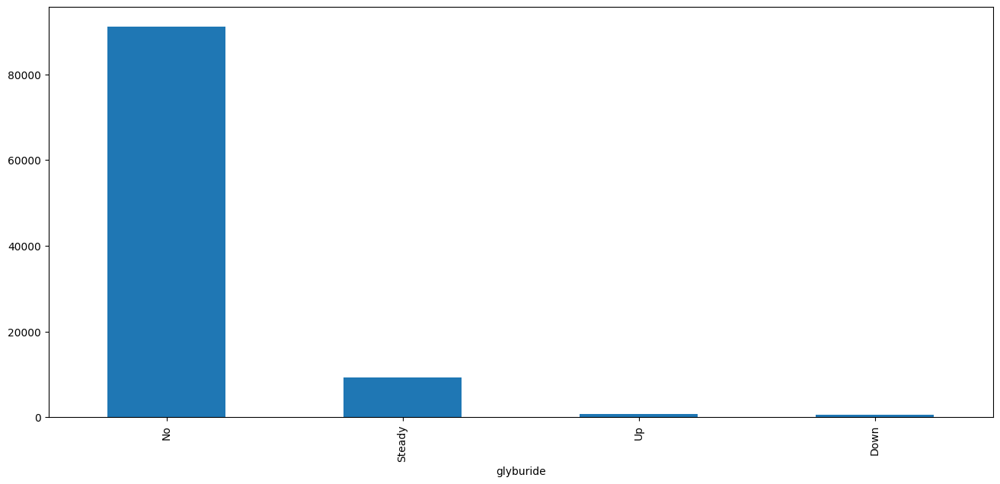

Outliers for tolbutamide
tolbutamide
No        101743
Steady        23
Name: count, dtype: int64


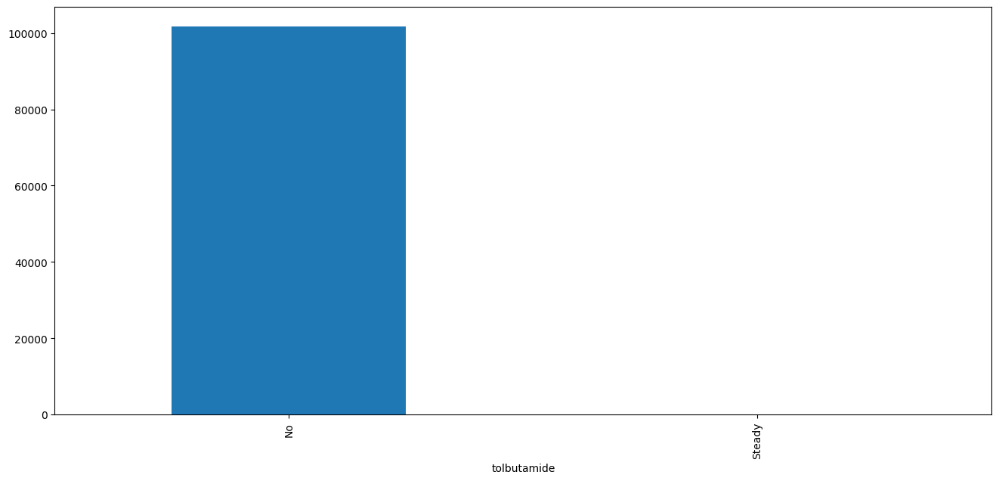

Outliers for pioglitazone
pioglitazone
No        94438
Steady     6976
Up          234
Down        118
Name: count, dtype: int64


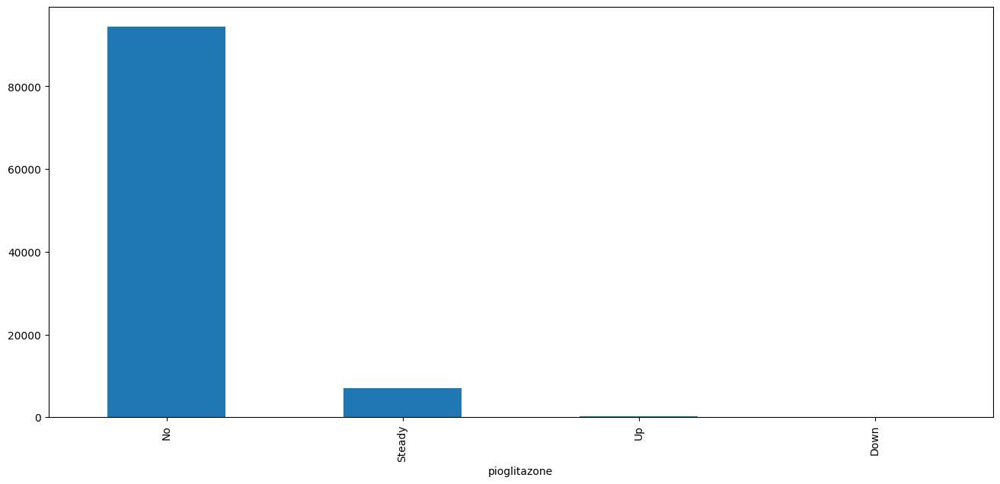

Outliers for rosiglitazone
rosiglitazone
No        95401
Steady     6100
Up          178
Down         87
Name: count, dtype: int64


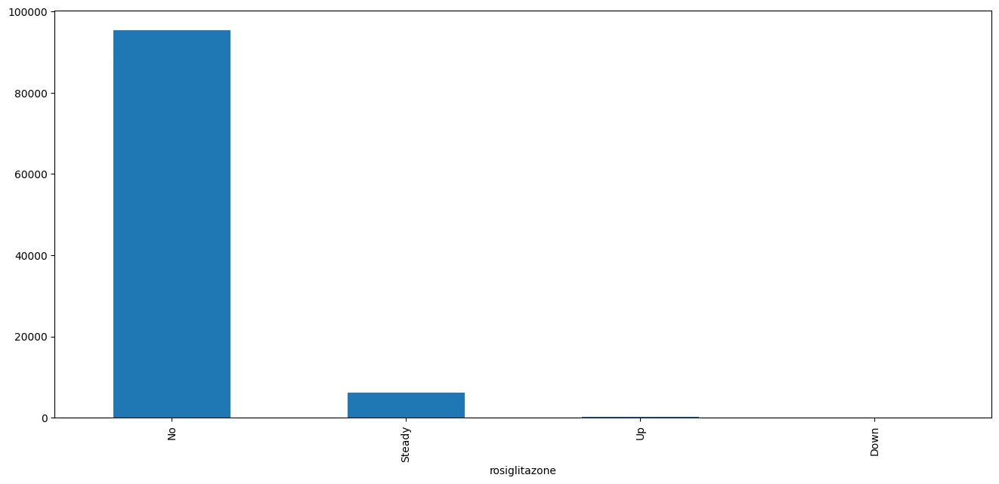

Outliers for acarbose
acarbose
No        101458
Steady       295
Up            10
Down           3
Name: count, dtype: int64


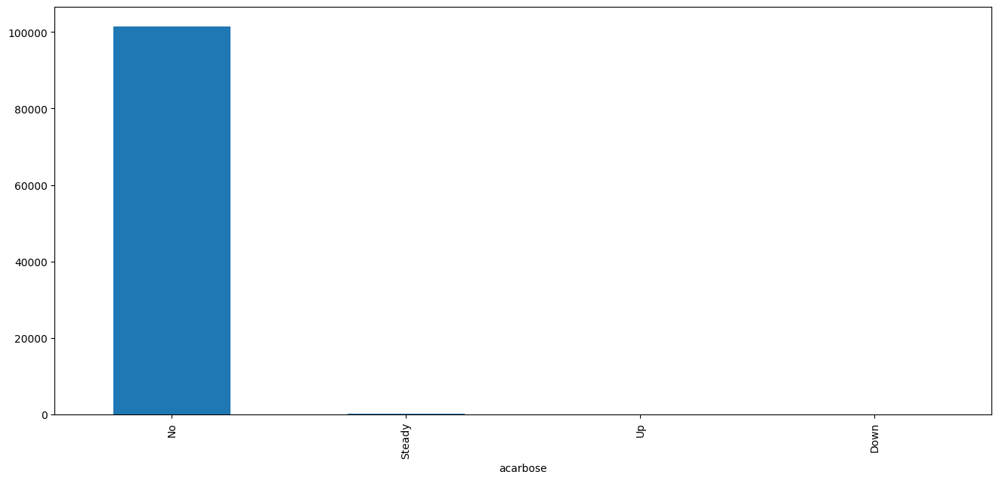

Outliers for miglitol
miglitol
No        101728
Steady        31
Down           5
Up             2
Name: count, dtype: int64


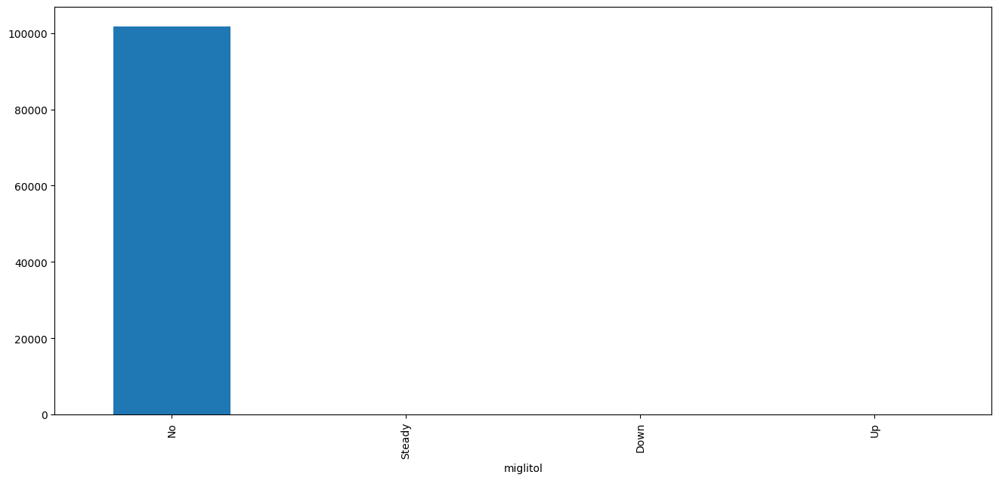

Outliers for troglitazone
troglitazone
No        101763
Steady         3
Name: count, dtype: int64


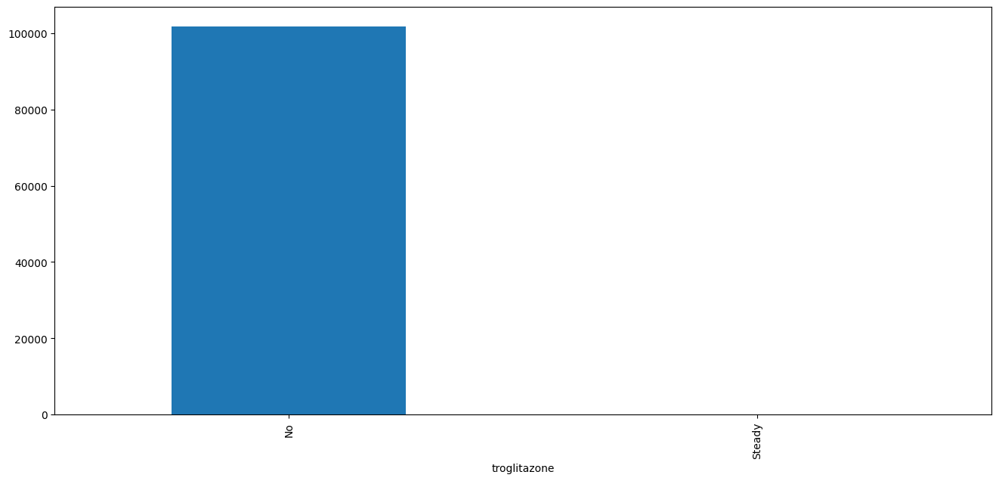

Outliers for tolazamide
tolazamide
No        101727
Steady        38
Up             1
Name: count, dtype: int64


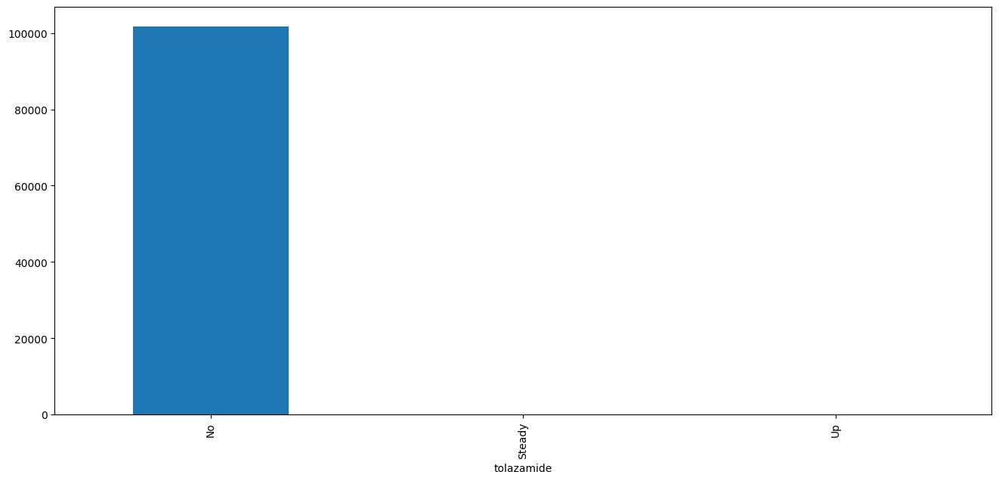

Outliers for examide
examide
No    101766
Name: count, dtype: int64


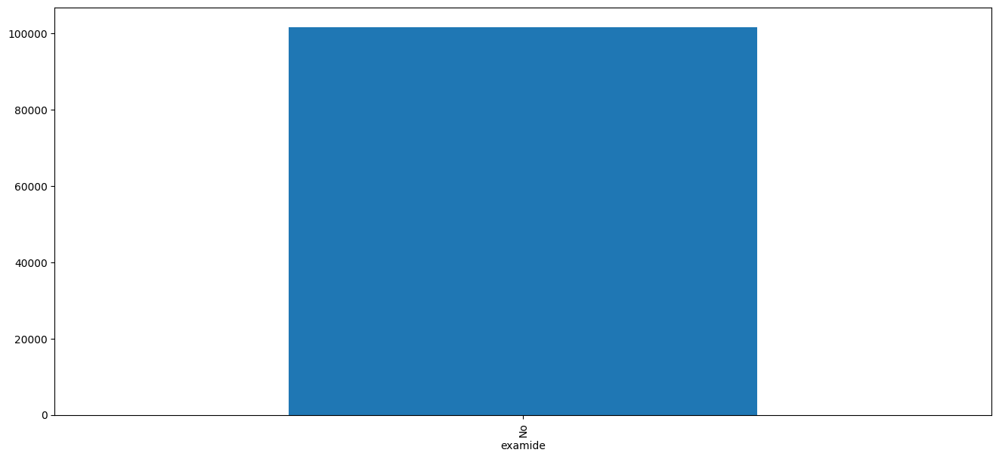

Outliers for citoglipton
citoglipton
No    101766
Name: count, dtype: int64


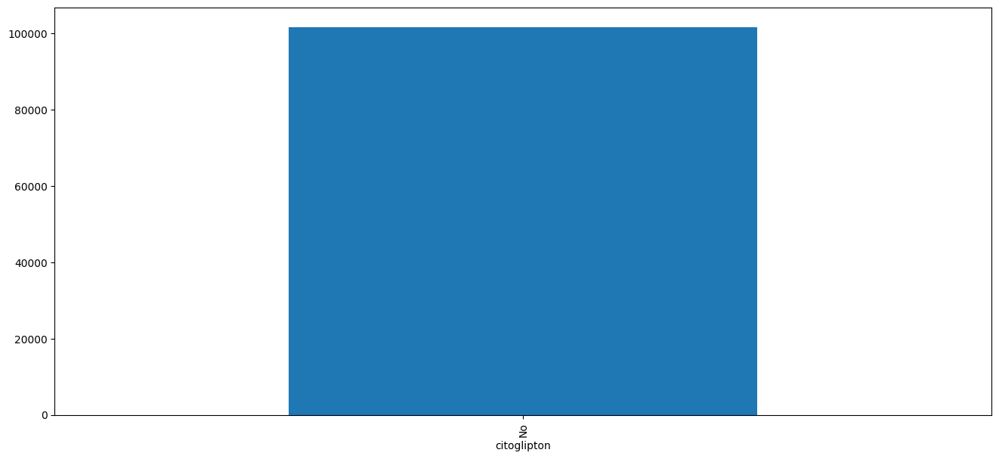

Outliers for insulin
insulin
No        23807
Steady    15291
Down       6092
Up         5693
Name: count, dtype: int64


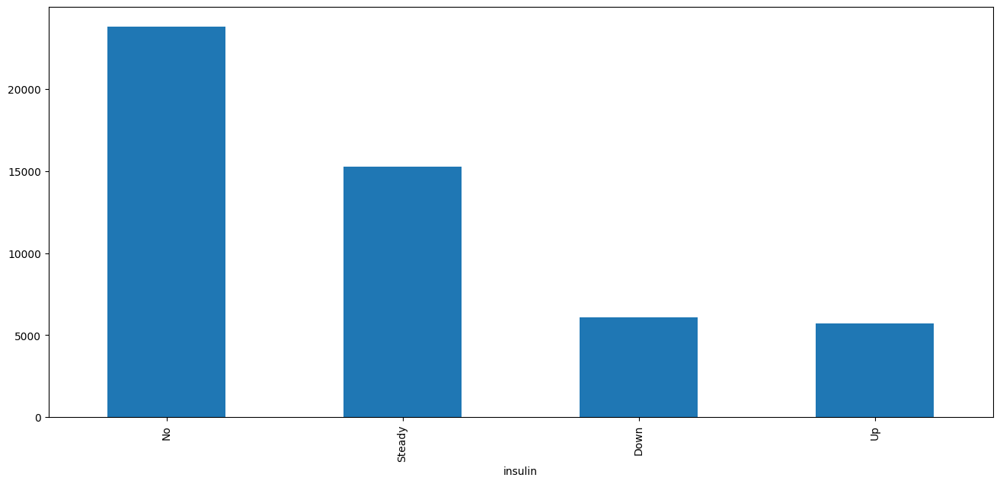

Outliers for glyburide-metformin
glyburide-metformin
No        101060
Steady       692
Up             8
Down           6
Name: count, dtype: int64


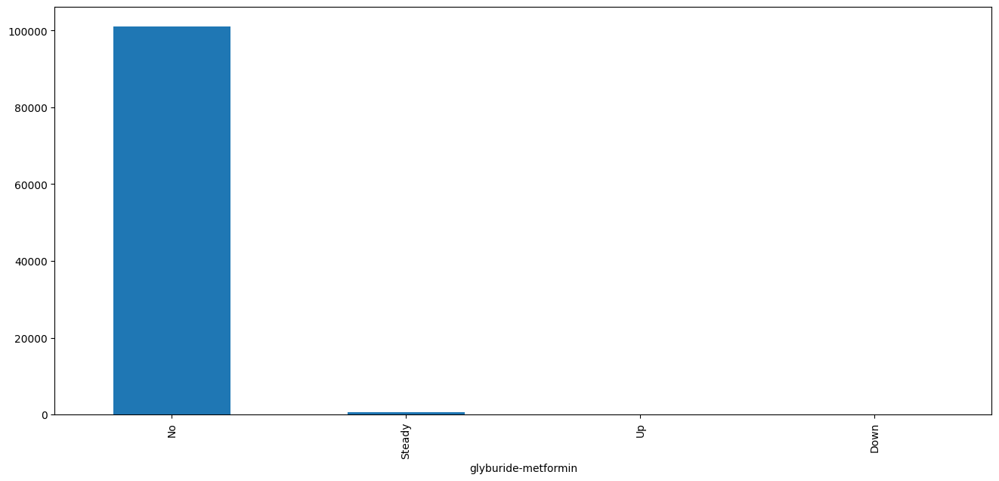

Outliers for glipizide-metformin
glipizide-metformin
No        101753
Steady        13
Name: count, dtype: int64


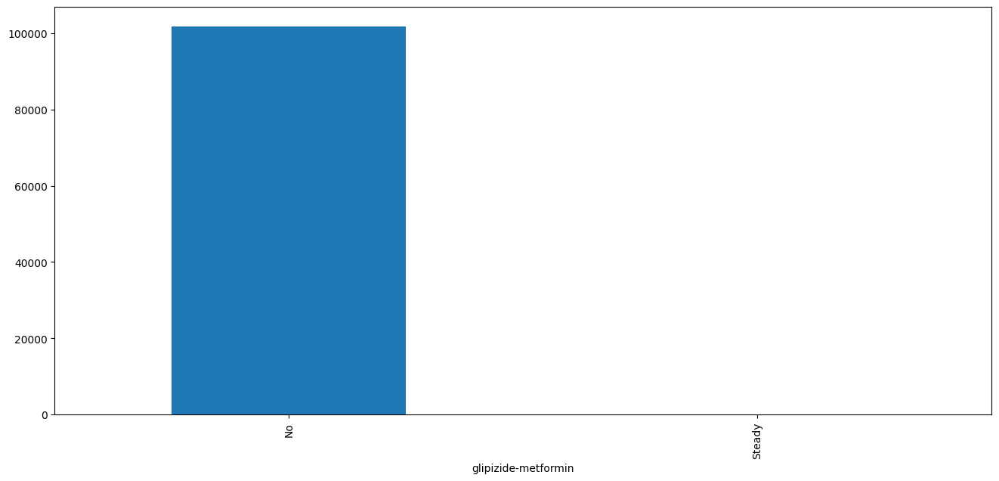

Outliers for glimepiride-pioglitazone
glimepiride-pioglitazone
No        101765
Steady         1
Name: count, dtype: int64


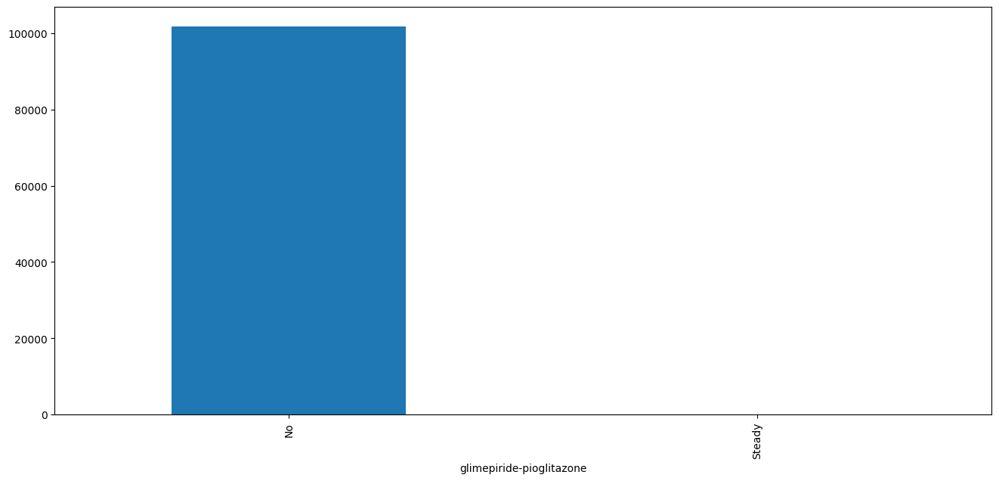

Outliers for metformin-pioglitazone
metformin-pioglitazone
No        101765
Steady         1
Name: count, dtype: int64


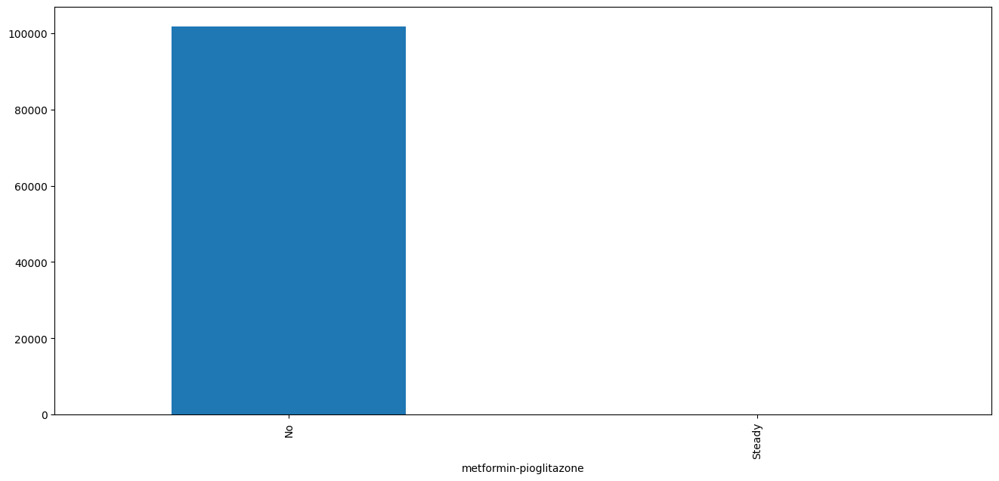

Outliers for metformin-rosiglitazone
metformin-rosiglitazone
No        101764
Steady         2
Name: count, dtype: int64


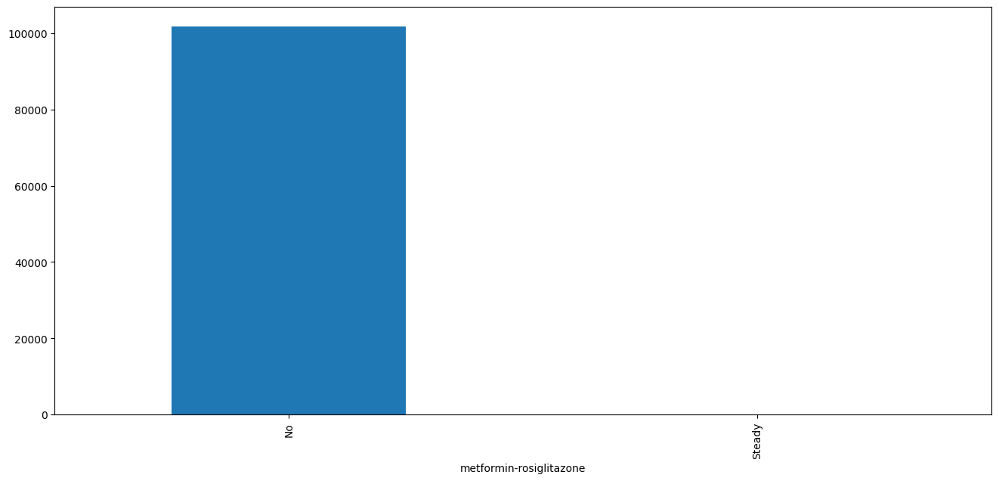

Outliers for change
change
No    54755
Ch    47011
Name: count, dtype: int64


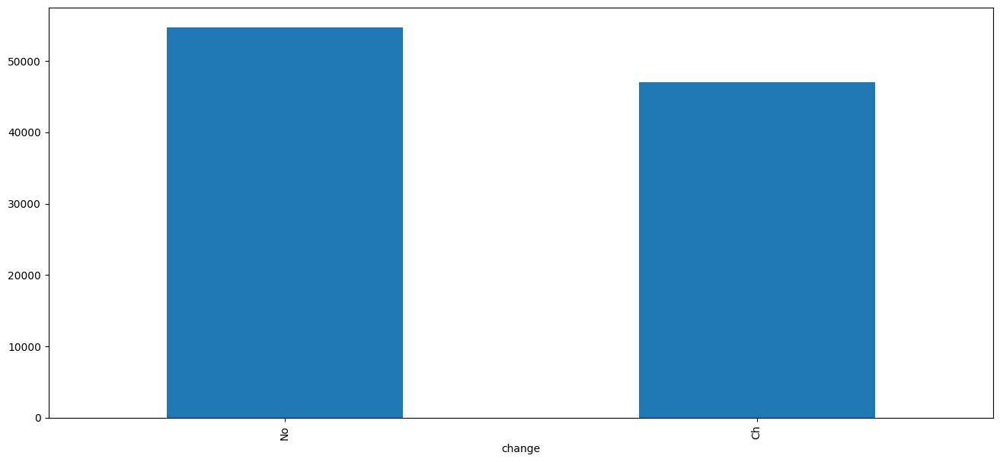

Outliers for diabetesMed
diabetesMed
Yes    78363
No     23403
Name: count, dtype: int64


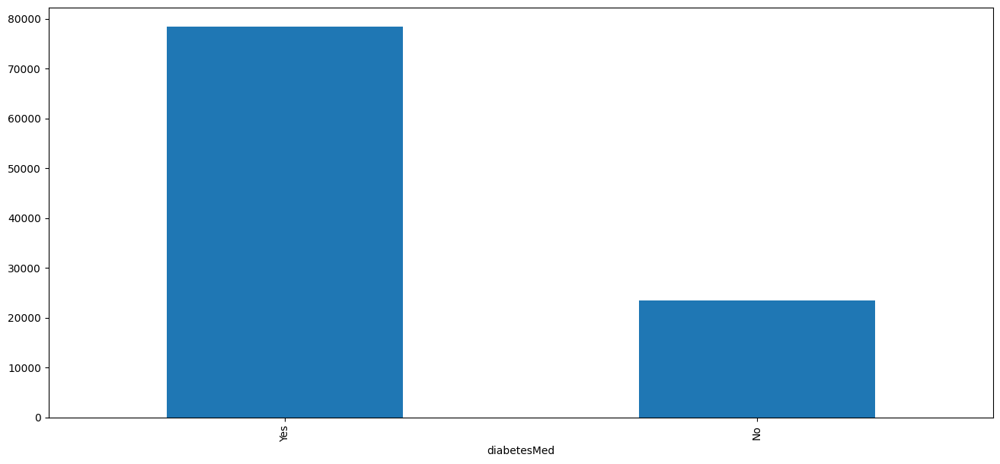

Outliers for readmitted
readmitted
NO     54864
>30    35545
<30    11357
Name: count, dtype: int64


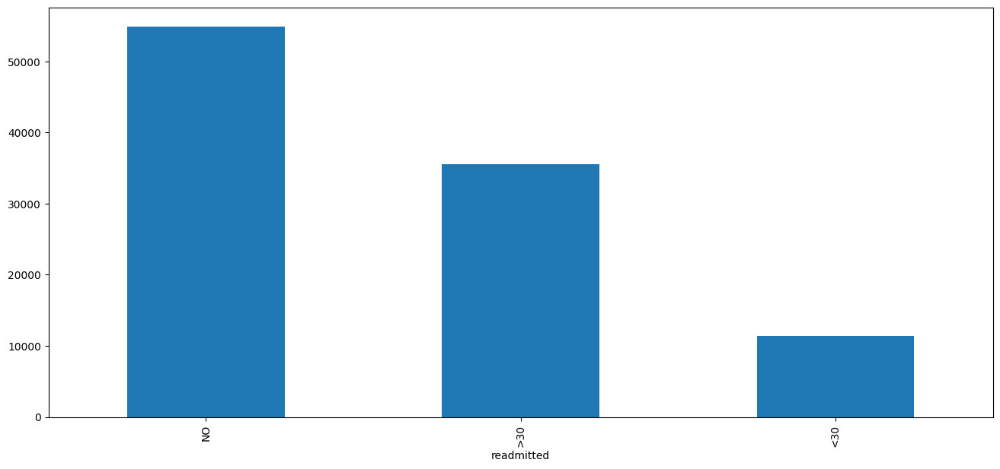

In [ ]:
for col in categorical_attributes:
  print(f"Outliers for {col}")
  categorical_outliers(diabetic_df,col)

# Error Detection

In [ ]:
numerical_attributes = [
   'time_in_hospital', 'num_lab_procedures','num_medications', 'number_diagnoses','num_procedures', 'number_outpatient', 'number_emergency', 'number_inpatient'
]

In [ ]:
categorical_attributes = [
    'race','gender', 'age', 'weight', 'admission_type_id', 'diag_1', 'diag_2', 'diag_3',
    'discharge_disposition_id', 'admission_source_id', 'payer_code',
    'medical_specialty', 'max_glu_serum', 'A1Cresult', 'metformin',
    'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride',
    'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
    'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol',
    'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin',
    'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone',
    'metformin-pioglitazone', 'metformin-rosiglitazone', 'change',
    'diabetesMed', 'readmitted'
]

In [ ]:
valid_categories = {
    'gender': ['Male', 'Female'],
    'race': ['Caucasian', 'AfricanAmerican', 'Asian', 'Hispanic', 'Other'],
    'admission_type_id': range(1, 9),
    'discharge_disposition_id': range(1, 30),
    'insulin': ['Up', 'Down', 'Steady', 'No'],
    'change': ['Ch', 'No'],
    'diabetesMed': ['Yes', 'No']
}

In [ ]:
placeholder_values = ['Unknown', '?', 'Unknown/Invalid']

In [ ]:
def detect_numerical_errors(df, numerical_columns):
    for col in numerical_columns:
        print(f"\nAnalyzing Numerical Attribute: {col}")

        # Check for negative values
        negative_count = (df[col] < 0).sum()
        print(f"Negative values in {col}: {negative_count}")

        # Detect outliers using IQR
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        outliers = df[(df[col] < Q1 - 1.5 * IQR) | (df[col] > Q3 + 1.5 * IQR)]
        print(f"Outliers in {col}: {len(outliers)}")


In [ ]:
def detect_categorical_errors(df, categorical_columns, valid_categories, placeholder_values):
    for col in categorical_columns:
        print(f"\nAnalyzing Categorical Attribute: {col}")

        # Check for invalid categories
        if col in valid_categories:
            invalid_mask = ~df[col].isin(valid_categories[col])
            invalid_count = invalid_mask.sum()
            invalid_values = df.loc[invalid_mask, col].unique()
            print(f"Invalid categories count in '{col}': {invalid_count}")
            if invalid_count > 0:
                print(f"Invalid values: {list(invalid_values)}")

        # Check for placeholder values
        placeholder_mask = df[col].isin(placeholder_values)
        placeholder_count = placeholder_mask.sum()
        placeholder_values_list = df.loc[placeholder_mask, col].unique()
        print(f"Placeholder values count in '{col}': {placeholder_count}")
        if placeholder_count > 0:
            print(f"Placeholder values: {list(placeholder_values_list)}")

In [ ]:
detect_numerical_errors(diabetic_df, numerical_attributes)


Analyzing Numerical Attribute: time_in_hospital
Negative values in time_in_hospital: 0
Outliers in time_in_hospital: 2252

Analyzing Numerical Attribute: num_lab_procedures
Negative values in num_lab_procedures: 0
Outliers in num_lab_procedures: 115

Analyzing Numerical Attribute: num_medications
Negative values in num_medications: 0
Outliers in num_medications: 2557

Analyzing Numerical Attribute: number_diagnoses
Negative values in number_diagnoses: 0
Outliers in number_diagnoses: 281

Analyzing Numerical Attribute: num_procedures
Negative values in num_procedures: 0
Outliers in num_procedures: 2772

Analyzing Numerical Attribute: number_outpatient
Negative values in number_outpatient: 0
Outliers in number_outpatient: 12357

Analyzing Numerical Attribute: number_emergency
Negative values in number_emergency: 0
Outliers in number_emergency: 11383

Analyzing Numerical Attribute: number_inpatient
Negative values in number_inpatient: 0
Outliers in number_inpatient: 7049


In [ ]:
detect_categorical_errors(diabetic_df, categorical_attributes, valid_categories, placeholder_values)


Analyzing Categorical Attribute: race
Invalid categories count in 'race': 2273
Invalid values: [<NA>]
Placeholder values count in 'race': 0

Analyzing Categorical Attribute: gender
Invalid categories count in 'gender': 5090
Invalid values: [nan, 'Unknown/Invalid']
Placeholder values count in 'gender': 2
Placeholder values: ['Unknown/Invalid']

Analyzing Categorical Attribute: age
Placeholder values count in 'age': 0

Analyzing Categorical Attribute: weight
Placeholder values count in 'weight': 0

Analyzing Categorical Attribute: admission_type_id
Invalid categories count in 'admission_type_id': 0
Placeholder values count in 'admission_type_id': 0

Analyzing Categorical Attribute: diag_1
Placeholder values count in 'diag_1': 0

Analyzing Categorical Attribute: diag_2
Placeholder values count in 'diag_2': 0

Analyzing Categorical Attribute: diag_3
Placeholder values count in 'diag_3': 0

Analyzing Categorical Attribute: discharge_disposition_id
Invalid categories count in 'discharge_dis